In [1]:
import tensorflow as tf
import utils as u
import h5py
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import os
import numpy as np
import random as rn


from sklearn.metrics import roc_curve,roc_auc_score,auc
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn import metrics

%matplotlib inline
import itertools

import keras 
from keras.models import load_model
from keras.callbacks import ModelCheckpoint,EarlyStopping
from keras import backend as K
from keras.layers import Dense, Dropout, Flatten,Conv2D, MaxPooling2D,Activation,BatchNormalization,LeakyReLU
from keras.utils import to_categorical,plot_model
from keras.models import Sequential
from keras.optimizers import Adam

Using TensorFlow backend.


In [2]:
#for reproducibility in Python,numpy and Tensorflow we set their respective seeds as follows
os.environ['PYTHONHASHSEED']='0'
np.random.seed(None) ##don't want to seed numpy with randomly placed or sized hot/dead regions
rn.seed(2)
tf.set_random_seed(3)
session_conf = tf.ConfigProto(intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)

#Force Tensorflow to use a single thread (this is recommended because it might be a cause of randomness)
sess=tf.Session(graph=tf.get_default_graph(),config=session_conf)
K.set_session(sess)

In [3]:
data_folder = '../../data'
file_name = 'HCAL_digi+rechit_occ.hdf5'
group = 'DigiTask_Occupancy_depth_depth1'

runs = ['306459','306138','306138']

data_sample= np.empty([0,72,84])
for run in runs:
    input_file=h5py.File(data_folder+'/'+'HCAL_digi+rechit_occ_run'+run+'.hdf5','r+')
    data_sample = np.concatenate((data_sample,np.array(input_file[group])),axis=0)
    
print data_sample.shape

data_sample=data_sample[:,:,26:58]

print data_sample.shape

(2997, 72, 84)
(2997, 72, 32)


Average value of good image is: 567.190321398
Shape of regular image is:  (2997, 72, 32)
Shape of dead image is:  (2997, 72, 32)
Shape of hot image is:  (2997, 72, 32)



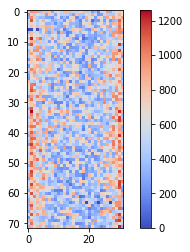

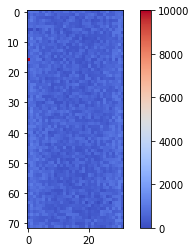

In [4]:
input_images=data_sample[:]
hotregion_image=[]
deadregion_image=[]

for k in input_images:
    xLen = 1 #np.random.randint(1,17)
    yLen = 1 #np.random.randint(1,17)
    
    a=np.random.randint(input_images.shape[2]-xLen)
    b=np.random.randint(input_images.shape[1]-yLen)
    
    xdim=(a,a+xLen)
    ydim=(b,b+yLen)
    
    #print 'xdim =', xdim
    #print 'ydim =', ydim
   
    hotregion_image.append( u.hotregion(k,xdim,ydim))
    deadregion_image.append(u.killregion(k,xdim,ydim))

print 'Average value of good image is:', np.average(input_images)
    
hotregion_image=np.array(hotregion_image)
deadregion_image=np.array(deadregion_image)

print "Shape of regular image is: ",input_images.shape
print "Shape of dead image is: " ,deadregion_image.shape
print "Shape of hot image is: " ,hotregion_image.shape

print ''
im=plt.imshow(input_images[1],cmap=cm.coolwarm)
plt.colorbar()
plt.show()
plt.clf()


im=plt.imshow(hotregion_image[1],cmap=cm.coolwarm)
plt.colorbar()
plt.show()
plt.clf()#plt.clf clears the figure and it's axis but leaves the window open. 
         #as opposed to plt.close which closes the window. If you are showing many images at a time without
         #closing the window it is better.


In [5]:
sample= np.append(data_sample,hotregion_image,axis=0)
sample= np.append(sample,deadregion_image,axis=0)
print sample.shape
X=np.copy(sample)

y=np.zeros((sample.shape[0],1))
k=0
for img in X:
    X[k] = X[k] / np.max(img)
    k=k+1
#print y.shape
#print input_images.shape[0]


#this is because I am only going to add the hot and dead region images

### Changed this to a 2 class problem, good and bad
y[-2*input_images.shape[0]:]=1

#if you want it as integers leave this as it is
#if you would like it as a vector then do this
y=to_categorical(y,2)

# convert class vectors to binary class matrices
#y_train = keras.utils.to_categorical(y_train, num_classes)
#y_test = keras.utils.to_categorical(y_test, num_classes)

print "X shape is: ",X.shape
print "y shape is: ",y.shape
# input image dimensions
img_rows, img_cols = X.shape[1],X.shape[2]

(8991, 72, 32)
X shape is:  (8991, 72, 32)
y shape is:  (8991, 2)


Xtrain.shape (5394, 72, 32)
Xtest.shape (3597, 72, 32)
ytrain.shape (5394, 2)
ytest.shape (3597, 2)
Printing labels and their corresponding images
-------------------
[ 0.  1.]


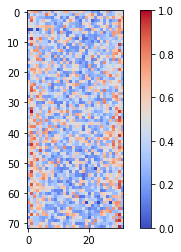

-------------------
[ 1.  0.]


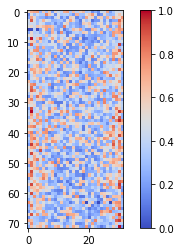

-------------------
[ 0.  1.]


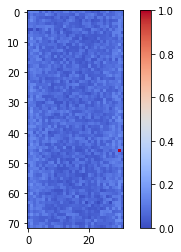

-------------------
[ 0.  1.]


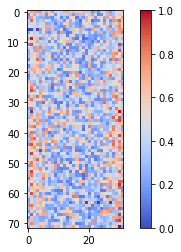

-------------------
[ 0.  1.]


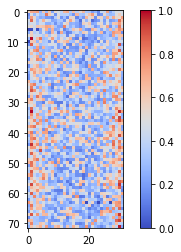

-------------------
[ 0.  1.]


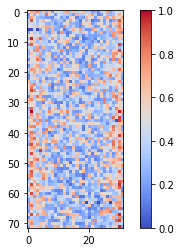

-------------------
[ 1.  0.]


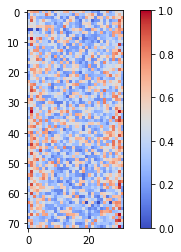

-------------------
[ 1.  0.]


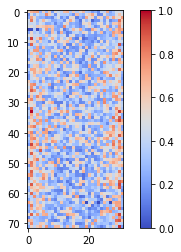

-------------------
[ 0.  1.]


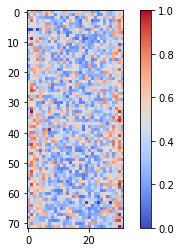

-------------------
[ 1.  0.]


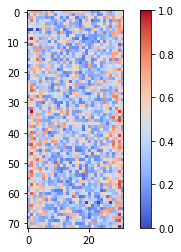

Xtrain.shape after if statement (5394, 72, 32, 1)
Xtest.shape after if statement (3597, 72, 32, 1)
ytrain.shape after if statement (5394, 2)
ytest.shape after if statement (3597, 2)


In [6]:
Xtrain, Xtest ,ytrain, ytest =train_test_split(X,y,test_size=.4,random_state =5 )

print 'Xtrain.shape',Xtrain.shape
print 'Xtest.shape',Xtest.shape
print 'ytrain.shape',ytrain.shape
print 'ytest.shape',ytest.shape
print 'Printing labels and their corresponding images'
    
for k in range(10):
    print'-------------------'
    print ytrain[k]
    im=plt.imshow(Xtrain[k],cmap=cm.coolwarm)
    plt.colorbar()
    plt.show()
    plt.clf()


Xtrain, Xtest,input_shape= u.check_test_and_train_images_format(Xtrain, Xtest, img_rows, img_cols)

print 'Xtrain.shape after if statement',Xtrain.shape
print 'Xtest.shape after if statement',Xtest.shape
print 'ytrain.shape after if statement',ytrain.shape
print 'ytest.shape after if statement',ytest.shape
    

In [7]:
# this is Guillermo's architecture as a control
ThreeConvLayer = Sequential()

ThreeConvLayer.add(Conv2D(10, kernel_size=(2, 2), strides=(1, 1),input_shape=input_shape))
ThreeConvLayer.add(BatchNormalization())
ThreeConvLayer.add(Activation('relu'))
ThreeConvLayer.add(MaxPooling2D(pool_size=(2,2)))

ThreeConvLayer.add(Conv2D(8, kernel_size=(3, 3),strides=(1, 1)))
ThreeConvLayer.add(BatchNormalization())
ThreeConvLayer.add(Activation('relu'))
ThreeConvLayer.add(MaxPooling2D(pool_size=(2,2)))

ThreeConvLayer.add(Conv2D(8,kernel_size=(1,1)))
ThreeConvLayer.add(BatchNormalization())
ThreeConvLayer.add(Activation('relu'))

ThreeConvLayer.add(Dropout(0.25))
ThreeConvLayer.add(Flatten())

ThreeConvLayer.add(Dense(8))
ThreeConvLayer.add(BatchNormalization())
ThreeConvLayer.add(Activation('relu'))

#Last layer is Dense (as usual), note output size (first arg) is label size
ThreeConvLayer.add(Dense(2, activation='softmax'))


ThreeConvLayer.compile(loss='categorical_crossentropy',
              optimizer='Nadam',#Adam(lr=1e-3),
              metrics=['accuracy'])
ThreeConvLayer.summary()
plot_model(ThreeConvLayer, to_file='Supervised_model.png',)

ThreeConvLayer.save('emptymodel.hdf5')

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 71, 31, 10)        50        
_________________________________________________________________
batch_normalization_1 (Batch (None, 71, 31, 10)        40        
_________________________________________________________________
activation_1 (Activation)    (None, 71, 31, 10)        0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 35, 15, 10)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 33, 13, 8)         728       
_________________________________________________________________
batch_normalization_2 (Batch (None, 33, 13, 8)         32        
_________________________________________________________________
activation_2 (Activation)    (None, 33, 13, 8)         0         
__________

In [8]:
# this function generates a Net with only one Conv layer
# It is called in the next box
def OneConvLayer(filt, wid, length):
    model = Sequential()

    model.add(Conv2D(filt, kernel_size=(wid, length), strides=(1, 1),input_shape=input_shape))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(3,3)))

    model.add(Dropout(0.25))
    model.add(Flatten())

    #Last layer is Dense (as usual), note output size (first arg) is label size
    model.add(Dense(2, activation='softmax'))


    model.compile(loss='categorical_crossentropy',
              optimizer='Nadam',#Adam(lr=1e-3),
              metrics=['accuracy'])
    return model

In [9]:
### Now for easy plotting/accessing we put the models into a list for later
Models = []
filter_sizes = []
filters = []
tot_area = []
for filt in range(1,11):
    for wid in range(1,6):
        for length in range(1,6):
            Models.append(OneConvLayer(filt, wid, length))
            filter_sizes.append(wid*length)
            filters.append(filt)
            tot_area.append(filt*wid*length)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 72, 32, 1)         2         
_________________________________________________________________
batch_normalization_5 (Batch (None, 72, 32, 1)         4         
_________________________________________________________________
activation_5 (Activation)    (None, 72, 32, 1)         0         
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 24, 10, 1)         0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 24, 10, 1)         0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 240)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 2)                 482       
Total para

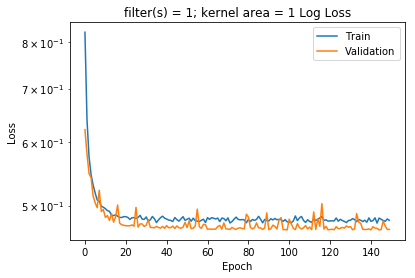

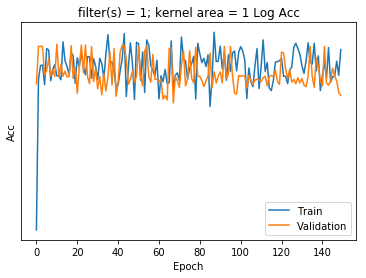

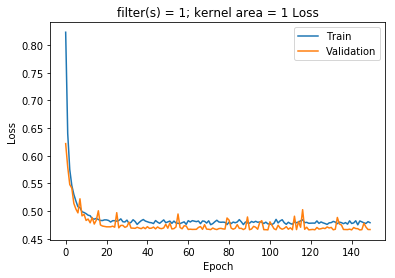

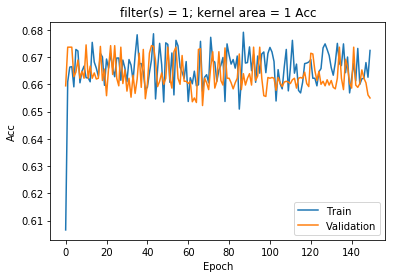

Confusion matrix, without normalization
[[ 409  765]
 [ 457 1966]]
accuracy score:  0.660272449263
0.74372108998 For the label #0


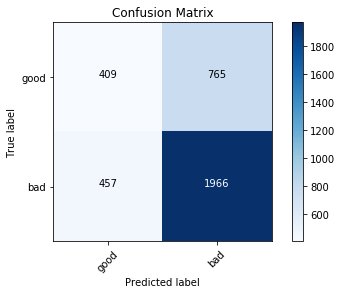

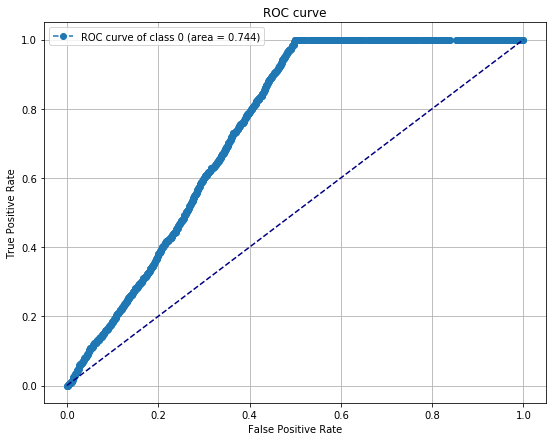

0.74372108998 For the label #1


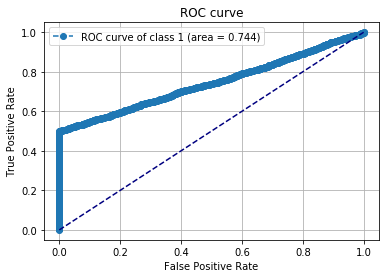

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 72, 31, 1)         3         
_________________________________________________________________
batch_normalization_6 (Batch (None, 72, 31, 1)         4         
_________________________________________________________________
activation_6 (Activation)    (None, 72, 31, 1)         0         
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 24, 10, 1)         0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 24, 10, 1)         0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 240)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 2)                 482       
Total para

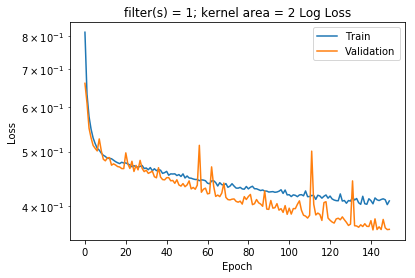

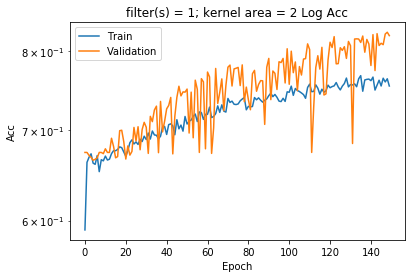

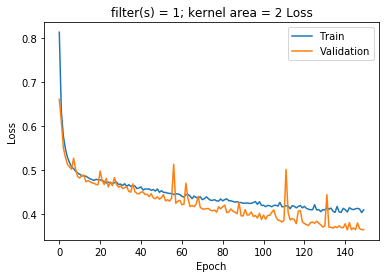

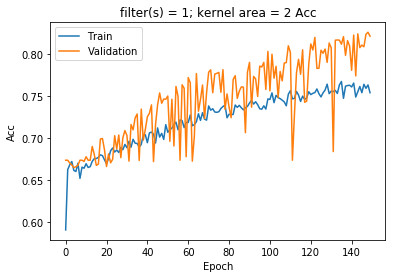

Confusion matrix, without normalization
[[1168    6]
 [ 632 1791]]
accuracy score:  0.822629969419
0.875371141552 For the label #0


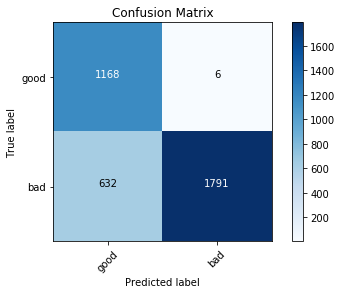

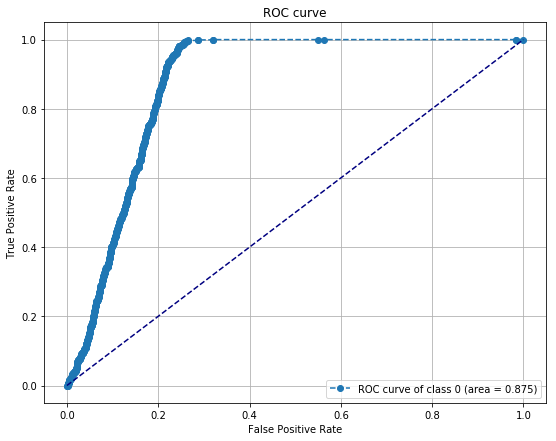

0.875371141552 For the label #1


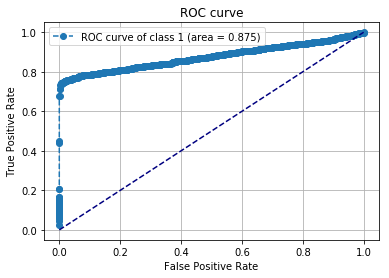

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 72, 30, 1)         4         
_________________________________________________________________
batch_normalization_7 (Batch (None, 72, 30, 1)         4         
_________________________________________________________________
activation_7 (Activation)    (None, 72, 30, 1)         0         
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 24, 10, 1)         0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 24, 10, 1)         0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 240)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 2)                 482       
Total para

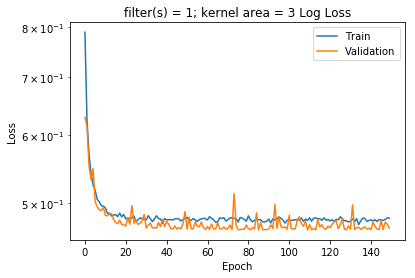

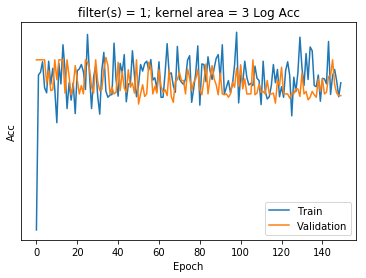

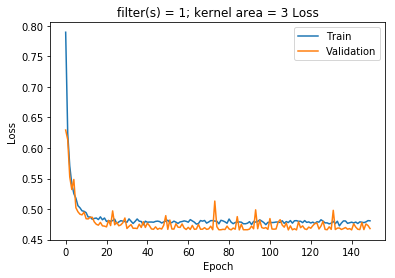

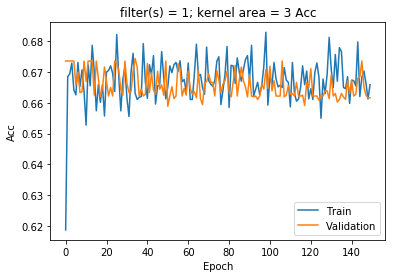

Confusion matrix, without normalization
[[ 152 1022]
 [ 181 2242]]
accuracy score:  0.665554628857
0.741456274024 For the label #0


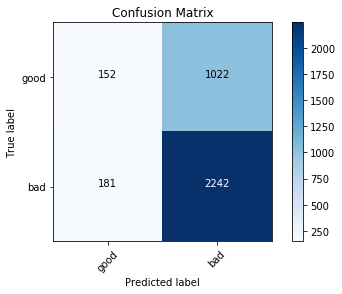

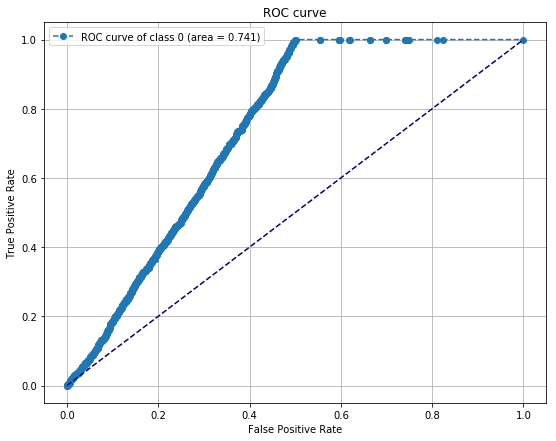

0.741456274024 For the label #1


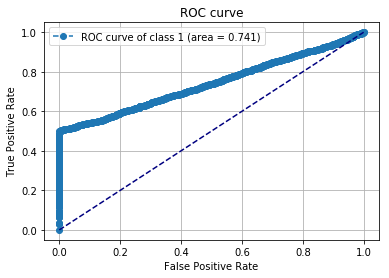

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 72, 29, 1)         5         
_________________________________________________________________
batch_normalization_8 (Batch (None, 72, 29, 1)         4         
_________________________________________________________________
activation_8 (Activation)    (None, 72, 29, 1)         0         
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 24, 9, 1)          0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 24, 9, 1)          0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 216)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 2)                 434       
Total para

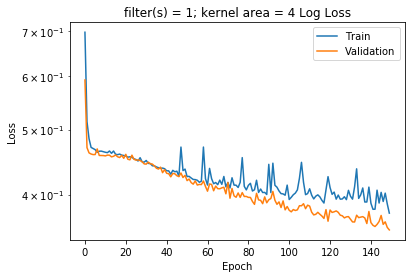

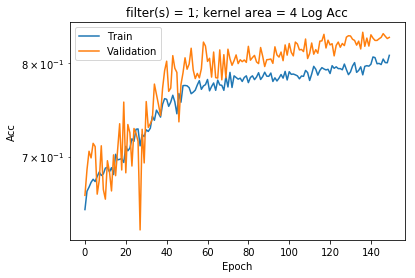

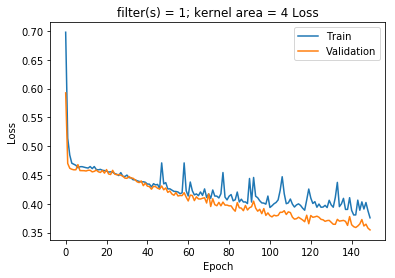

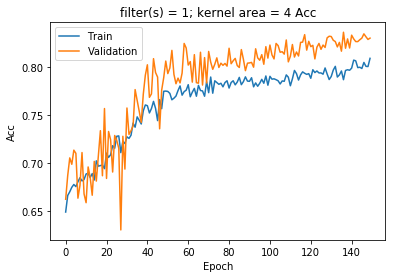

Confusion matrix, without normalization
[[1174    0]
 [ 611 1812]]
accuracy score:  0.830136224632
0.866954674151 For the label #0


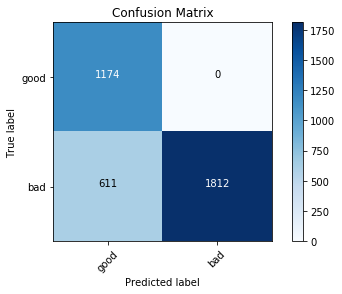

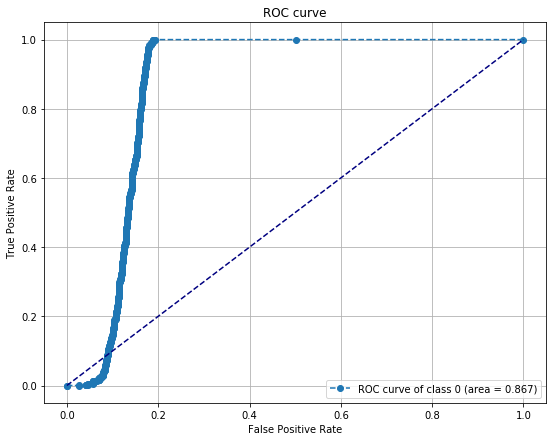

0.866954674151 For the label #1


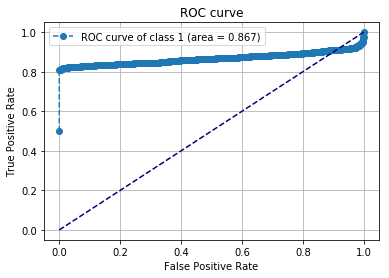

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_8 (Conv2D)            (None, 72, 28, 1)         6         
_________________________________________________________________
batch_normalization_9 (Batch (None, 72, 28, 1)         4         
_________________________________________________________________
activation_9 (Activation)    (None, 72, 28, 1)         0         
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 24, 9, 1)          0         
_________________________________________________________________
dropout_6 (Dropout)          (None, 24, 9, 1)          0         
_________________________________________________________________
flatten_6 (Flatten)          (None, 216)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 2)                 434       
Total para

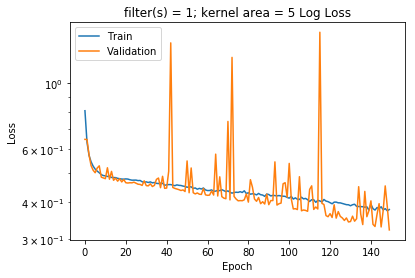

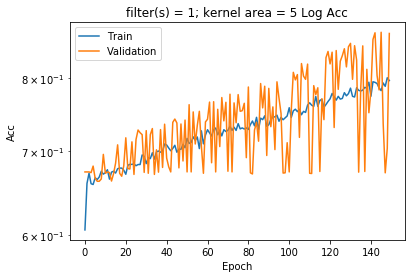

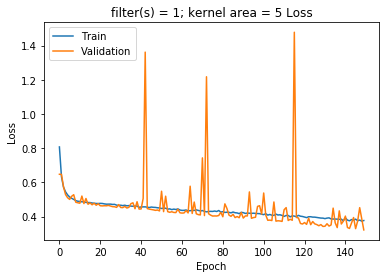

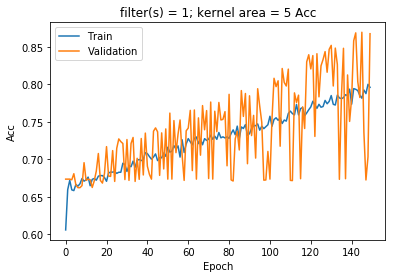

Confusion matrix, without normalization
[[1163   11]
 [ 465 1958]]
accuracy score:  0.867667500695
0.905363034969 For the label #0


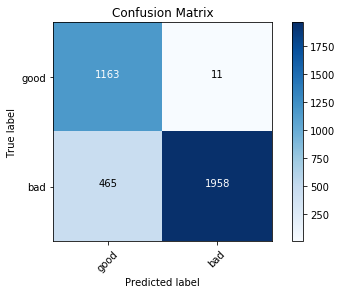

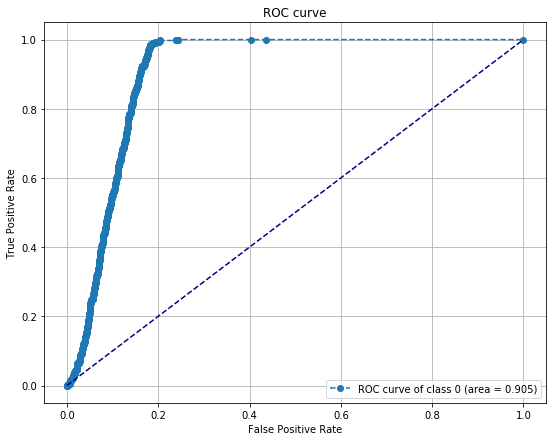

0.905363034969 For the label #1


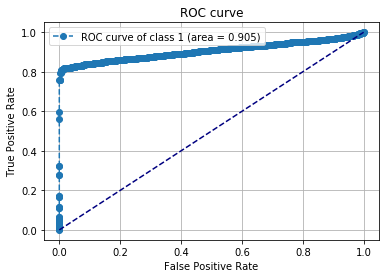

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_9 (Conv2D)            (None, 71, 32, 1)         3         
_________________________________________________________________
batch_normalization_10 (Batc (None, 71, 32, 1)         4         
_________________________________________________________________
activation_10 (Activation)   (None, 71, 32, 1)         0         
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_7 (Flatten)          (None, 230)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 2)                 462       
Total para

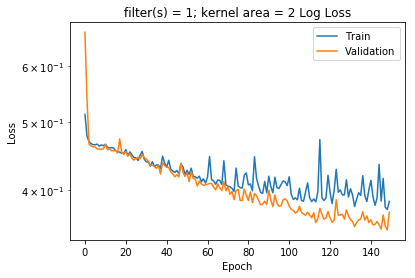

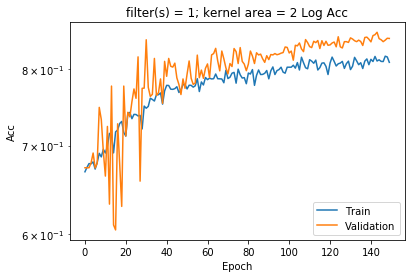

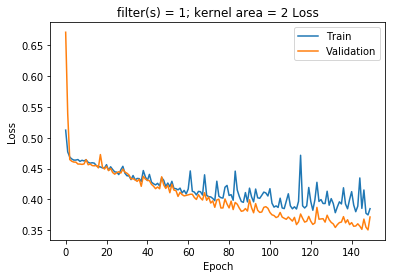

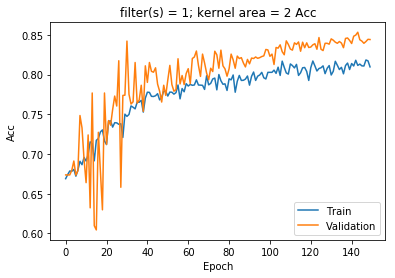

Confusion matrix, without normalization
[[1174    0]
 [ 560 1863]]
accuracy score:  0.8443147067
0.886702252196 For the label #0


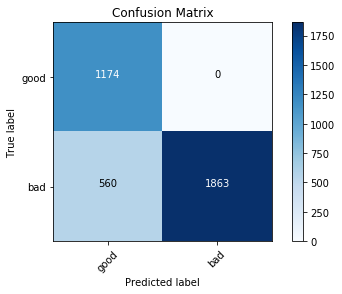

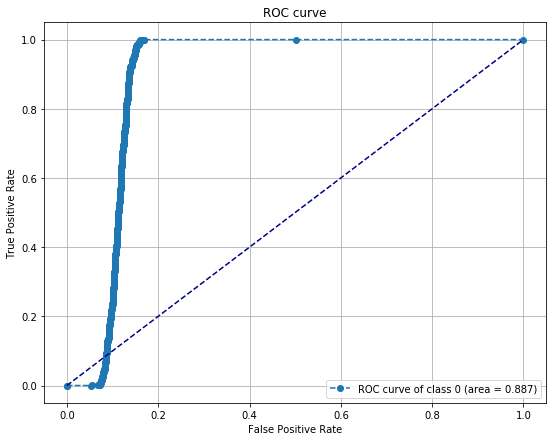

0.886702252196 For the label #1


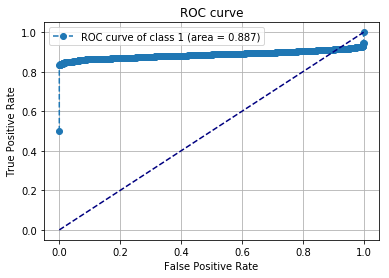

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 71, 31, 1)         5         
_________________________________________________________________
batch_normalization_11 (Batc (None, 71, 31, 1)         4         
_________________________________________________________________
activation_11 (Activation)   (None, 71, 31, 1)         0         
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_8 (Dropout)          (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_8 (Flatten)          (None, 230)               0         
_________________________________________________________________
dense_9 (Dense)              (None, 2)                 462       
Total para

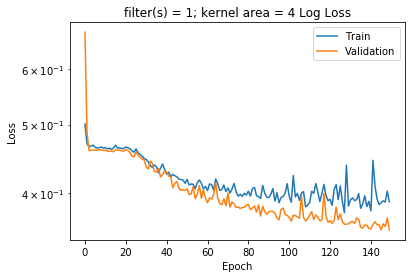

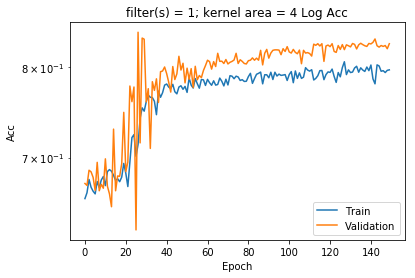

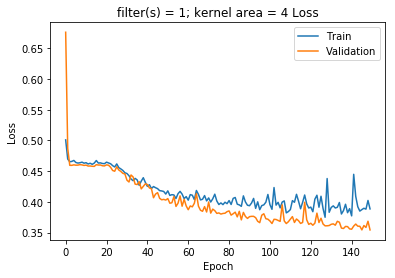

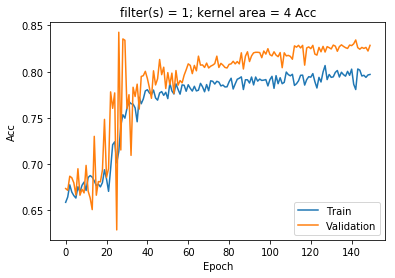

Confusion matrix, without normalization
[[1174    0]
 [ 617 1806]]
accuracy score:  0.828468167918
0.878156065418 For the label #0


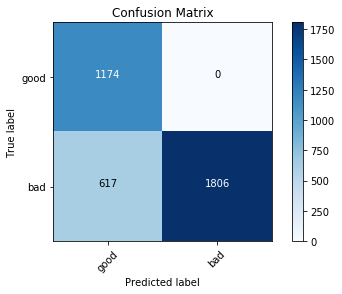

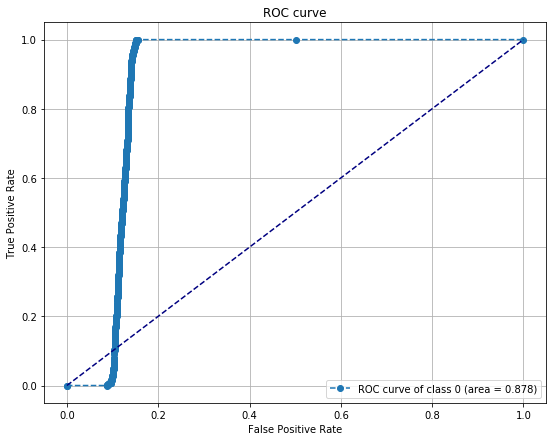

0.878156768504 For the label #1


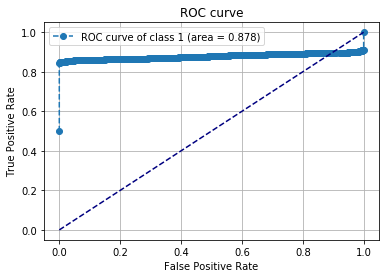

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_11 (Conv2D)           (None, 71, 30, 1)         7         
_________________________________________________________________
batch_normalization_12 (Batc (None, 71, 30, 1)         4         
_________________________________________________________________
activation_12 (Activation)   (None, 71, 30, 1)         0         
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_9 (Dropout)          (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_9 (Flatten)          (None, 230)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 2)                 462       
Total para

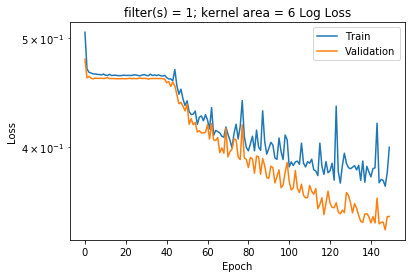

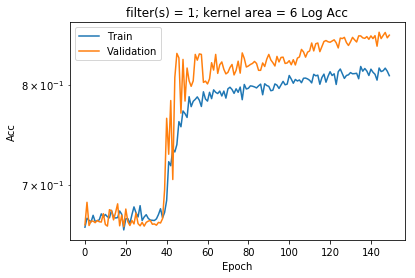

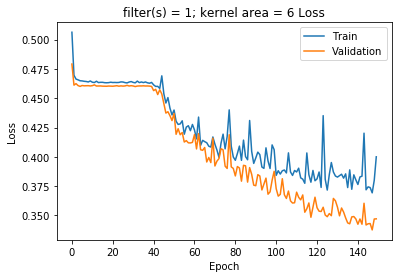

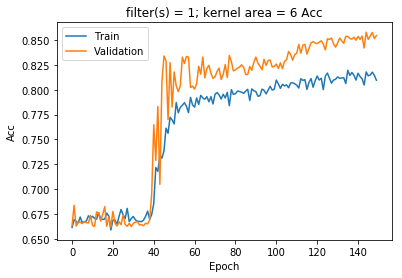

Confusion matrix, without normalization
[[1174    0]
 [ 512 1911]]
accuracy score:  0.857659160411
0.895571155473 For the label #0


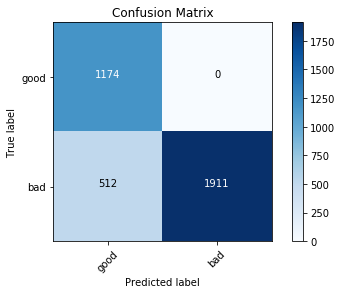

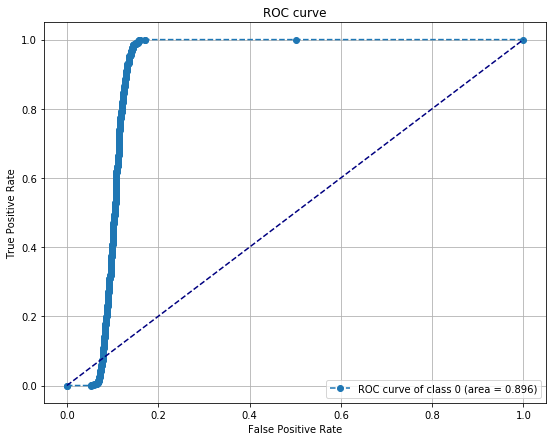

0.895571155473 For the label #1


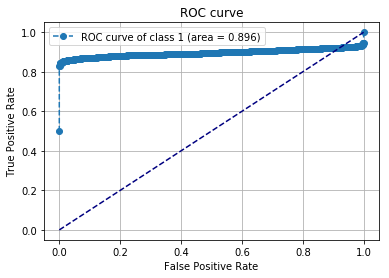

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 71, 29, 1)         9         
_________________________________________________________________
batch_normalization_13 (Batc (None, 71, 29, 1)         4         
_________________________________________________________________
activation_13 (Activation)   (None, 71, 29, 1)         0         
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 23, 9, 1)          0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 23, 9, 1)          0         
_________________________________________________________________
flatten_10 (Flatten)         (None, 207)               0         
_________________________________________________________________
dense_11 (Dense)             (None, 2)                 416       
Total para

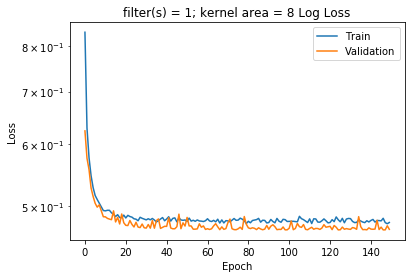

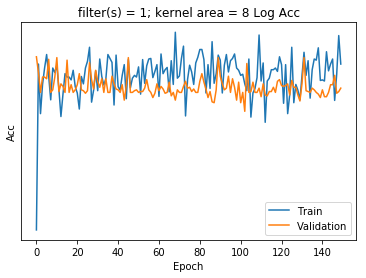

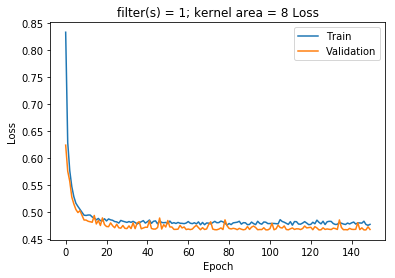

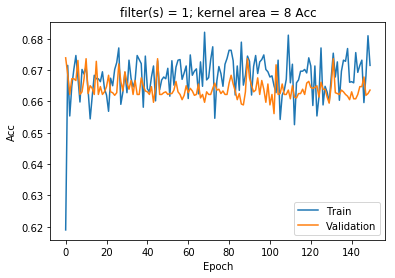

Confusion matrix, without normalization
[[ 365  809]
 [ 409 2014]]
accuracy score:  0.661384487073
0.740786233013 For the label #0


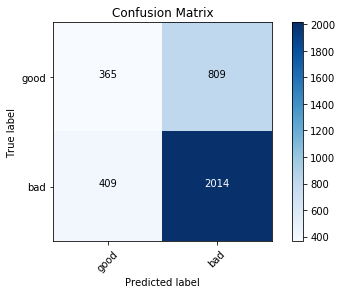

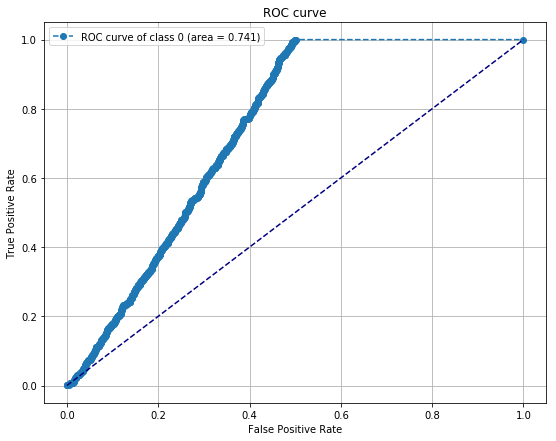

0.740786233013 For the label #1


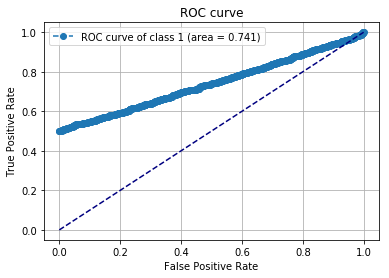

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_13 (Conv2D)           (None, 71, 28, 1)         11        
_________________________________________________________________
batch_normalization_14 (Batc (None, 71, 28, 1)         4         
_________________________________________________________________
activation_14 (Activation)   (None, 71, 28, 1)         0         
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 23, 9, 1)          0         
_________________________________________________________________
dropout_11 (Dropout)         (None, 23, 9, 1)          0         
_________________________________________________________________
flatten_11 (Flatten)         (None, 207)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 2)                 416       
Total para

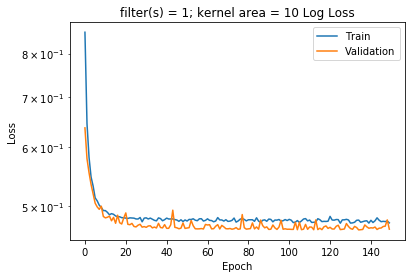

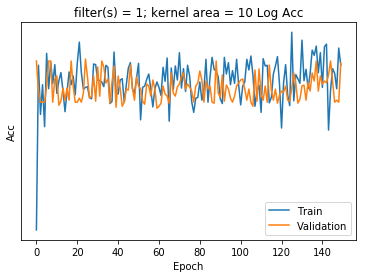

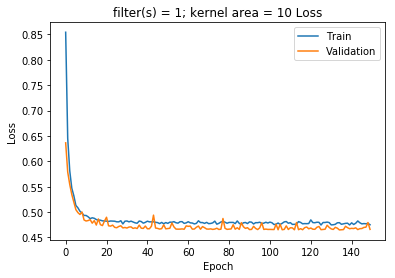

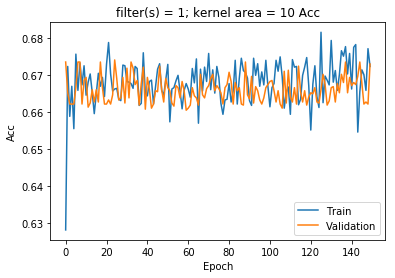

Confusion matrix, without normalization
[[ 379  795]
 [ 409 2014]]
accuracy score:  0.665276619405
0.749870632166 For the label #0


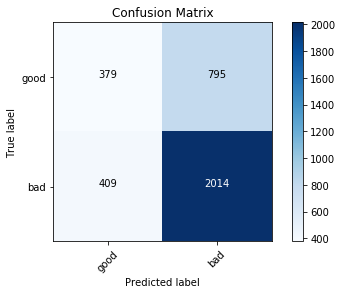

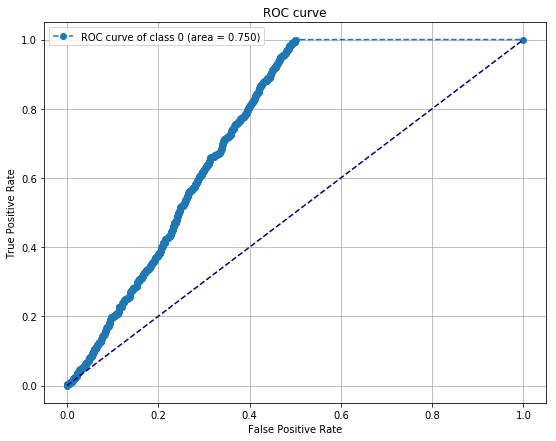

0.749870280623 For the label #1


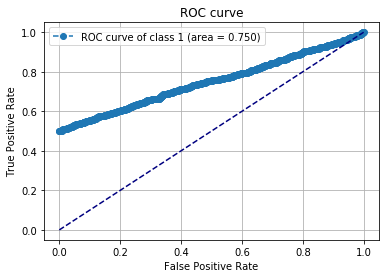

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_14 (Conv2D)           (None, 70, 32, 1)         4         
_________________________________________________________________
batch_normalization_15 (Batc (None, 70, 32, 1)         4         
_________________________________________________________________
activation_15 (Activation)   (None, 70, 32, 1)         0         
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_12 (Dropout)         (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_12 (Flatten)         (None, 230)               0         
_________________________________________________________________
dense_13 (Dense)             (None, 2)                 462       
Total para

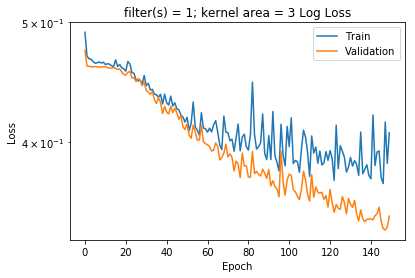

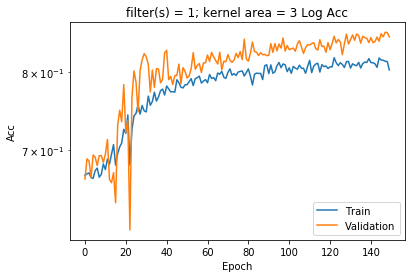

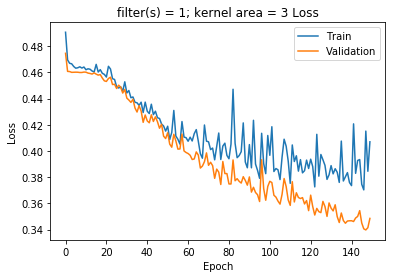

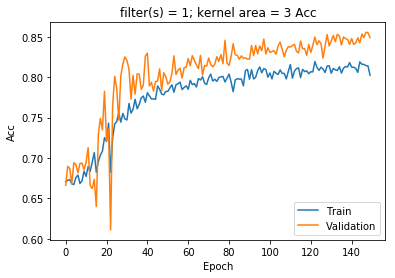

Confusion matrix, without normalization
[[1174    0]
 [ 519 1904]]
accuracy score:  0.855713094245
0.887127619259 For the label #0


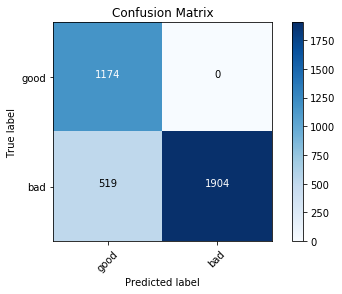

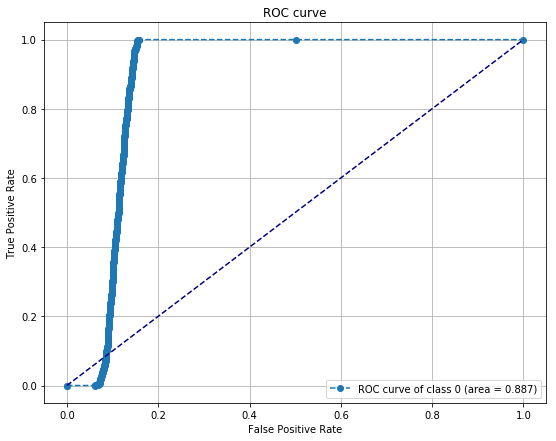

0.887127619259 For the label #1


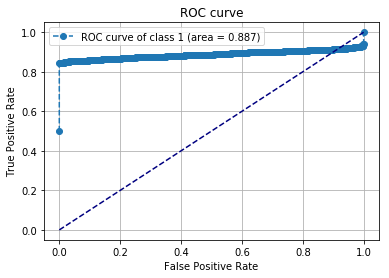

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_15 (Conv2D)           (None, 70, 31, 1)         7         
_________________________________________________________________
batch_normalization_16 (Batc (None, 70, 31, 1)         4         
_________________________________________________________________
activation_16 (Activation)   (None, 70, 31, 1)         0         
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_13 (Dropout)         (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_13 (Flatten)         (None, 230)               0         
_________________________________________________________________
dense_14 (Dense)             (None, 2)                 462       
Total para

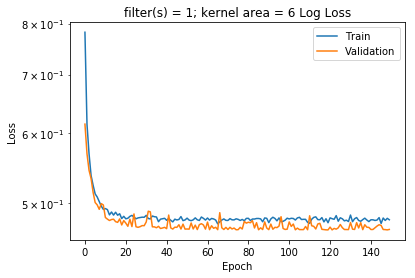

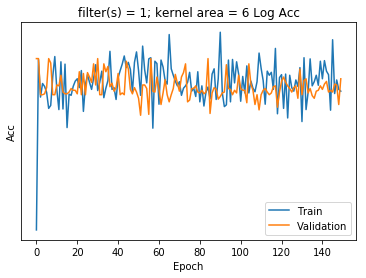

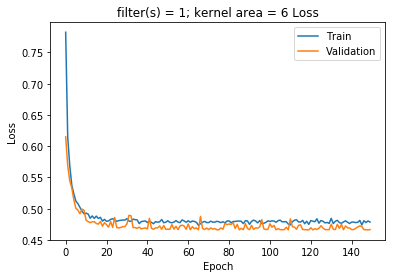

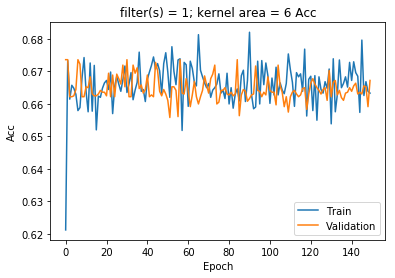

Confusion matrix, without normalization
[[ 506  668]
 [ 544 1879]]
accuracy score:  0.663052543786
0.745666353325 For the label #0


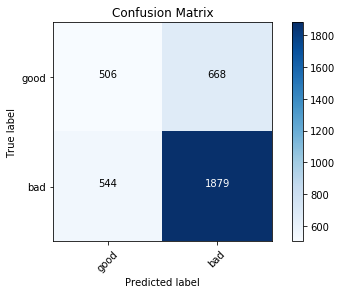

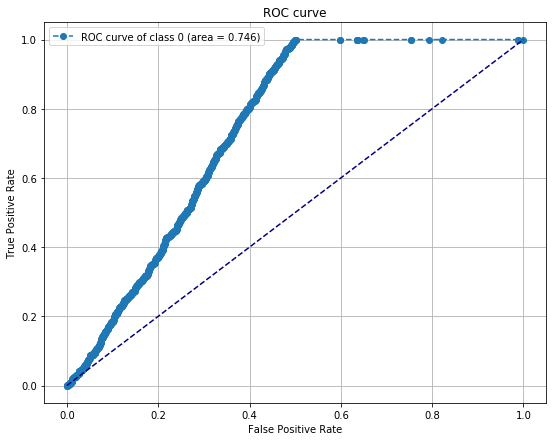

0.745666353325 For the label #1


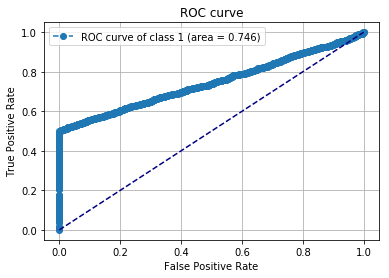

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_16 (Conv2D)           (None, 70, 30, 1)         10        
_________________________________________________________________
batch_normalization_17 (Batc (None, 70, 30, 1)         4         
_________________________________________________________________
activation_17 (Activation)   (None, 70, 30, 1)         0         
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_14 (Dropout)         (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_14 (Flatten)         (None, 230)               0         
_________________________________________________________________
dense_15 (Dense)             (None, 2)                 462       
Total para

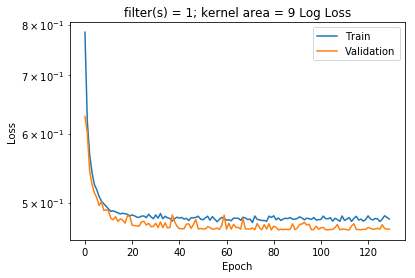

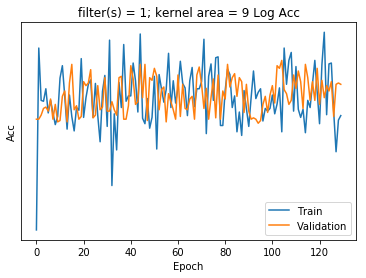

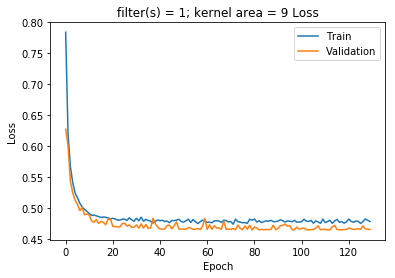

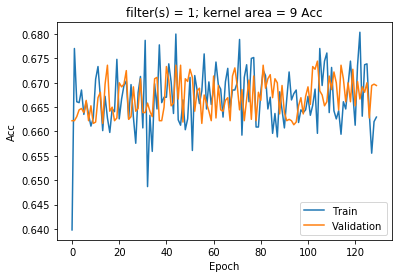

Confusion matrix, without normalization
[[ 365  809]
 [ 385 2038]]
accuracy score:  0.668056713928
0.751737149872 For the label #0


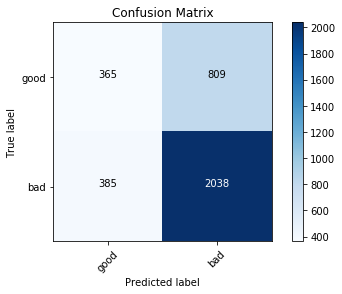

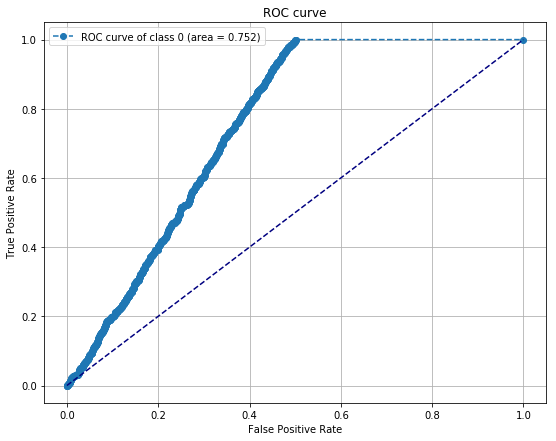

0.751737149872 For the label #1


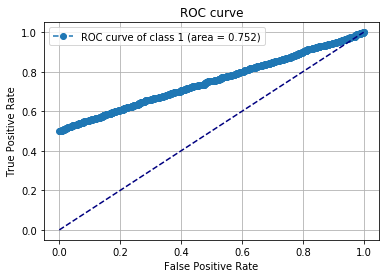

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_17 (Conv2D)           (None, 70, 29, 1)         13        
_________________________________________________________________
batch_normalization_18 (Batc (None, 70, 29, 1)         4         
_________________________________________________________________
activation_18 (Activation)   (None, 70, 29, 1)         0         
_________________________________________________________________
max_pooling2d_16 (MaxPooling (None, 23, 9, 1)          0         
_________________________________________________________________
dropout_15 (Dropout)         (None, 23, 9, 1)          0         
_________________________________________________________________
flatten_15 (Flatten)         (None, 207)               0         
_________________________________________________________________
dense_16 (Dense)             (None, 2)                 416       
Total para

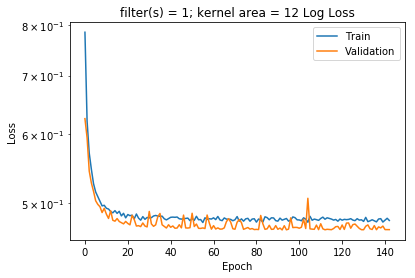

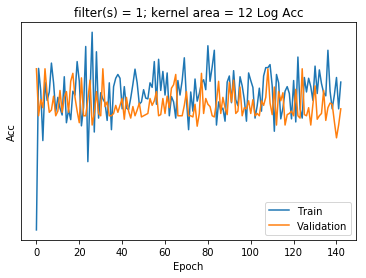

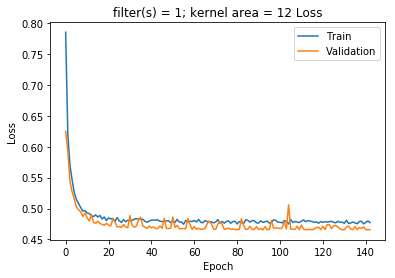

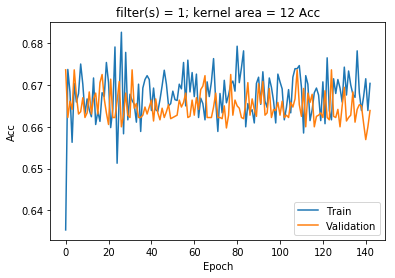

Confusion matrix, without normalization
[[ 334  840]
 [ 344 2079]]
accuracy score:  0.670836808451
0.746236907659 For the label #0


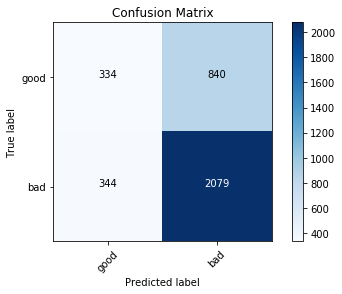

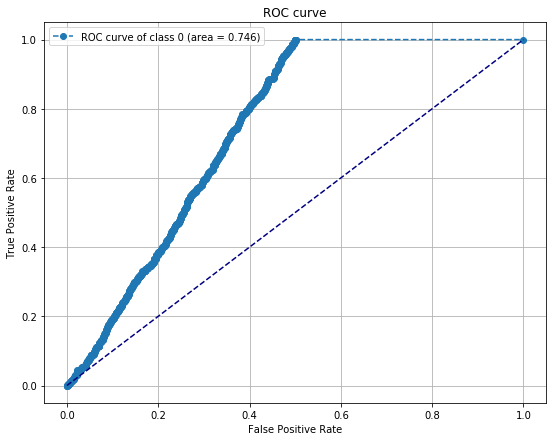

0.746236907659 For the label #1


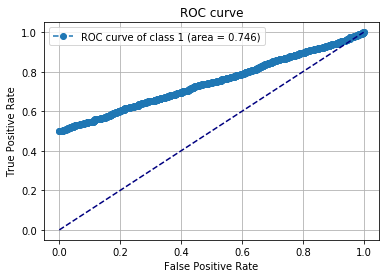

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_18 (Conv2D)           (None, 70, 28, 1)         16        
_________________________________________________________________
batch_normalization_19 (Batc (None, 70, 28, 1)         4         
_________________________________________________________________
activation_19 (Activation)   (None, 70, 28, 1)         0         
_________________________________________________________________
max_pooling2d_17 (MaxPooling (None, 23, 9, 1)          0         
_________________________________________________________________
dropout_16 (Dropout)         (None, 23, 9, 1)          0         
_________________________________________________________________
flatten_16 (Flatten)         (None, 207)               0         
_________________________________________________________________
dense_17 (Dense)             (None, 2)                 416       
Total para

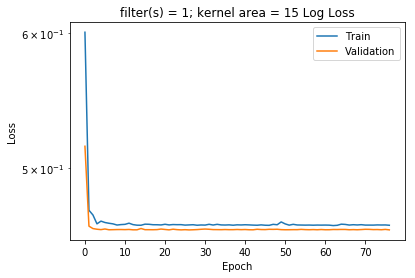

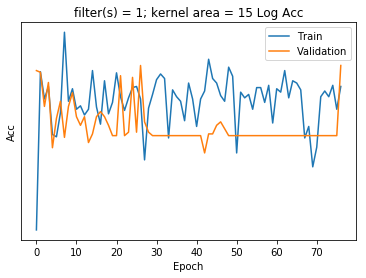

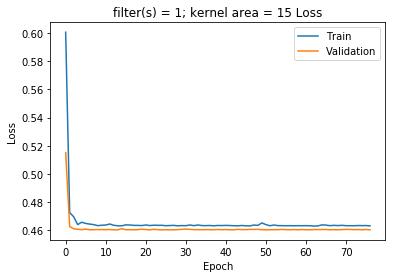

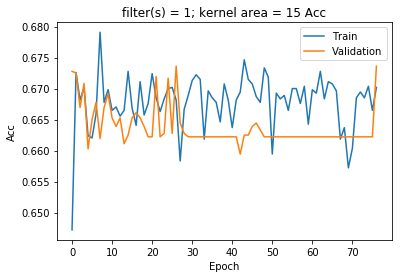

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.74617661803 For the label #0


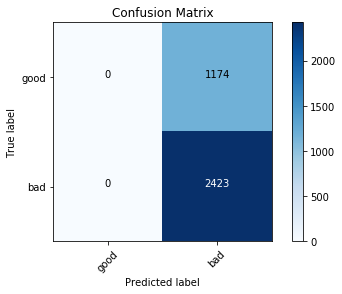

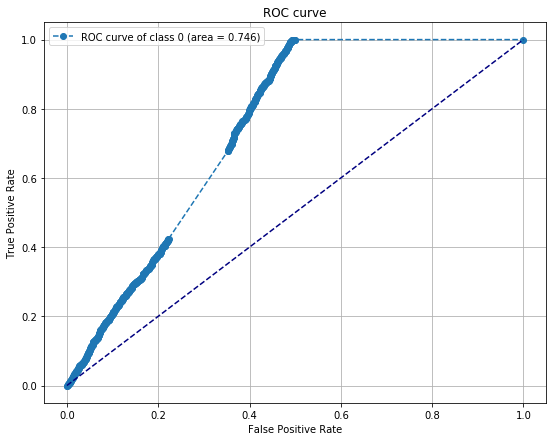

0.746175211857 For the label #1


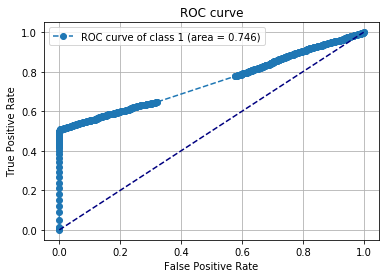

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_19 (Conv2D)           (None, 69, 32, 1)         5         
_________________________________________________________________
batch_normalization_20 (Batc (None, 69, 32, 1)         4         
_________________________________________________________________
activation_20 (Activation)   (None, 69, 32, 1)         0         
_________________________________________________________________
max_pooling2d_18 (MaxPooling (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_17 (Dropout)         (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_17 (Flatten)         (None, 230)               0         
_________________________________________________________________
dense_18 (Dense)             (None, 2)                 462       
Total para

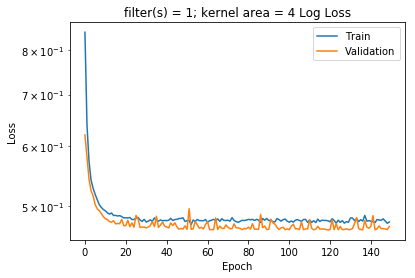

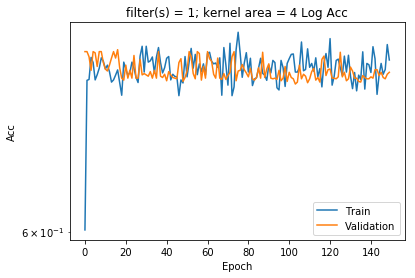

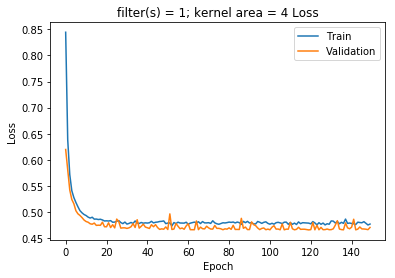

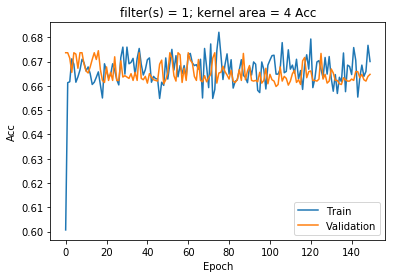

Confusion matrix, without normalization
[[ 360  814]
 [ 388 2035]]
accuracy score:  0.66583263831
0.744963443041 For the label #0


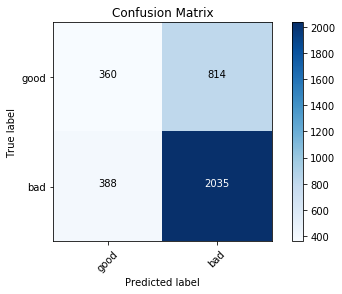

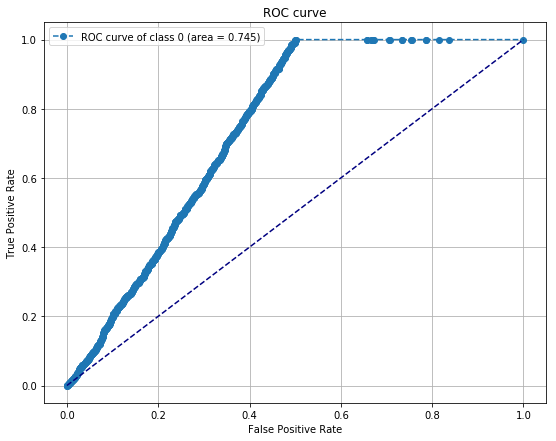

0.744963443041 For the label #1


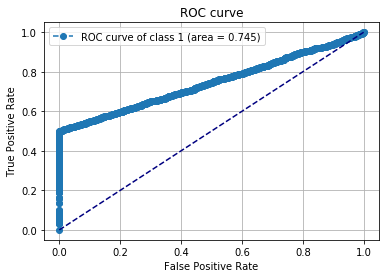

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_20 (Conv2D)           (None, 69, 31, 1)         9         
_________________________________________________________________
batch_normalization_21 (Batc (None, 69, 31, 1)         4         
_________________________________________________________________
activation_21 (Activation)   (None, 69, 31, 1)         0         
_________________________________________________________________
max_pooling2d_19 (MaxPooling (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_18 (Dropout)         (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_18 (Flatten)         (None, 230)               0         
_________________________________________________________________
dense_19 (Dense)             (None, 2)                 462       
Total para

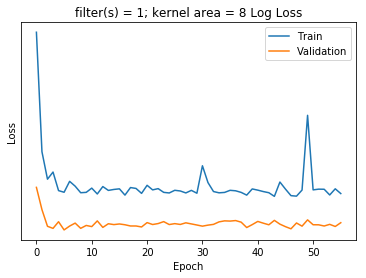

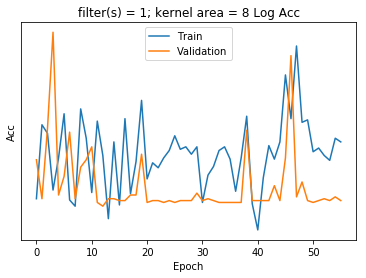

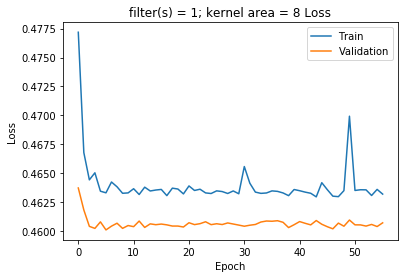

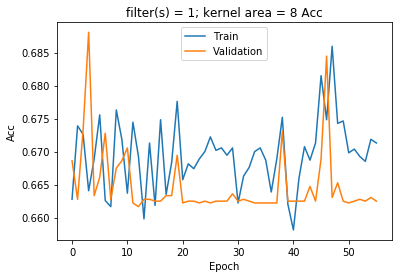

Confusion matrix, without normalization
[[ 130 1044]
 [ 157 2266]]
accuracy score:  0.666110647762
0.762270785157 For the label #0


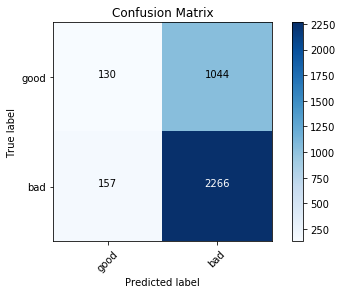

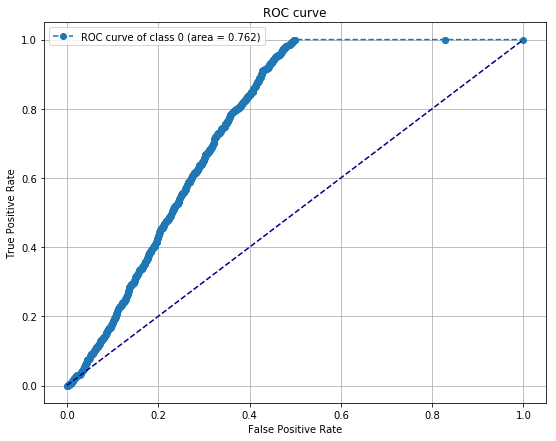

0.762271664015 For the label #1


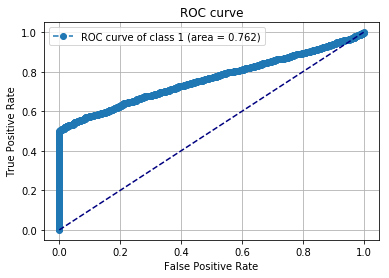

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_21 (Conv2D)           (None, 69, 30, 1)         13        
_________________________________________________________________
batch_normalization_22 (Batc (None, 69, 30, 1)         4         
_________________________________________________________________
activation_22 (Activation)   (None, 69, 30, 1)         0         
_________________________________________________________________
max_pooling2d_20 (MaxPooling (None, 23, 10, 1)         0         
_________________________________________________________________
dropout_19 (Dropout)         (None, 23, 10, 1)         0         
_________________________________________________________________
flatten_19 (Flatten)         (None, 230)               0         
_________________________________________________________________
dense_20 (Dense)             (None, 2)                 462       
Total para

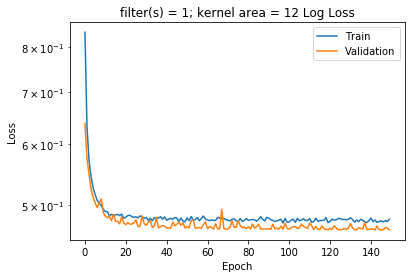

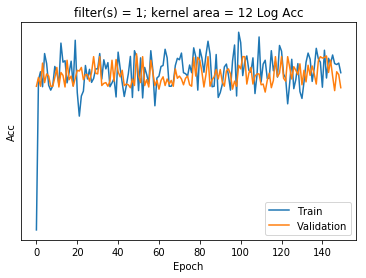

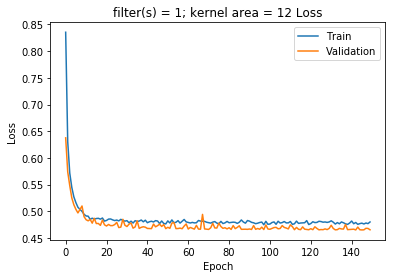

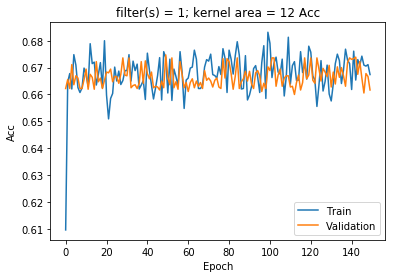

Confusion matrix, without normalization
[[ 765  409]
 [ 764 1659]]
accuracy score:  0.673894912427
0.751915909502 For the label #0


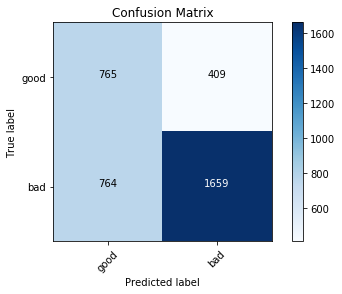

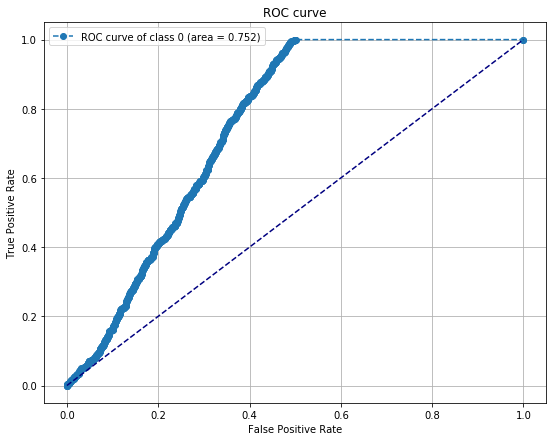

0.751915909502 For the label #1


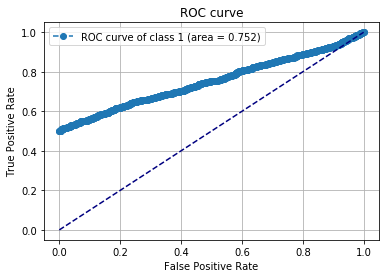

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_22 (Conv2D)           (None, 69, 29, 1)         17        
_________________________________________________________________
batch_normalization_23 (Batc (None, 69, 29, 1)         4         
_________________________________________________________________
activation_23 (Activation)   (None, 69, 29, 1)         0         
_________________________________________________________________
max_pooling2d_21 (MaxPooling (None, 23, 9, 1)          0         
_________________________________________________________________
dropout_20 (Dropout)         (None, 23, 9, 1)          0         
_________________________________________________________________
flatten_20 (Flatten)         (None, 207)               0         
_________________________________________________________________
dense_21 (Dense)             (None, 2)                 416       
Total para

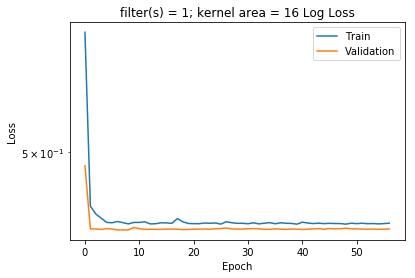

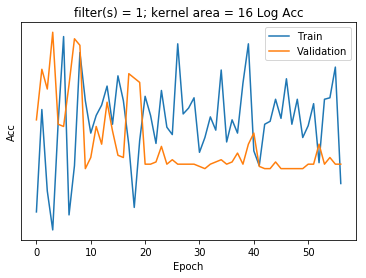

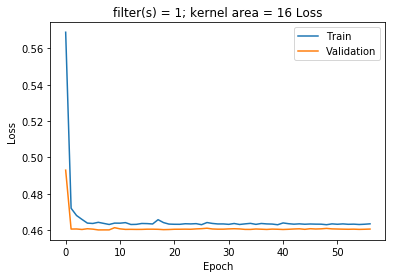

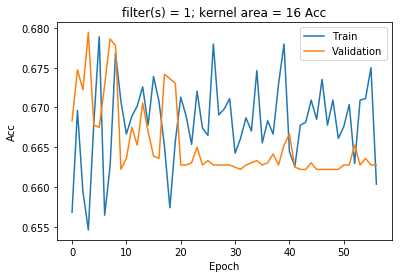

Confusion matrix, without normalization
[[ 177  997]
 [ 180 2243]]
accuracy score:  0.672782874618
0.761206664412 For the label #0


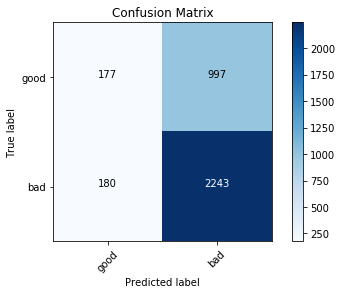

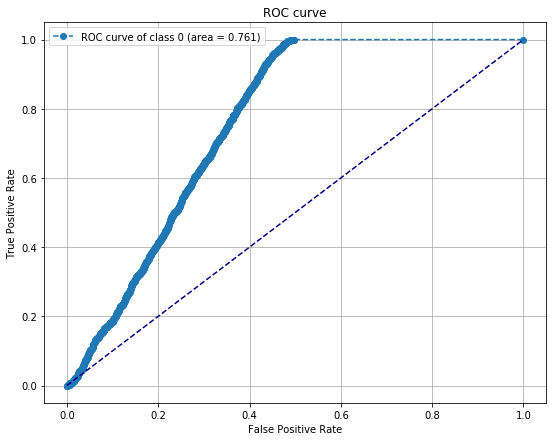

0.761206840184 For the label #1


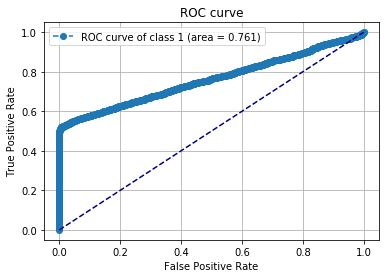

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_23 (Conv2D)           (None, 69, 28, 1)         21        
_________________________________________________________________
batch_normalization_24 (Batc (None, 69, 28, 1)         4         
_________________________________________________________________
activation_24 (Activation)   (None, 69, 28, 1)         0         
_________________________________________________________________
max_pooling2d_22 (MaxPooling (None, 23, 9, 1)          0         
_________________________________________________________________
dropout_21 (Dropout)         (None, 23, 9, 1)          0         
_________________________________________________________________
flatten_21 (Flatten)         (None, 207)               0         
_________________________________________________________________
dense_22 (Dense)             (None, 2)                 416       
Total para

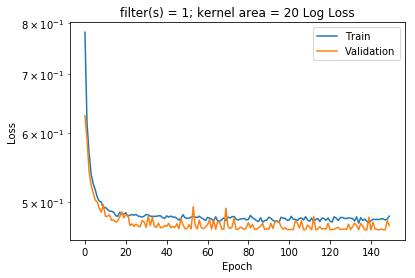

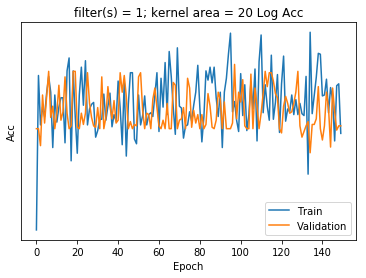

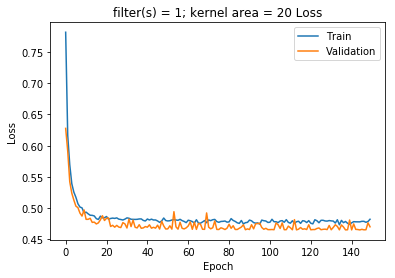

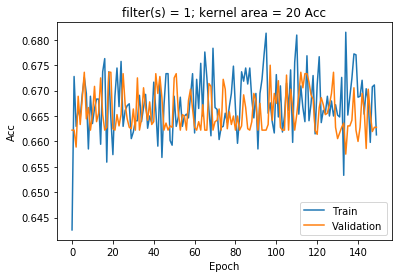

Confusion matrix, without normalization
[[ 375  799]
 [ 409 2014]]
accuracy score:  0.664164581596
0.749225374938 For the label #0


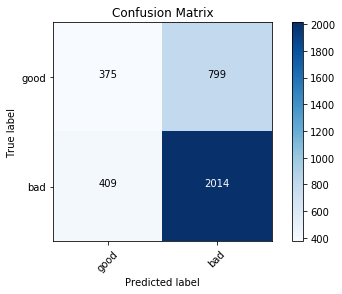

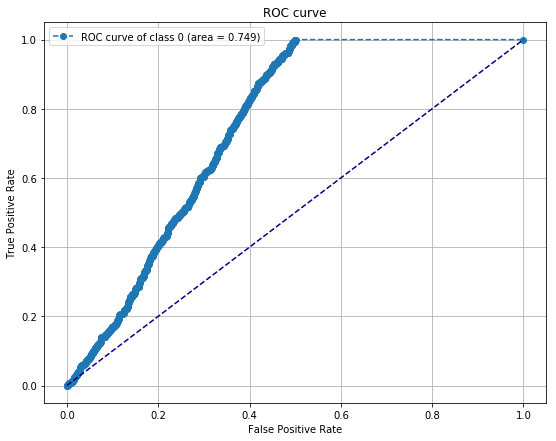

0.749225374938 For the label #1


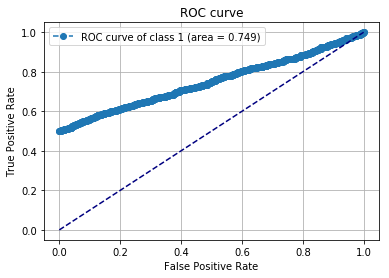

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_24 (Conv2D)           (None, 68, 32, 1)         6         
_________________________________________________________________
batch_normalization_25 (Batc (None, 68, 32, 1)         4         
_________________________________________________________________
activation_25 (Activation)   (None, 68, 32, 1)         0         
_________________________________________________________________
max_pooling2d_23 (MaxPooling (None, 22, 10, 1)         0         
_________________________________________________________________
dropout_22 (Dropout)         (None, 22, 10, 1)         0         
_________________________________________________________________
flatten_22 (Flatten)         (None, 220)               0         
_________________________________________________________________
dense_23 (Dense)             (None, 2)                 442       
Total para

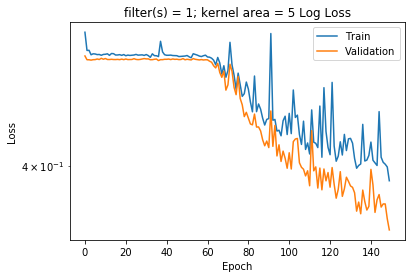

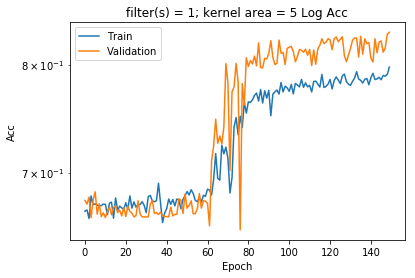

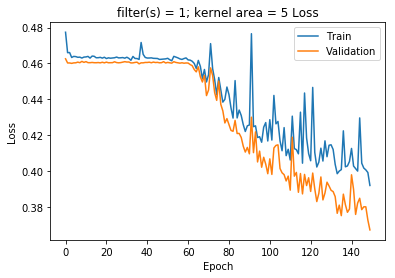

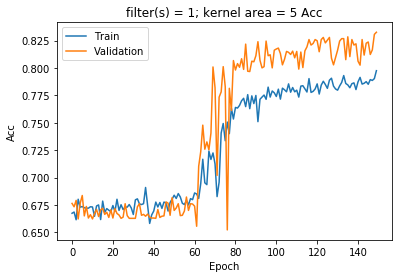

Confusion matrix, without normalization
[[1174    0]
 [ 602 1821]]
accuracy score:  0.832638309703
0.882925098133 For the label #0


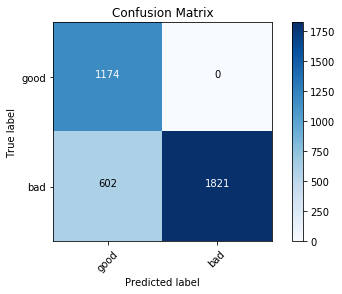

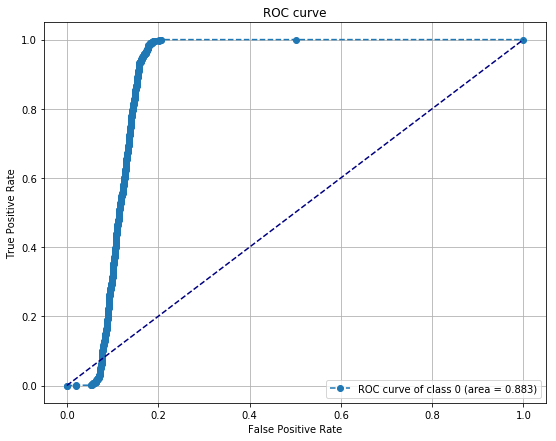

0.882925098133 For the label #1


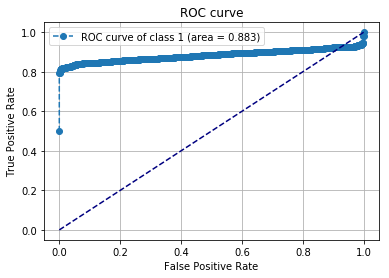

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_25 (Conv2D)           (None, 68, 31, 1)         11        
_________________________________________________________________
batch_normalization_26 (Batc (None, 68, 31, 1)         4         
_________________________________________________________________
activation_26 (Activation)   (None, 68, 31, 1)         0         
_________________________________________________________________
max_pooling2d_24 (MaxPooling (None, 22, 10, 1)         0         
_________________________________________________________________
dropout_23 (Dropout)         (None, 22, 10, 1)         0         
_________________________________________________________________
flatten_23 (Flatten)         (None, 220)               0         
_________________________________________________________________
dense_24 (Dense)             (None, 2)                 442       
Total para

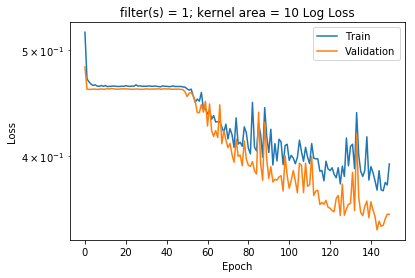

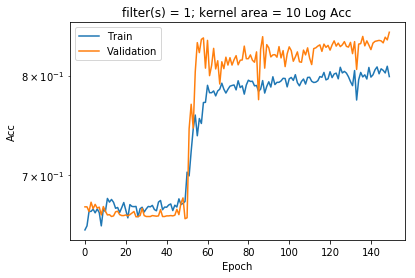

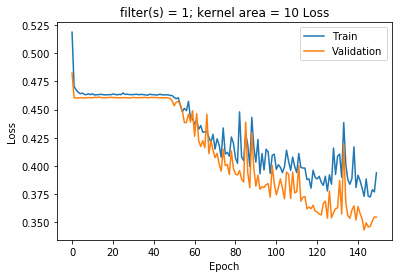

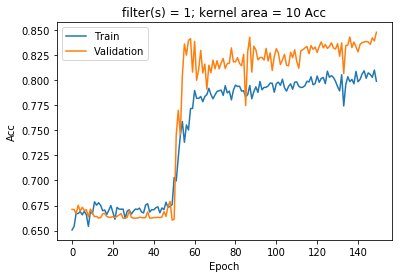

Confusion matrix, without normalization
[[1174    0]
 [ 583 1840]]
accuracy score:  0.837920489297
0.887692197362 For the label #0


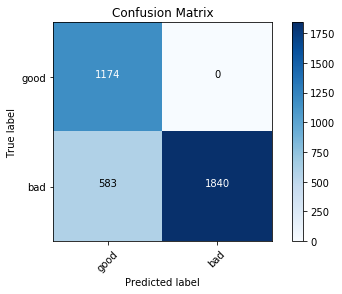

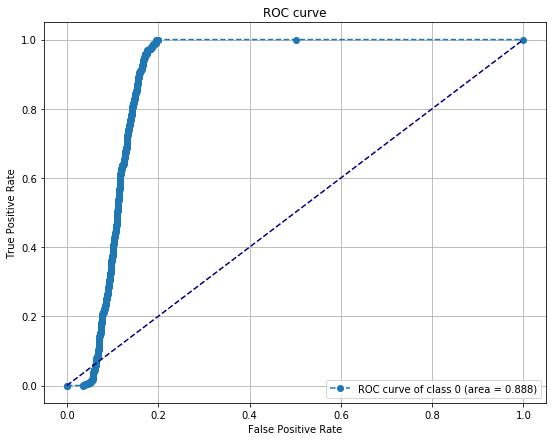

0.887692197362 For the label #1


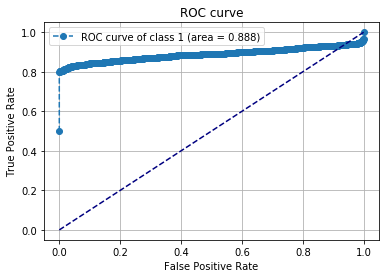

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_26 (Conv2D)           (None, 68, 30, 1)         16        
_________________________________________________________________
batch_normalization_27 (Batc (None, 68, 30, 1)         4         
_________________________________________________________________
activation_27 (Activation)   (None, 68, 30, 1)         0         
_________________________________________________________________
max_pooling2d_25 (MaxPooling (None, 22, 10, 1)         0         
_________________________________________________________________
dropout_24 (Dropout)         (None, 22, 10, 1)         0         
_________________________________________________________________
flatten_24 (Flatten)         (None, 220)               0         
_________________________________________________________________
dense_25 (Dense)             (None, 2)                 442       
Total para

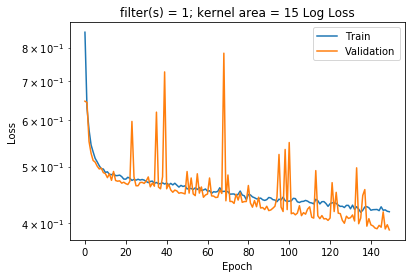

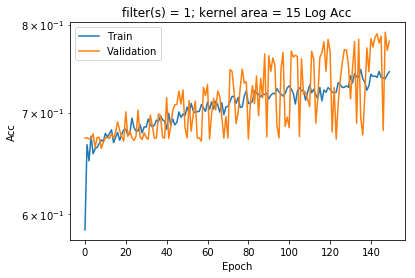

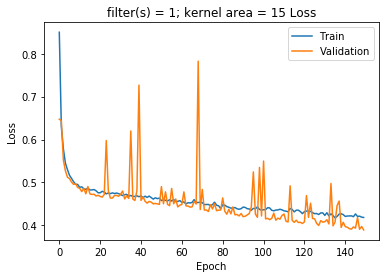

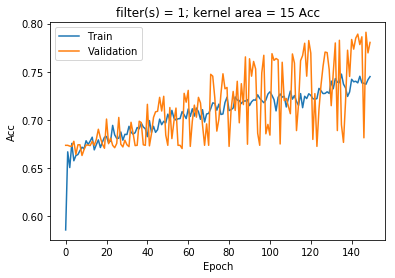

Confusion matrix, without normalization
[[1022  152]
 [ 638 1785]]
accuracy score:  0.780372532666
0.844154999539 For the label #0


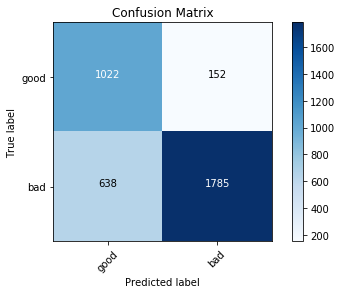

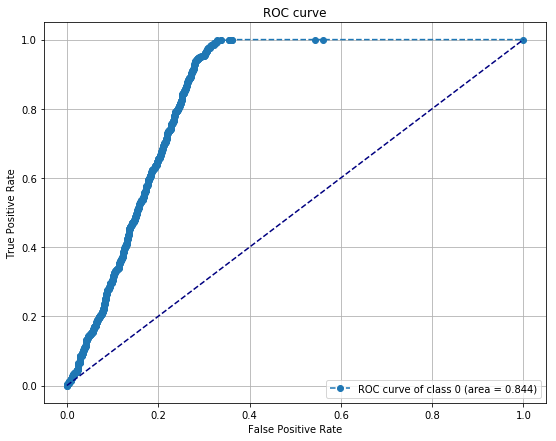

0.844155351083 For the label #1


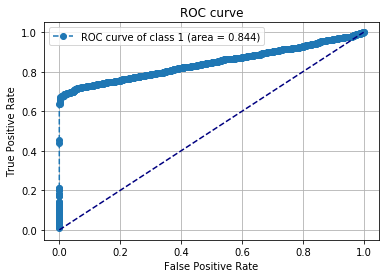

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_27 (Conv2D)           (None, 68, 29, 1)         21        
_________________________________________________________________
batch_normalization_28 (Batc (None, 68, 29, 1)         4         
_________________________________________________________________
activation_28 (Activation)   (None, 68, 29, 1)         0         
_________________________________________________________________
max_pooling2d_26 (MaxPooling (None, 22, 9, 1)          0         
_________________________________________________________________
dropout_25 (Dropout)         (None, 22, 9, 1)          0         
_________________________________________________________________
flatten_25 (Flatten)         (None, 198)               0         
_________________________________________________________________
dense_26 (Dense)             (None, 2)                 398       
Total para

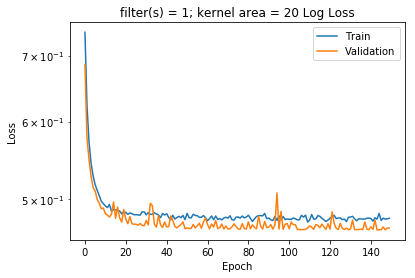

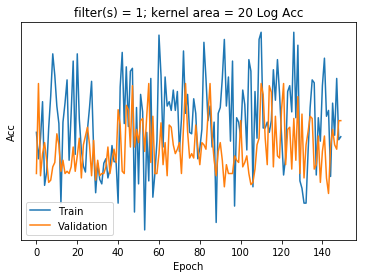

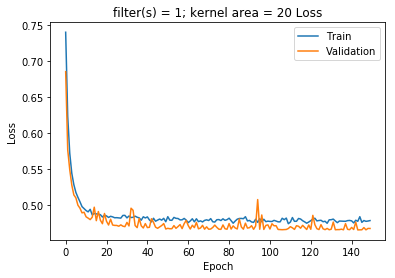

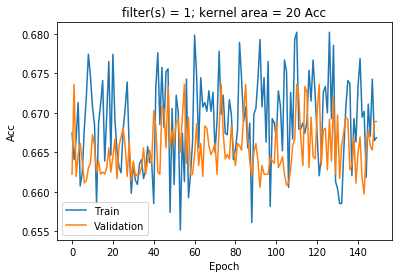

Confusion matrix, without normalization
[[ 399  775]
 [ 449 1974]]
accuracy score:  0.659716430359
0.74761284707 For the label #0


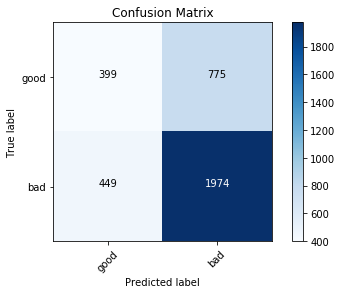

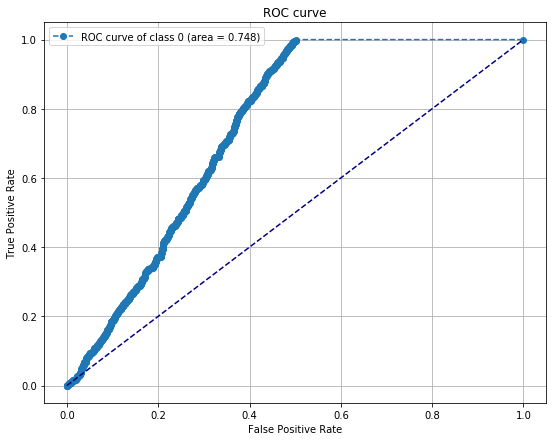

0.74761284707 For the label #1


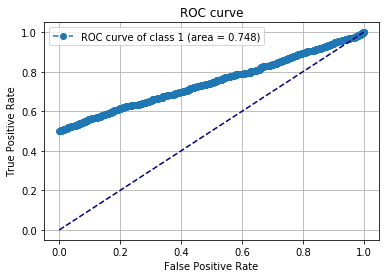

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_28 (Conv2D)           (None, 68, 28, 1)         26        
_________________________________________________________________
batch_normalization_29 (Batc (None, 68, 28, 1)         4         
_________________________________________________________________
activation_29 (Activation)   (None, 68, 28, 1)         0         
_________________________________________________________________
max_pooling2d_27 (MaxPooling (None, 22, 9, 1)          0         
_________________________________________________________________
dropout_26 (Dropout)         (None, 22, 9, 1)          0         
_________________________________________________________________
flatten_26 (Flatten)         (None, 198)               0         
_________________________________________________________________
dense_27 (Dense)             (None, 2)                 398       
Total para

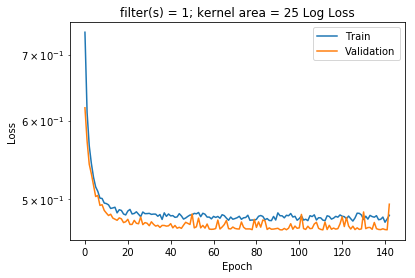

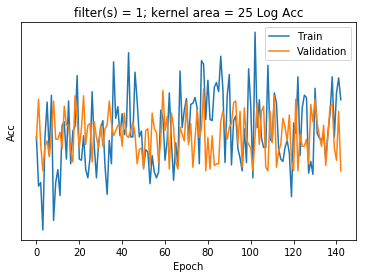

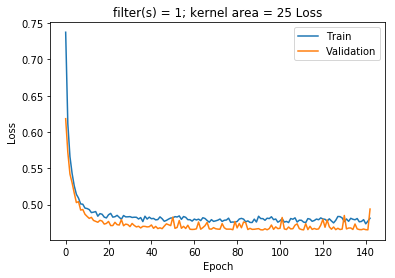

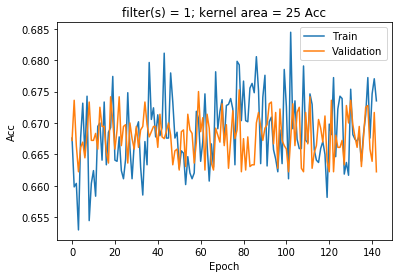

Confusion matrix, without normalization
[[ 575  599]
 [ 577 1846]]
accuracy score:  0.67306088407
0.752839764579 For the label #0


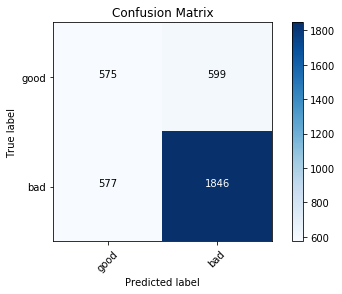

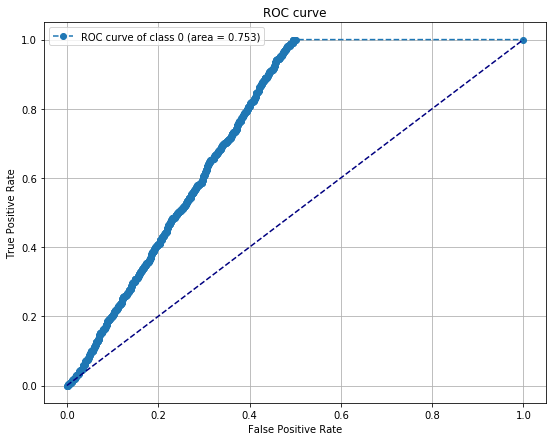

0.752839237264 For the label #1


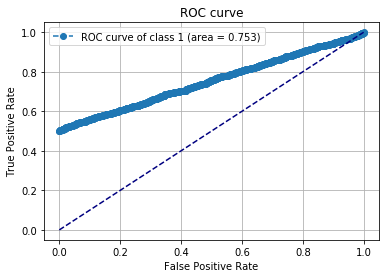

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_29 (Conv2D)           (None, 72, 32, 2)         4         
_________________________________________________________________
batch_normalization_30 (Batc (None, 72, 32, 2)         8         
_________________________________________________________________
activation_30 (Activation)   (None, 72, 32, 2)         0         
_________________________________________________________________
max_pooling2d_28 (MaxPooling (None, 24, 10, 2)         0         
_________________________________________________________________
dropout_27 (Dropout)         (None, 24, 10, 2)         0         
_________________________________________________________________
flatten_27 (Flatten)         (None, 480)               0         
_________________________________________________________________
dense_28 (Dense)             (None, 2)                 962       
Total para

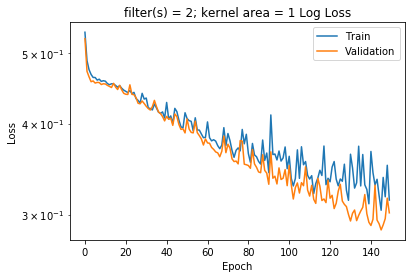

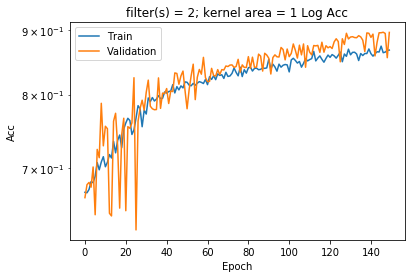

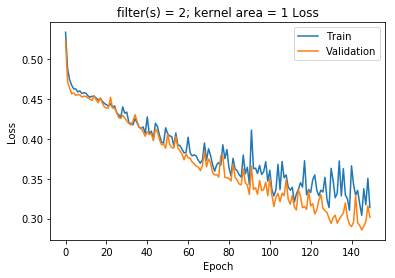

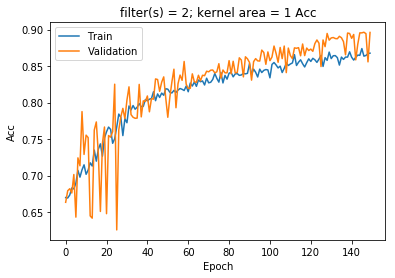

Confusion matrix, without normalization
[[1174    0]
 [ 376 2047]]
accuracy score:  0.895468445927
0.927198778599 For the label #0


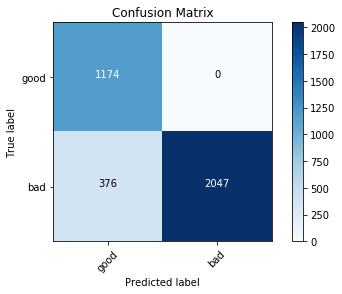

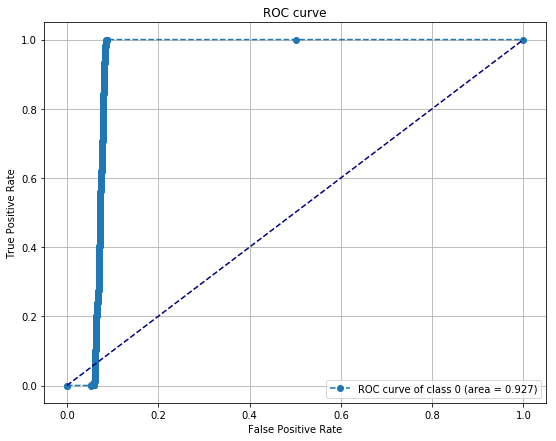

0.927199305913 For the label #1


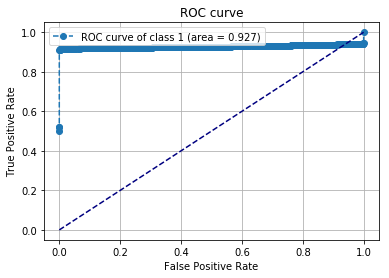

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_30 (Conv2D)           (None, 72, 31, 2)         6         
_________________________________________________________________
batch_normalization_31 (Batc (None, 72, 31, 2)         8         
_________________________________________________________________
activation_31 (Activation)   (None, 72, 31, 2)         0         
_________________________________________________________________
max_pooling2d_29 (MaxPooling (None, 24, 10, 2)         0         
_________________________________________________________________
dropout_28 (Dropout)         (None, 24, 10, 2)         0         
_________________________________________________________________
flatten_28 (Flatten)         (None, 480)               0         
_________________________________________________________________
dense_29 (Dense)             (None, 2)                 962       
Total para

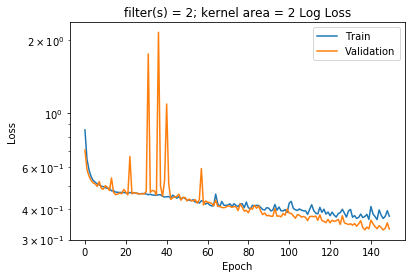

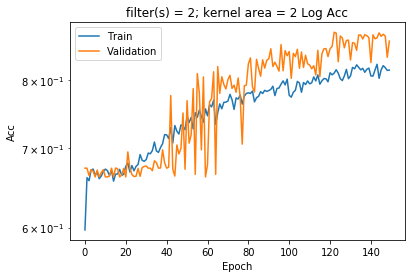

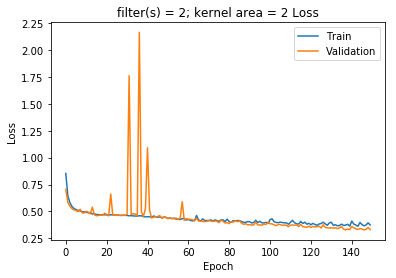

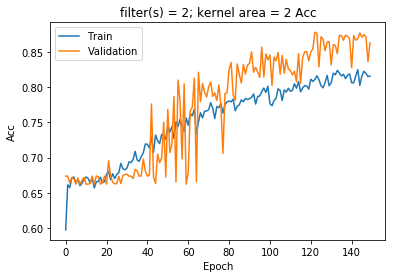

Confusion matrix, without normalization
[[1174    0]
 [ 452 1971]]
accuracy score:  0.874339727551
0.898422520971 For the label #0


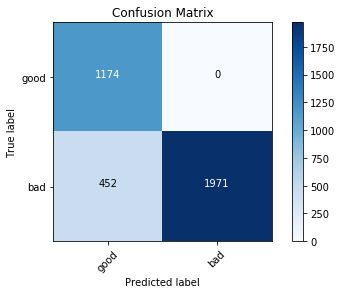

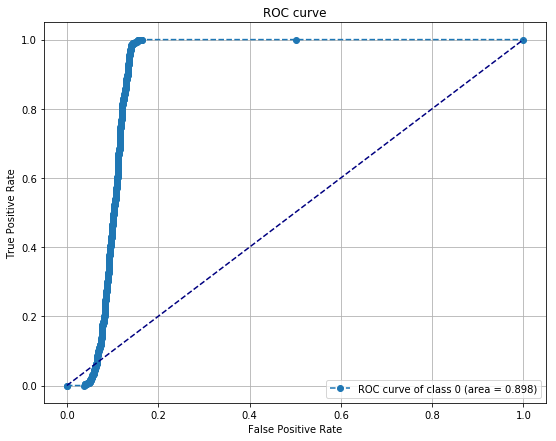

0.898422520971 For the label #1


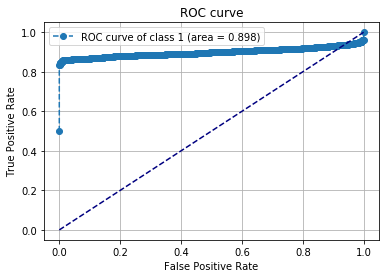

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_31 (Conv2D)           (None, 72, 30, 2)         8         
_________________________________________________________________
batch_normalization_32 (Batc (None, 72, 30, 2)         8         
_________________________________________________________________
activation_32 (Activation)   (None, 72, 30, 2)         0         
_________________________________________________________________
max_pooling2d_30 (MaxPooling (None, 24, 10, 2)         0         
_________________________________________________________________
dropout_29 (Dropout)         (None, 24, 10, 2)         0         
_________________________________________________________________
flatten_29 (Flatten)         (None, 480)               0         
_________________________________________________________________
dense_30 (Dense)             (None, 2)                 962       
Total para

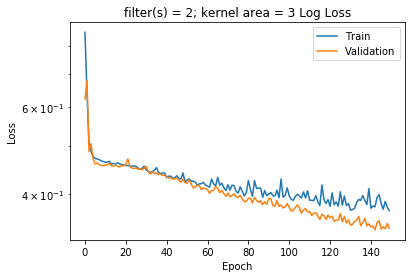

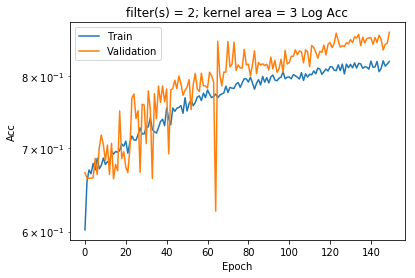

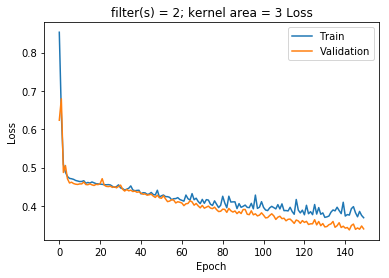

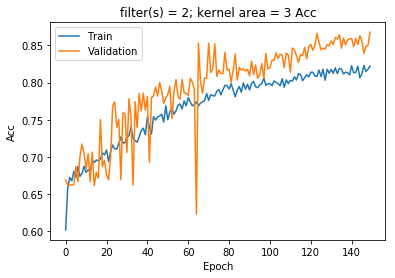

Confusion matrix, without normalization
[[1174    0]
 [ 506 1917]]
accuracy score:  0.859327217125
0.902606937631 For the label #0


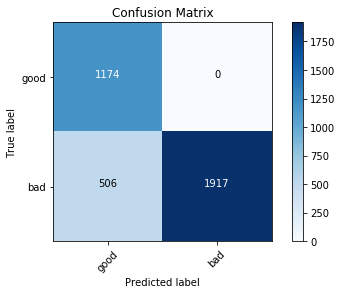

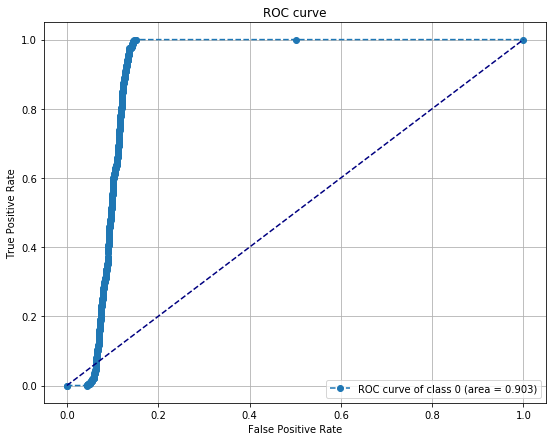

0.902606937631 For the label #1


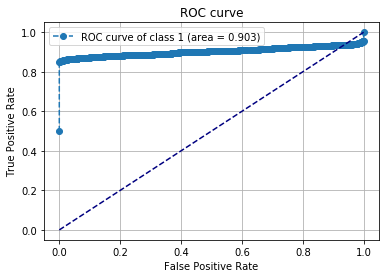

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_32 (Conv2D)           (None, 72, 29, 2)         10        
_________________________________________________________________
batch_normalization_33 (Batc (None, 72, 29, 2)         8         
_________________________________________________________________
activation_33 (Activation)   (None, 72, 29, 2)         0         
_________________________________________________________________
max_pooling2d_31 (MaxPooling (None, 24, 9, 2)          0         
_________________________________________________________________
dropout_30 (Dropout)         (None, 24, 9, 2)          0         
_________________________________________________________________
flatten_30 (Flatten)         (None, 432)               0         
_________________________________________________________________
dense_31 (Dense)             (None, 2)                 866       
Total para

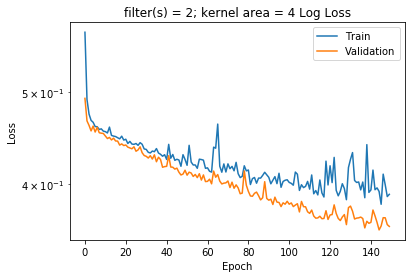

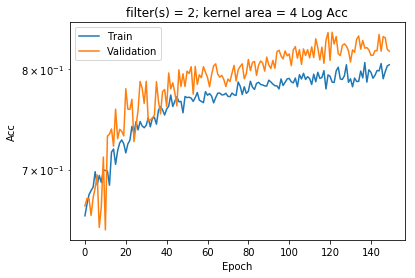

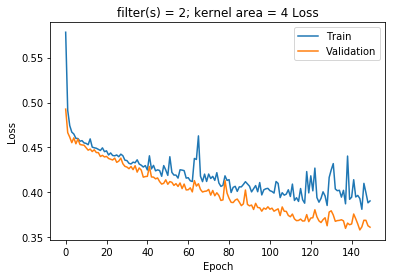

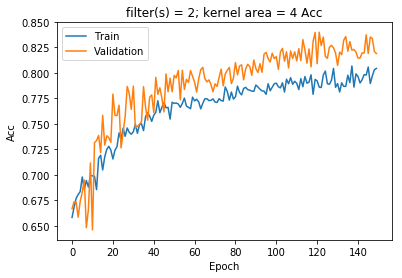

Confusion matrix, without normalization
[[1174    0]
 [ 585 1838]]
accuracy score:  0.837364470392
0.877315350267 For the label #0


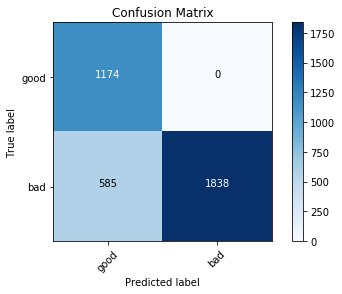

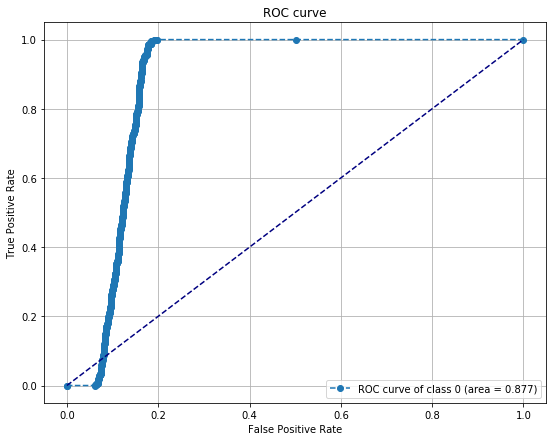

0.877315350267 For the label #1


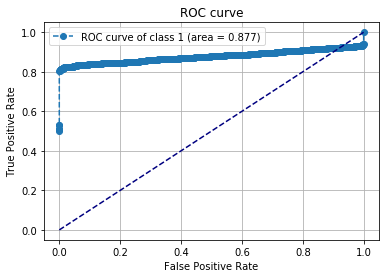

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_33 (Conv2D)           (None, 72, 28, 2)         12        
_________________________________________________________________
batch_normalization_34 (Batc (None, 72, 28, 2)         8         
_________________________________________________________________
activation_34 (Activation)   (None, 72, 28, 2)         0         
_________________________________________________________________
max_pooling2d_32 (MaxPooling (None, 24, 9, 2)          0         
_________________________________________________________________
dropout_31 (Dropout)         (None, 24, 9, 2)          0         
_________________________________________________________________
flatten_31 (Flatten)         (None, 432)               0         
_________________________________________________________________
dense_32 (Dense)             (None, 2)                 866       
Total para

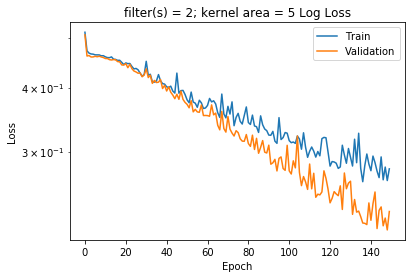

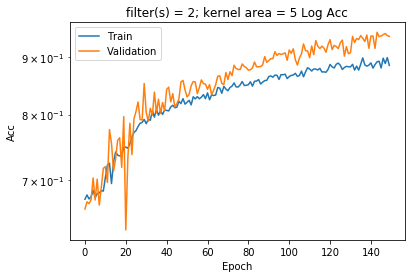

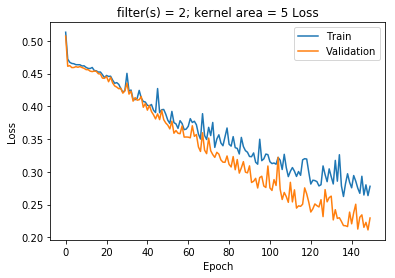

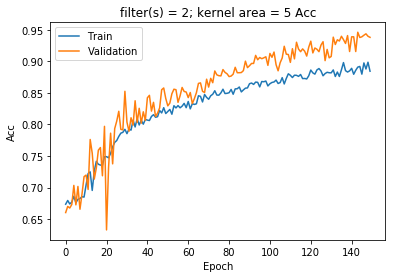

Confusion matrix, without normalization
[[1174    0]
 [ 216 2207]]
accuracy score:  0.939949958299
0.971254678159 For the label #0


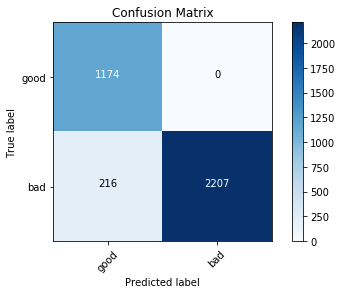

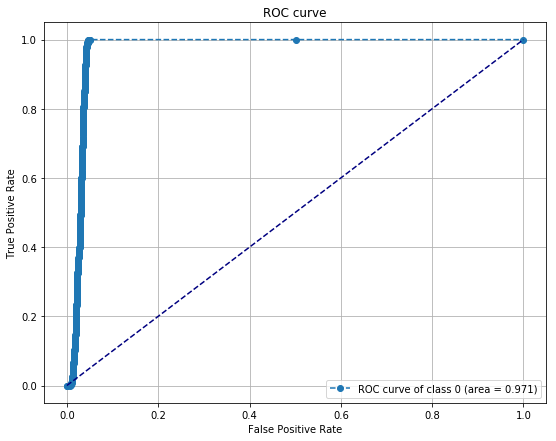

0.971254678159 For the label #1


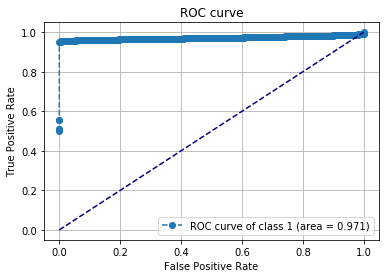

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_34 (Conv2D)           (None, 71, 32, 2)         6         
_________________________________________________________________
batch_normalization_35 (Batc (None, 71, 32, 2)         8         
_________________________________________________________________
activation_35 (Activation)   (None, 71, 32, 2)         0         
_________________________________________________________________
max_pooling2d_33 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_32 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_32 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_33 (Dense)             (None, 2)                 922       
Total para

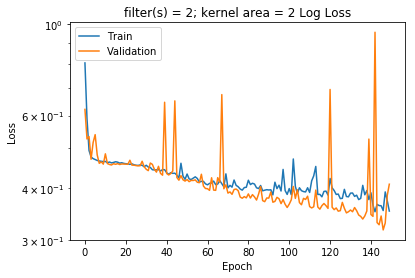

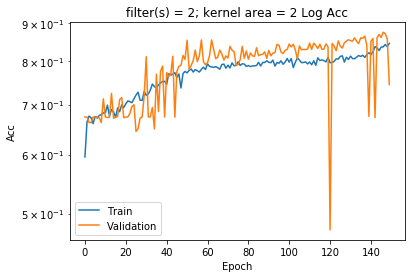

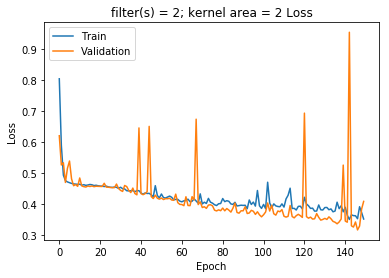

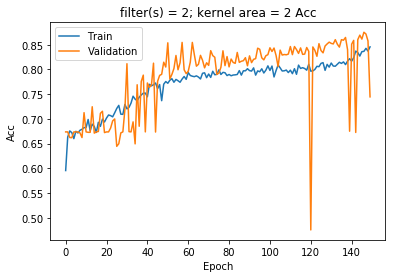

Confusion matrix, without normalization
[[1174    0]
 [ 449 1974]]
accuracy score:  0.875173755908
0.921091597348 For the label #0


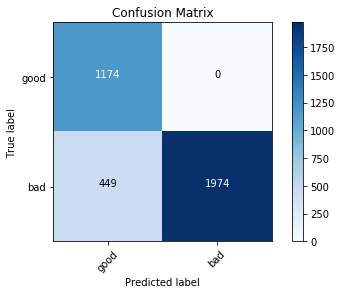

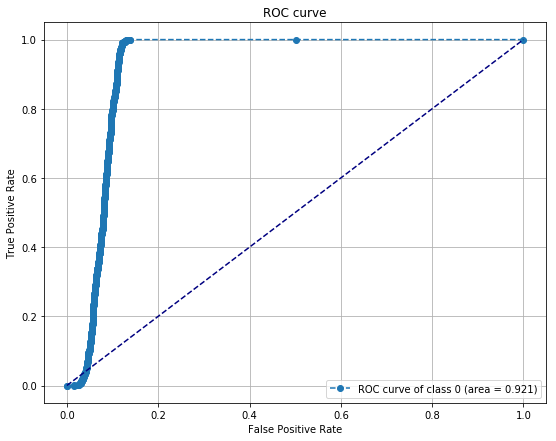

0.921091597348 For the label #1


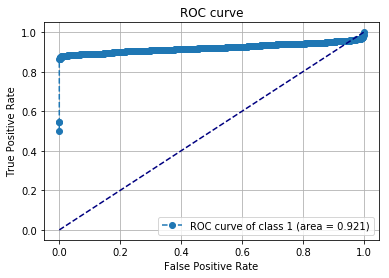

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_35 (Conv2D)           (None, 71, 31, 2)         10        
_________________________________________________________________
batch_normalization_36 (Batc (None, 71, 31, 2)         8         
_________________________________________________________________
activation_36 (Activation)   (None, 71, 31, 2)         0         
_________________________________________________________________
max_pooling2d_34 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_33 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_33 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_34 (Dense)             (None, 2)                 922       
Total para

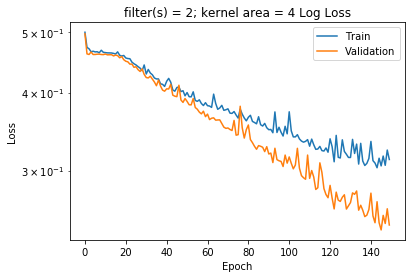

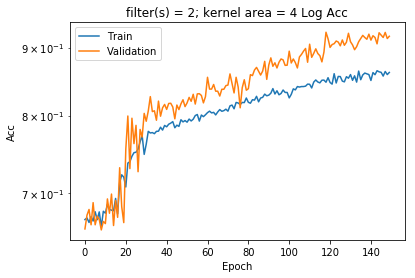

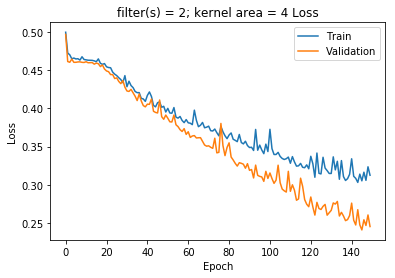

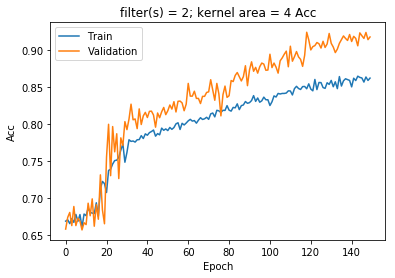

Confusion matrix, without normalization
[[1174    0]
 [ 290 2133]]
accuracy score:  0.919377258827
0.965156812798 For the label #0


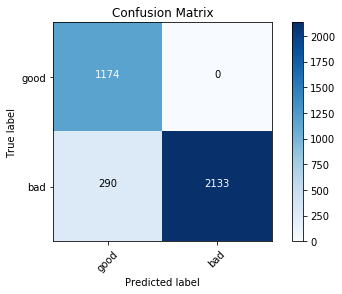

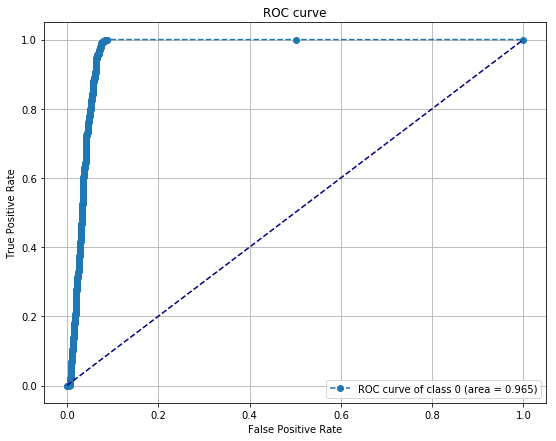

0.965156812798 For the label #1


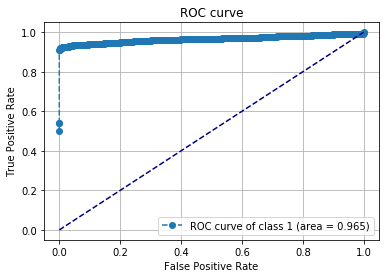

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_36 (Conv2D)           (None, 71, 30, 2)         14        
_________________________________________________________________
batch_normalization_37 (Batc (None, 71, 30, 2)         8         
_________________________________________________________________
activation_37 (Activation)   (None, 71, 30, 2)         0         
_________________________________________________________________
max_pooling2d_35 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_34 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_34 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_35 (Dense)             (None, 2)                 922       
Total para

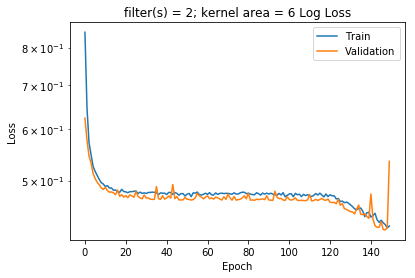

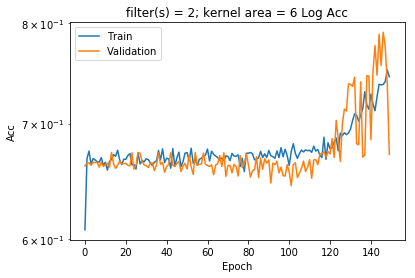

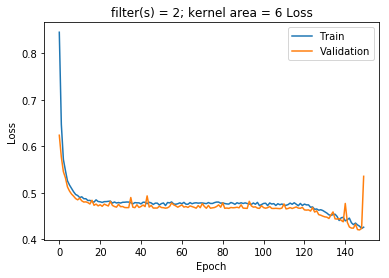

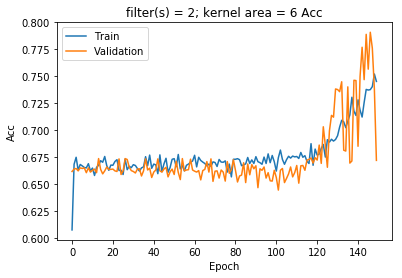

Confusion matrix, without normalization
[[1164   10]
 [ 796 1627]]
accuracy score:  0.775924381429
0.847396050484 For the label #0


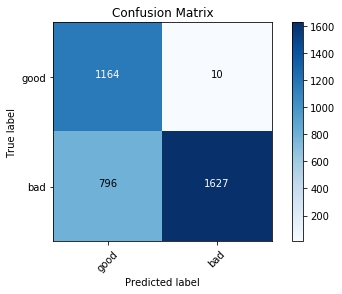

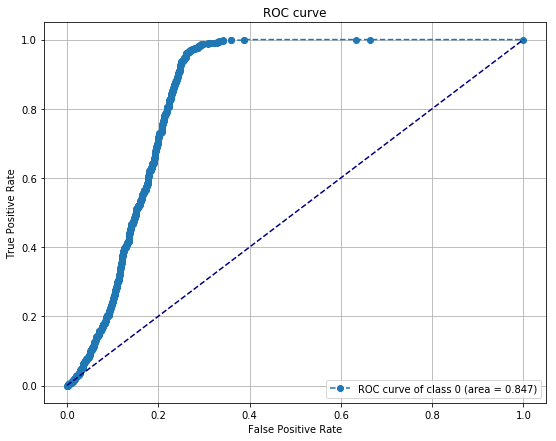

0.847396050484 For the label #1


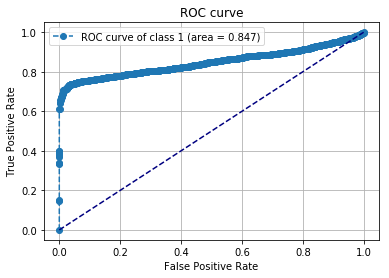

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_37 (Conv2D)           (None, 71, 29, 2)         18        
_________________________________________________________________
batch_normalization_38 (Batc (None, 71, 29, 2)         8         
_________________________________________________________________
activation_38 (Activation)   (None, 71, 29, 2)         0         
_________________________________________________________________
max_pooling2d_36 (MaxPooling (None, 23, 9, 2)          0         
_________________________________________________________________
dropout_35 (Dropout)         (None, 23, 9, 2)          0         
_________________________________________________________________
flatten_35 (Flatten)         (None, 414)               0         
_________________________________________________________________
dense_36 (Dense)             (None, 2)                 830       
Total para

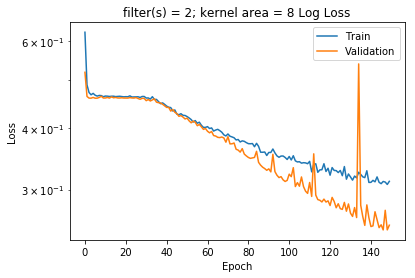

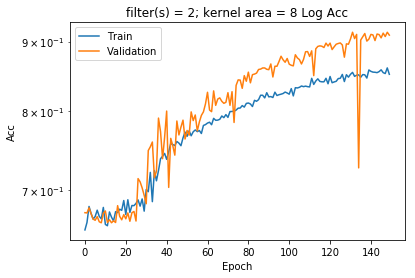

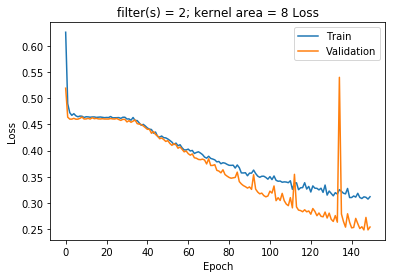

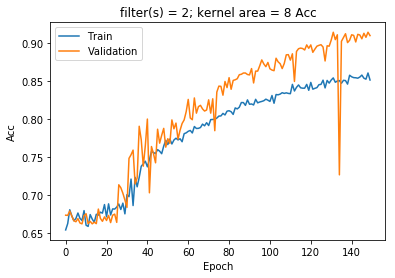

Confusion matrix, without normalization
[[1173    1]
 [ 312 2111]]
accuracy score:  0.912983041423
0.951699921465 For the label #0


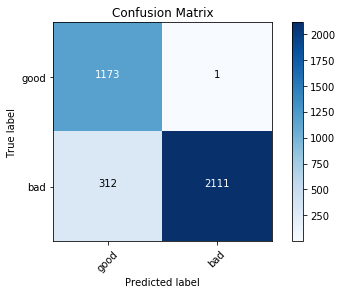

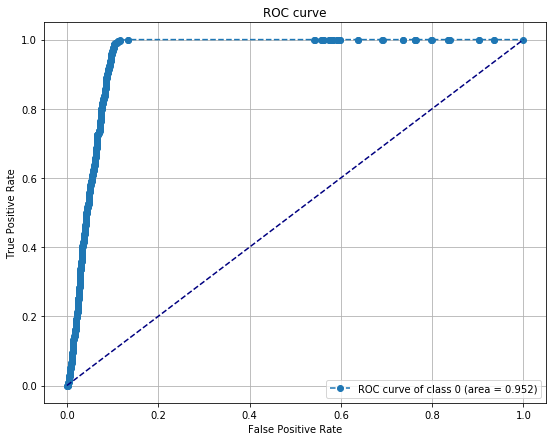

0.951699921465 For the label #1


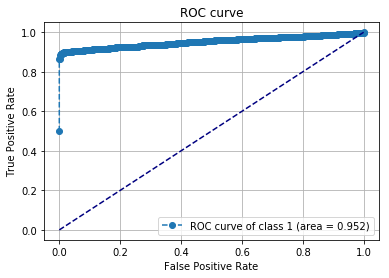

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_38 (Conv2D)           (None, 71, 28, 2)         22        
_________________________________________________________________
batch_normalization_39 (Batc (None, 71, 28, 2)         8         
_________________________________________________________________
activation_39 (Activation)   (None, 71, 28, 2)         0         
_________________________________________________________________
max_pooling2d_37 (MaxPooling (None, 23, 9, 2)          0         
_________________________________________________________________
dropout_36 (Dropout)         (None, 23, 9, 2)          0         
_________________________________________________________________
flatten_36 (Flatten)         (None, 414)               0         
_________________________________________________________________
dense_37 (Dense)             (None, 2)                 830       
Total para

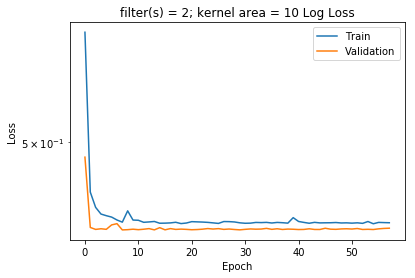

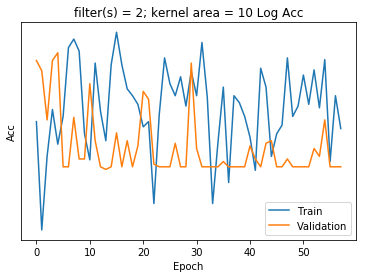

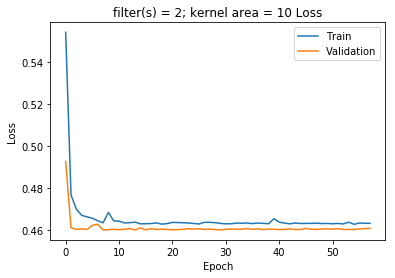

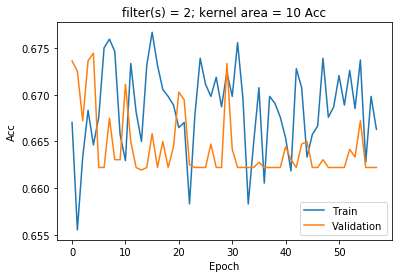

Confusion matrix, without normalization
[[ 651  523]
 [ 673 1750]]
accuracy score:  0.667500695024
0.7526181167 For the label #0


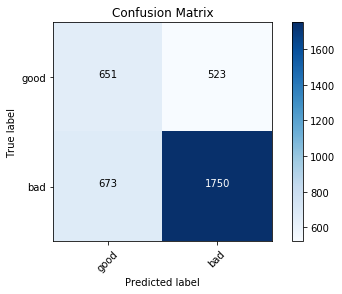

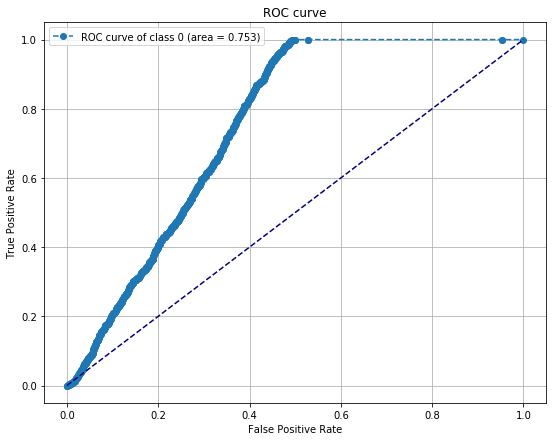

0.752617765157 For the label #1


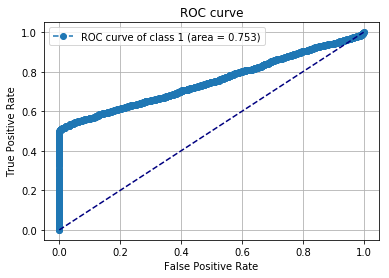

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_39 (Conv2D)           (None, 70, 32, 2)         8         
_________________________________________________________________
batch_normalization_40 (Batc (None, 70, 32, 2)         8         
_________________________________________________________________
activation_40 (Activation)   (None, 70, 32, 2)         0         
_________________________________________________________________
max_pooling2d_38 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_37 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_37 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_38 (Dense)             (None, 2)                 922       
Total para

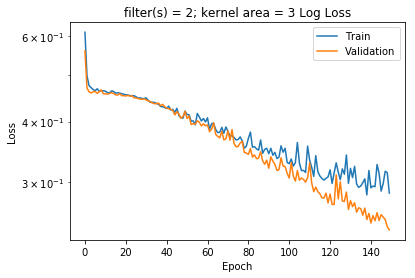

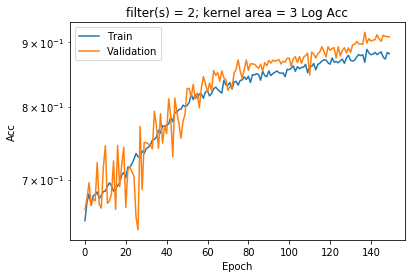

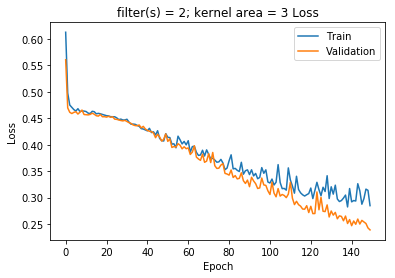

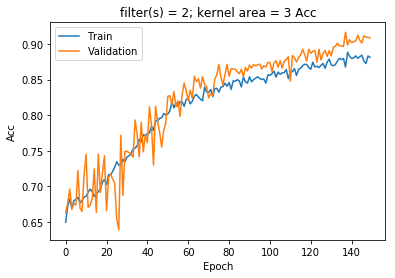

Confusion matrix, without normalization
[[1174    0]
 [ 328 2095]]
accuracy score:  0.908812899639
0.954142266651 For the label #0


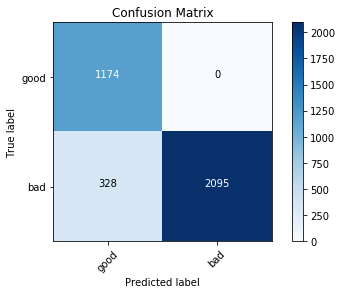

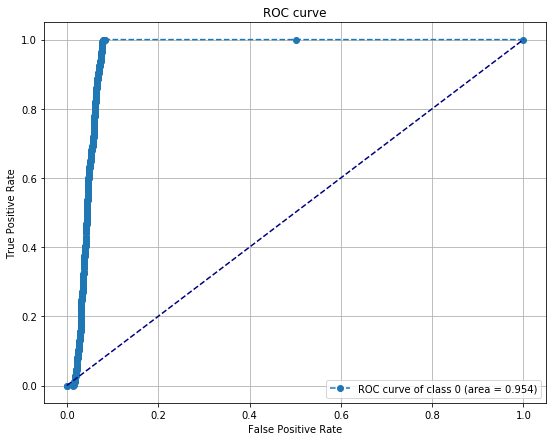

0.954142266651 For the label #1


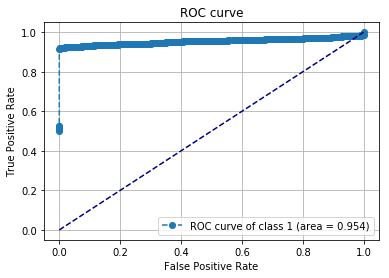

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_40 (Conv2D)           (None, 70, 31, 2)         14        
_________________________________________________________________
batch_normalization_41 (Batc (None, 70, 31, 2)         8         
_________________________________________________________________
activation_41 (Activation)   (None, 70, 31, 2)         0         
_________________________________________________________________
max_pooling2d_39 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_38 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_38 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_39 (Dense)             (None, 2)                 922       
Total para

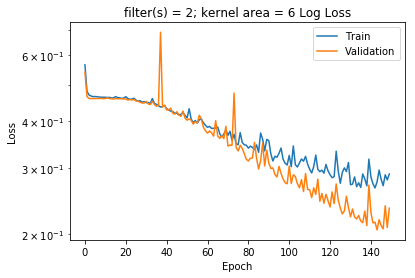

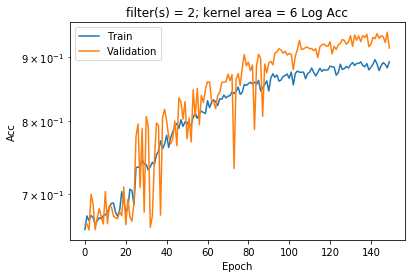

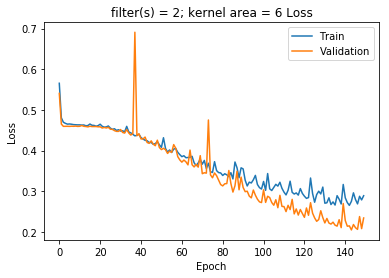

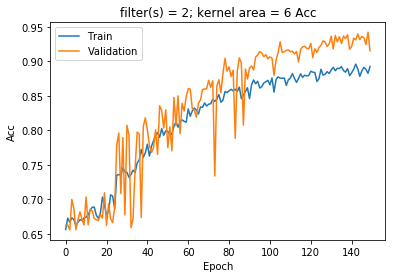

Confusion matrix, without normalization
[[1173    1]
 [ 215 2208]]
accuracy score:  0.939949958299
0.970210771138 For the label #0


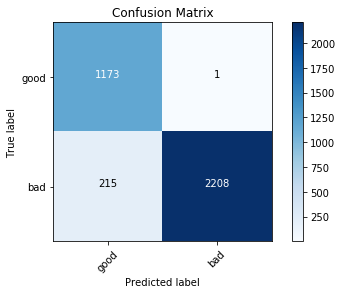

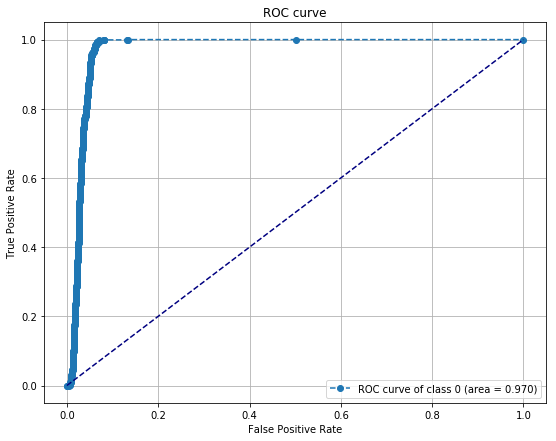

0.970210771138 For the label #1


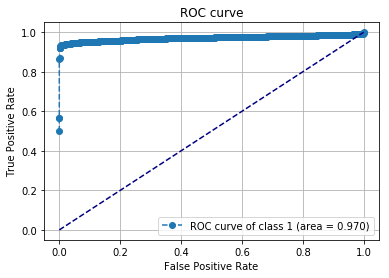

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_41 (Conv2D)           (None, 70, 30, 2)         20        
_________________________________________________________________
batch_normalization_42 (Batc (None, 70, 30, 2)         8         
_________________________________________________________________
activation_42 (Activation)   (None, 70, 30, 2)         0         
_________________________________________________________________
max_pooling2d_40 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_39 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_39 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_40 (Dense)             (None, 2)                 922       
Total para

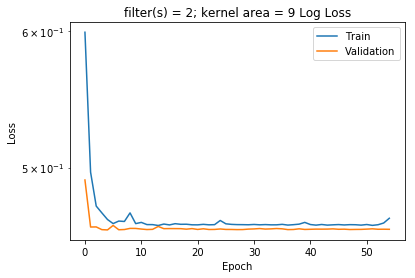

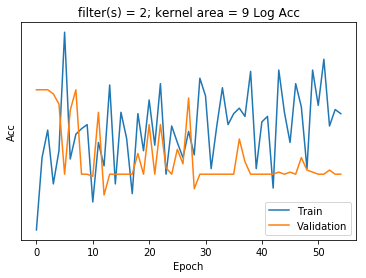

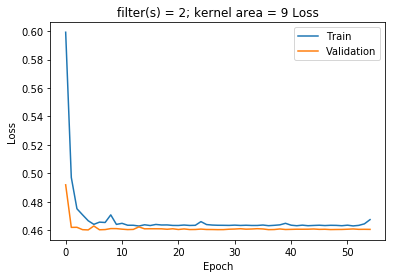

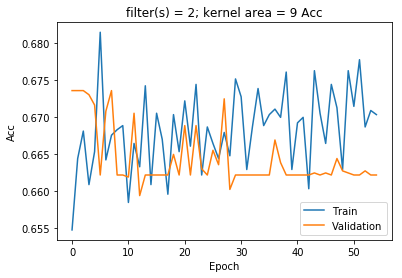

Confusion matrix, without normalization
[[ 136 1038]
 [ 143 2280]]
accuracy score:  0.671670836808
0.754198126838 For the label #0


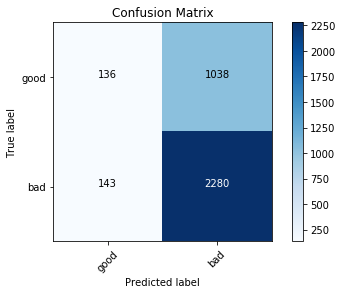

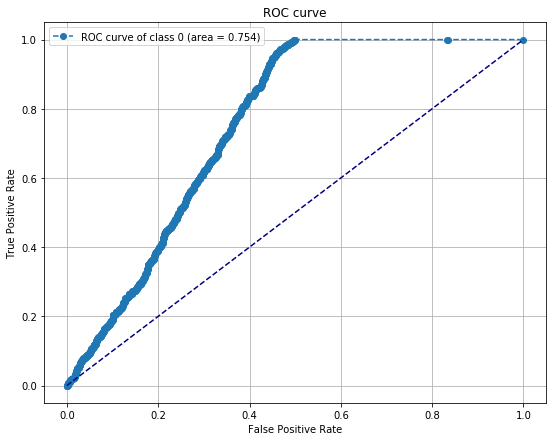

0.754197775295 For the label #1


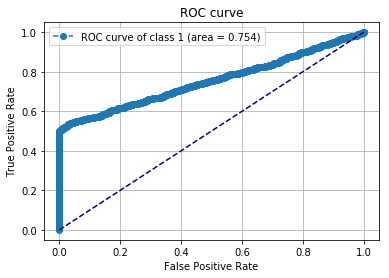

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_42 (Conv2D)           (None, 70, 29, 2)         26        
_________________________________________________________________
batch_normalization_43 (Batc (None, 70, 29, 2)         8         
_________________________________________________________________
activation_43 (Activation)   (None, 70, 29, 2)         0         
_________________________________________________________________
max_pooling2d_41 (MaxPooling (None, 23, 9, 2)          0         
_________________________________________________________________
dropout_40 (Dropout)         (None, 23, 9, 2)          0         
_________________________________________________________________
flatten_40 (Flatten)         (None, 414)               0         
_________________________________________________________________
dense_41 (Dense)             (None, 2)                 830       
Total para

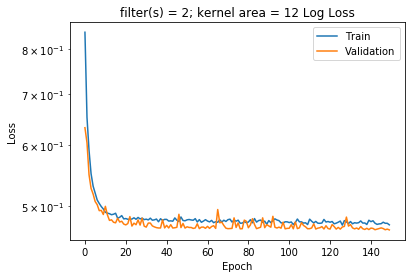

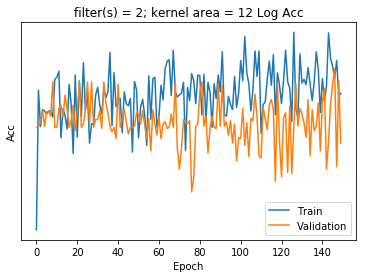

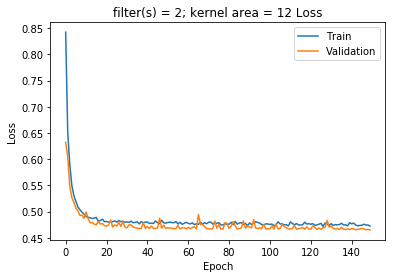

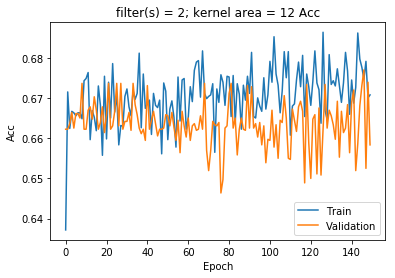

Confusion matrix, without normalization
[[ 472  702]
 [ 527 1896]]
accuracy score:  0.658326383097
0.743150711418 For the label #0


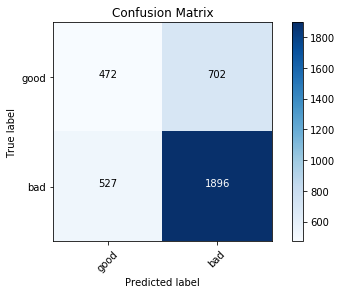

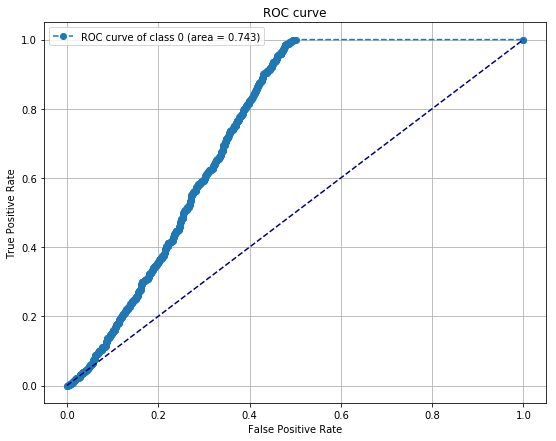

0.743150711418 For the label #1


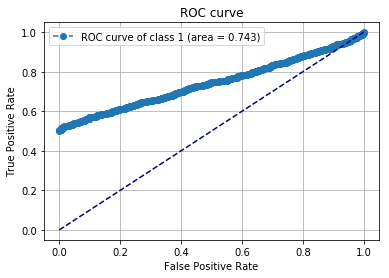

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_43 (Conv2D)           (None, 70, 28, 2)         32        
_________________________________________________________________
batch_normalization_44 (Batc (None, 70, 28, 2)         8         
_________________________________________________________________
activation_44 (Activation)   (None, 70, 28, 2)         0         
_________________________________________________________________
max_pooling2d_42 (MaxPooling (None, 23, 9, 2)          0         
_________________________________________________________________
dropout_41 (Dropout)         (None, 23, 9, 2)          0         
_________________________________________________________________
flatten_41 (Flatten)         (None, 414)               0         
_________________________________________________________________
dense_42 (Dense)             (None, 2)                 830       
Total para

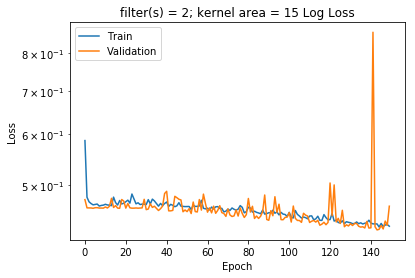

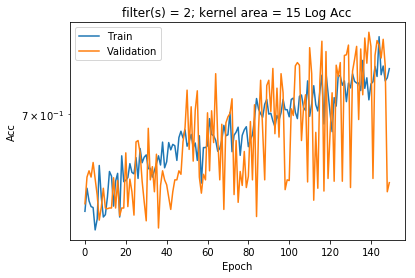

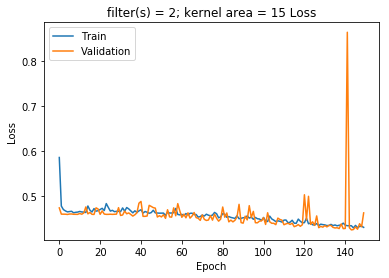

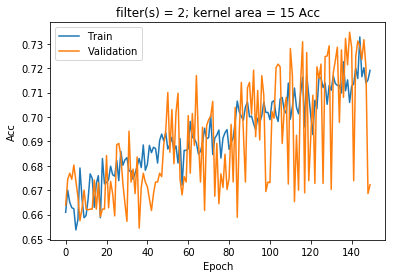

Confusion matrix, without normalization
[[ 984  190]
 [ 777 1646]]
accuracy score:  0.731164859605
0.798333826665 For the label #0


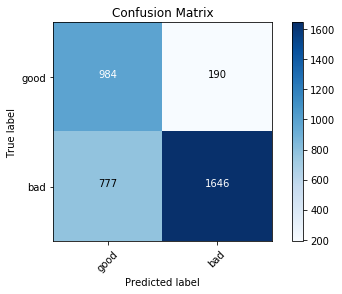

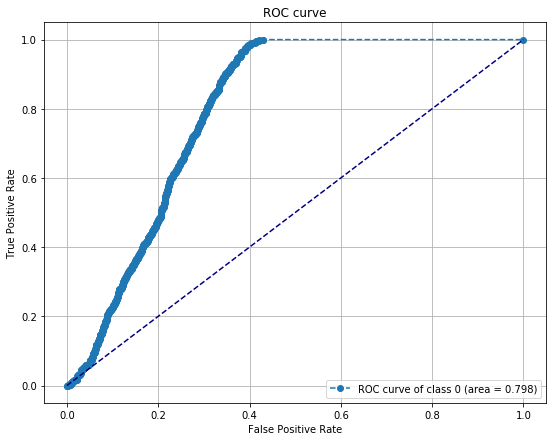

0.798333650894 For the label #1


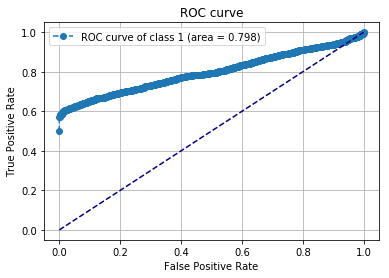

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_44 (Conv2D)           (None, 69, 32, 2)         10        
_________________________________________________________________
batch_normalization_45 (Batc (None, 69, 32, 2)         8         
_________________________________________________________________
activation_45 (Activation)   (None, 69, 32, 2)         0         
_________________________________________________________________
max_pooling2d_43 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_42 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_42 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_43 (Dense)             (None, 2)                 922       
Total para

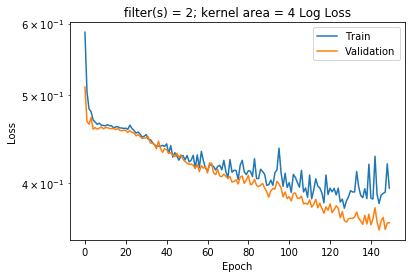

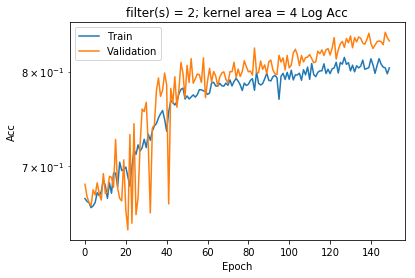

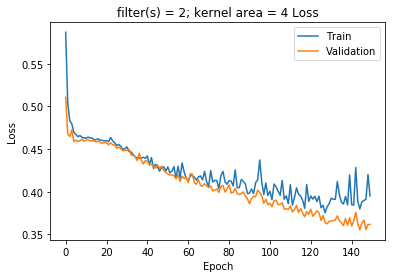

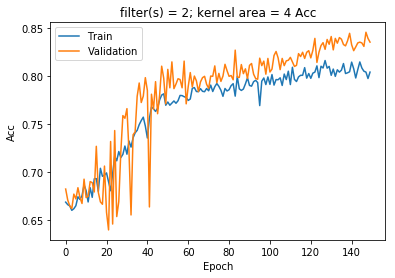

Confusion matrix, without normalization
[[1174    0]
 [ 592 1831]]
accuracy score:  0.835418404226
0.87516425848 For the label #0


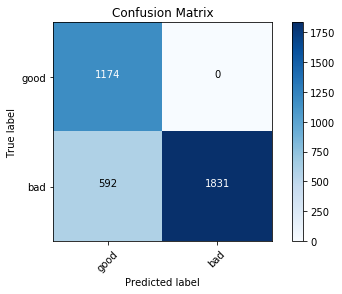

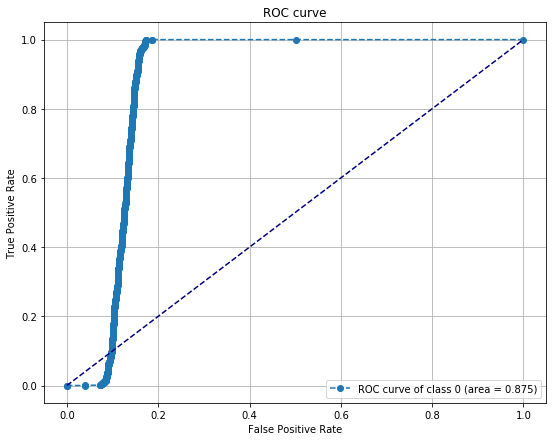

0.87516425848 For the label #1


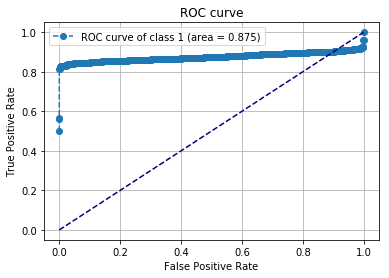

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_45 (Conv2D)           (None, 69, 31, 2)         18        
_________________________________________________________________
batch_normalization_46 (Batc (None, 69, 31, 2)         8         
_________________________________________________________________
activation_46 (Activation)   (None, 69, 31, 2)         0         
_________________________________________________________________
max_pooling2d_44 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_43 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_43 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_44 (Dense)             (None, 2)                 922       
Total para

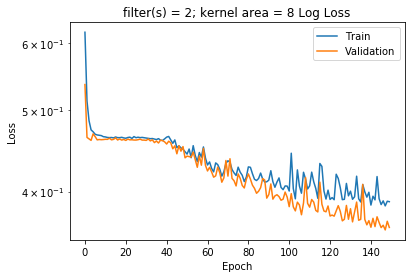

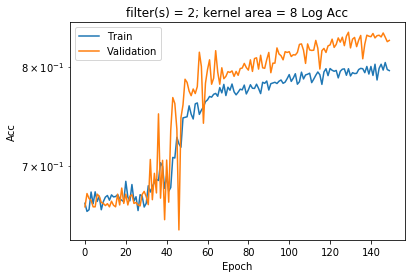

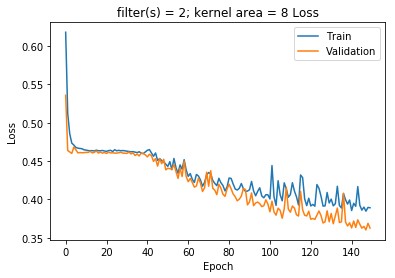

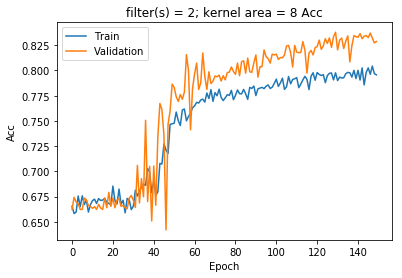

Confusion matrix, without normalization
[[1174    0]
 [ 603 1820]]
accuracy score:  0.83236030025
0.876659370977 For the label #0


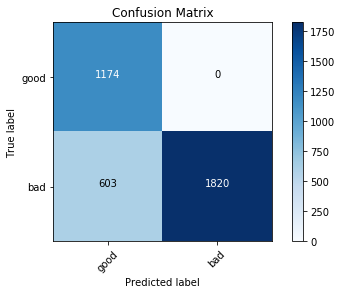

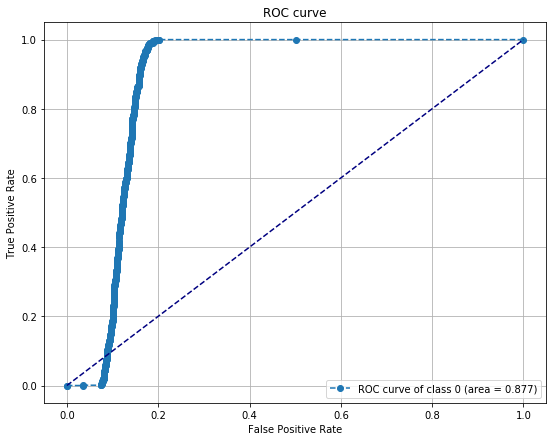

0.876659370977 For the label #1


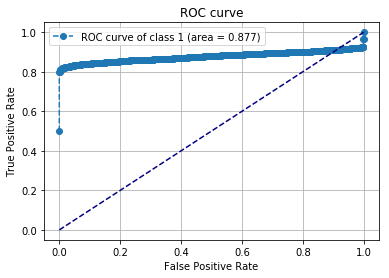

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_46 (Conv2D)           (None, 69, 30, 2)         26        
_________________________________________________________________
batch_normalization_47 (Batc (None, 69, 30, 2)         8         
_________________________________________________________________
activation_47 (Activation)   (None, 69, 30, 2)         0         
_________________________________________________________________
max_pooling2d_45 (MaxPooling (None, 23, 10, 2)         0         
_________________________________________________________________
dropout_44 (Dropout)         (None, 23, 10, 2)         0         
_________________________________________________________________
flatten_44 (Flatten)         (None, 460)               0         
_________________________________________________________________
dense_45 (Dense)             (None, 2)                 922       
Total para

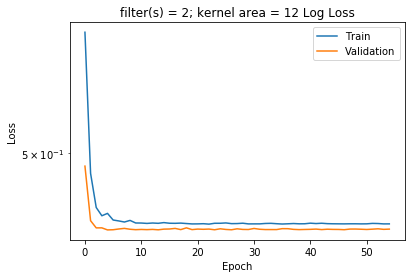

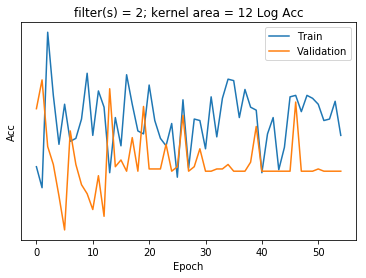

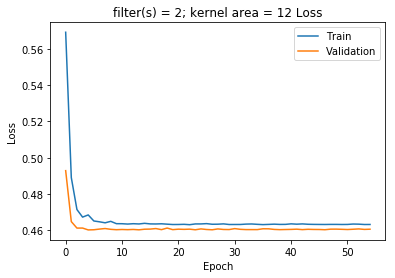

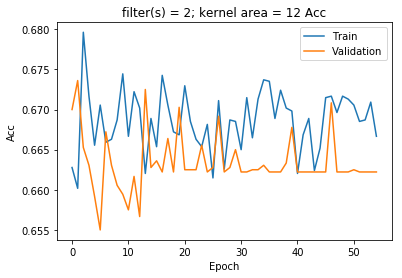

Confusion matrix, without normalization
[[ 152 1022]
 [ 204 2219]]
accuracy score:  0.659160411454
0.751824859857 For the label #0


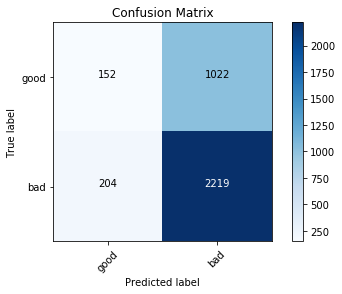

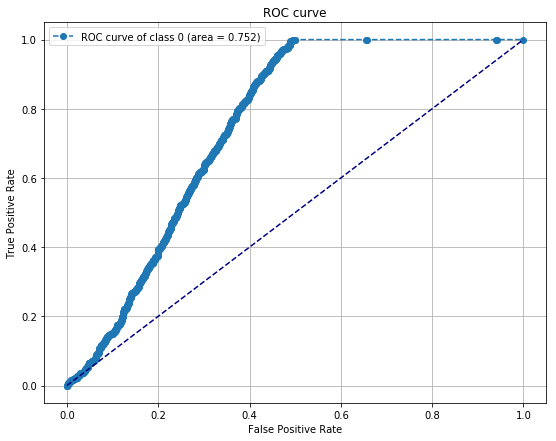

0.751824859857 For the label #1


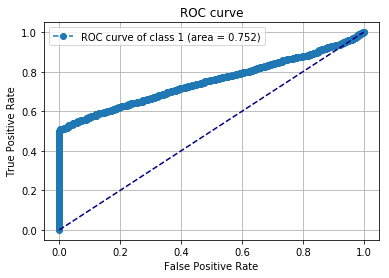

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_47 (Conv2D)           (None, 69, 29, 2)         34        
_________________________________________________________________
batch_normalization_48 (Batc (None, 69, 29, 2)         8         
_________________________________________________________________
activation_48 (Activation)   (None, 69, 29, 2)         0         
_________________________________________________________________
max_pooling2d_46 (MaxPooling (None, 23, 9, 2)          0         
_________________________________________________________________
dropout_45 (Dropout)         (None, 23, 9, 2)          0         
_________________________________________________________________
flatten_45 (Flatten)         (None, 414)               0         
_________________________________________________________________
dense_46 (Dense)             (None, 2)                 830       
Total para

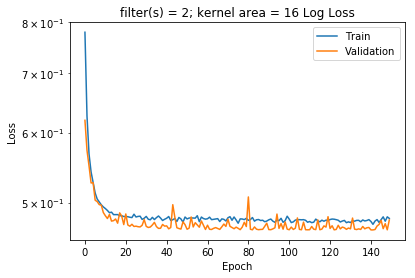

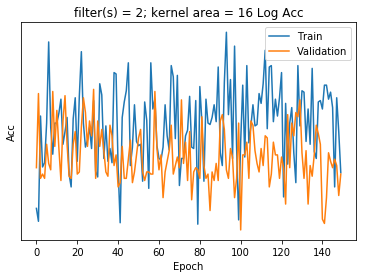

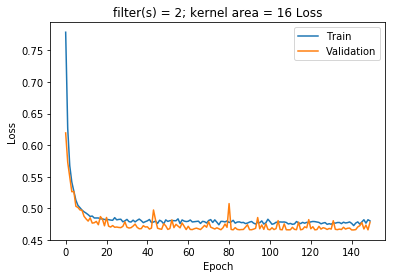

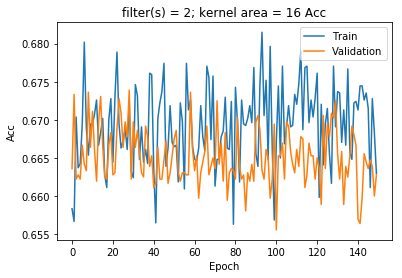

Confusion matrix, without normalization
[[ 292  882]
 [ 354 2069]]
accuracy score:  0.656380316931
0.738790699015 For the label #0


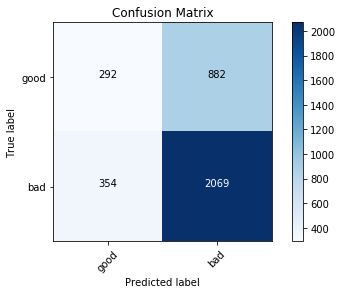

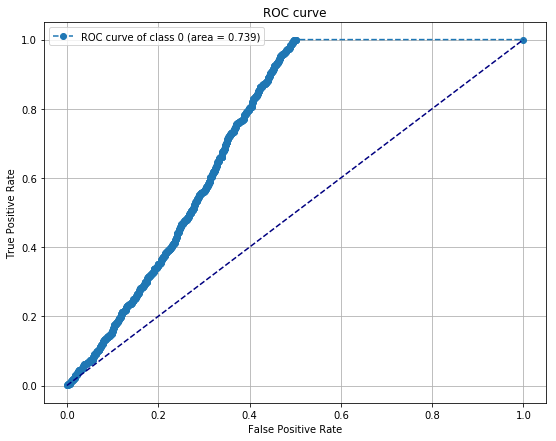

0.738790699015 For the label #1


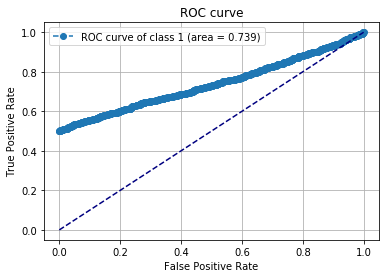

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_48 (Conv2D)           (None, 69, 28, 2)         42        
_________________________________________________________________
batch_normalization_49 (Batc (None, 69, 28, 2)         8         
_________________________________________________________________
activation_49 (Activation)   (None, 69, 28, 2)         0         
_________________________________________________________________
max_pooling2d_47 (MaxPooling (None, 23, 9, 2)          0         
_________________________________________________________________
dropout_46 (Dropout)         (None, 23, 9, 2)          0         
_________________________________________________________________
flatten_46 (Flatten)         (None, 414)               0         
_________________________________________________________________
dense_47 (Dense)             (None, 2)                 830       
Total para

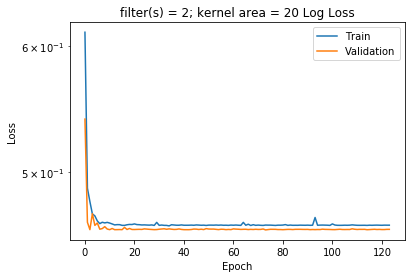

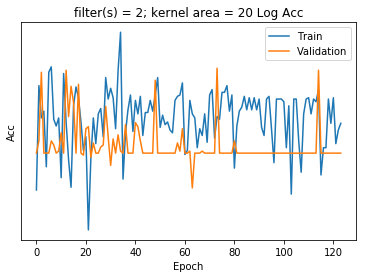

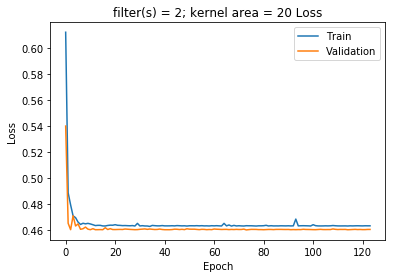

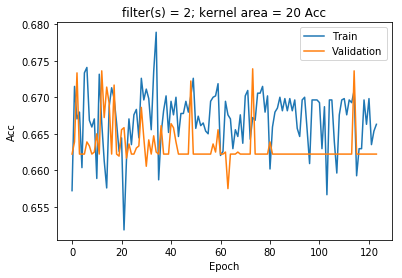

Confusion matrix, without normalization
[[ 324  850]
 [ 323 2100]]
accuracy score:  0.673894912427
0.753282181479 For the label #0


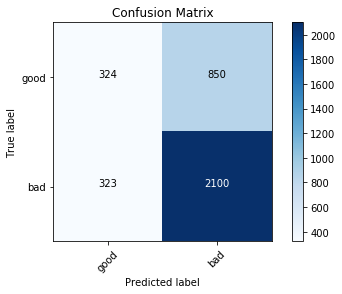

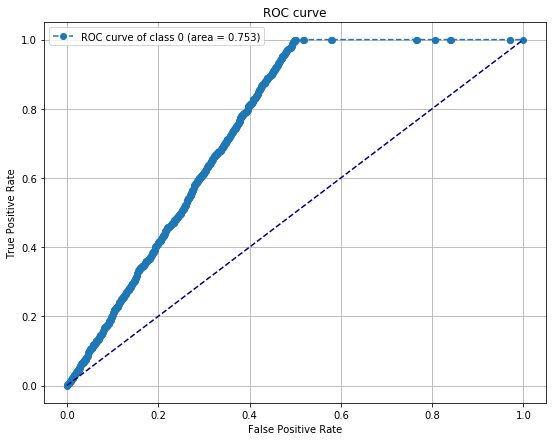

0.753281654165 For the label #1


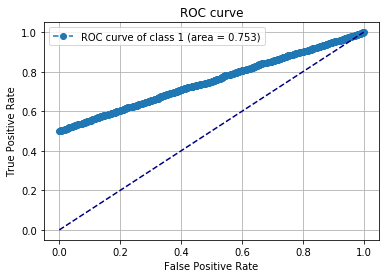

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_49 (Conv2D)           (None, 68, 32, 2)         12        
_________________________________________________________________
batch_normalization_50 (Batc (None, 68, 32, 2)         8         
_________________________________________________________________
activation_50 (Activation)   (None, 68, 32, 2)         0         
_________________________________________________________________
max_pooling2d_48 (MaxPooling (None, 22, 10, 2)         0         
_________________________________________________________________
dropout_47 (Dropout)         (None, 22, 10, 2)         0         
_________________________________________________________________
flatten_47 (Flatten)         (None, 440)               0         
_________________________________________________________________
dense_48 (Dense)             (None, 2)                 882       
Total para

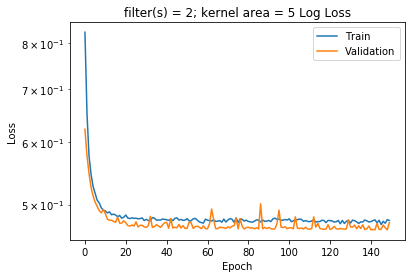

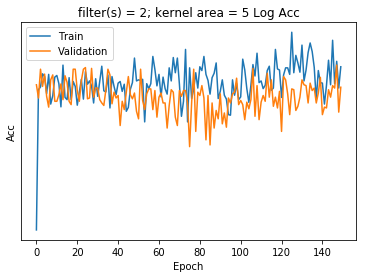

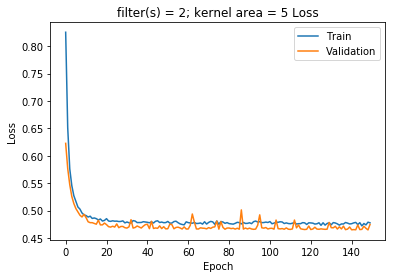

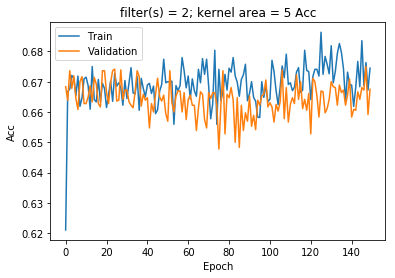

Confusion matrix, without normalization
[[ 454  720]
 [ 506 1917]]
accuracy score:  0.659160411454
0.743377632442 For the label #0


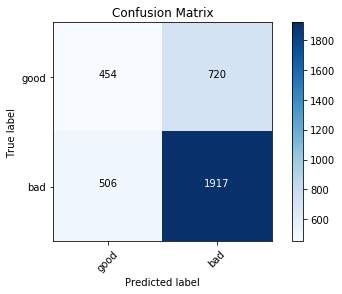

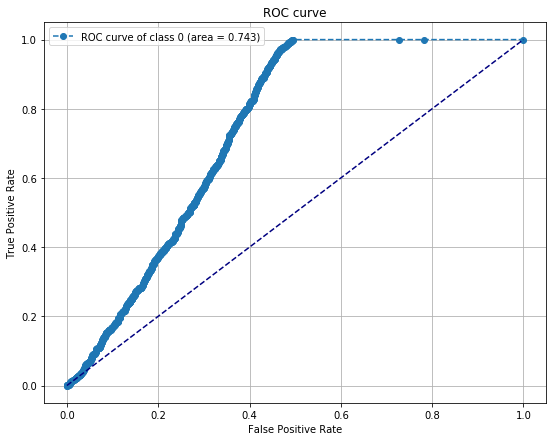

0.743377632442 For the label #1


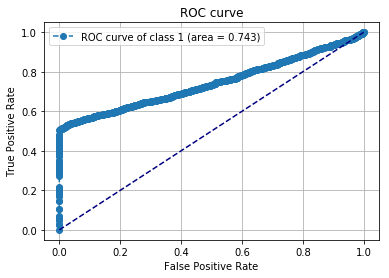

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_50 (Conv2D)           (None, 68, 31, 2)         22        
_________________________________________________________________
batch_normalization_51 (Batc (None, 68, 31, 2)         8         
_________________________________________________________________
activation_51 (Activation)   (None, 68, 31, 2)         0         
_________________________________________________________________
max_pooling2d_49 (MaxPooling (None, 22, 10, 2)         0         
_________________________________________________________________
dropout_48 (Dropout)         (None, 22, 10, 2)         0         
_________________________________________________________________
flatten_48 (Flatten)         (None, 440)               0         
_________________________________________________________________
dense_49 (Dense)             (None, 2)                 882       
Total para

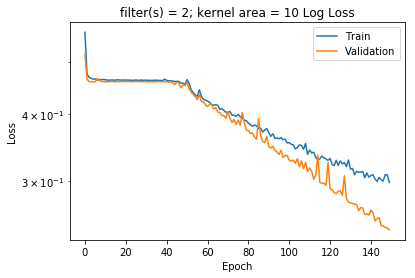

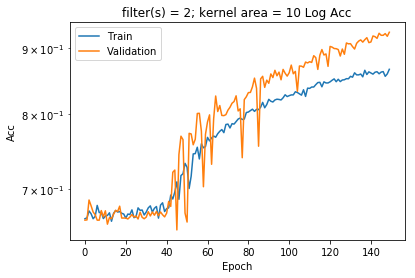

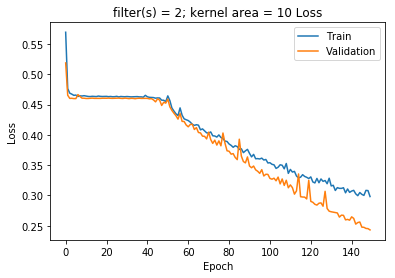

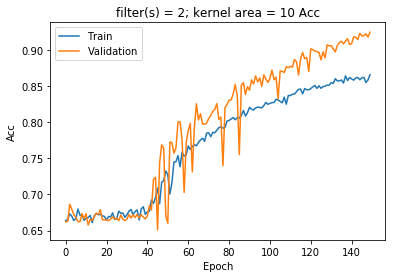

Confusion matrix, without normalization
[[1170    4]
 [ 265 2158]]
accuracy score:  0.925215457326
0.945749176862 For the label #0


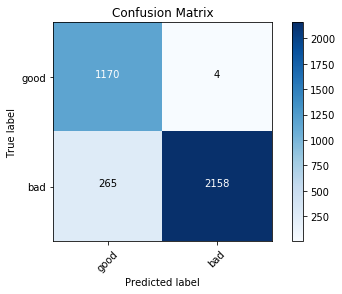

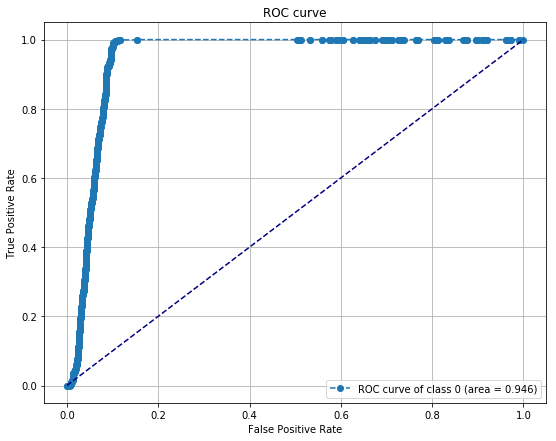

0.945749176862 For the label #1


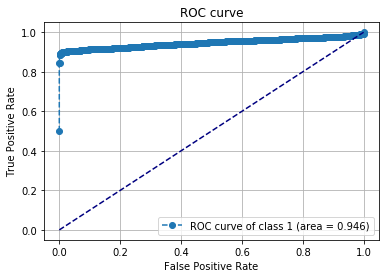

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_51 (Conv2D)           (None, 68, 30, 2)         32        
_________________________________________________________________
batch_normalization_52 (Batc (None, 68, 30, 2)         8         
_________________________________________________________________
activation_52 (Activation)   (None, 68, 30, 2)         0         
_________________________________________________________________
max_pooling2d_50 (MaxPooling (None, 22, 10, 2)         0         
_________________________________________________________________
dropout_49 (Dropout)         (None, 22, 10, 2)         0         
_________________________________________________________________
flatten_49 (Flatten)         (None, 440)               0         
_________________________________________________________________
dense_50 (Dense)             (None, 2)                 882       
Total para

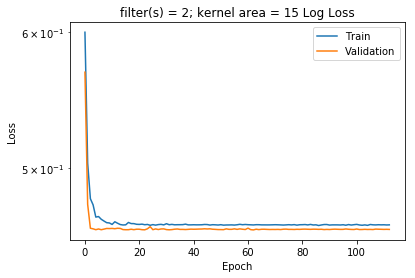

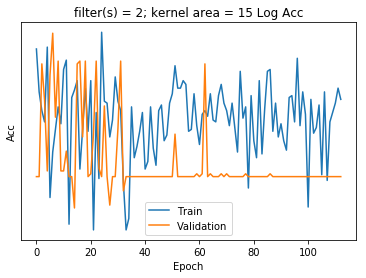

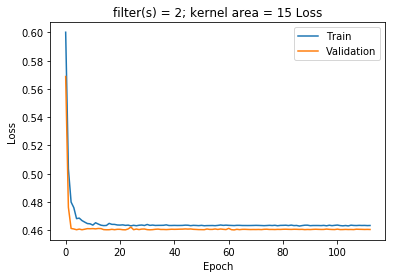

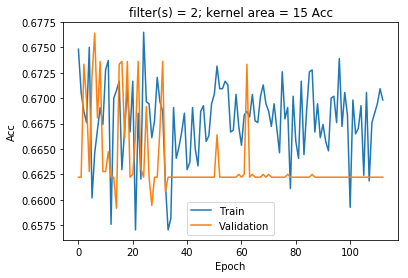

Confusion matrix, without normalization
[[   0 1174]
 [   1 2422]]
accuracy score:  0.673338893522
0.753775396347 For the label #0


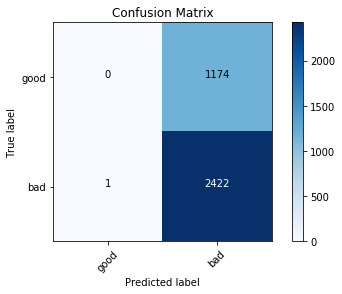

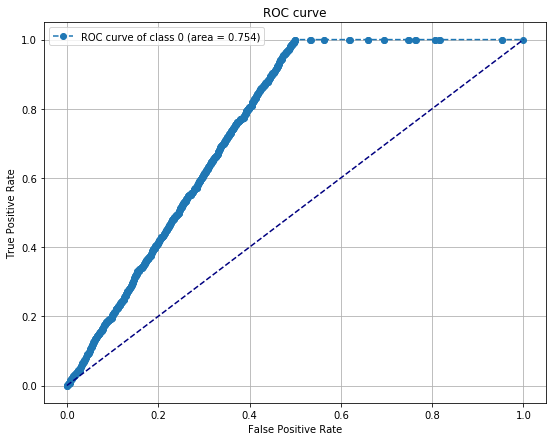

0.753775044804 For the label #1


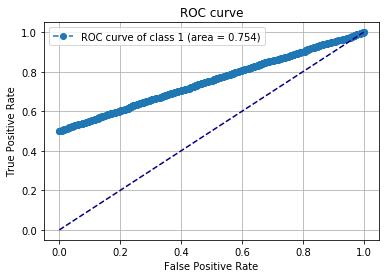

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_52 (Conv2D)           (None, 68, 29, 2)         42        
_________________________________________________________________
batch_normalization_53 (Batc (None, 68, 29, 2)         8         
_________________________________________________________________
activation_53 (Activation)   (None, 68, 29, 2)         0         
_________________________________________________________________
max_pooling2d_51 (MaxPooling (None, 22, 9, 2)          0         
_________________________________________________________________
dropout_50 (Dropout)         (None, 22, 9, 2)          0         
_________________________________________________________________
flatten_50 (Flatten)         (None, 396)               0         
_________________________________________________________________
dense_51 (Dense)             (None, 2)                 794       
Total para

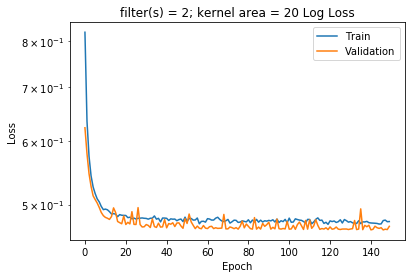

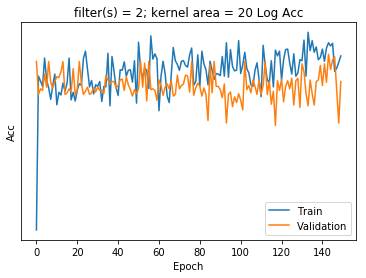

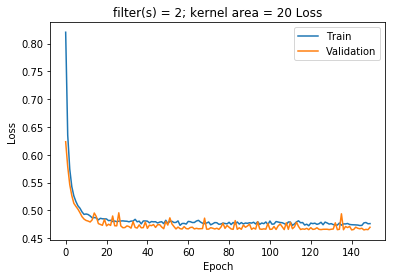

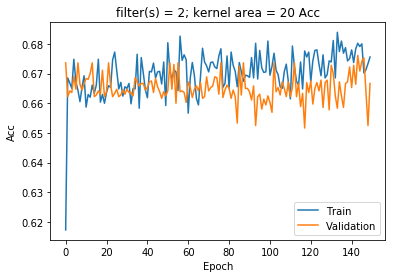

Confusion matrix, without normalization
[[ 769  405]
 [ 763 1660]]
accuracy score:  0.675284959689
0.748266365558 For the label #0


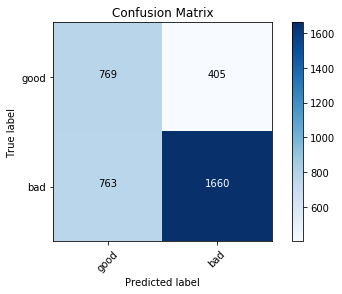

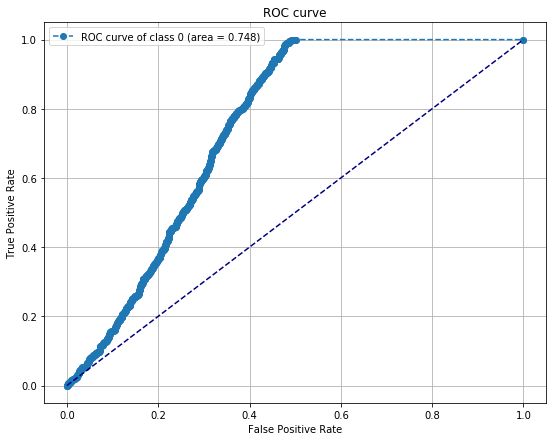

0.748266365558 For the label #1


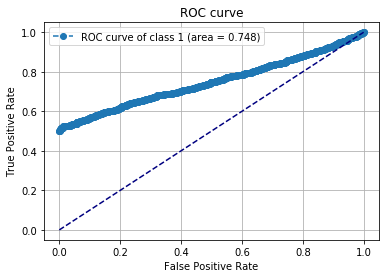

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_53 (Conv2D)           (None, 68, 28, 2)         52        
_________________________________________________________________
batch_normalization_54 (Batc (None, 68, 28, 2)         8         
_________________________________________________________________
activation_54 (Activation)   (None, 68, 28, 2)         0         
_________________________________________________________________
max_pooling2d_52 (MaxPooling (None, 22, 9, 2)          0         
_________________________________________________________________
dropout_51 (Dropout)         (None, 22, 9, 2)          0         
_________________________________________________________________
flatten_51 (Flatten)         (None, 396)               0         
_________________________________________________________________
dense_52 (Dense)             (None, 2)                 794       
Total para

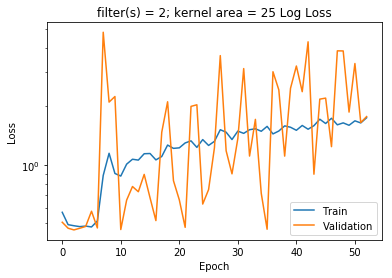

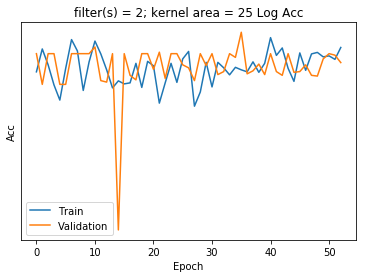

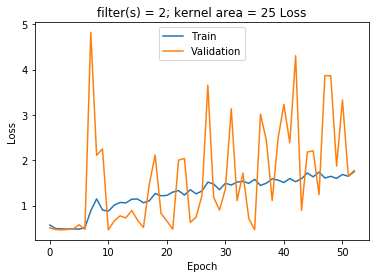

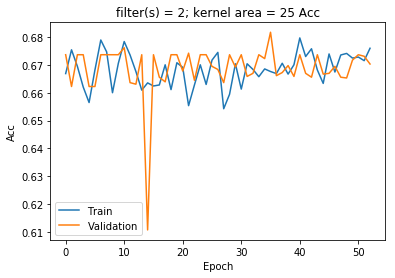

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.753955562149 For the label #0


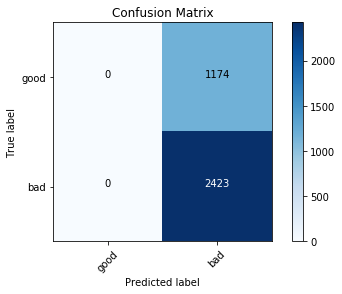

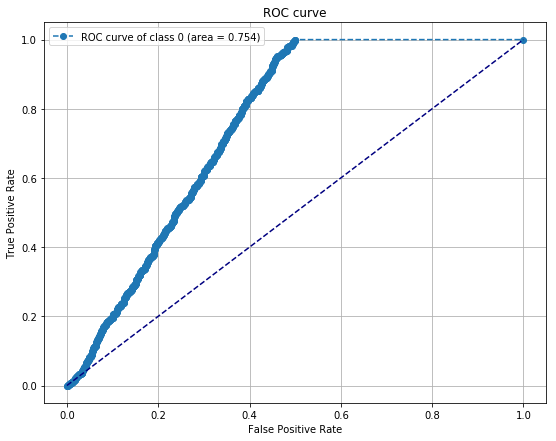

0.753955034834 For the label #1


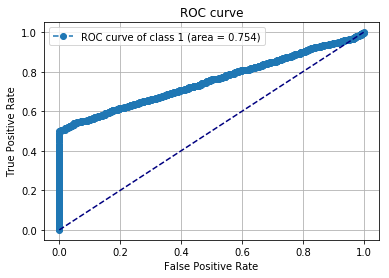

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_54 (Conv2D)           (None, 72, 32, 3)         6         
_________________________________________________________________
batch_normalization_55 (Batc (None, 72, 32, 3)         12        
_________________________________________________________________
activation_55 (Activation)   (None, 72, 32, 3)         0         
_________________________________________________________________
max_pooling2d_53 (MaxPooling (None, 24, 10, 3)         0         
_________________________________________________________________
dropout_52 (Dropout)         (None, 24, 10, 3)         0         
_________________________________________________________________
flatten_52 (Flatten)         (None, 720)               0         
_________________________________________________________________
dense_53 (Dense)             (None, 2)                 1442      
Total para

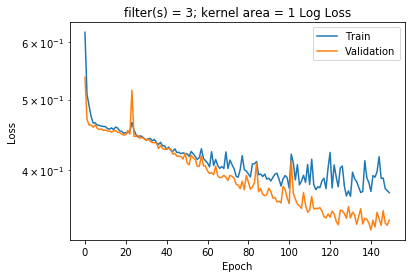

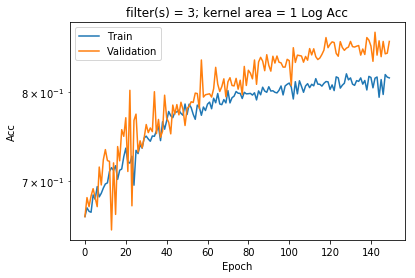

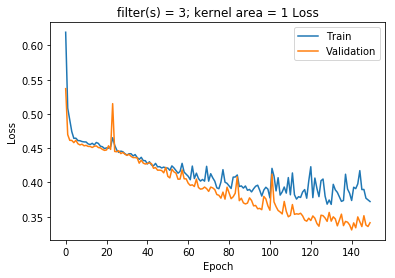

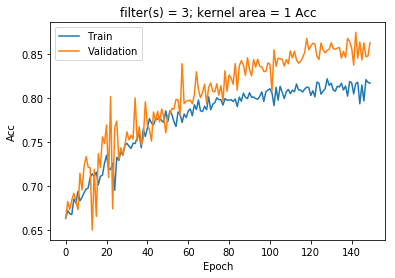

Confusion matrix, without normalization
[[1174    0]
 [ 515 1908]]
accuracy score:  0.856825132054
0.900035927697 For the label #0


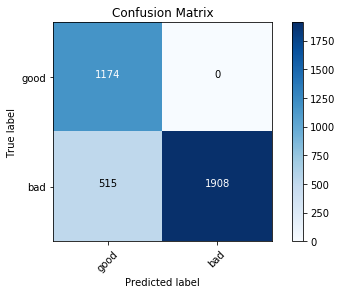

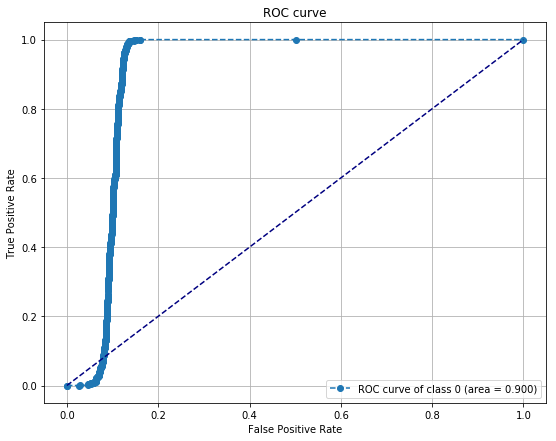

0.900035927697 For the label #1


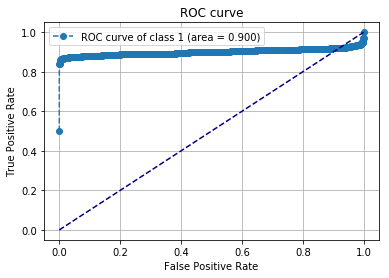

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_55 (Conv2D)           (None, 72, 31, 3)         9         
_________________________________________________________________
batch_normalization_56 (Batc (None, 72, 31, 3)         12        
_________________________________________________________________
activation_56 (Activation)   (None, 72, 31, 3)         0         
_________________________________________________________________
max_pooling2d_54 (MaxPooling (None, 24, 10, 3)         0         
_________________________________________________________________
dropout_53 (Dropout)         (None, 24, 10, 3)         0         
_________________________________________________________________
flatten_53 (Flatten)         (None, 720)               0         
_________________________________________________________________
dense_54 (Dense)             (None, 2)                 1442      
Total para

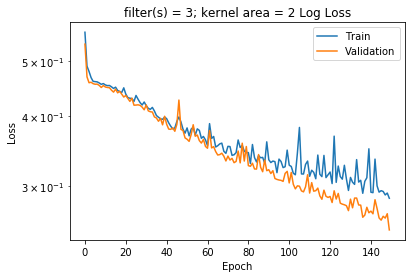

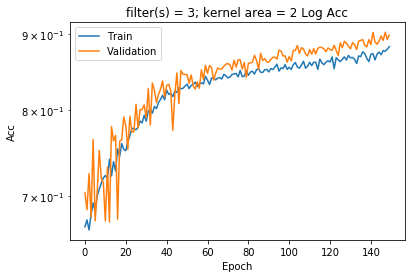

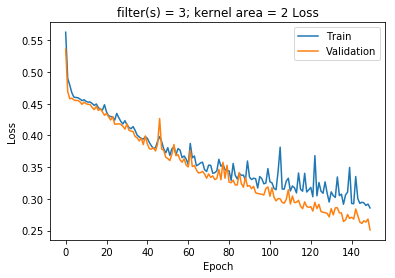

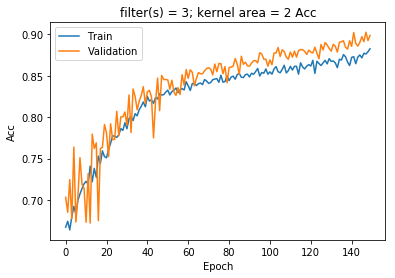

Confusion matrix, without normalization
[[1174    0]
 [ 365 2058]]
accuracy score:  0.898526549903
0.949109225122 For the label #0


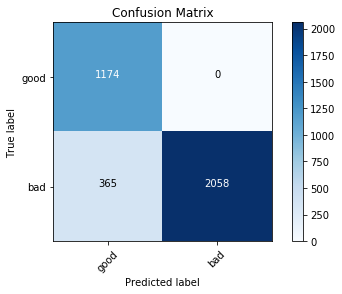

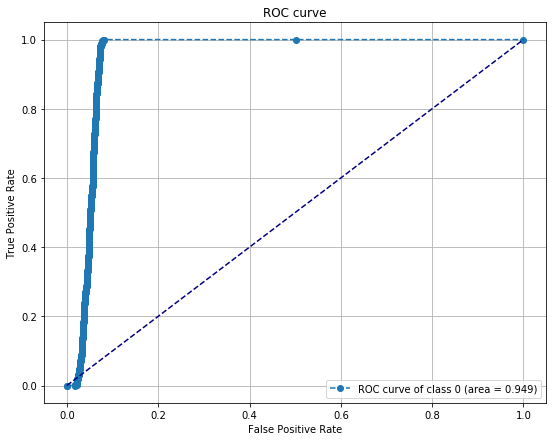

0.949109225122 For the label #1


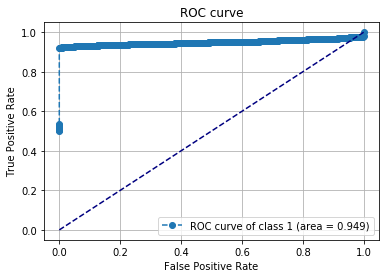

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_56 (Conv2D)           (None, 72, 30, 3)         12        
_________________________________________________________________
batch_normalization_57 (Batc (None, 72, 30, 3)         12        
_________________________________________________________________
activation_57 (Activation)   (None, 72, 30, 3)         0         
_________________________________________________________________
max_pooling2d_55 (MaxPooling (None, 24, 10, 3)         0         
_________________________________________________________________
dropout_54 (Dropout)         (None, 24, 10, 3)         0         
_________________________________________________________________
flatten_54 (Flatten)         (None, 720)               0         
_________________________________________________________________
dense_55 (Dense)             (None, 2)                 1442      
Total para

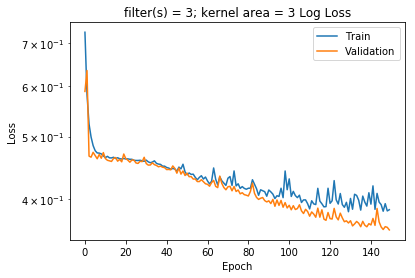

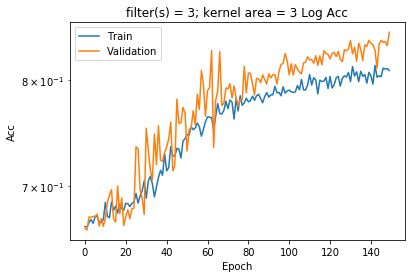

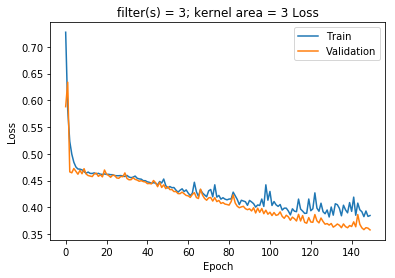

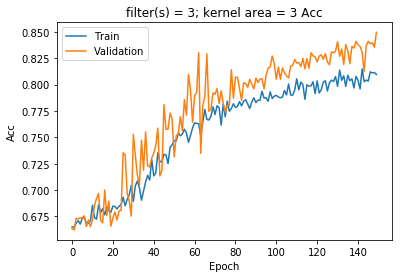

Confusion matrix, without normalization
[[1174    0]
 [ 541 1882]]
accuracy score:  0.849596886294
0.868610617584 For the label #0


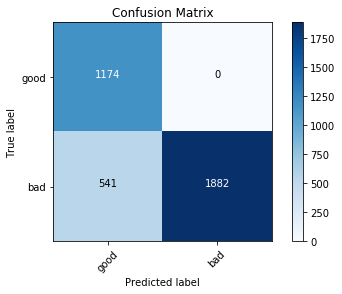

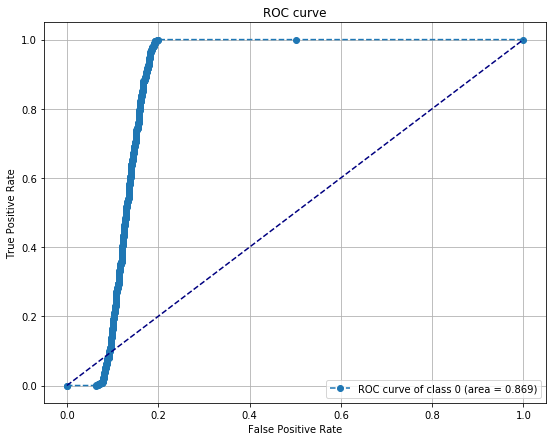

0.868610617584 For the label #1


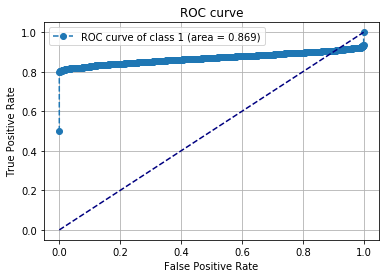

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_57 (Conv2D)           (None, 72, 29, 3)         15        
_________________________________________________________________
batch_normalization_58 (Batc (None, 72, 29, 3)         12        
_________________________________________________________________
activation_58 (Activation)   (None, 72, 29, 3)         0         
_________________________________________________________________
max_pooling2d_56 (MaxPooling (None, 24, 9, 3)          0         
_________________________________________________________________
dropout_55 (Dropout)         (None, 24, 9, 3)          0         
_________________________________________________________________
flatten_55 (Flatten)         (None, 648)               0         
_________________________________________________________________
dense_56 (Dense)             (None, 2)                 1298      
Total para

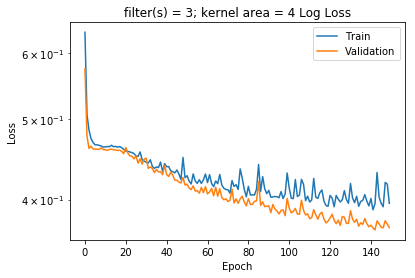

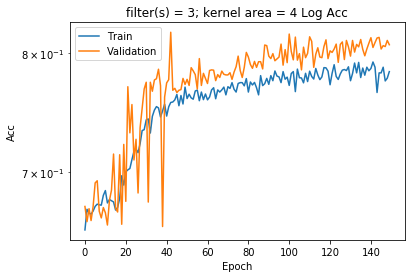

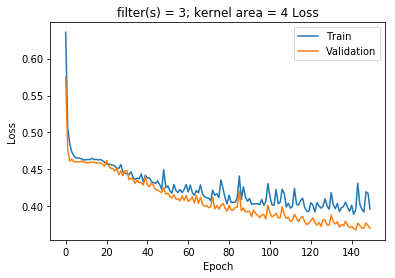

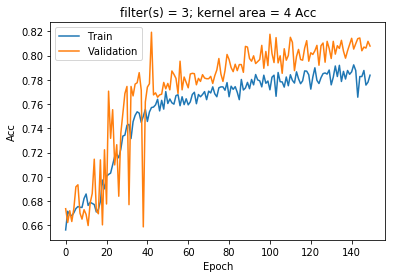

Confusion matrix, without normalization
[[1174    0]
 [ 684 1739]]
accuracy score:  0.809841534612
0.863002627433 For the label #0


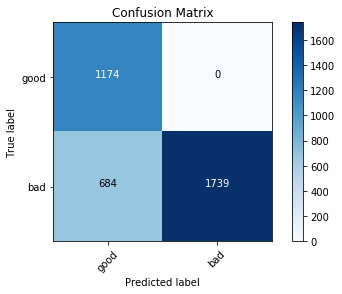

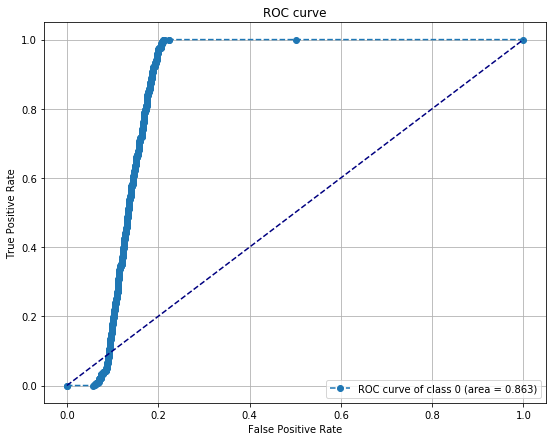

0.863002978976 For the label #1


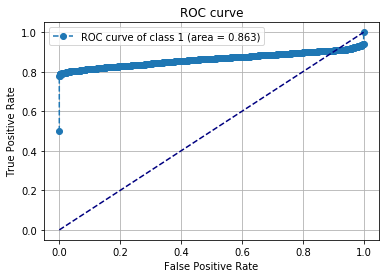

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_58 (Conv2D)           (None, 72, 28, 3)         18        
_________________________________________________________________
batch_normalization_59 (Batc (None, 72, 28, 3)         12        
_________________________________________________________________
activation_59 (Activation)   (None, 72, 28, 3)         0         
_________________________________________________________________
max_pooling2d_57 (MaxPooling (None, 24, 9, 3)          0         
_________________________________________________________________
dropout_56 (Dropout)         (None, 24, 9, 3)          0         
_________________________________________________________________
flatten_56 (Flatten)         (None, 648)               0         
_________________________________________________________________
dense_57 (Dense)             (None, 2)                 1298      
Total para

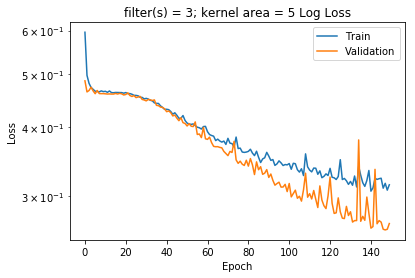

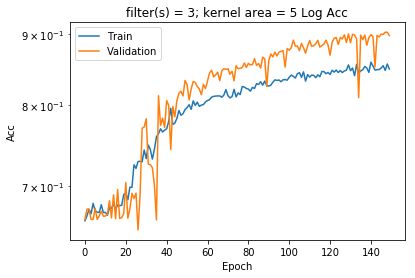

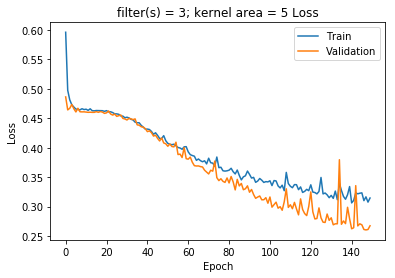

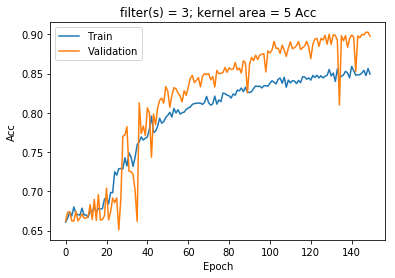

Confusion matrix, without normalization
[[1173    1]
 [ 349 2074]]
accuracy score:  0.902696691688
0.945988753435 For the label #0


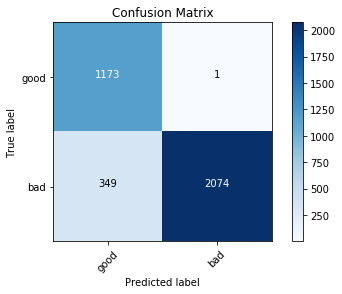

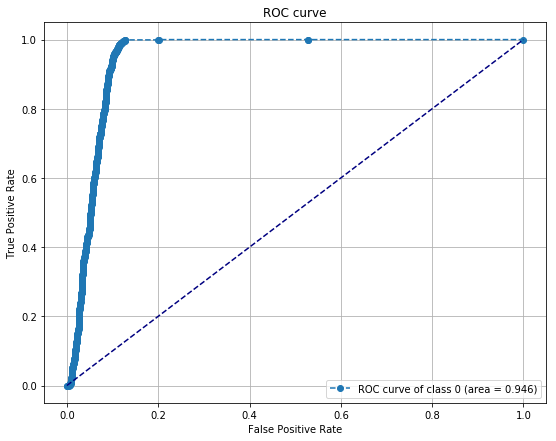

0.945988753435 For the label #1


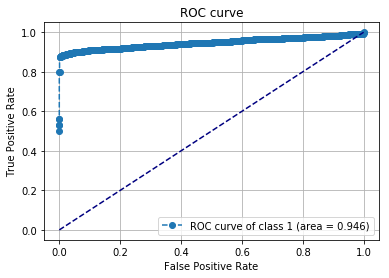

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_59 (Conv2D)           (None, 71, 32, 3)         9         
_________________________________________________________________
batch_normalization_60 (Batc (None, 71, 32, 3)         12        
_________________________________________________________________
activation_60 (Activation)   (None, 71, 32, 3)         0         
_________________________________________________________________
max_pooling2d_58 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_57 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_57 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_58 (Dense)             (None, 2)                 1382      
Total para

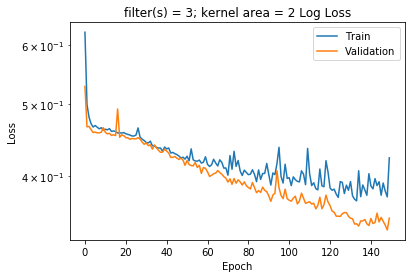

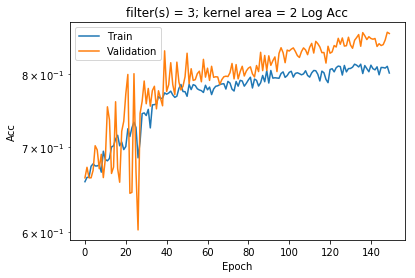

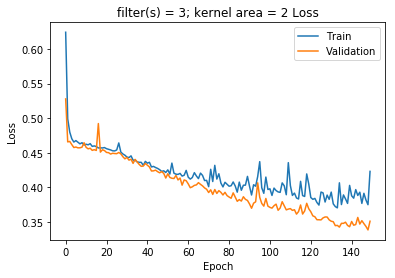

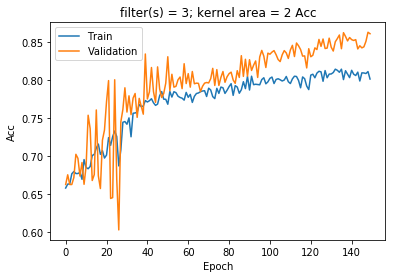

Confusion matrix, without normalization
[[1174    0]
 [ 494 1929]]
accuracy score:  0.862663330553
0.898444668182 For the label #0


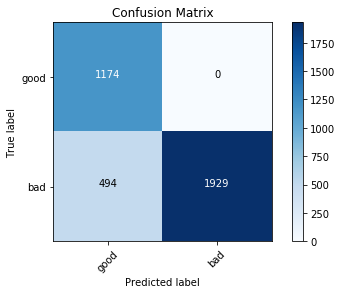

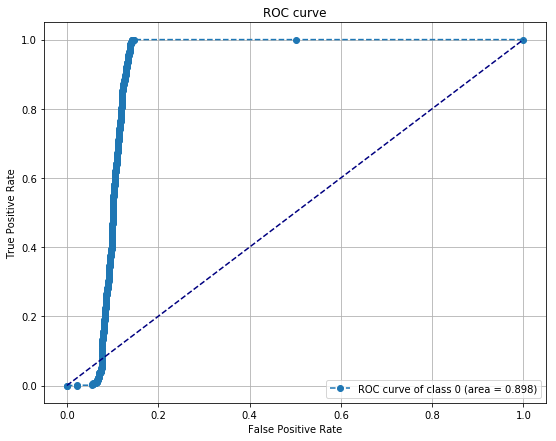

0.898444843954 For the label #1


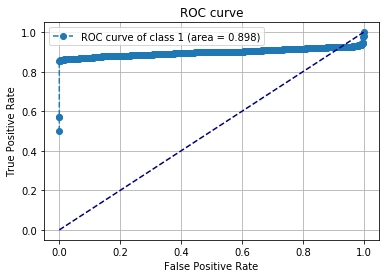

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_60 (Conv2D)           (None, 71, 31, 3)         15        
_________________________________________________________________
batch_normalization_61 (Batc (None, 71, 31, 3)         12        
_________________________________________________________________
activation_61 (Activation)   (None, 71, 31, 3)         0         
_________________________________________________________________
max_pooling2d_59 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_58 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_58 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_59 (Dense)             (None, 2)                 1382      
Total para

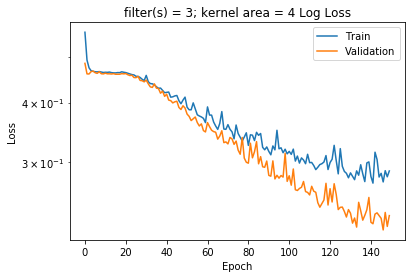

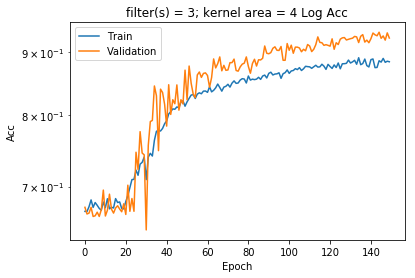

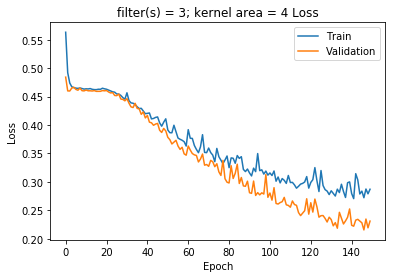

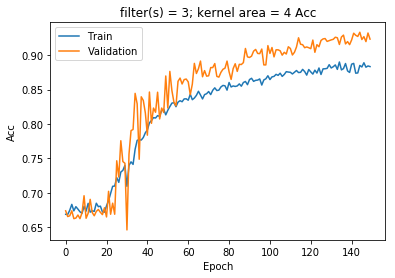

Confusion matrix, without normalization
[[1174    0]
 [ 262 2161]]
accuracy score:  0.927161523492
0.960096878228 For the label #0


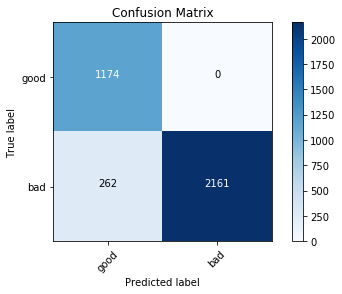

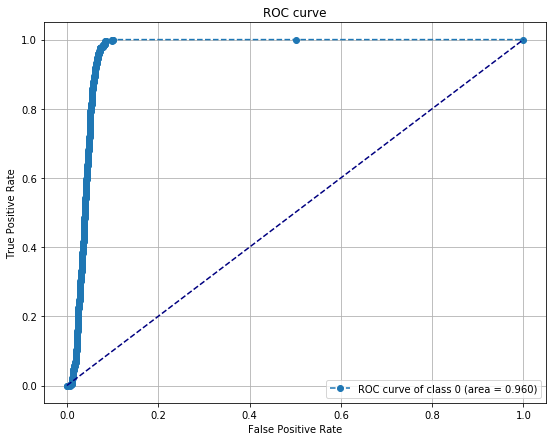

0.960096878228 For the label #1


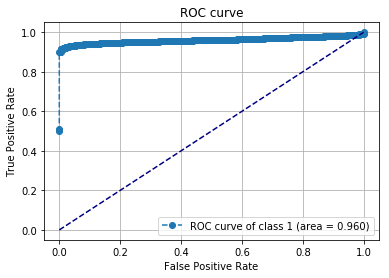

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_61 (Conv2D)           (None, 71, 30, 3)         21        
_________________________________________________________________
batch_normalization_62 (Batc (None, 71, 30, 3)         12        
_________________________________________________________________
activation_62 (Activation)   (None, 71, 30, 3)         0         
_________________________________________________________________
max_pooling2d_60 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_59 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_59 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_60 (Dense)             (None, 2)                 1382      
Total para

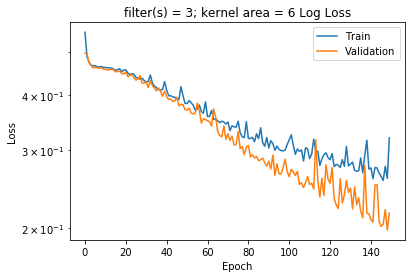

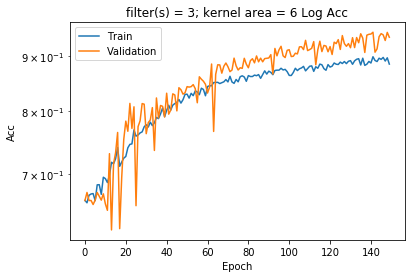

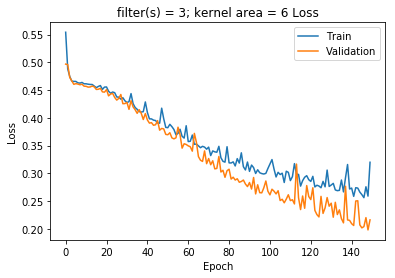

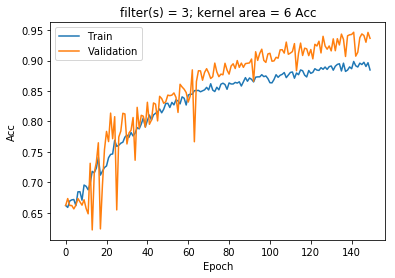

Confusion matrix, without normalization
[[1173    1]
 [ 193 2230]]
accuracy score:  0.94606616625
0.974867310084 For the label #0


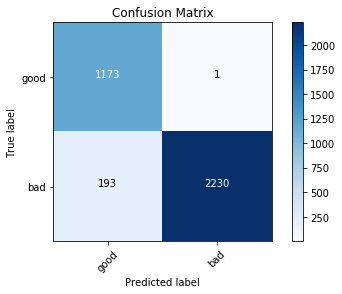

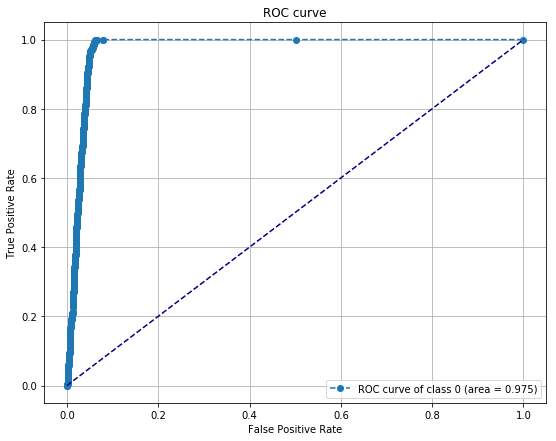

0.974867310084 For the label #1


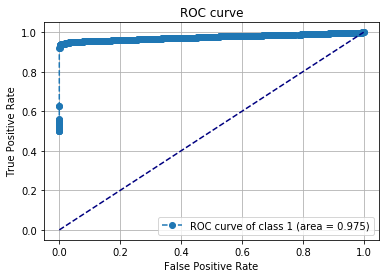

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_62 (Conv2D)           (None, 71, 29, 3)         27        
_________________________________________________________________
batch_normalization_63 (Batc (None, 71, 29, 3)         12        
_________________________________________________________________
activation_63 (Activation)   (None, 71, 29, 3)         0         
_________________________________________________________________
max_pooling2d_61 (MaxPooling (None, 23, 9, 3)          0         
_________________________________________________________________
dropout_60 (Dropout)         (None, 23, 9, 3)          0         
_________________________________________________________________
flatten_60 (Flatten)         (None, 621)               0         
_________________________________________________________________
dense_61 (Dense)             (None, 2)                 1244      
Total para

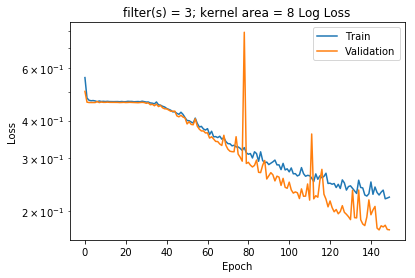

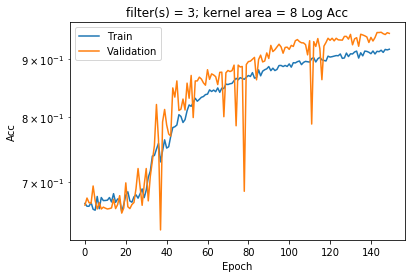

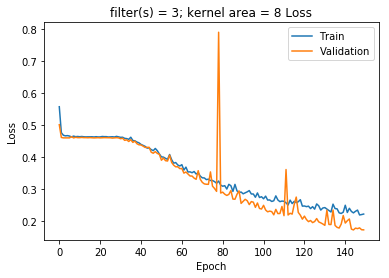

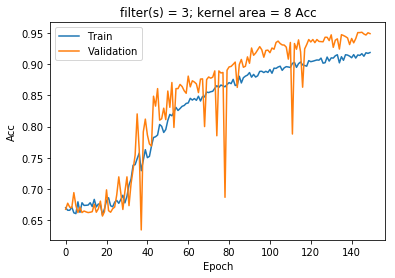

Confusion matrix, without normalization
[[1174    0]
 [ 177 2246]]
accuracy score:  0.950792326939
0.971325162536 For the label #0


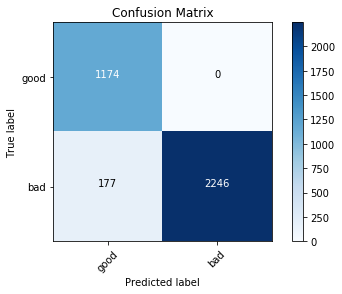

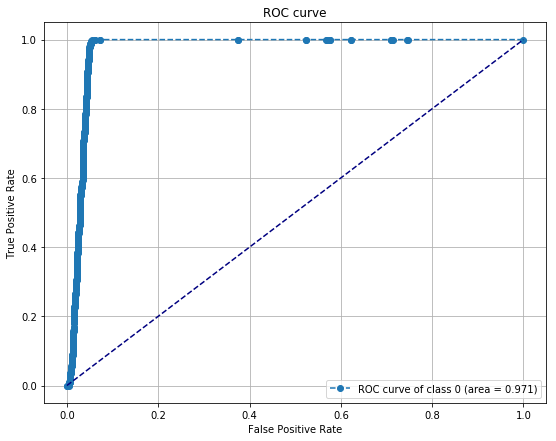

0.971325162536 For the label #1


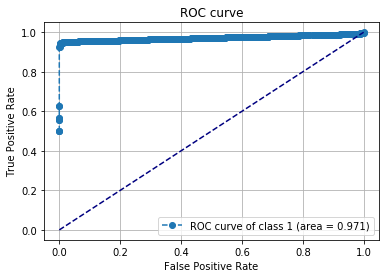

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_63 (Conv2D)           (None, 71, 28, 3)         33        
_________________________________________________________________
batch_normalization_64 (Batc (None, 71, 28, 3)         12        
_________________________________________________________________
activation_64 (Activation)   (None, 71, 28, 3)         0         
_________________________________________________________________
max_pooling2d_62 (MaxPooling (None, 23, 9, 3)          0         
_________________________________________________________________
dropout_61 (Dropout)         (None, 23, 9, 3)          0         
_________________________________________________________________
flatten_61 (Flatten)         (None, 621)               0         
_________________________________________________________________
dense_62 (Dense)             (None, 2)                 1244      
Total para

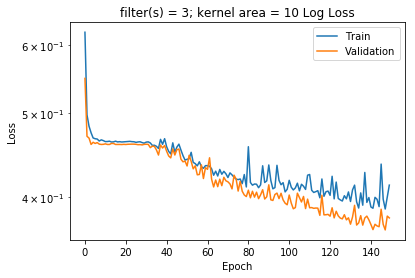

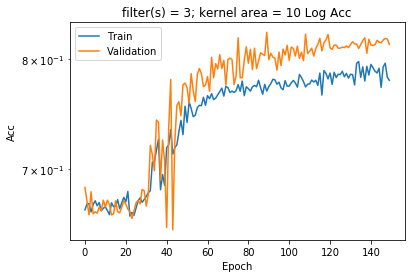

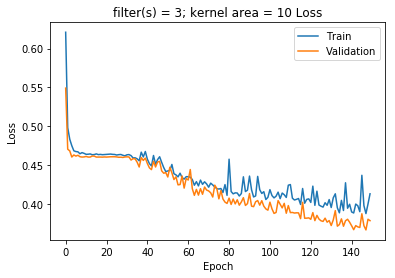

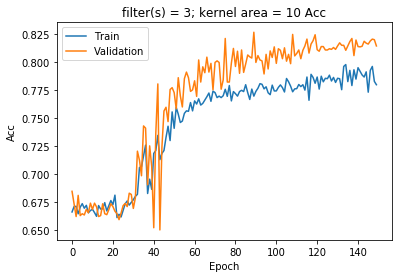

Confusion matrix, without normalization
[[1174    0]
 [ 645 1778]]
accuracy score:  0.820683903253
0.860219637053 For the label #0


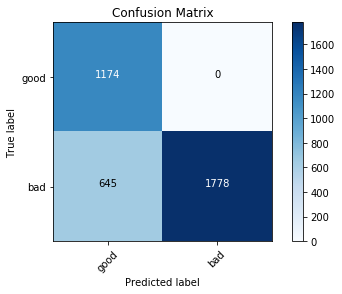

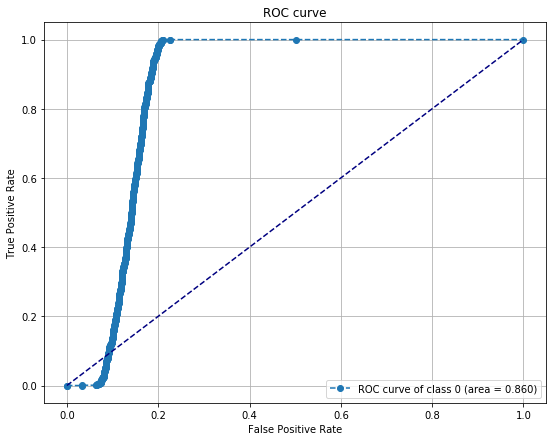

0.860220164367 For the label #1


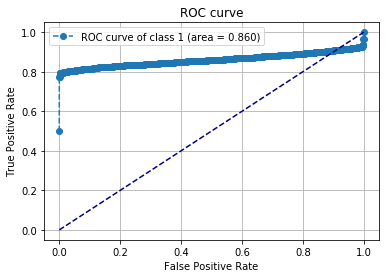

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_64 (Conv2D)           (None, 70, 32, 3)         12        
_________________________________________________________________
batch_normalization_65 (Batc (None, 70, 32, 3)         12        
_________________________________________________________________
activation_65 (Activation)   (None, 70, 32, 3)         0         
_________________________________________________________________
max_pooling2d_63 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_62 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_62 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_63 (Dense)             (None, 2)                 1382      
Total para

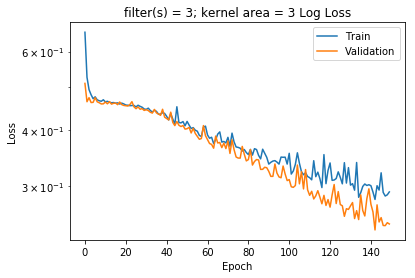

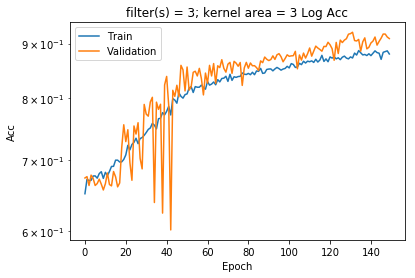

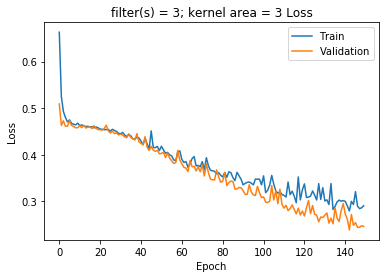

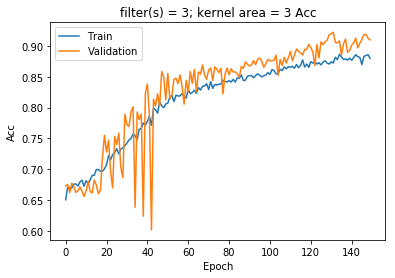

Confusion matrix, without normalization
[[1174    0]
 [ 314 2109]]
accuracy score:  0.912705031971
0.959740237826 For the label #0


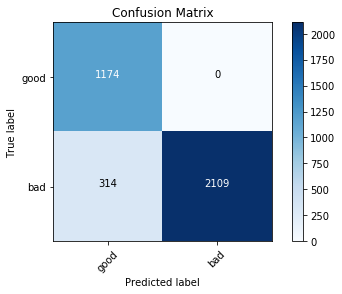

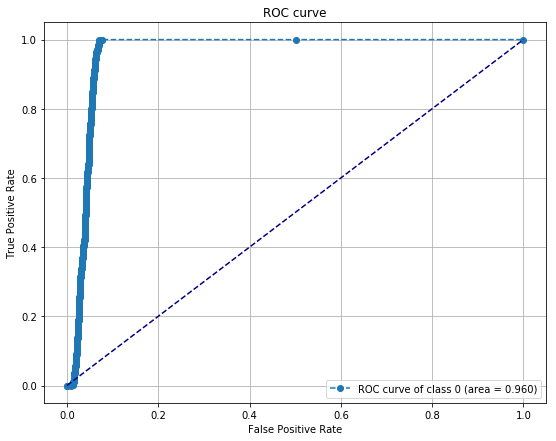

0.959740237826 For the label #1


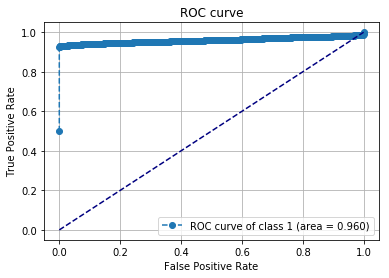

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_65 (Conv2D)           (None, 70, 31, 3)         21        
_________________________________________________________________
batch_normalization_66 (Batc (None, 70, 31, 3)         12        
_________________________________________________________________
activation_66 (Activation)   (None, 70, 31, 3)         0         
_________________________________________________________________
max_pooling2d_64 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_63 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_63 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_64 (Dense)             (None, 2)                 1382      
Total para

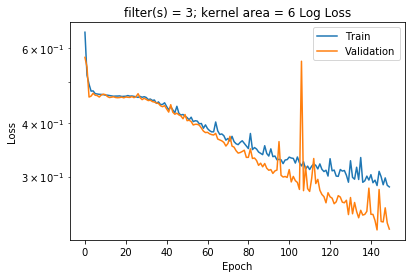

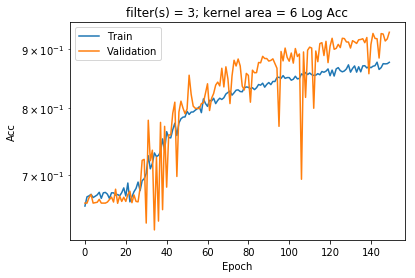

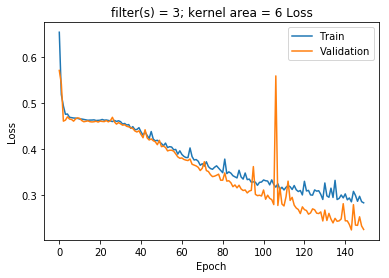

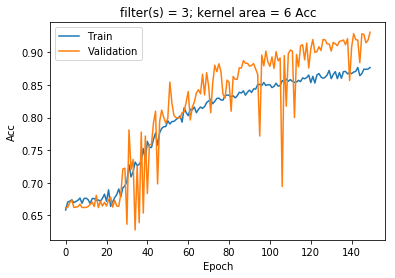

Confusion matrix, without normalization
[[1174    0]
 [ 291 2132]]
accuracy score:  0.919099249374
0.966663174673 For the label #0


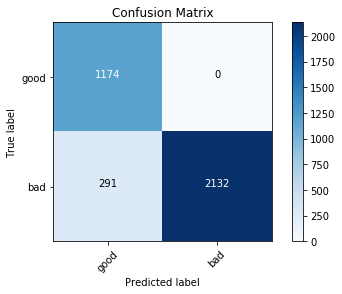

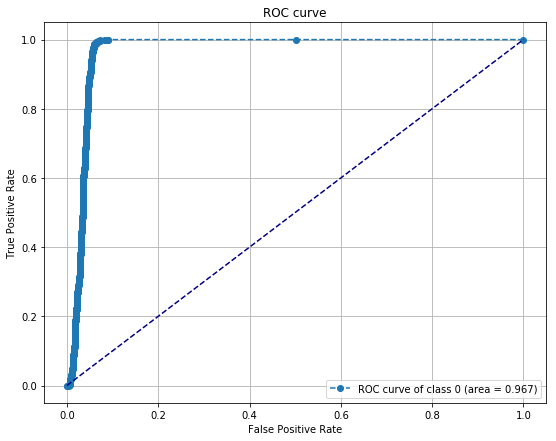

0.966663174673 For the label #1


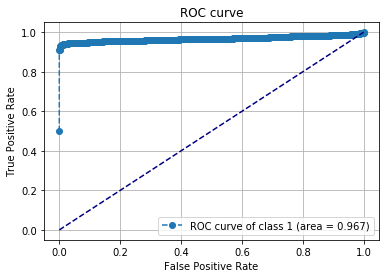

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_66 (Conv2D)           (None, 70, 30, 3)         30        
_________________________________________________________________
batch_normalization_67 (Batc (None, 70, 30, 3)         12        
_________________________________________________________________
activation_67 (Activation)   (None, 70, 30, 3)         0         
_________________________________________________________________
max_pooling2d_65 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_64 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_64 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_65 (Dense)             (None, 2)                 1382      
Total para

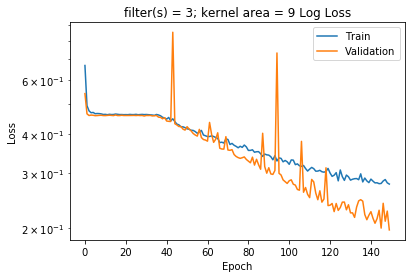

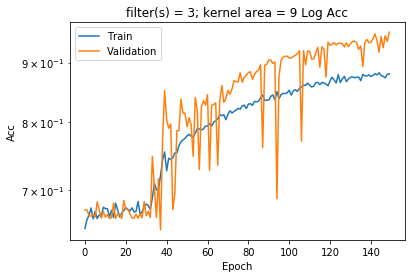

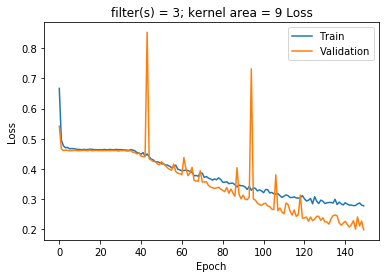

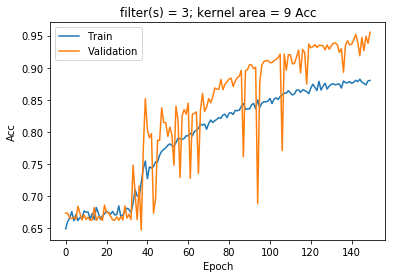

Confusion matrix, without normalization
[[1172    2]
 [ 159 2264]]
accuracy score:  0.955240478176
0.970715411154 For the label #0


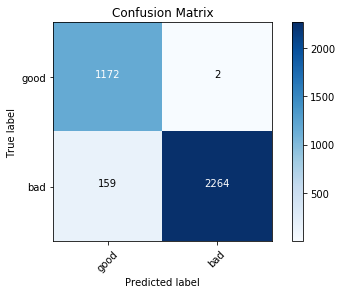

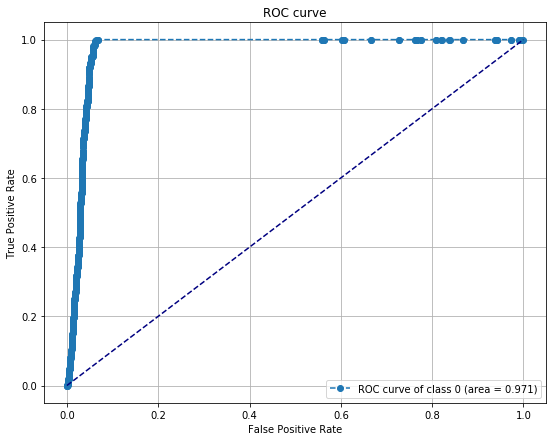

0.970715411154 For the label #1


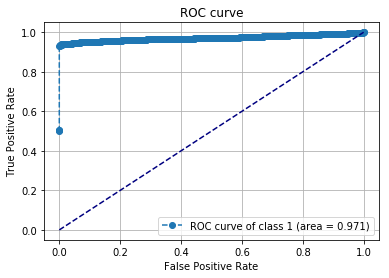

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_67 (Conv2D)           (None, 70, 29, 3)         39        
_________________________________________________________________
batch_normalization_68 (Batc (None, 70, 29, 3)         12        
_________________________________________________________________
activation_68 (Activation)   (None, 70, 29, 3)         0         
_________________________________________________________________
max_pooling2d_66 (MaxPooling (None, 23, 9, 3)          0         
_________________________________________________________________
dropout_65 (Dropout)         (None, 23, 9, 3)          0         
_________________________________________________________________
flatten_65 (Flatten)         (None, 621)               0         
_________________________________________________________________
dense_66 (Dense)             (None, 2)                 1244      
Total para

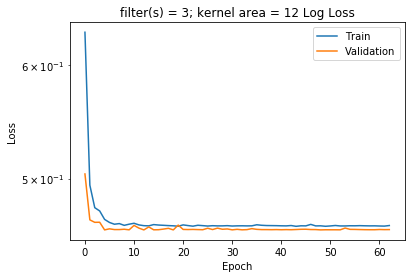

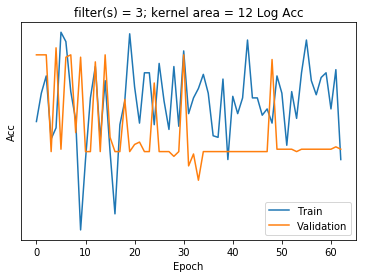

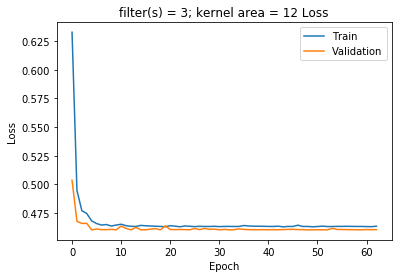

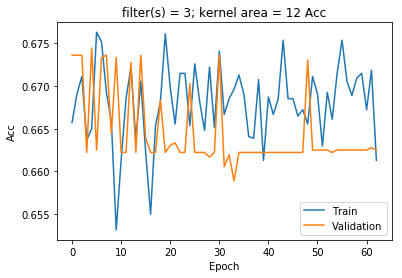

Confusion matrix, without normalization
[[   0 1174]
 [   3 2420]]
accuracy score:  0.672782874618
0.745071190979 For the label #0


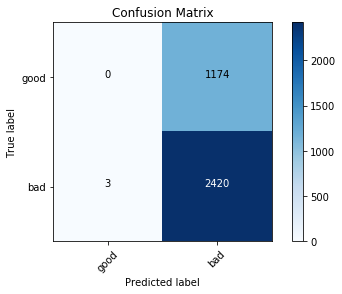

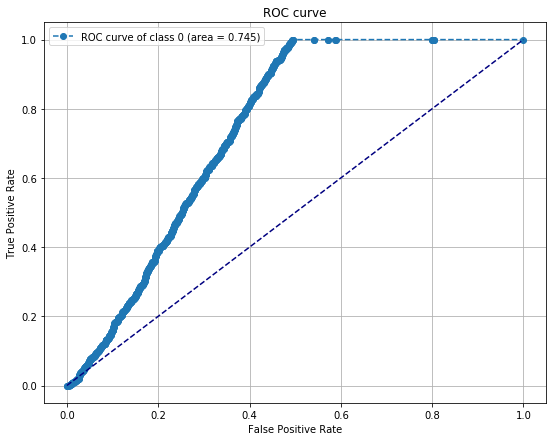

0.745071542522 For the label #1


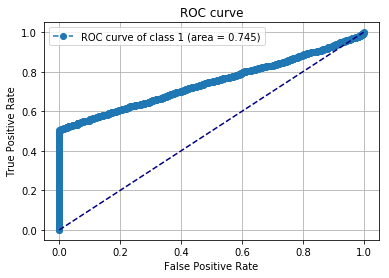

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_68 (Conv2D)           (None, 70, 28, 3)         48        
_________________________________________________________________
batch_normalization_69 (Batc (None, 70, 28, 3)         12        
_________________________________________________________________
activation_69 (Activation)   (None, 70, 28, 3)         0         
_________________________________________________________________
max_pooling2d_67 (MaxPooling (None, 23, 9, 3)          0         
_________________________________________________________________
dropout_66 (Dropout)         (None, 23, 9, 3)          0         
_________________________________________________________________
flatten_66 (Flatten)         (None, 621)               0         
_________________________________________________________________
dense_67 (Dense)             (None, 2)                 1244      
Total para

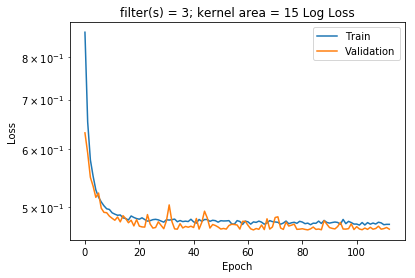

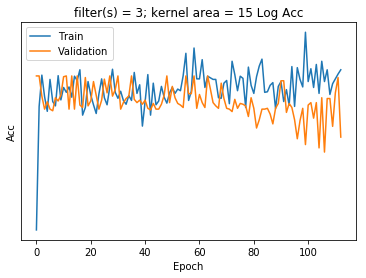

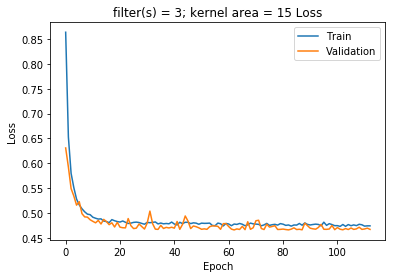

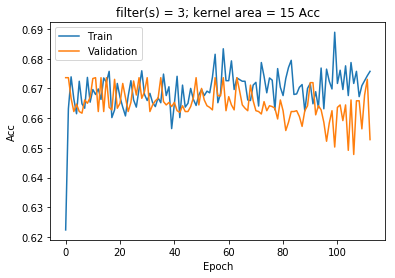

Confusion matrix, without normalization
[[ 406  768]
 [ 445 1978]]
accuracy score:  0.662774534334
0.745177532744 For the label #0


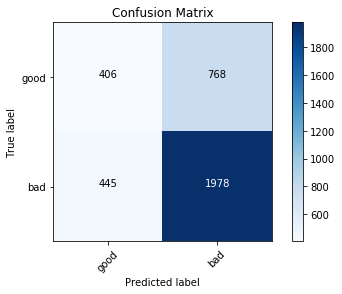

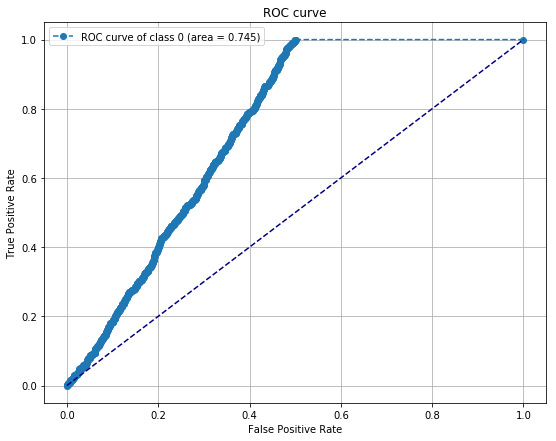

0.745177708516 For the label #1


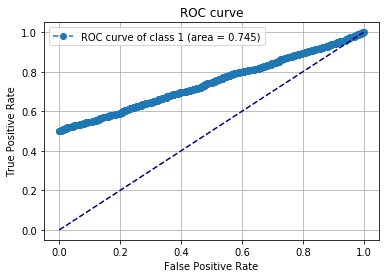

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_69 (Conv2D)           (None, 69, 32, 3)         15        
_________________________________________________________________
batch_normalization_70 (Batc (None, 69, 32, 3)         12        
_________________________________________________________________
activation_70 (Activation)   (None, 69, 32, 3)         0         
_________________________________________________________________
max_pooling2d_68 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_67 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_67 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_68 (Dense)             (None, 2)                 1382      
Total para

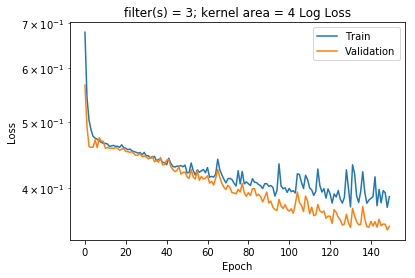

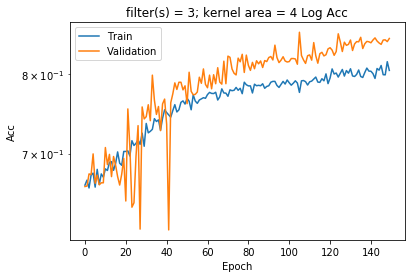

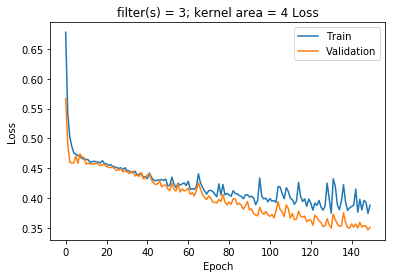

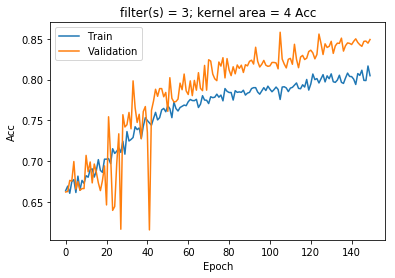

Confusion matrix, without normalization
[[1174    0]
 [ 559 1864]]
accuracy score:  0.844592716152
0.896229947107 For the label #0


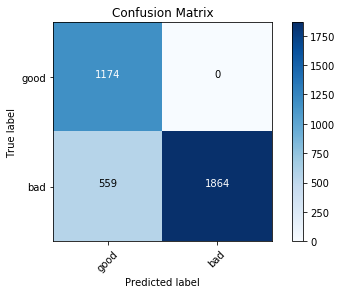

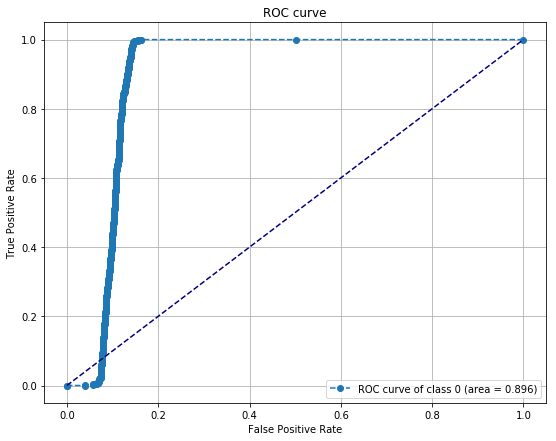

0.896229947107 For the label #1


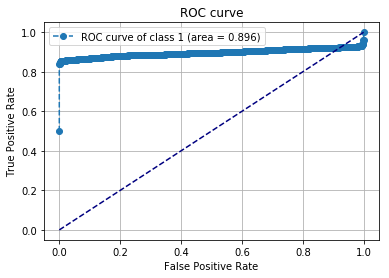

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_70 (Conv2D)           (None, 69, 31, 3)         27        
_________________________________________________________________
batch_normalization_71 (Batc (None, 69, 31, 3)         12        
_________________________________________________________________
activation_71 (Activation)   (None, 69, 31, 3)         0         
_________________________________________________________________
max_pooling2d_69 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_68 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_68 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_69 (Dense)             (None, 2)                 1382      
Total para

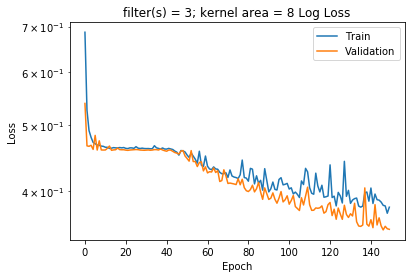

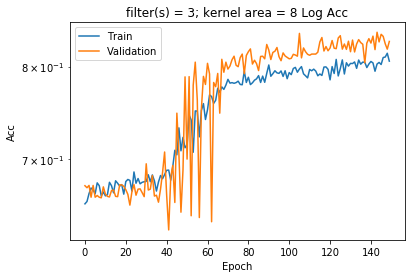

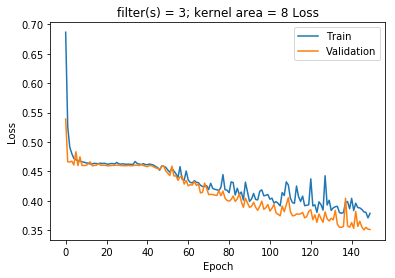

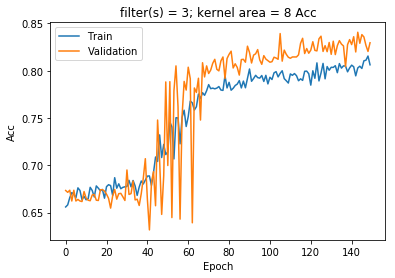

Confusion matrix, without normalization
[[1174    0]
 [ 591 1832]]
accuracy score:  0.835696413678
0.89152348905 For the label #0


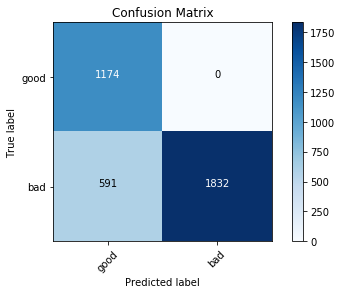

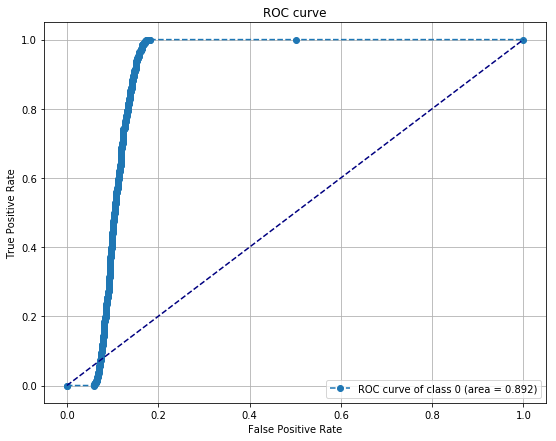

0.89152348905 For the label #1


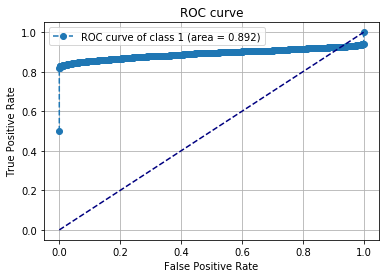

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_71 (Conv2D)           (None, 69, 30, 3)         39        
_________________________________________________________________
batch_normalization_72 (Batc (None, 69, 30, 3)         12        
_________________________________________________________________
activation_72 (Activation)   (None, 69, 30, 3)         0         
_________________________________________________________________
max_pooling2d_70 (MaxPooling (None, 23, 10, 3)         0         
_________________________________________________________________
dropout_69 (Dropout)         (None, 23, 10, 3)         0         
_________________________________________________________________
flatten_69 (Flatten)         (None, 690)               0         
_________________________________________________________________
dense_70 (Dense)             (None, 2)                 1382      
Total para

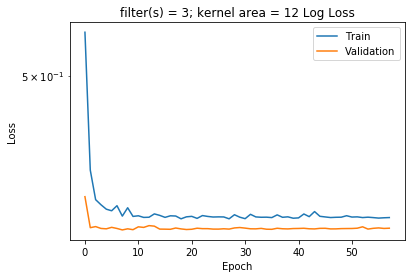

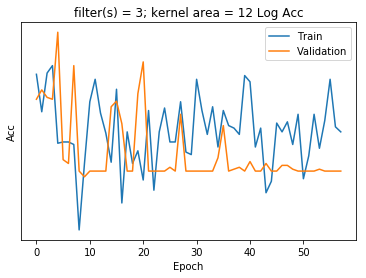

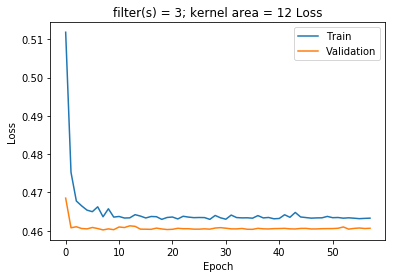

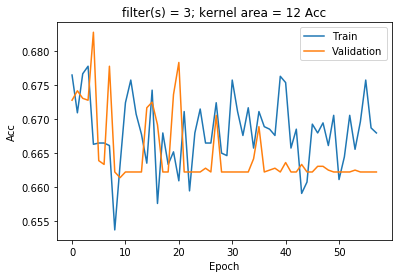

Confusion matrix, without normalization
[[ 965  209]
 [ 950 1473]]
accuracy score:  0.67778704476
0.764611710179 For the label #0


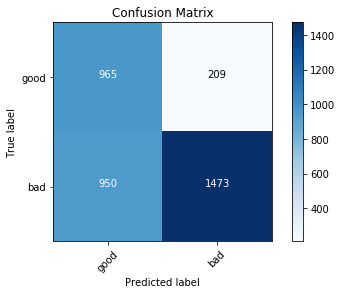

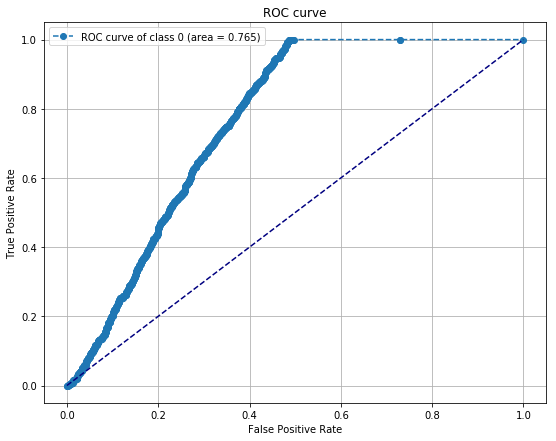

0.764611885951 For the label #1


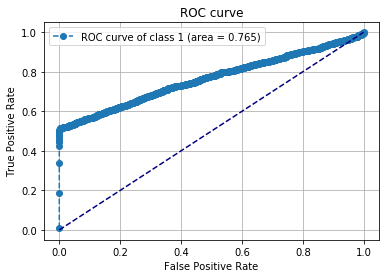

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_72 (Conv2D)           (None, 69, 29, 3)         51        
_________________________________________________________________
batch_normalization_73 (Batc (None, 69, 29, 3)         12        
_________________________________________________________________
activation_73 (Activation)   (None, 69, 29, 3)         0         
_________________________________________________________________
max_pooling2d_71 (MaxPooling (None, 23, 9, 3)          0         
_________________________________________________________________
dropout_70 (Dropout)         (None, 23, 9, 3)          0         
_________________________________________________________________
flatten_70 (Flatten)         (None, 621)               0         
_________________________________________________________________
dense_71 (Dense)             (None, 2)                 1244      
Total para

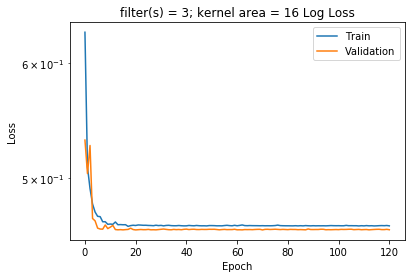

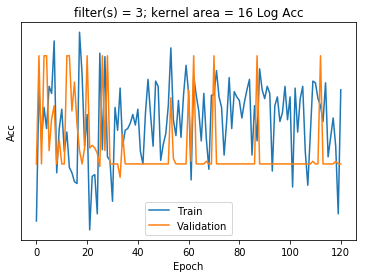

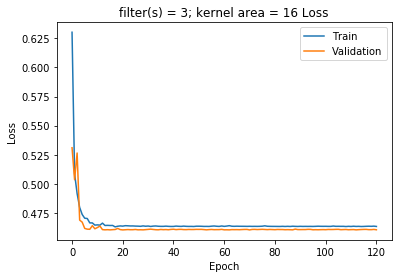

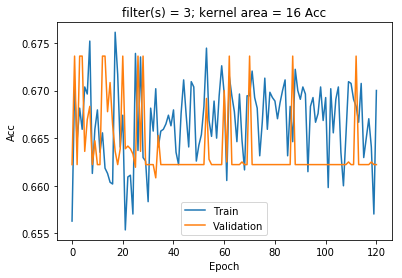

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.751632565821 For the label #0


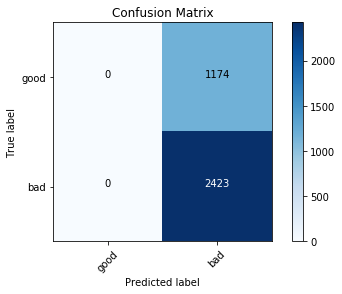

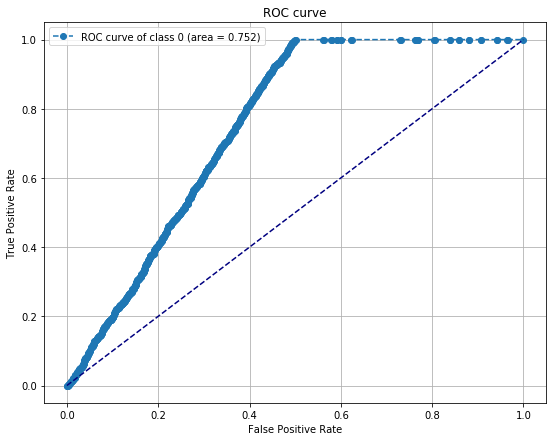

0.751632214278 For the label #1


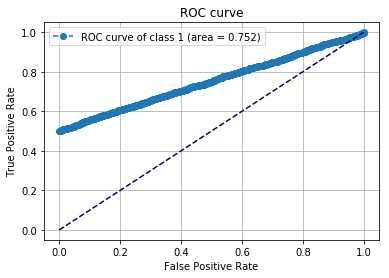

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_73 (Conv2D)           (None, 69, 28, 3)         63        
_________________________________________________________________
batch_normalization_74 (Batc (None, 69, 28, 3)         12        
_________________________________________________________________
activation_74 (Activation)   (None, 69, 28, 3)         0         
_________________________________________________________________
max_pooling2d_72 (MaxPooling (None, 23, 9, 3)          0         
_________________________________________________________________
dropout_71 (Dropout)         (None, 23, 9, 3)          0         
_________________________________________________________________
flatten_71 (Flatten)         (None, 621)               0         
_________________________________________________________________
dense_72 (Dense)             (None, 2)                 1244      
Total para

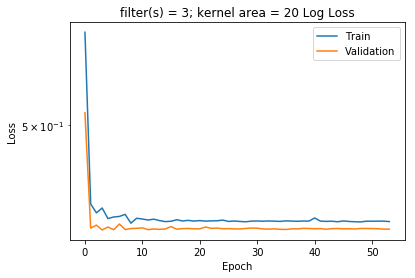

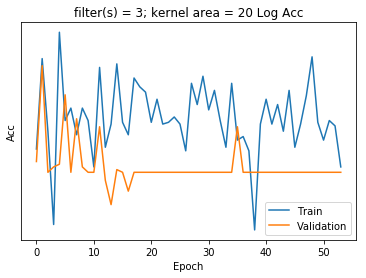

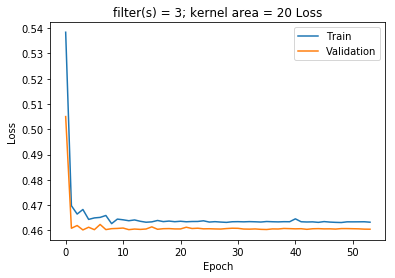

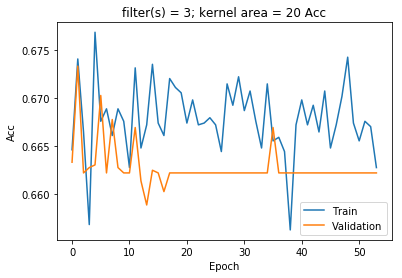

Confusion matrix, without normalization
[[ 154 1020]
 [ 193 2230]]
accuracy score:  0.662774534334
0.751524993655 For the label #0


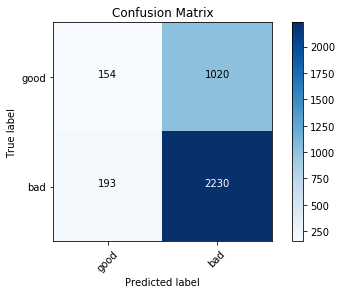

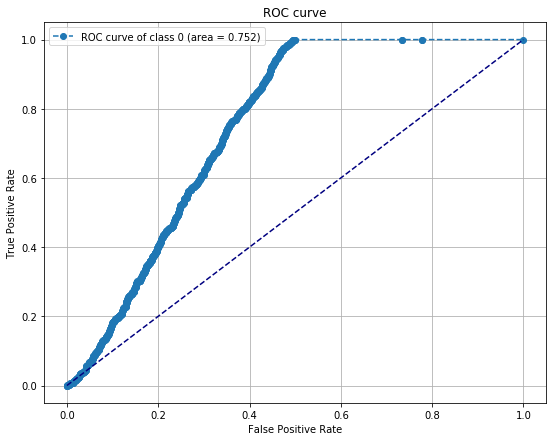

0.751524993655 For the label #1


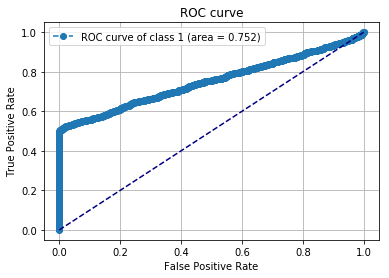

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_74 (Conv2D)           (None, 68, 32, 3)         18        
_________________________________________________________________
batch_normalization_75 (Batc (None, 68, 32, 3)         12        
_________________________________________________________________
activation_75 (Activation)   (None, 68, 32, 3)         0         
_________________________________________________________________
max_pooling2d_73 (MaxPooling (None, 22, 10, 3)         0         
_________________________________________________________________
dropout_72 (Dropout)         (None, 22, 10, 3)         0         
_________________________________________________________________
flatten_72 (Flatten)         (None, 660)               0         
_________________________________________________________________
dense_73 (Dense)             (None, 2)                 1322      
Total para

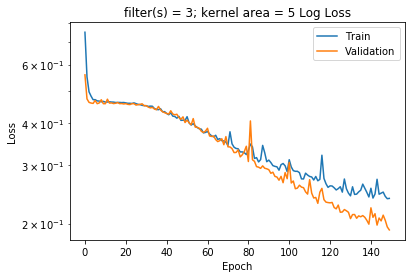

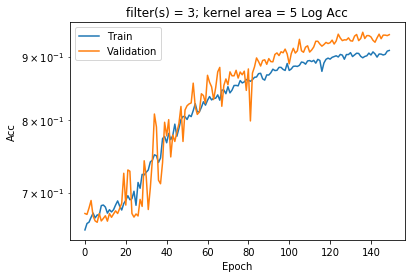

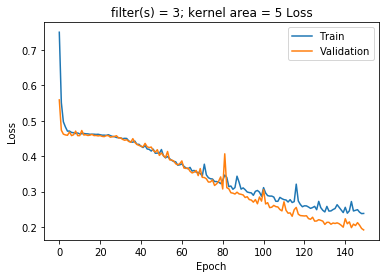

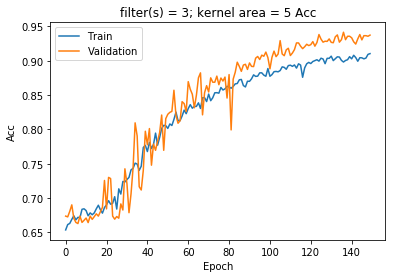

Confusion matrix, without normalization
[[1174    0]
 [ 225 2198]]
accuracy score:  0.937447873228
0.96914629885 For the label #0


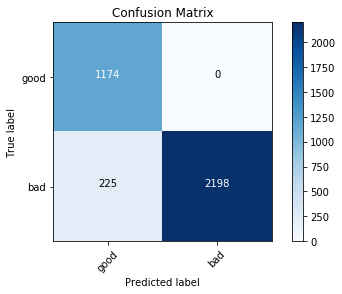

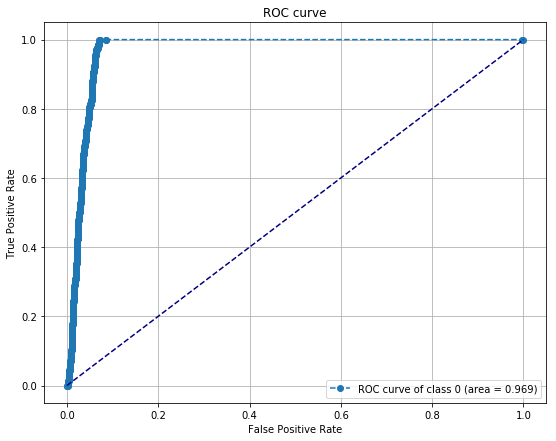

0.96914629885 For the label #1


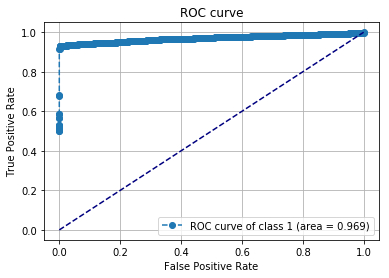

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_75 (Conv2D)           (None, 68, 31, 3)         33        
_________________________________________________________________
batch_normalization_76 (Batc (None, 68, 31, 3)         12        
_________________________________________________________________
activation_76 (Activation)   (None, 68, 31, 3)         0         
_________________________________________________________________
max_pooling2d_74 (MaxPooling (None, 22, 10, 3)         0         
_________________________________________________________________
dropout_73 (Dropout)         (None, 22, 10, 3)         0         
_________________________________________________________________
flatten_73 (Flatten)         (None, 660)               0         
_________________________________________________________________
dense_74 (Dense)             (None, 2)                 1322      
Total para

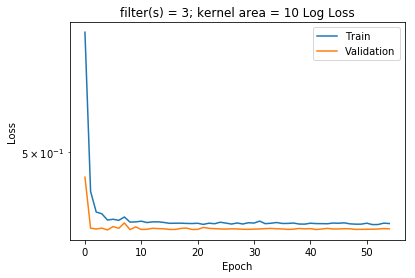

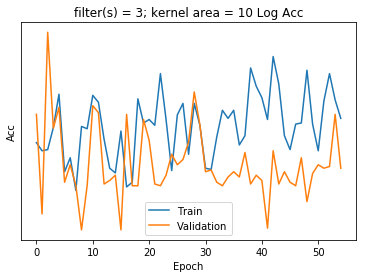

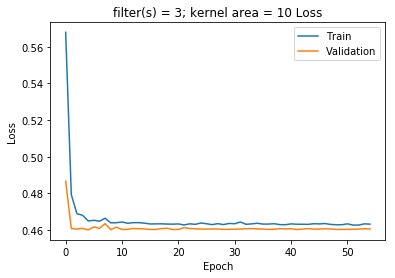

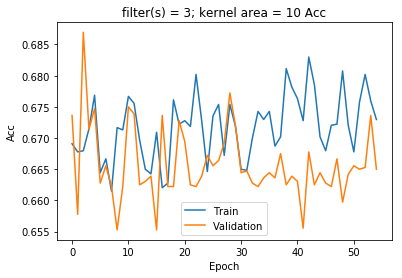

Confusion matrix, without normalization
[[ 533  641]
 [ 529 1894]]
accuracy score:  0.674728940784
0.757407363139 For the label #0


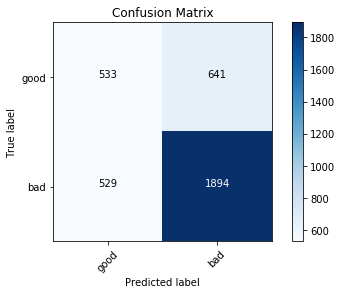

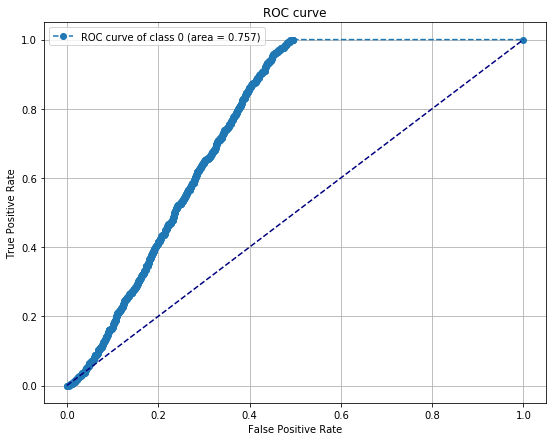

0.757407011596 For the label #1


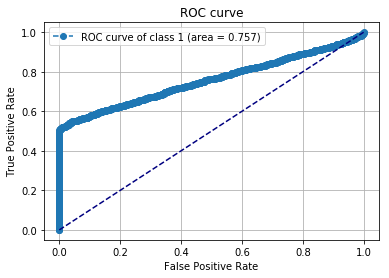

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_76 (Conv2D)           (None, 68, 30, 3)         48        
_________________________________________________________________
batch_normalization_77 (Batc (None, 68, 30, 3)         12        
_________________________________________________________________
activation_77 (Activation)   (None, 68, 30, 3)         0         
_________________________________________________________________
max_pooling2d_75 (MaxPooling (None, 22, 10, 3)         0         
_________________________________________________________________
dropout_74 (Dropout)         (None, 22, 10, 3)         0         
_________________________________________________________________
flatten_74 (Flatten)         (None, 660)               0         
_________________________________________________________________
dense_75 (Dense)             (None, 2)                 1322      
Total para

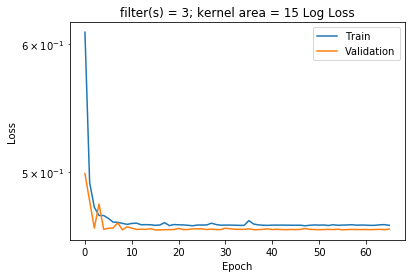

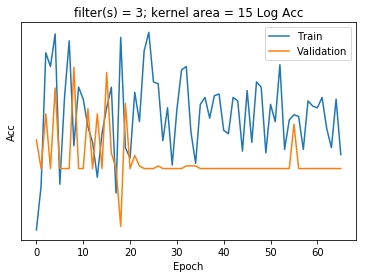

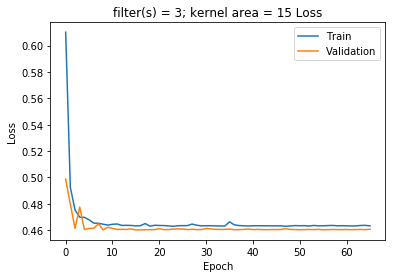

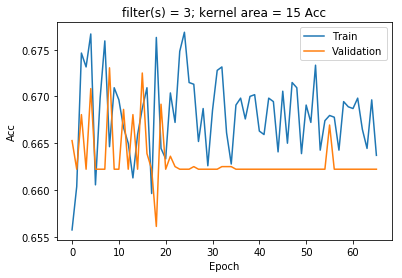

Confusion matrix, without normalization
[[   0 1174]
 [   4 2419]]
accuracy score:  0.672504865165
0.747342862024 For the label #0


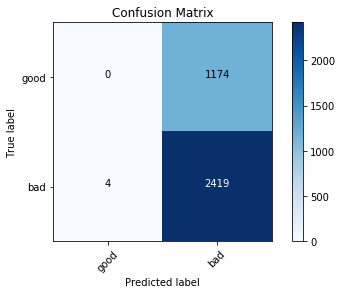

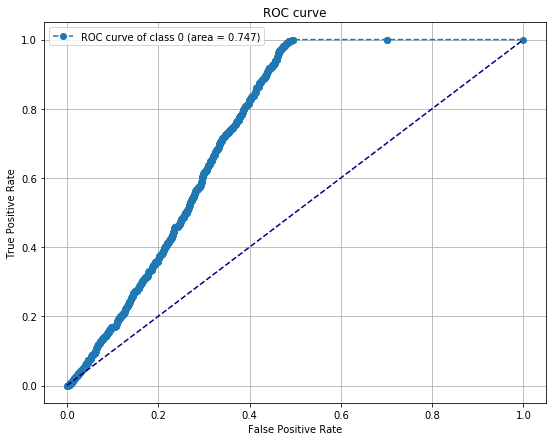

0.747343740882 For the label #1


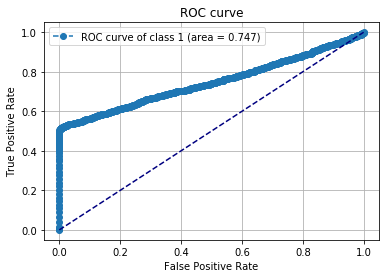

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_77 (Conv2D)           (None, 68, 29, 3)         63        
_________________________________________________________________
batch_normalization_78 (Batc (None, 68, 29, 3)         12        
_________________________________________________________________
activation_78 (Activation)   (None, 68, 29, 3)         0         
_________________________________________________________________
max_pooling2d_76 (MaxPooling (None, 22, 9, 3)          0         
_________________________________________________________________
dropout_75 (Dropout)         (None, 22, 9, 3)          0         
_________________________________________________________________
flatten_75 (Flatten)         (None, 594)               0         
_________________________________________________________________
dense_76 (Dense)             (None, 2)                 1190      
Total para

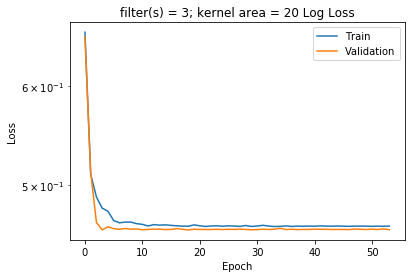

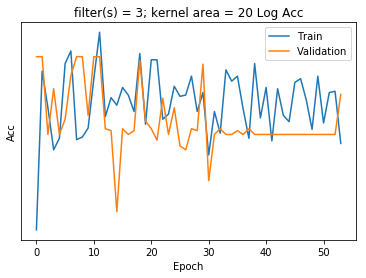

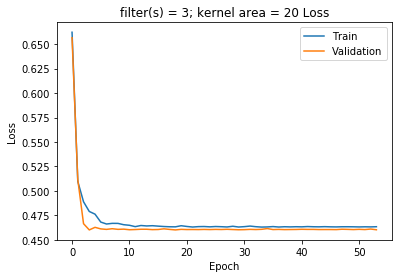

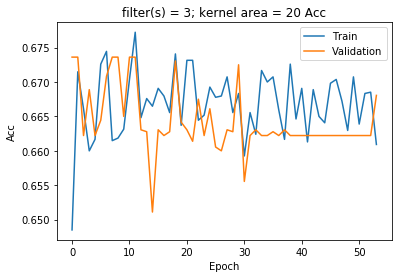

Confusion matrix, without normalization
[[ 511  663]
 [ 528 1895]]
accuracy score:  0.668890742285
0.757311567664 For the label #0


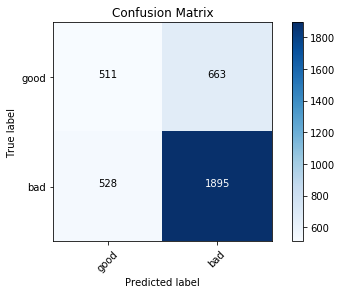

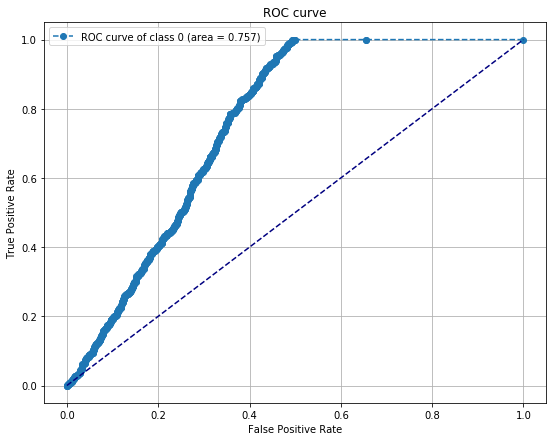

0.757313149608 For the label #1


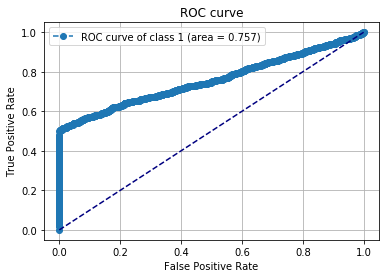

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_78 (Conv2D)           (None, 68, 28, 3)         78        
_________________________________________________________________
batch_normalization_79 (Batc (None, 68, 28, 3)         12        
_________________________________________________________________
activation_79 (Activation)   (None, 68, 28, 3)         0         
_________________________________________________________________
max_pooling2d_77 (MaxPooling (None, 22, 9, 3)          0         
_________________________________________________________________
dropout_76 (Dropout)         (None, 22, 9, 3)          0         
_________________________________________________________________
flatten_76 (Flatten)         (None, 594)               0         
_________________________________________________________________
dense_77 (Dense)             (None, 2)                 1190      
Total para

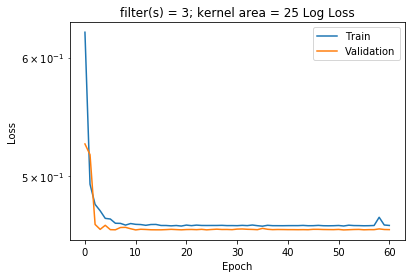

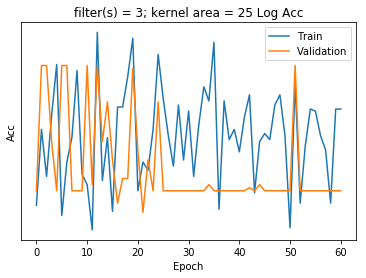

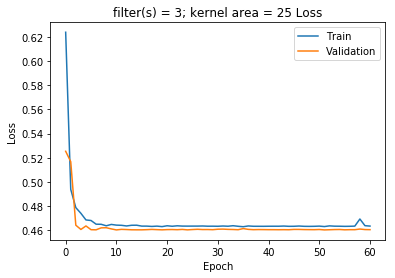

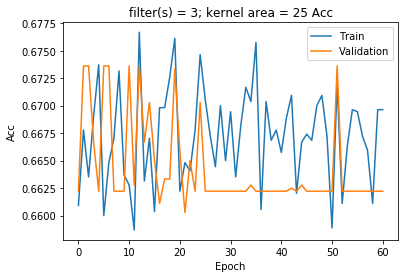

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.744591686289 For the label #0


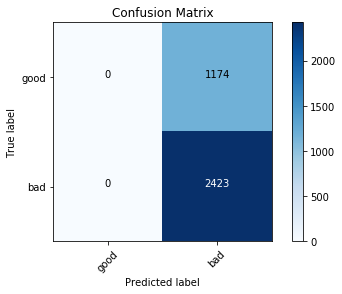

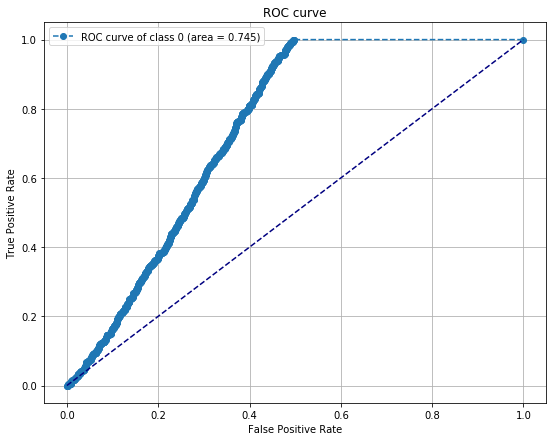

0.744591686289 For the label #1


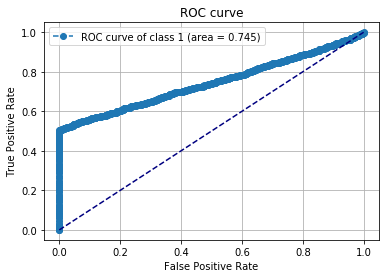

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_79 (Conv2D)           (None, 72, 32, 4)         8         
_________________________________________________________________
batch_normalization_80 (Batc (None, 72, 32, 4)         16        
_________________________________________________________________
activation_80 (Activation)   (None, 72, 32, 4)         0         
_________________________________________________________________
max_pooling2d_78 (MaxPooling (None, 24, 10, 4)         0         
_________________________________________________________________
dropout_77 (Dropout)         (None, 24, 10, 4)         0         
_________________________________________________________________
flatten_77 (Flatten)         (None, 960)               0         
_________________________________________________________________
dense_78 (Dense)             (None, 2)                 1922      
Total para

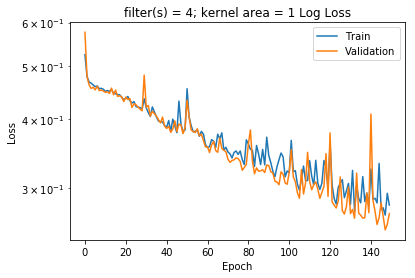

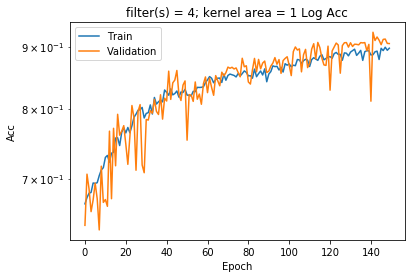

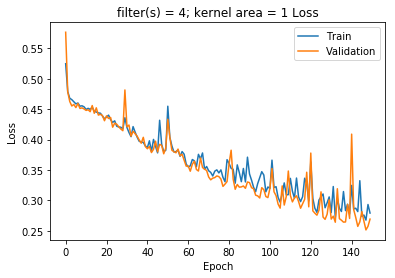

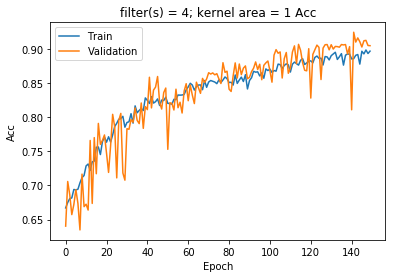

Confusion matrix, without normalization
[[1174    0]
 [ 312 2111]]
accuracy score:  0.913261050876
0.935362486562 For the label #0


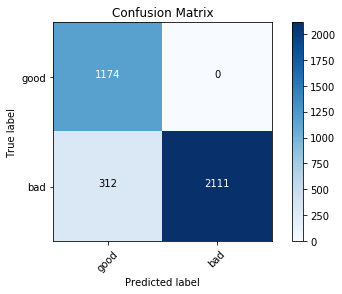

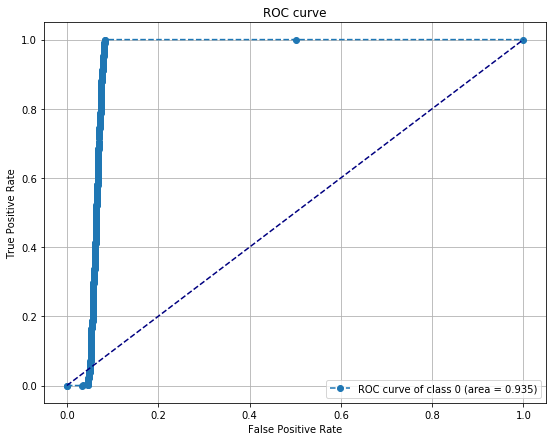

0.935362486562 For the label #1


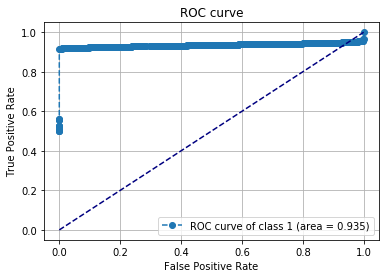

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_80 (Conv2D)           (None, 72, 31, 4)         12        
_________________________________________________________________
batch_normalization_81 (Batc (None, 72, 31, 4)         16        
_________________________________________________________________
activation_81 (Activation)   (None, 72, 31, 4)         0         
_________________________________________________________________
max_pooling2d_79 (MaxPooling (None, 24, 10, 4)         0         
_________________________________________________________________
dropout_78 (Dropout)         (None, 24, 10, 4)         0         
_________________________________________________________________
flatten_78 (Flatten)         (None, 960)               0         
_________________________________________________________________
dense_79 (Dense)             (None, 2)                 1922      
Total para

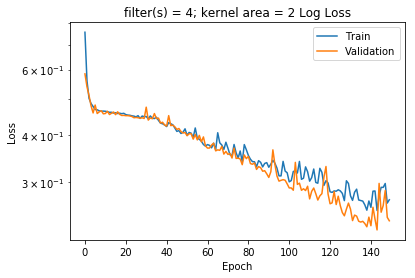

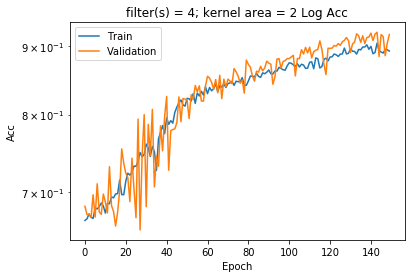

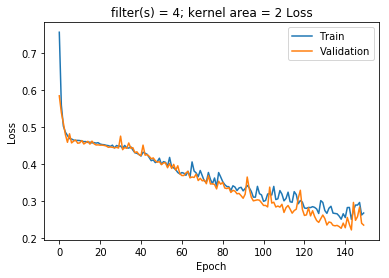

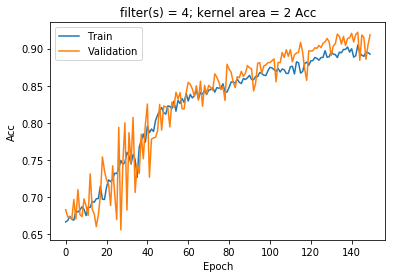

Confusion matrix, without normalization
[[1174    0]
 [ 281 2142]]
accuracy score:  0.921879343898
0.970892061526 For the label #0


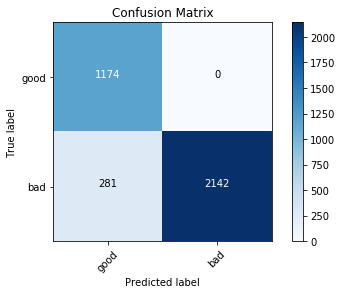

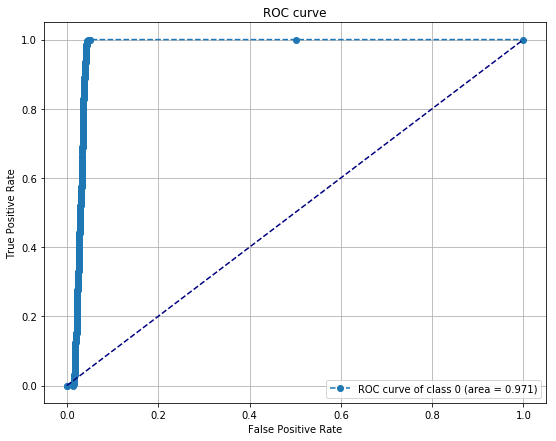

0.970892061526 For the label #1


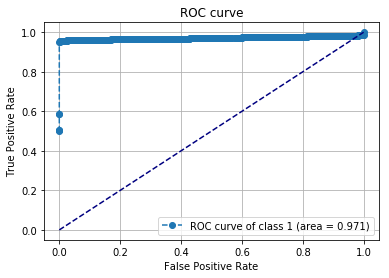

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_81 (Conv2D)           (None, 72, 30, 4)         16        
_________________________________________________________________
batch_normalization_82 (Batc (None, 72, 30, 4)         16        
_________________________________________________________________
activation_82 (Activation)   (None, 72, 30, 4)         0         
_________________________________________________________________
max_pooling2d_80 (MaxPooling (None, 24, 10, 4)         0         
_________________________________________________________________
dropout_79 (Dropout)         (None, 24, 10, 4)         0         
_________________________________________________________________
flatten_79 (Flatten)         (None, 960)               0         
_________________________________________________________________
dense_80 (Dense)             (None, 2)                 1922      
Total para

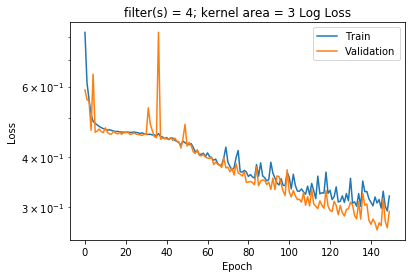

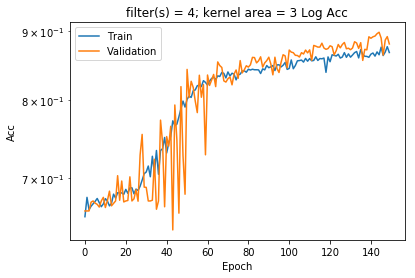

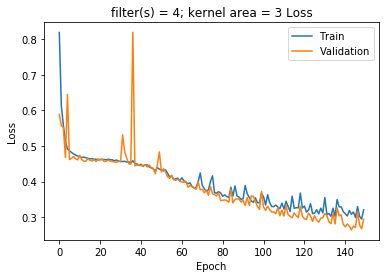

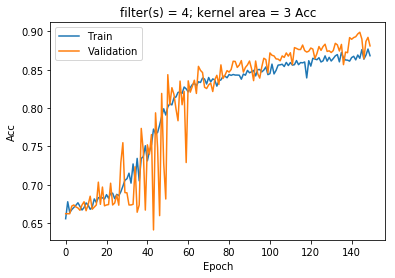

Confusion matrix, without normalization
[[1173    1]
 [ 371 2052]]
accuracy score:  0.896580483736
0.93662311986 For the label #0


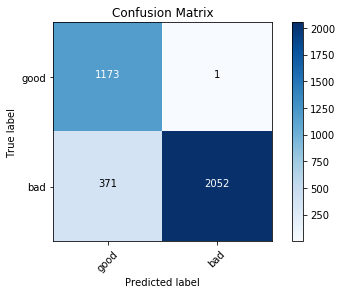

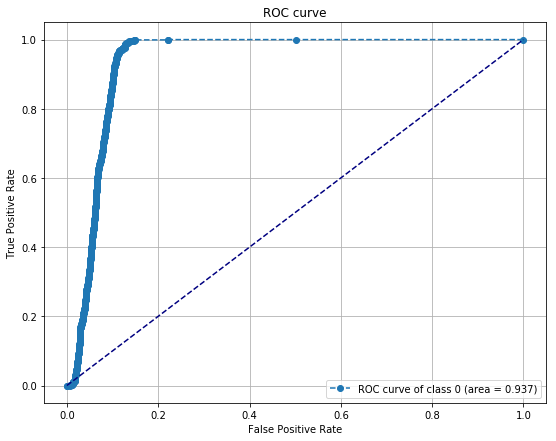

0.93662311986 For the label #1


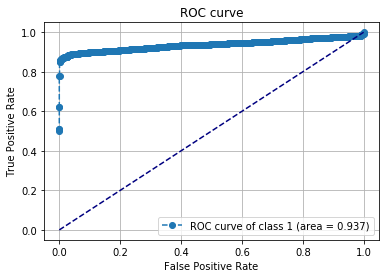

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_82 (Conv2D)           (None, 72, 29, 4)         20        
_________________________________________________________________
batch_normalization_83 (Batc (None, 72, 29, 4)         16        
_________________________________________________________________
activation_83 (Activation)   (None, 72, 29, 4)         0         
_________________________________________________________________
max_pooling2d_81 (MaxPooling (None, 24, 9, 4)          0         
_________________________________________________________________
dropout_80 (Dropout)         (None, 24, 9, 4)          0         
_________________________________________________________________
flatten_80 (Flatten)         (None, 864)               0         
_________________________________________________________________
dense_81 (Dense)             (None, 2)                 1730      
Total para

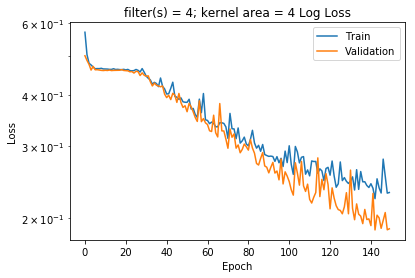

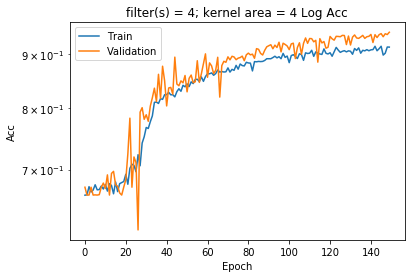

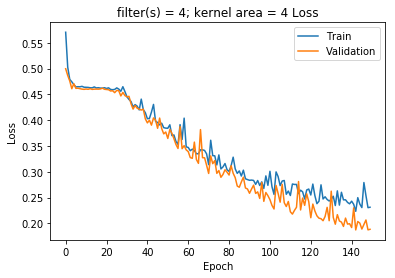

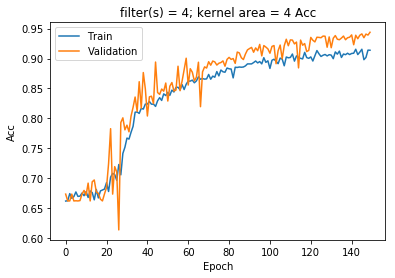

Confusion matrix, without normalization
[[1174    0]
 [ 220 2203]]
accuracy score:  0.938837920489
0.973179552008 For the label #0


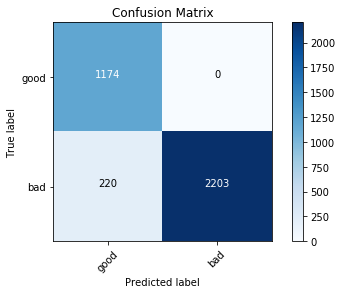

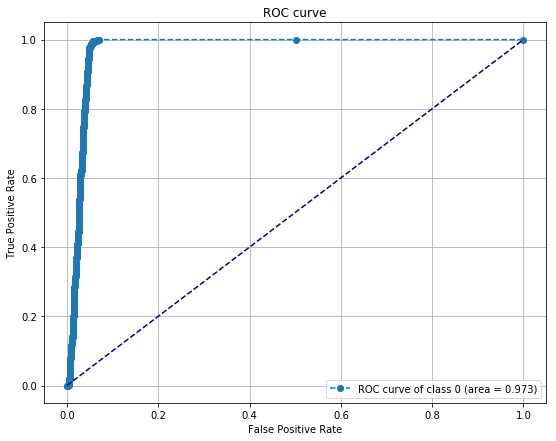

0.973179552008 For the label #1


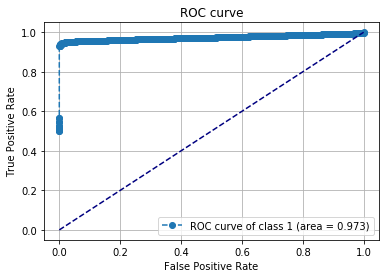

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_83 (Conv2D)           (None, 72, 28, 4)         24        
_________________________________________________________________
batch_normalization_84 (Batc (None, 72, 28, 4)         16        
_________________________________________________________________
activation_84 (Activation)   (None, 72, 28, 4)         0         
_________________________________________________________________
max_pooling2d_82 (MaxPooling (None, 24, 9, 4)          0         
_________________________________________________________________
dropout_81 (Dropout)         (None, 24, 9, 4)          0         
_________________________________________________________________
flatten_81 (Flatten)         (None, 864)               0         
_________________________________________________________________
dense_82 (Dense)             (None, 2)                 1730      
Total para

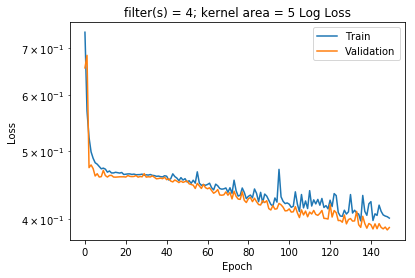

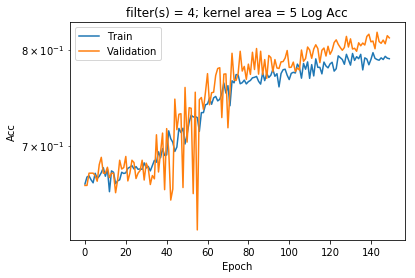

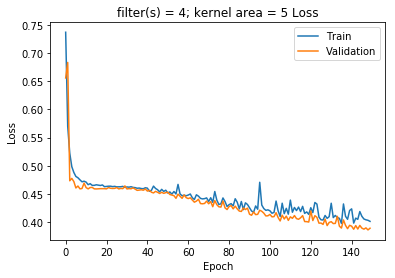

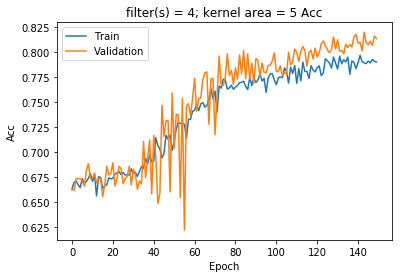

Confusion matrix, without normalization
[[1174    0]
 [ 663 1760]]
accuracy score:  0.815679733111
0.847200768332 For the label #0


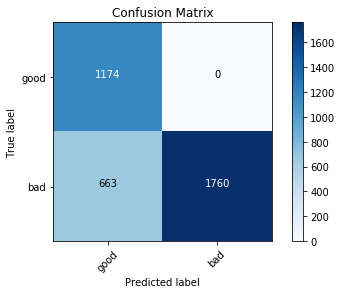

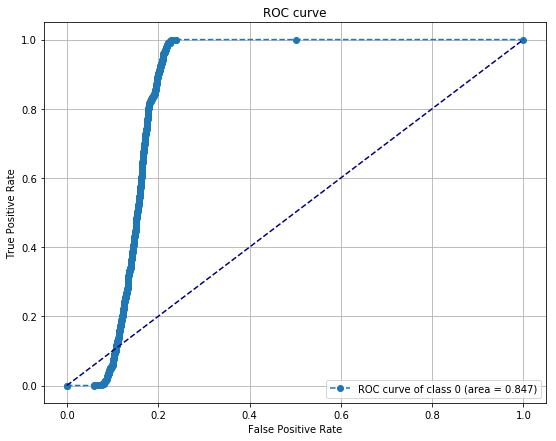

0.847200416789 For the label #1


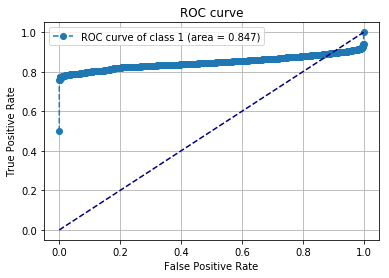

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_84 (Conv2D)           (None, 71, 32, 4)         12        
_________________________________________________________________
batch_normalization_85 (Batc (None, 71, 32, 4)         16        
_________________________________________________________________
activation_85 (Activation)   (None, 71, 32, 4)         0         
_________________________________________________________________
max_pooling2d_83 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_82 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_82 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_83 (Dense)             (None, 2)                 1842      
Total para

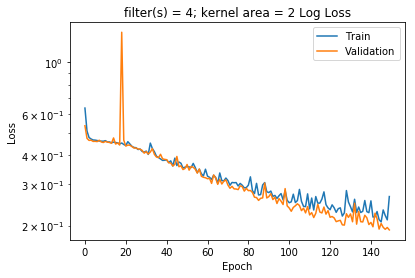

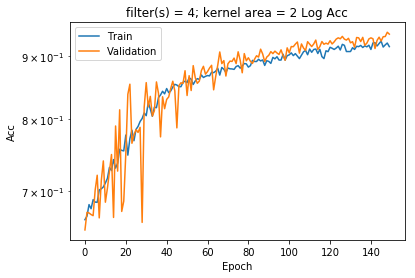

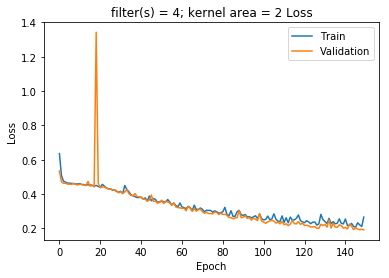

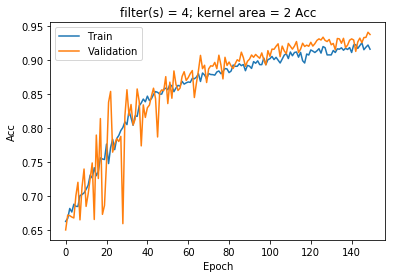

Confusion matrix, without normalization
[[1174    0]
 [ 226 2197]]
accuracy score:  0.937169863775
0.970346290975 For the label #0


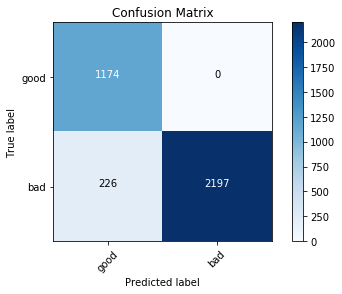

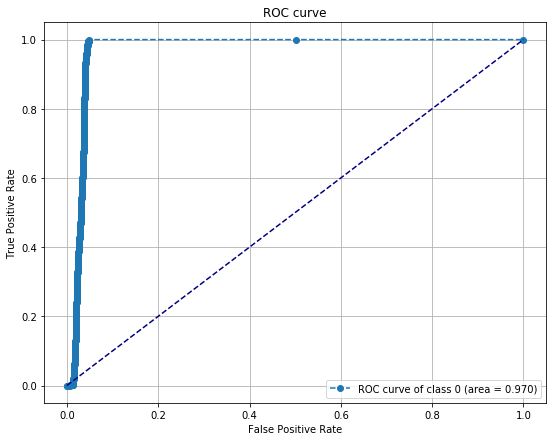

0.970346290975 For the label #1


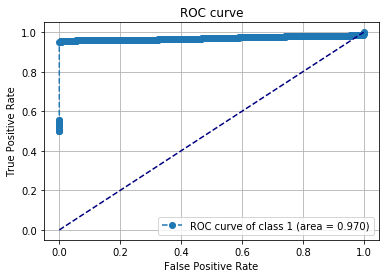

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_85 (Conv2D)           (None, 71, 31, 4)         20        
_________________________________________________________________
batch_normalization_86 (Batc (None, 71, 31, 4)         16        
_________________________________________________________________
activation_86 (Activation)   (None, 71, 31, 4)         0         
_________________________________________________________________
max_pooling2d_84 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_83 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_83 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_84 (Dense)             (None, 2)                 1842      
Total para

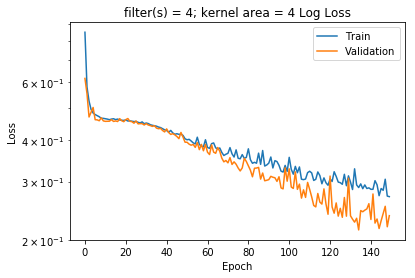

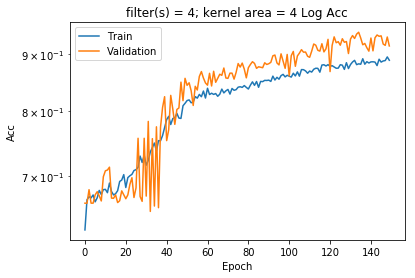

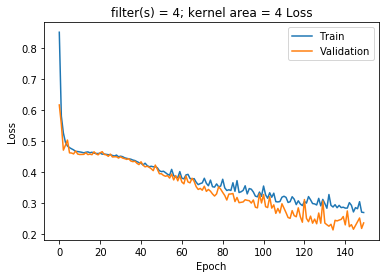

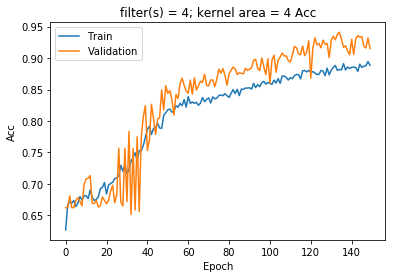

Confusion matrix, without normalization
[[1174    0]
 [ 212 2211]]
accuracy score:  0.941061996108
0.971434843961 For the label #0


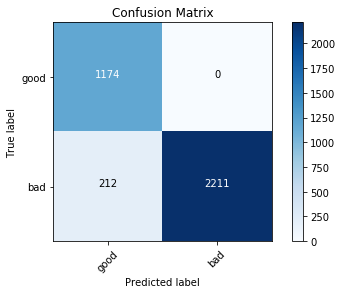

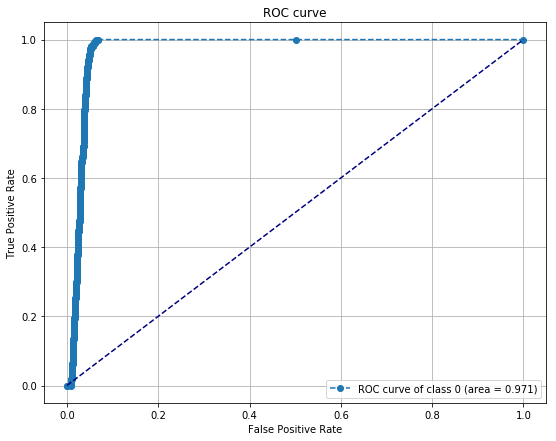

0.971434843961 For the label #1


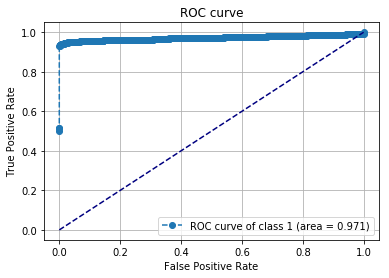

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_86 (Conv2D)           (None, 71, 30, 4)         28        
_________________________________________________________________
batch_normalization_87 (Batc (None, 71, 30, 4)         16        
_________________________________________________________________
activation_87 (Activation)   (None, 71, 30, 4)         0         
_________________________________________________________________
max_pooling2d_85 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_84 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_84 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_85 (Dense)             (None, 2)                 1842      
Total para

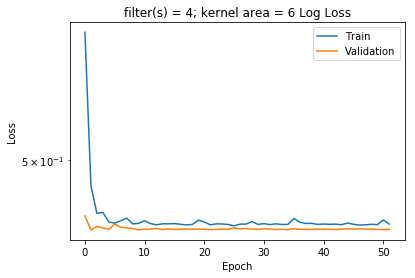

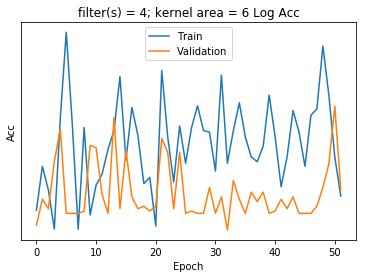

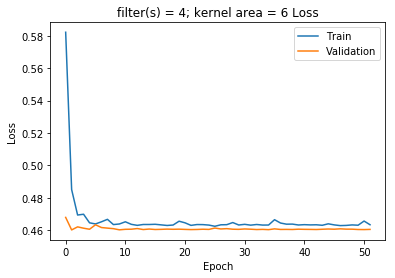

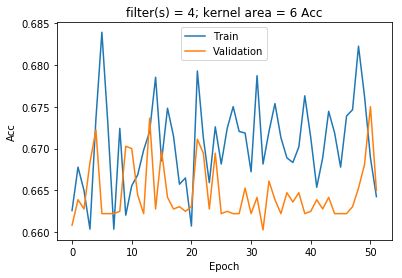

Confusion matrix, without normalization
[[ 116 1058]
 [ 151 2272]]
accuracy score:  0.663886572143
0.75582963803 For the label #0


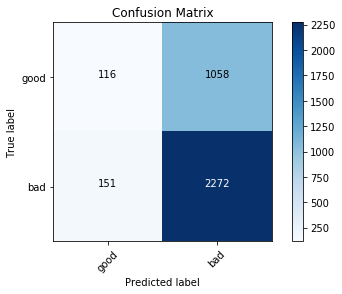

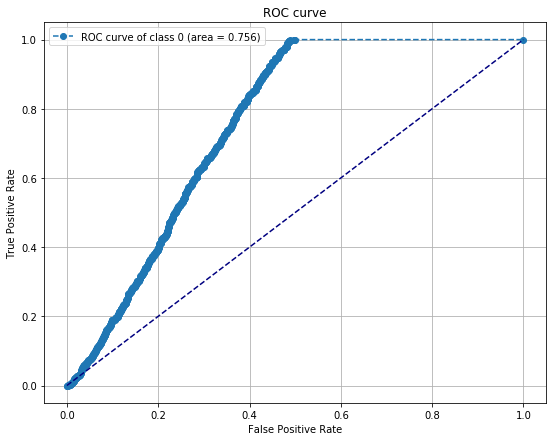

0.755829286487 For the label #1


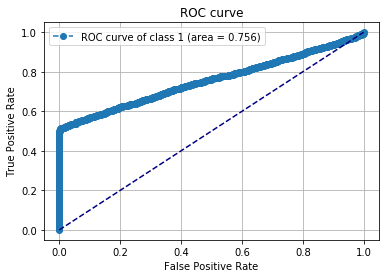

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_87 (Conv2D)           (None, 71, 29, 4)         36        
_________________________________________________________________
batch_normalization_88 (Batc (None, 71, 29, 4)         16        
_________________________________________________________________
activation_88 (Activation)   (None, 71, 29, 4)         0         
_________________________________________________________________
max_pooling2d_86 (MaxPooling (None, 23, 9, 4)          0         
_________________________________________________________________
dropout_85 (Dropout)         (None, 23, 9, 4)          0         
_________________________________________________________________
flatten_85 (Flatten)         (None, 828)               0         
_________________________________________________________________
dense_86 (Dense)             (None, 2)                 1658      
Total para

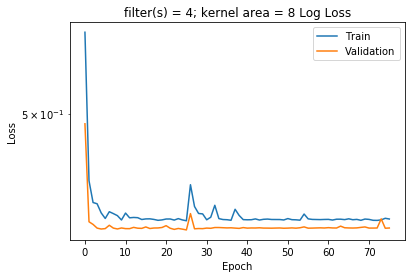

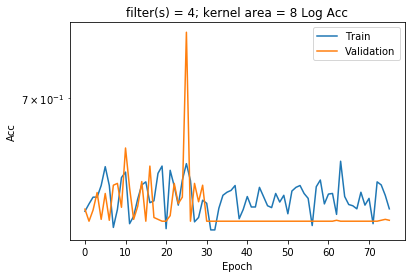

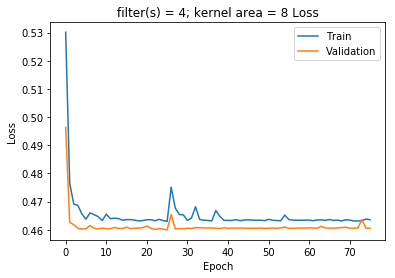

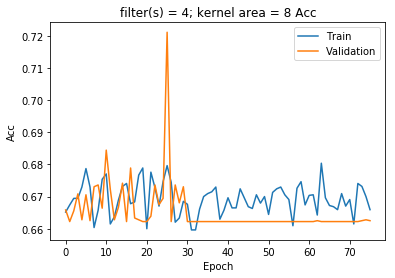

Confusion matrix, without normalization
[[1067  107]
 [ 896 1527]]
accuracy score:  0.721156519322
0.777973157581 For the label #0


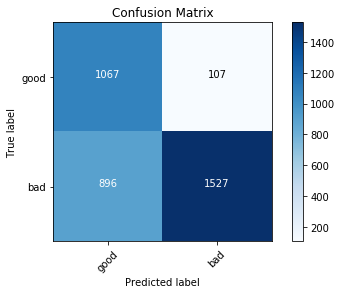

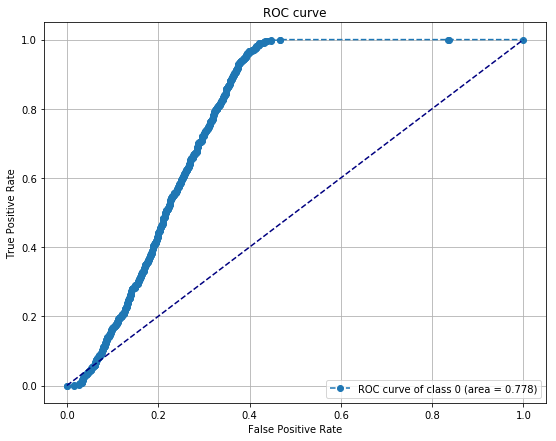

0.777971751408 For the label #1


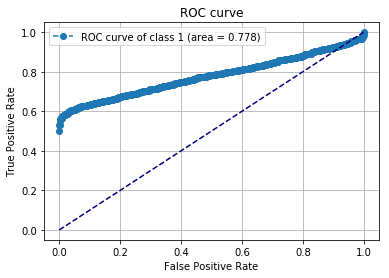

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_88 (Conv2D)           (None, 71, 28, 4)         44        
_________________________________________________________________
batch_normalization_89 (Batc (None, 71, 28, 4)         16        
_________________________________________________________________
activation_89 (Activation)   (None, 71, 28, 4)         0         
_________________________________________________________________
max_pooling2d_87 (MaxPooling (None, 23, 9, 4)          0         
_________________________________________________________________
dropout_86 (Dropout)         (None, 23, 9, 4)          0         
_________________________________________________________________
flatten_86 (Flatten)         (None, 828)               0         
_________________________________________________________________
dense_87 (Dense)             (None, 2)                 1658      
Total para

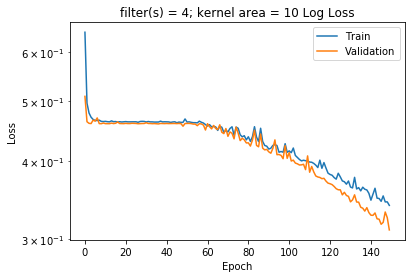

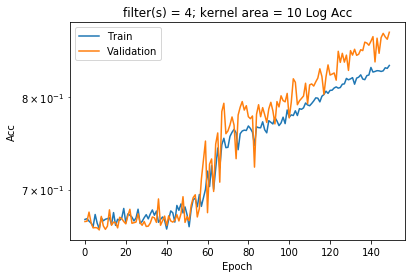

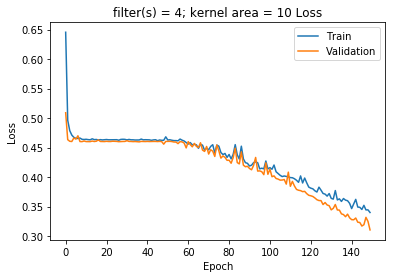

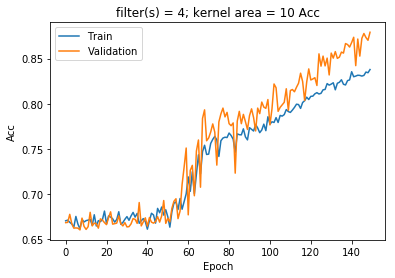

Confusion matrix, without normalization
[[1173    1]
 [ 434 1989]]
accuracy score:  0.87906588824
0.92732427946 For the label #0


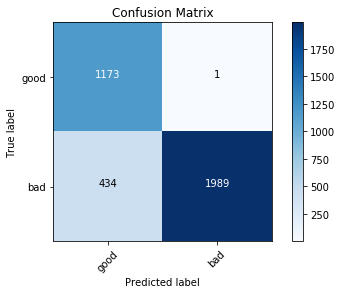

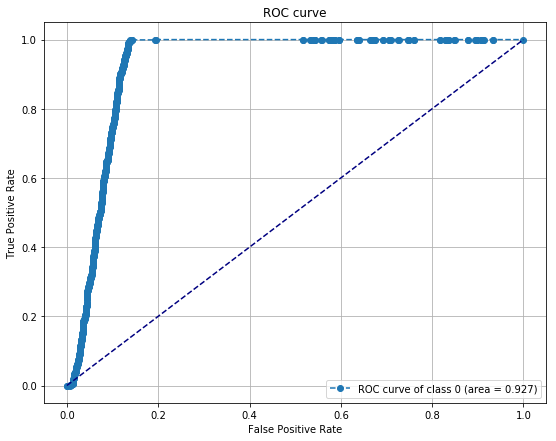

0.92732427946 For the label #1


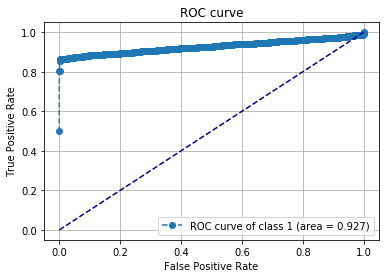

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_89 (Conv2D)           (None, 70, 32, 4)         16        
_________________________________________________________________
batch_normalization_90 (Batc (None, 70, 32, 4)         16        
_________________________________________________________________
activation_90 (Activation)   (None, 70, 32, 4)         0         
_________________________________________________________________
max_pooling2d_88 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_87 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_87 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_88 (Dense)             (None, 2)                 1842      
Total para

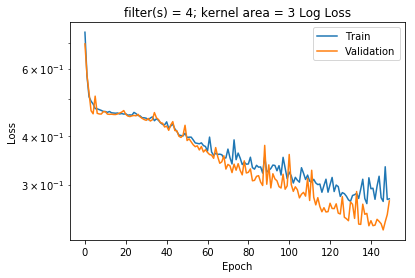

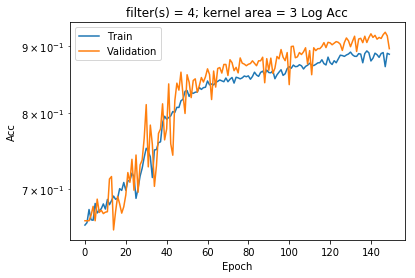

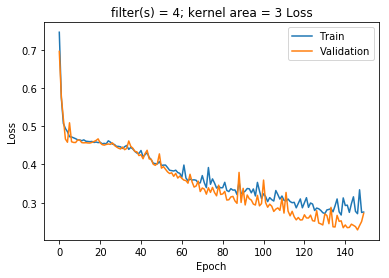

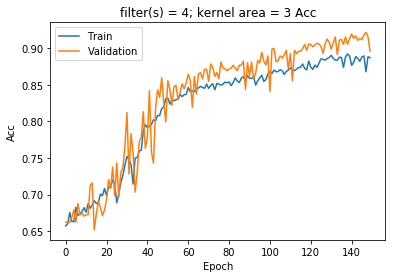

Confusion matrix, without normalization
[[1174    0]
 [ 296 2127]]
accuracy score:  0.917709202113
0.9554494794 For the label #0


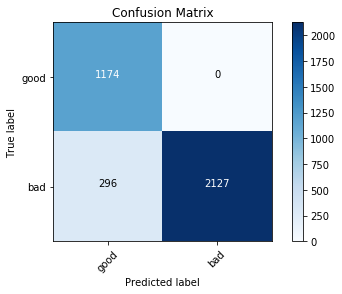

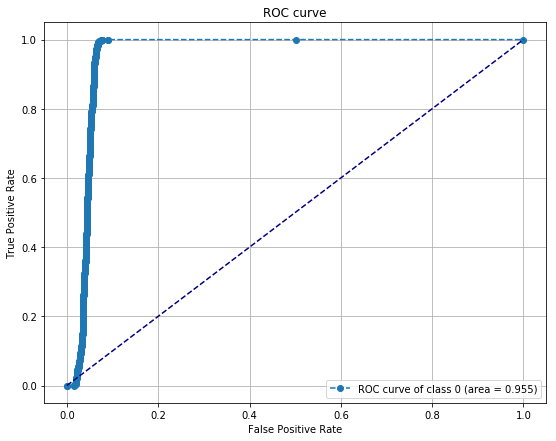

0.955450006714 For the label #1


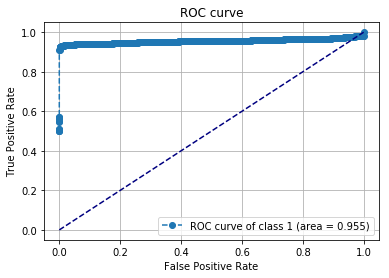

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_90 (Conv2D)           (None, 70, 31, 4)         28        
_________________________________________________________________
batch_normalization_91 (Batc (None, 70, 31, 4)         16        
_________________________________________________________________
activation_91 (Activation)   (None, 70, 31, 4)         0         
_________________________________________________________________
max_pooling2d_89 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_88 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_88 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_89 (Dense)             (None, 2)                 1842      
Total para

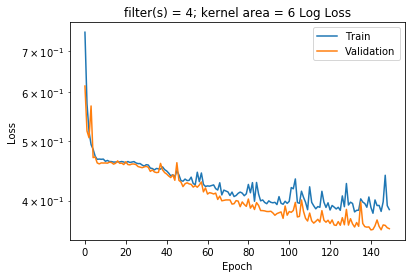

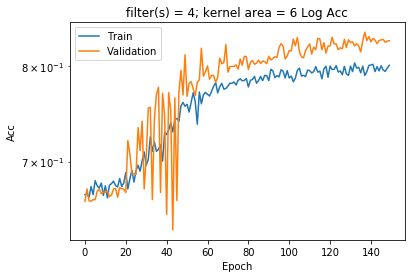

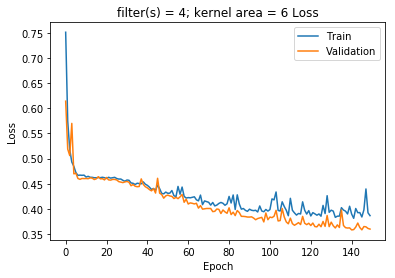

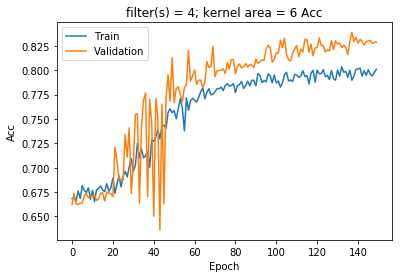

Confusion matrix, without normalization
[[1174    0]
 [ 619 1804]]
accuracy score:  0.827912149013
0.866780484581 For the label #0


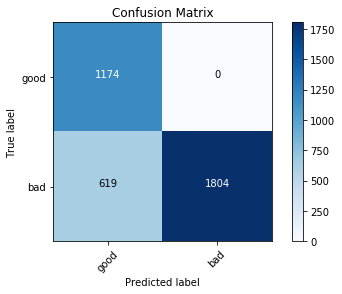

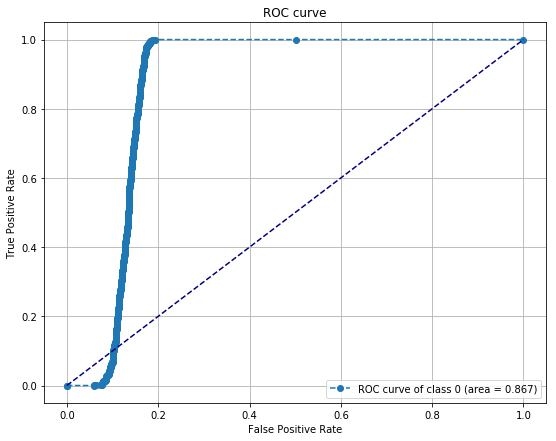

0.866780308809 For the label #1


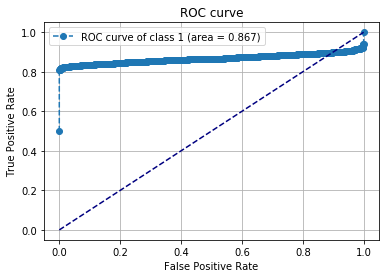

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_91 (Conv2D)           (None, 70, 30, 4)         40        
_________________________________________________________________
batch_normalization_92 (Batc (None, 70, 30, 4)         16        
_________________________________________________________________
activation_92 (Activation)   (None, 70, 30, 4)         0         
_________________________________________________________________
max_pooling2d_90 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_89 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_89 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_90 (Dense)             (None, 2)                 1842      
Total para

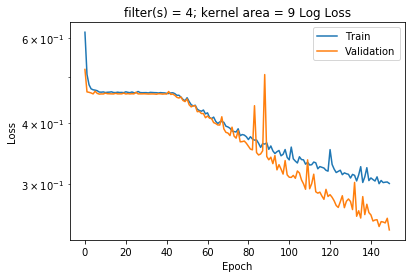

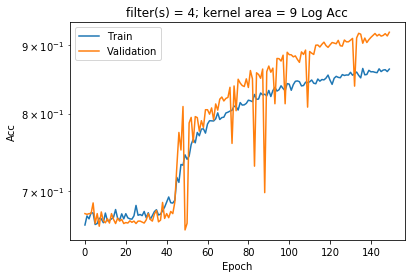

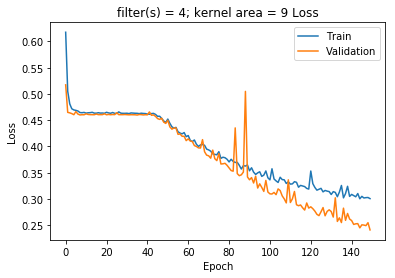

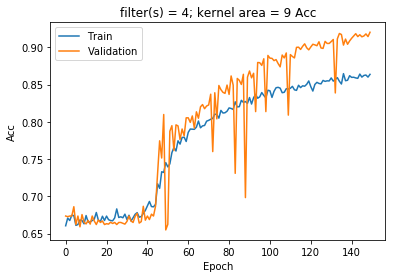

Confusion matrix, without normalization
[[1173    1]
 [ 286 2137]]
accuracy score:  0.920211287184
0.957274163486 For the label #0


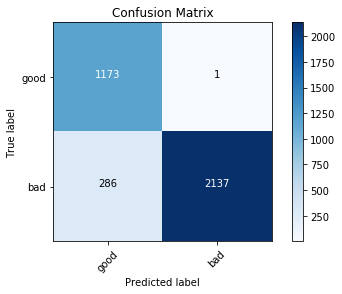

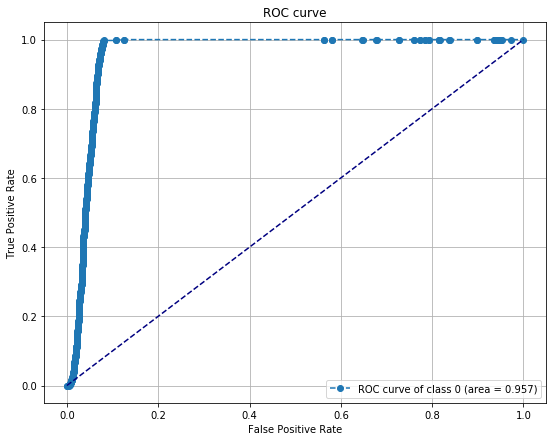

0.9572746908 For the label #1


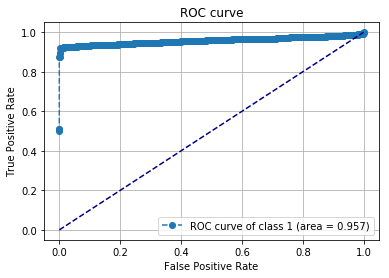

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_92 (Conv2D)           (None, 70, 29, 4)         52        
_________________________________________________________________
batch_normalization_93 (Batc (None, 70, 29, 4)         16        
_________________________________________________________________
activation_93 (Activation)   (None, 70, 29, 4)         0         
_________________________________________________________________
max_pooling2d_91 (MaxPooling (None, 23, 9, 4)          0         
_________________________________________________________________
dropout_90 (Dropout)         (None, 23, 9, 4)          0         
_________________________________________________________________
flatten_90 (Flatten)         (None, 828)               0         
_________________________________________________________________
dense_91 (Dense)             (None, 2)                 1658      
Total para

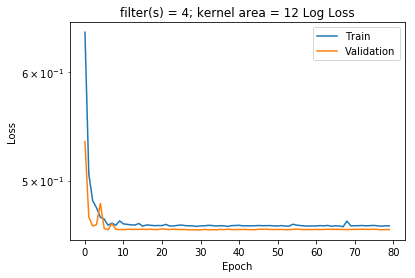

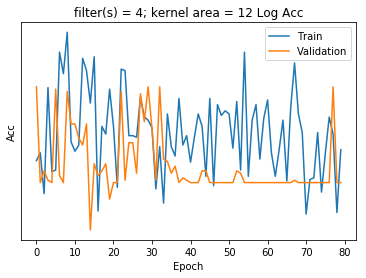

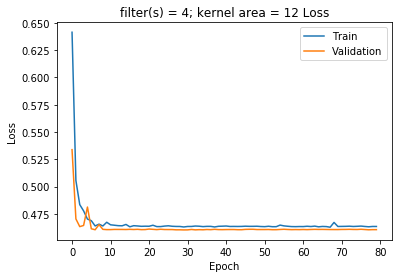

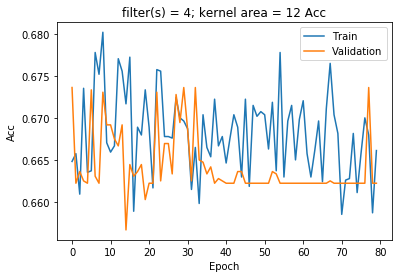

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.751087322585 For the label #0


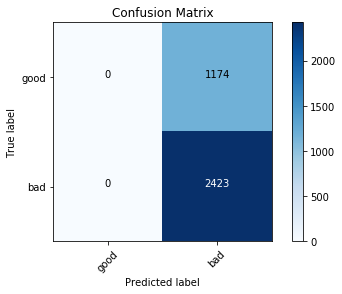

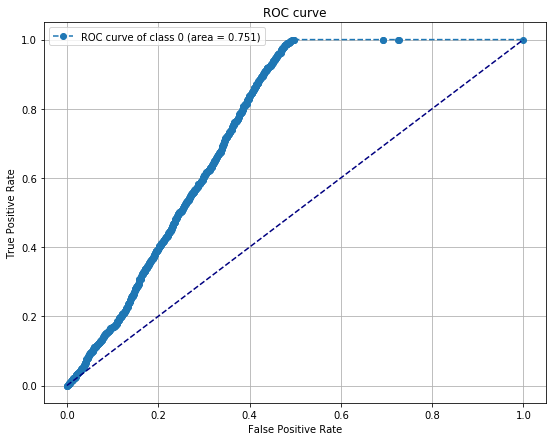

0.75108679527 For the label #1


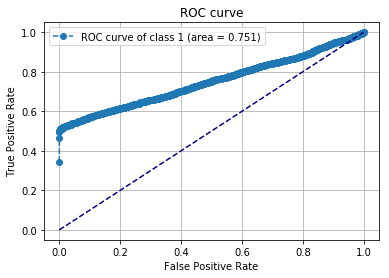

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_93 (Conv2D)           (None, 70, 28, 4)         64        
_________________________________________________________________
batch_normalization_94 (Batc (None, 70, 28, 4)         16        
_________________________________________________________________
activation_94 (Activation)   (None, 70, 28, 4)         0         
_________________________________________________________________
max_pooling2d_92 (MaxPooling (None, 23, 9, 4)          0         
_________________________________________________________________
dropout_91 (Dropout)         (None, 23, 9, 4)          0         
_________________________________________________________________
flatten_91 (Flatten)         (None, 828)               0         
_________________________________________________________________
dense_92 (Dense)             (None, 2)                 1658      
Total para

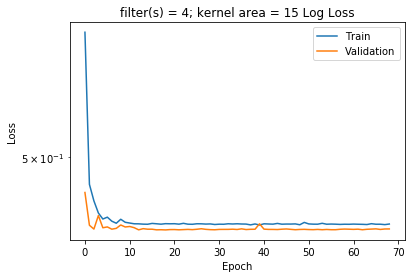

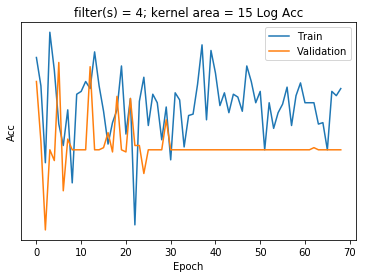

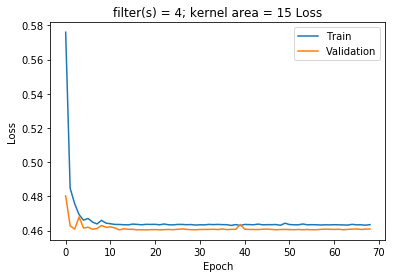

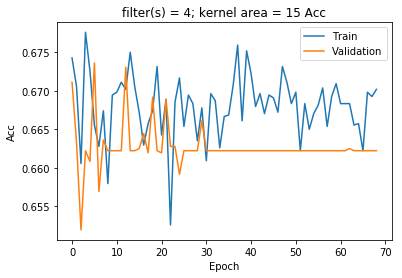

Confusion matrix, without normalization
[[ 116 1058]
 [ 132 2291]]
accuracy score:  0.669168751738
0.747058112172 For the label #0


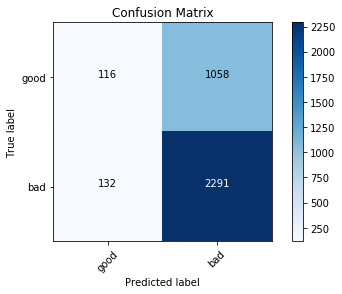

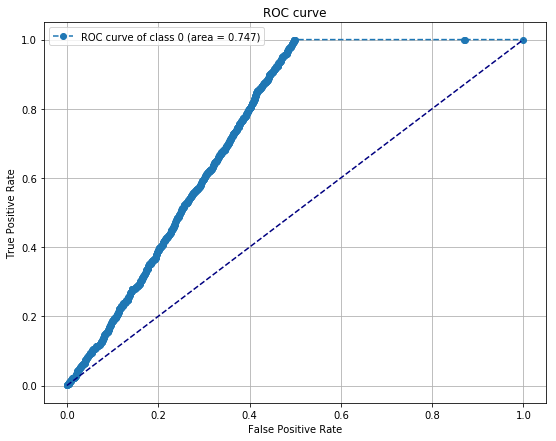

0.747056178685 For the label #1


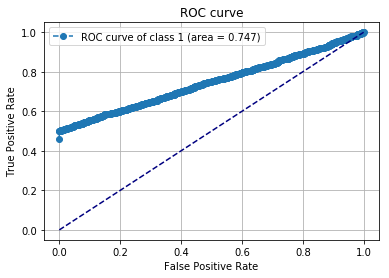

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_94 (Conv2D)           (None, 69, 32, 4)         20        
_________________________________________________________________
batch_normalization_95 (Batc (None, 69, 32, 4)         16        
_________________________________________________________________
activation_95 (Activation)   (None, 69, 32, 4)         0         
_________________________________________________________________
max_pooling2d_93 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_92 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_92 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_93 (Dense)             (None, 2)                 1842      
Total para

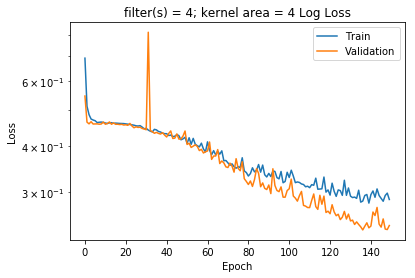

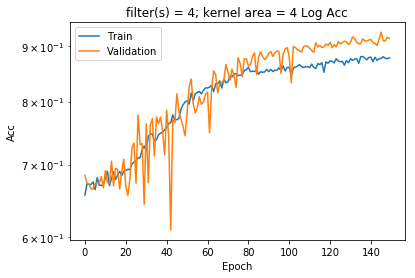

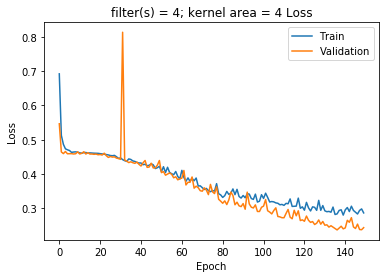

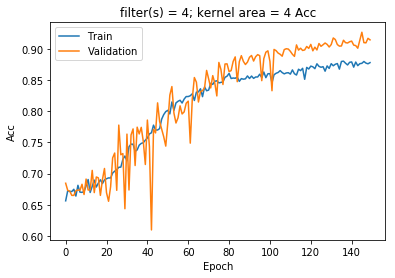

Confusion matrix, without normalization
[[1174    0]
 [ 311 2112]]
accuracy score:  0.913539060328
0.958318949364 For the label #0


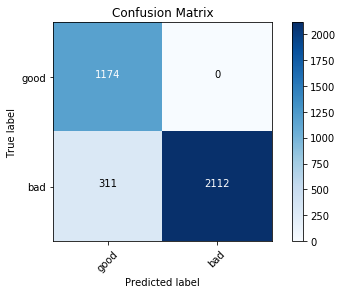

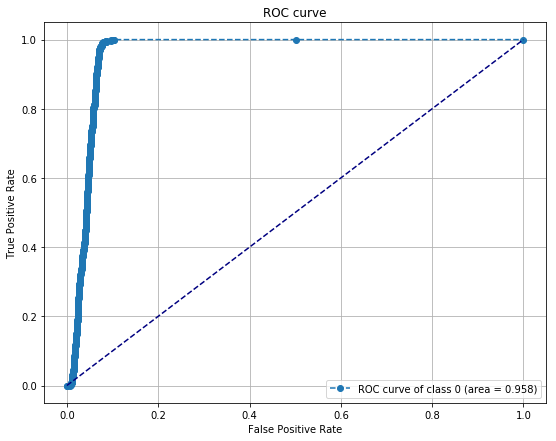

0.958318949364 For the label #1


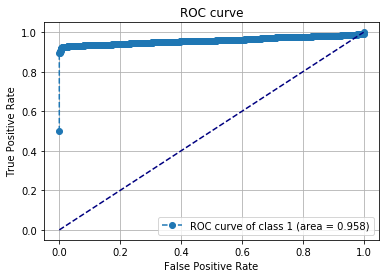

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_95 (Conv2D)           (None, 69, 31, 4)         36        
_________________________________________________________________
batch_normalization_96 (Batc (None, 69, 31, 4)         16        
_________________________________________________________________
activation_96 (Activation)   (None, 69, 31, 4)         0         
_________________________________________________________________
max_pooling2d_94 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_93 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_93 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_94 (Dense)             (None, 2)                 1842      
Total para

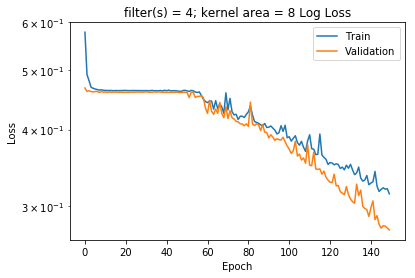

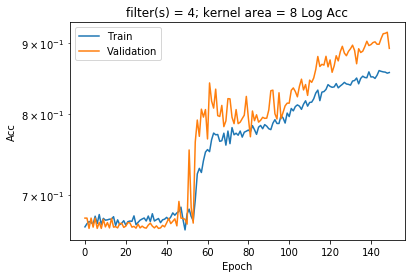

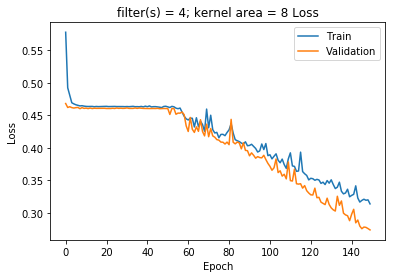

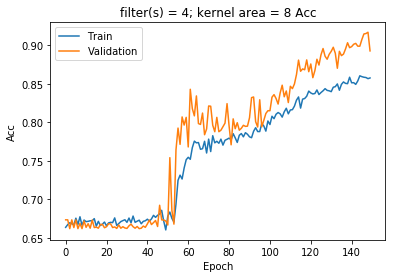

Confusion matrix, without normalization
[[1025  149]
 [ 237 2186]]
accuracy score:  0.892688351404
0.94798516629 For the label #0


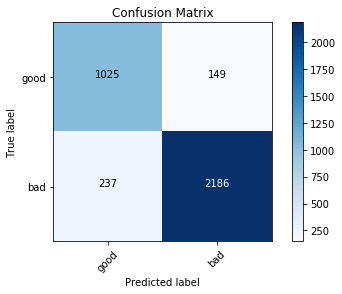

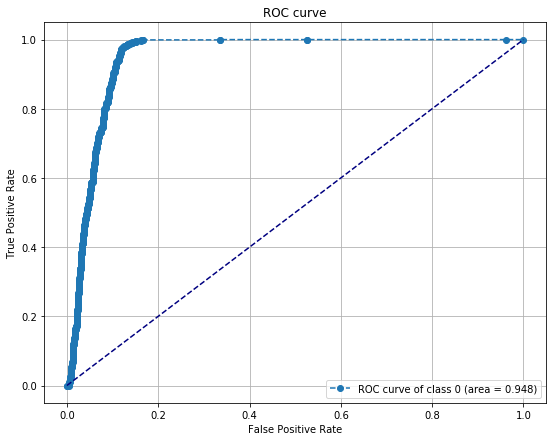

0.94798516629 For the label #1


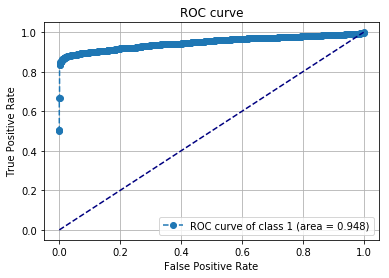

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_96 (Conv2D)           (None, 69, 30, 4)         52        
_________________________________________________________________
batch_normalization_97 (Batc (None, 69, 30, 4)         16        
_________________________________________________________________
activation_97 (Activation)   (None, 69, 30, 4)         0         
_________________________________________________________________
max_pooling2d_95 (MaxPooling (None, 23, 10, 4)         0         
_________________________________________________________________
dropout_94 (Dropout)         (None, 23, 10, 4)         0         
_________________________________________________________________
flatten_94 (Flatten)         (None, 920)               0         
_________________________________________________________________
dense_95 (Dense)             (None, 2)                 1842      
Total para

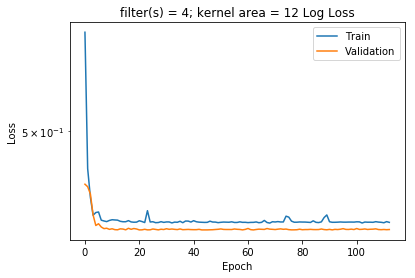

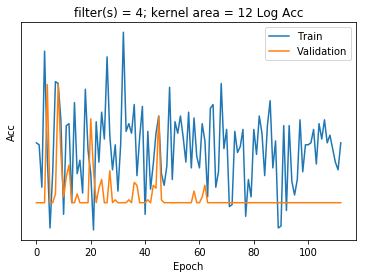

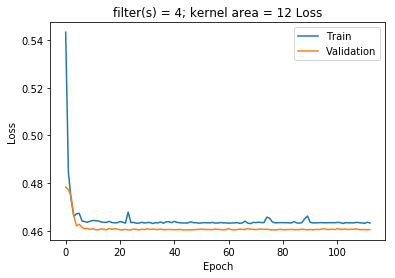

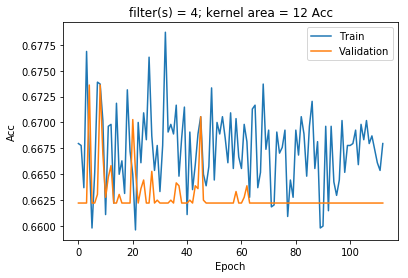

Confusion matrix, without normalization
[[1174    0]
 [1209 1214]]
accuracy score:  0.663886572143
0.750091576959 For the label #0


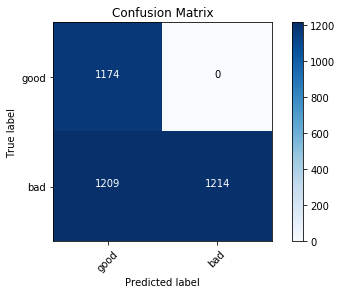

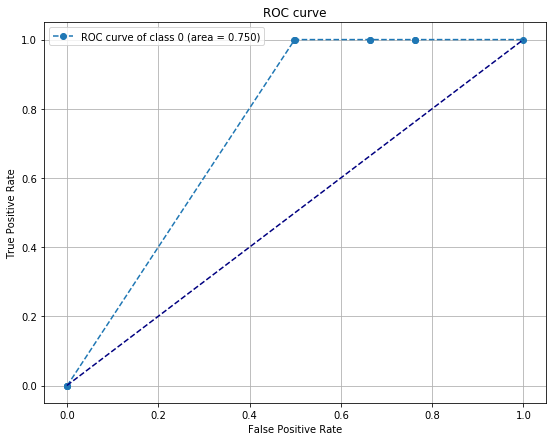

0.750091576959 For the label #1


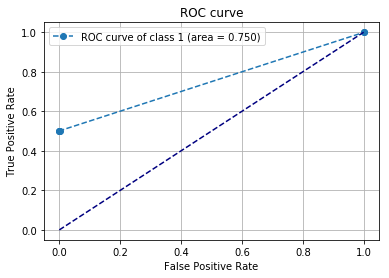

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_97 (Conv2D)           (None, 69, 29, 4)         68        
_________________________________________________________________
batch_normalization_98 (Batc (None, 69, 29, 4)         16        
_________________________________________________________________
activation_98 (Activation)   (None, 69, 29, 4)         0         
_________________________________________________________________
max_pooling2d_96 (MaxPooling (None, 23, 9, 4)          0         
_________________________________________________________________
dropout_95 (Dropout)         (None, 23, 9, 4)          0         
_________________________________________________________________
flatten_95 (Flatten)         (None, 828)               0         
_________________________________________________________________
dense_96 (Dense)             (None, 2)                 1658      
Total para

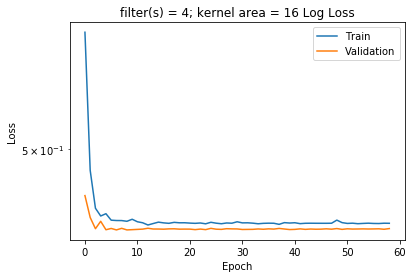

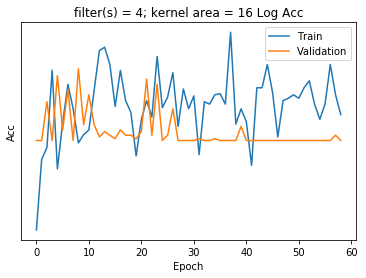

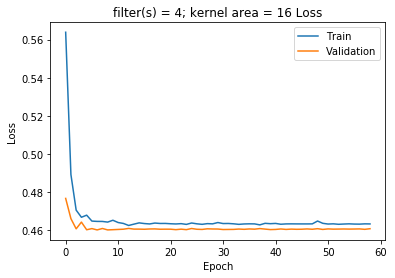

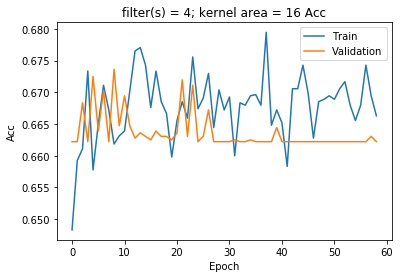

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.751887961831 For the label #0


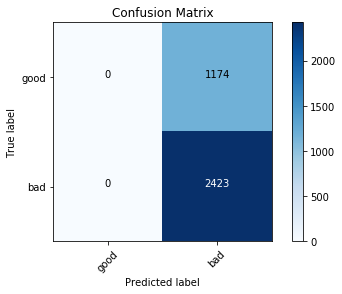

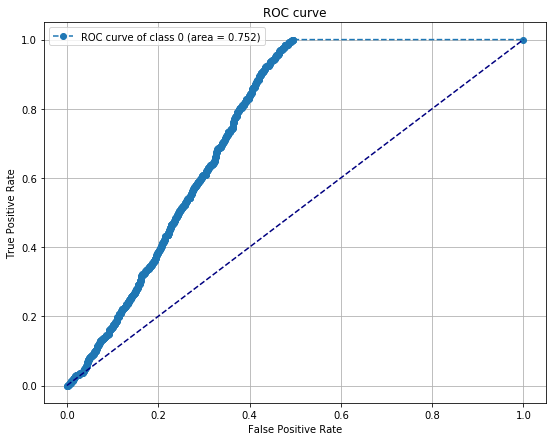

0.75188673143 For the label #1


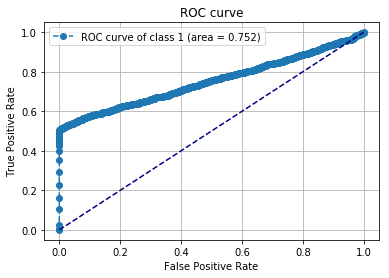

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_98 (Conv2D)           (None, 69, 28, 4)         84        
_________________________________________________________________
batch_normalization_99 (Batc (None, 69, 28, 4)         16        
_________________________________________________________________
activation_99 (Activation)   (None, 69, 28, 4)         0         
_________________________________________________________________
max_pooling2d_97 (MaxPooling (None, 23, 9, 4)          0         
_________________________________________________________________
dropout_96 (Dropout)         (None, 23, 9, 4)          0         
_________________________________________________________________
flatten_96 (Flatten)         (None, 828)               0         
_________________________________________________________________
dense_97 (Dense)             (None, 2)                 1658      
Total para

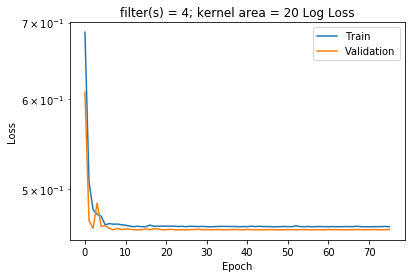

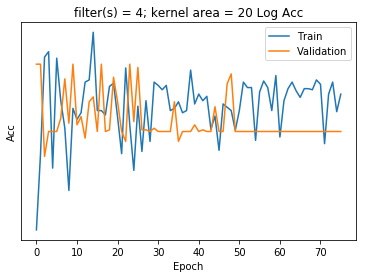

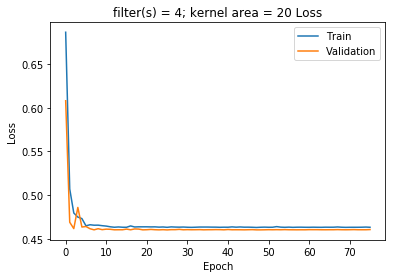

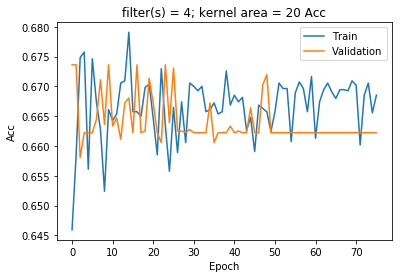

Confusion matrix, without normalization
[[   0 1174]
 [   2 2421]]
accuracy score:  0.67306088407
0.750626273904 For the label #0


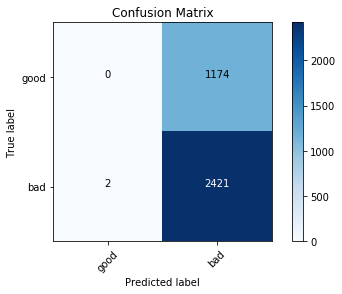

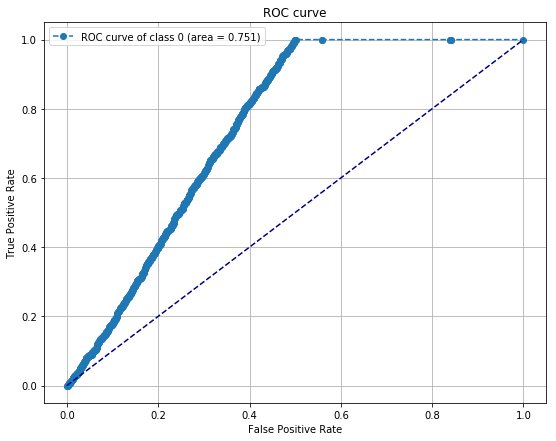

0.750625570818 For the label #1


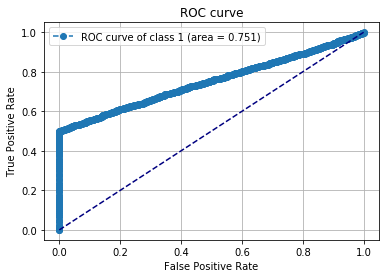

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_99 (Conv2D)           (None, 68, 32, 4)         24        
_________________________________________________________________
batch_normalization_100 (Bat (None, 68, 32, 4)         16        
_________________________________________________________________
activation_100 (Activation)  (None, 68, 32, 4)         0         
_________________________________________________________________
max_pooling2d_98 (MaxPooling (None, 22, 10, 4)         0         
_________________________________________________________________
dropout_97 (Dropout)         (None, 22, 10, 4)         0         
_________________________________________________________________
flatten_97 (Flatten)         (None, 880)               0         
_________________________________________________________________
dense_98 (Dense)             (None, 2)                 1762      
Total para

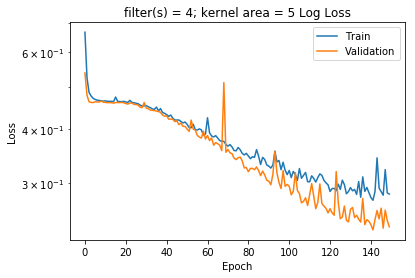

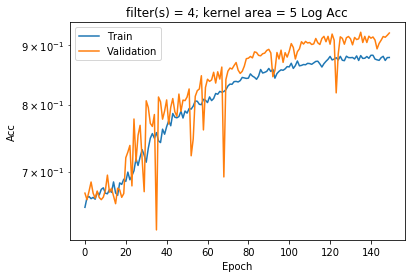

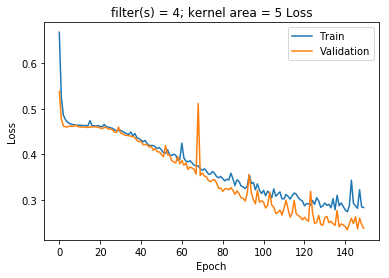

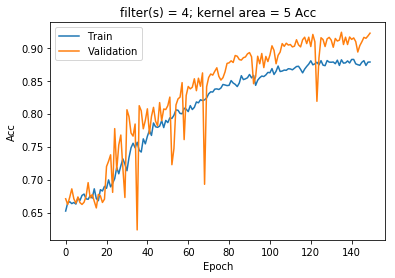

Confusion matrix, without normalization
[[1174    0]
 [ 306 2117]]
accuracy score:  0.91492910759
0.957323731053 For the label #0


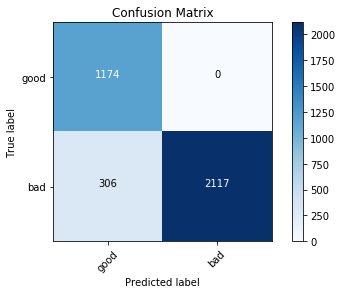

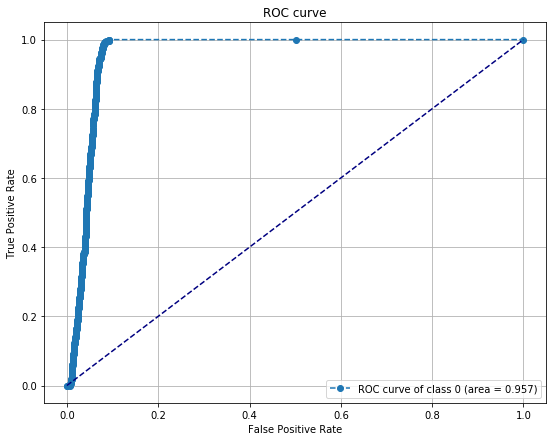

0.957323731053 For the label #1


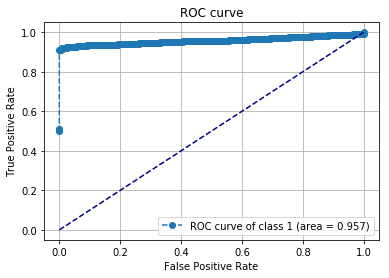

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_100 (Conv2D)          (None, 68, 31, 4)         44        
_________________________________________________________________
batch_normalization_101 (Bat (None, 68, 31, 4)         16        
_________________________________________________________________
activation_101 (Activation)  (None, 68, 31, 4)         0         
_________________________________________________________________
max_pooling2d_99 (MaxPooling (None, 22, 10, 4)         0         
_________________________________________________________________
dropout_98 (Dropout)         (None, 22, 10, 4)         0         
_________________________________________________________________
flatten_98 (Flatten)         (None, 880)               0         
_________________________________________________________________
dense_99 (Dense)             (None, 2)                 1762      
Total para

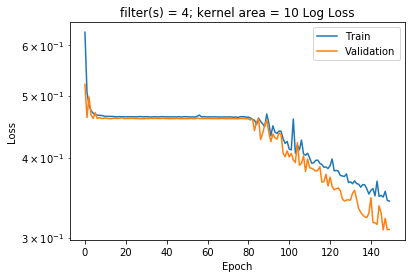

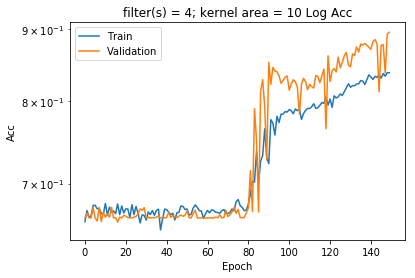

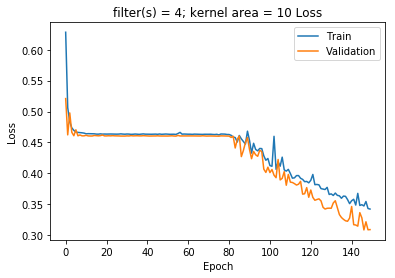

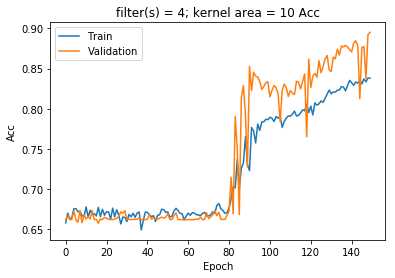

Confusion matrix, without normalization
[[1174    0]
 [ 441 1982]]
accuracy score:  0.877397831526
0.930414869989 For the label #0


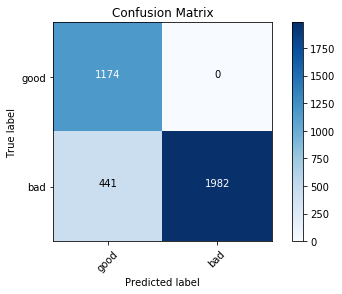

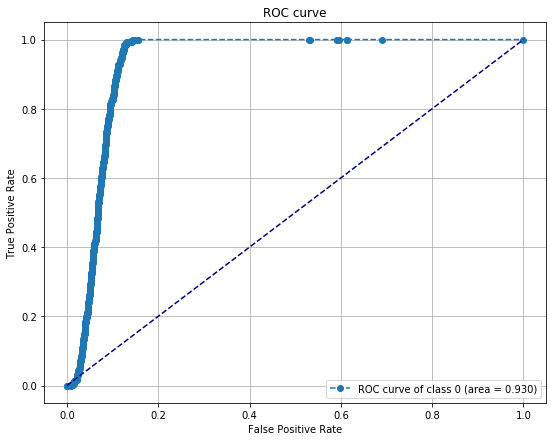

0.930414869989 For the label #1


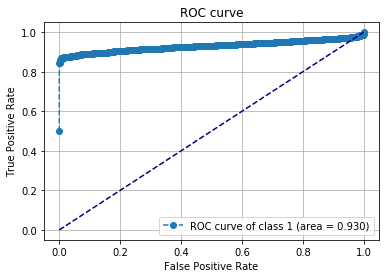

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_101 (Conv2D)          (None, 68, 30, 4)         64        
_________________________________________________________________
batch_normalization_102 (Bat (None, 68, 30, 4)         16        
_________________________________________________________________
activation_102 (Activation)  (None, 68, 30, 4)         0         
_________________________________________________________________
max_pooling2d_100 (MaxPoolin (None, 22, 10, 4)         0         
_________________________________________________________________
dropout_99 (Dropout)         (None, 22, 10, 4)         0         
_________________________________________________________________
flatten_99 (Flatten)         (None, 880)               0         
_________________________________________________________________
dense_100 (Dense)            (None, 2)                 1762      
Total para

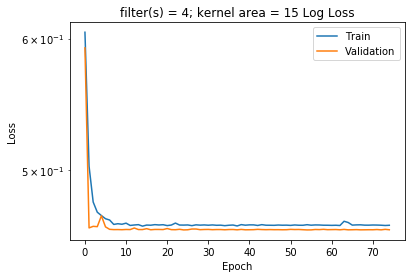

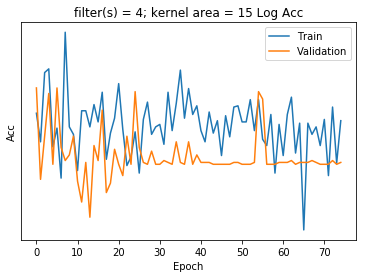

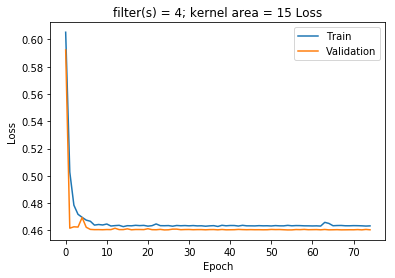

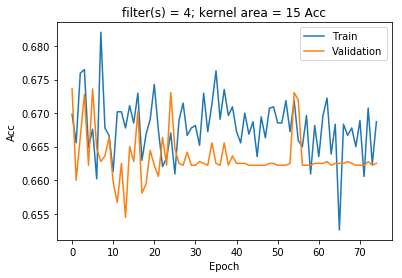

Confusion matrix, without normalization
[[   0 1174]
 [   2 2421]]
accuracy score:  0.67306088407
0.741242008548 For the label #0


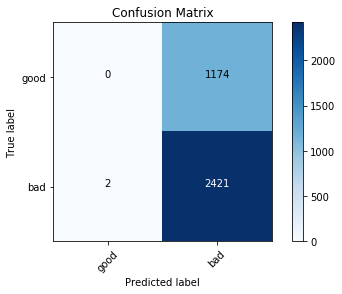

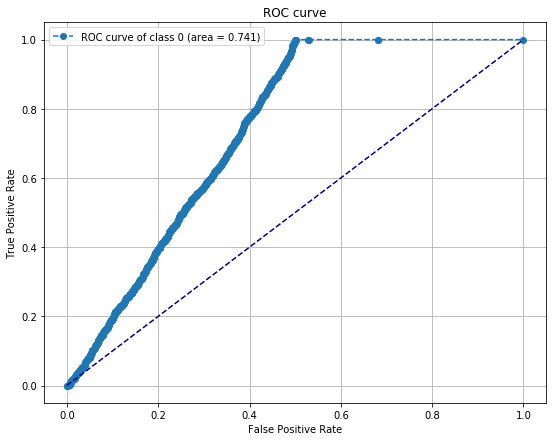

0.741241129691 For the label #1


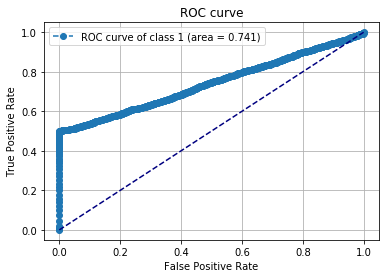

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_102 (Conv2D)          (None, 68, 29, 4)         84        
_________________________________________________________________
batch_normalization_103 (Bat (None, 68, 29, 4)         16        
_________________________________________________________________
activation_103 (Activation)  (None, 68, 29, 4)         0         
_________________________________________________________________
max_pooling2d_101 (MaxPoolin (None, 22, 9, 4)          0         
_________________________________________________________________
dropout_100 (Dropout)        (None, 22, 9, 4)          0         
_________________________________________________________________
flatten_100 (Flatten)        (None, 792)               0         
_________________________________________________________________
dense_101 (Dense)            (None, 2)                 1586      
Total para

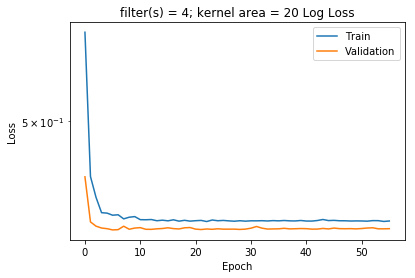

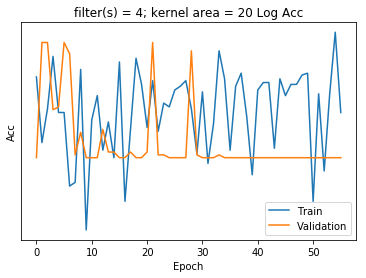

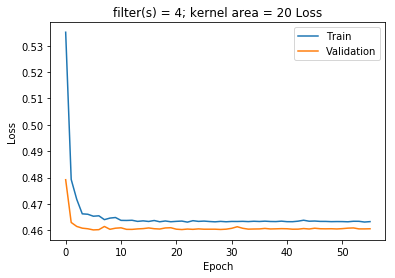

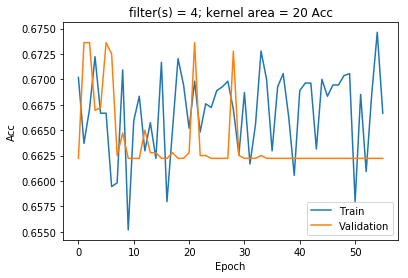

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.758016235663 For the label #0


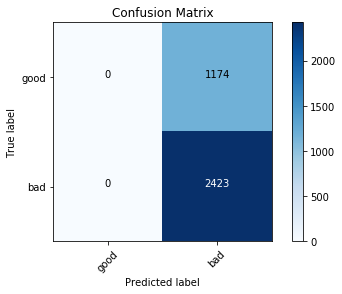

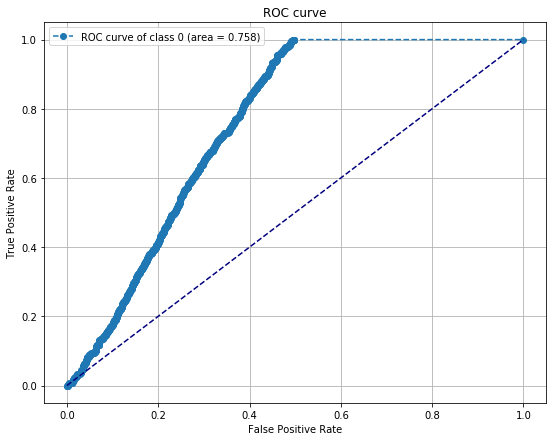

0.758016762978 For the label #1


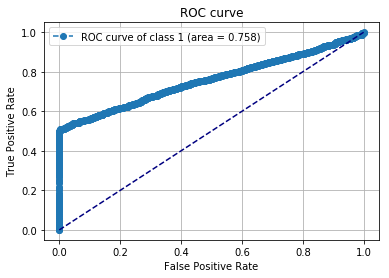

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_103 (Conv2D)          (None, 68, 28, 4)         104       
_________________________________________________________________
batch_normalization_104 (Bat (None, 68, 28, 4)         16        
_________________________________________________________________
activation_104 (Activation)  (None, 68, 28, 4)         0         
_________________________________________________________________
max_pooling2d_102 (MaxPoolin (None, 22, 9, 4)          0         
_________________________________________________________________
dropout_101 (Dropout)        (None, 22, 9, 4)          0         
_________________________________________________________________
flatten_101 (Flatten)        (None, 792)               0         
_________________________________________________________________
dense_102 (Dense)            (None, 2)                 1586      
Total para

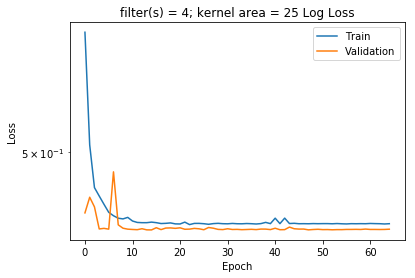

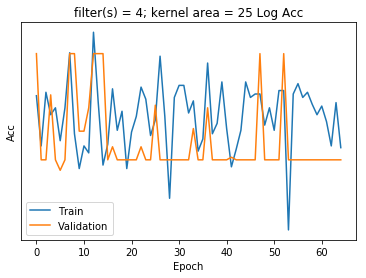

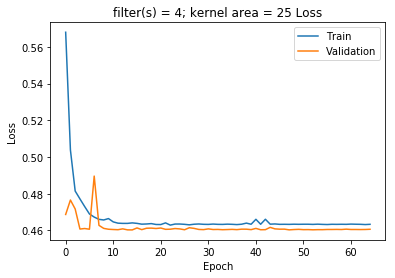

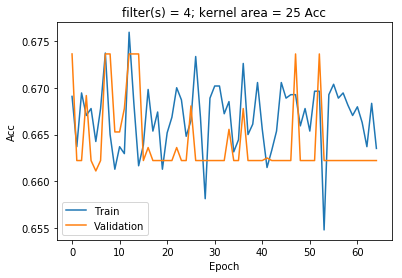

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.746745414649 For the label #0


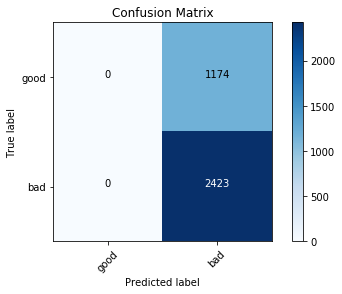

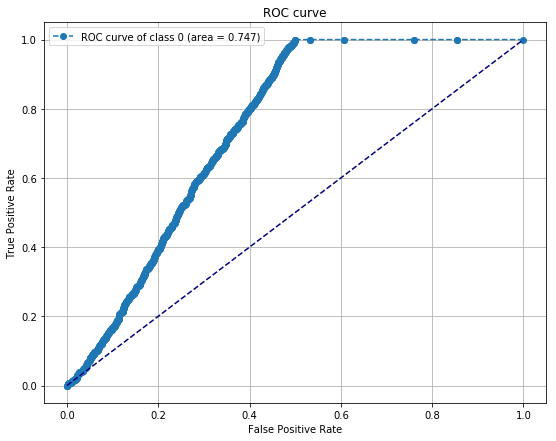

0.746747523907 For the label #1


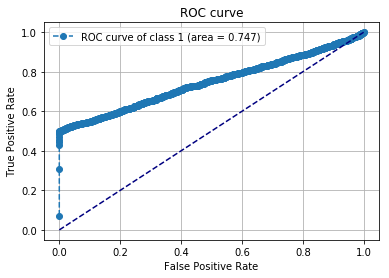

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_104 (Conv2D)          (None, 72, 32, 5)         10        
_________________________________________________________________
batch_normalization_105 (Bat (None, 72, 32, 5)         20        
_________________________________________________________________
activation_105 (Activation)  (None, 72, 32, 5)         0         
_________________________________________________________________
max_pooling2d_103 (MaxPoolin (None, 24, 10, 5)         0         
_________________________________________________________________
dropout_102 (Dropout)        (None, 24, 10, 5)         0         
_________________________________________________________________
flatten_102 (Flatten)        (None, 1200)              0         
_________________________________________________________________
dense_103 (Dense)            (None, 2)                 2402      
Total para

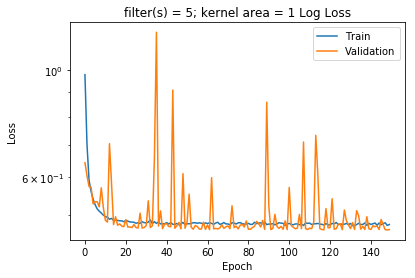

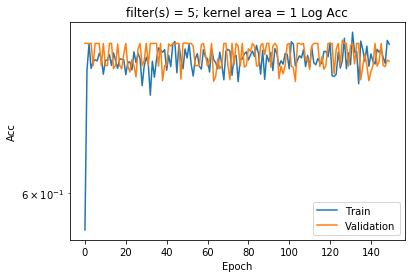

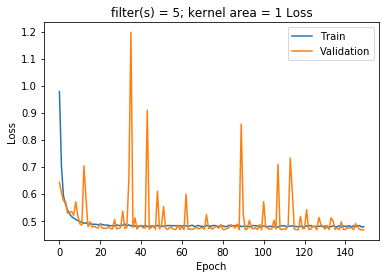

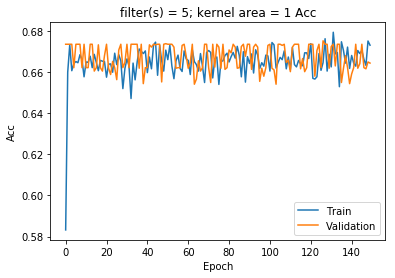

Confusion matrix, without normalization
[[ 372  802]
 [ 403 2020]]
accuracy score:  0.664998609953
0.74831769084 For the label #0


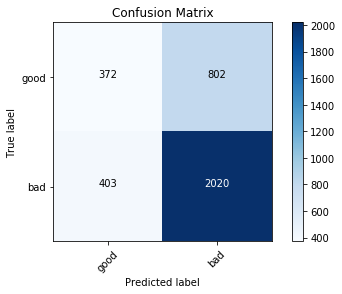

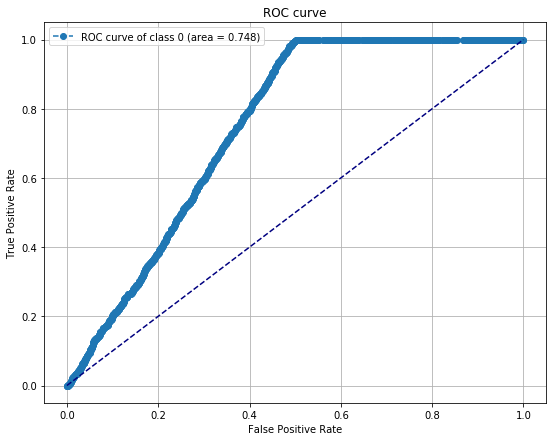

0.748318745469 For the label #1


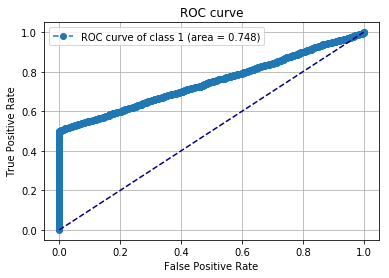

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_105 (Conv2D)          (None, 72, 31, 5)         15        
_________________________________________________________________
batch_normalization_106 (Bat (None, 72, 31, 5)         20        
_________________________________________________________________
activation_106 (Activation)  (None, 72, 31, 5)         0         
_________________________________________________________________
max_pooling2d_104 (MaxPoolin (None, 24, 10, 5)         0         
_________________________________________________________________
dropout_103 (Dropout)        (None, 24, 10, 5)         0         
_________________________________________________________________
flatten_103 (Flatten)        (None, 1200)              0         
_________________________________________________________________
dense_104 (Dense)            (None, 2)                 2402      
Total para

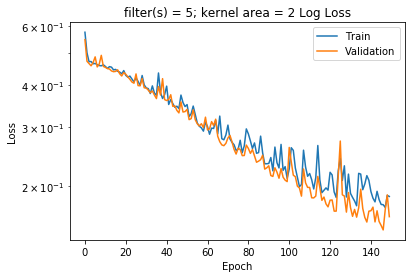

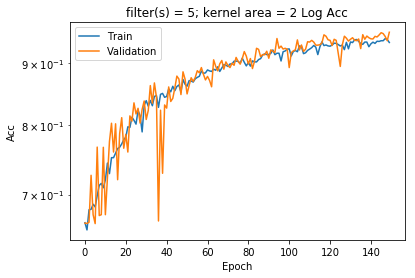

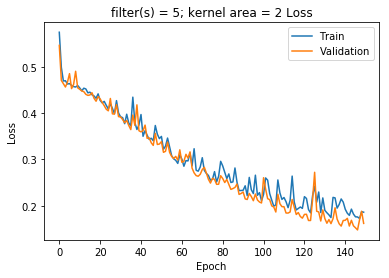

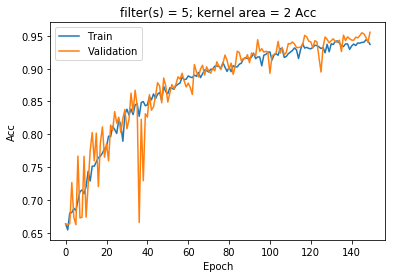

Confusion matrix, without normalization
[[1174    0]
 [ 169 2254]]
accuracy score:  0.953016402558
0.986318121129 For the label #0


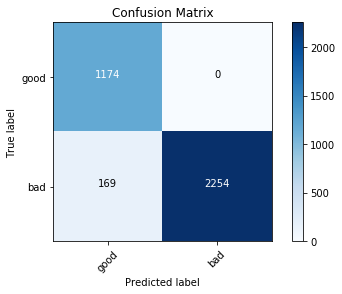

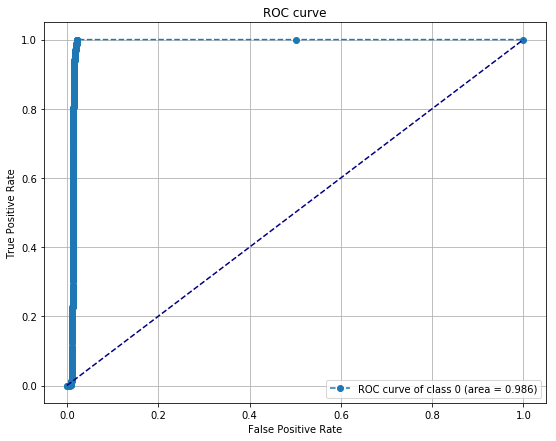

0.986318121129 For the label #1


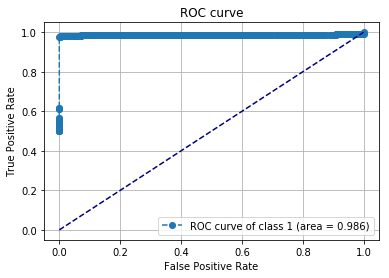

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_106 (Conv2D)          (None, 72, 30, 5)         20        
_________________________________________________________________
batch_normalization_107 (Bat (None, 72, 30, 5)         20        
_________________________________________________________________
activation_107 (Activation)  (None, 72, 30, 5)         0         
_________________________________________________________________
max_pooling2d_105 (MaxPoolin (None, 24, 10, 5)         0         
_________________________________________________________________
dropout_104 (Dropout)        (None, 24, 10, 5)         0         
_________________________________________________________________
flatten_104 (Flatten)        (None, 1200)              0         
_________________________________________________________________
dense_105 (Dense)            (None, 2)                 2402      
Total para

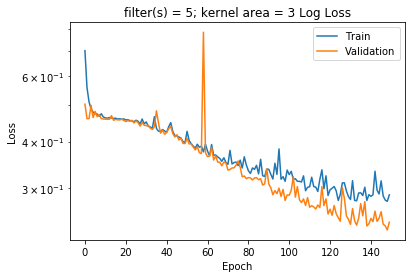

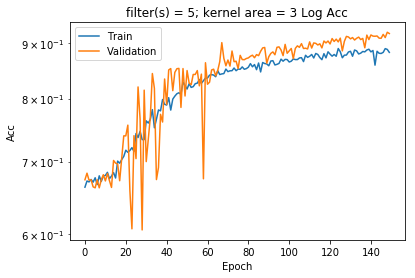

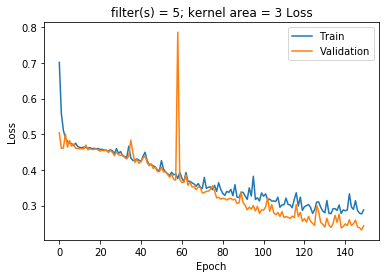

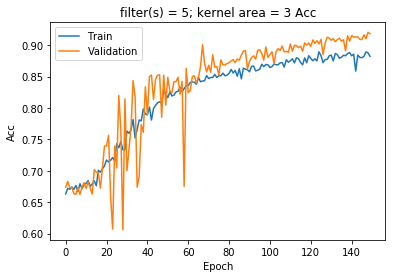

Confusion matrix, without normalization
[[1174    0]
 [ 286 2137]]
accuracy score:  0.920489296636
0.971642078575 For the label #0


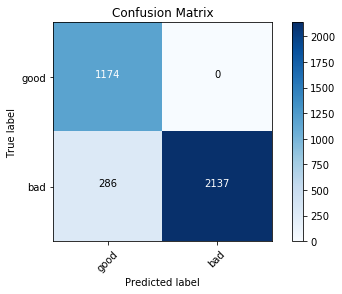

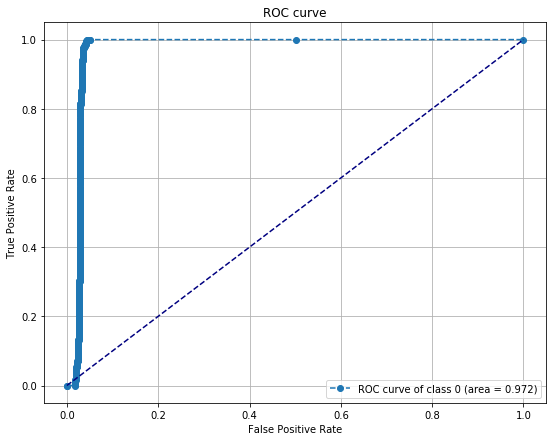

0.971642078575 For the label #1


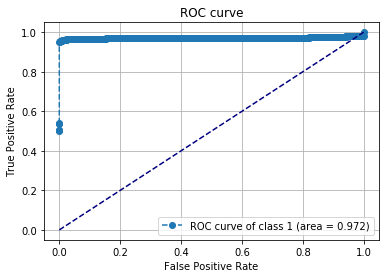

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_107 (Conv2D)          (None, 72, 29, 5)         25        
_________________________________________________________________
batch_normalization_108 (Bat (None, 72, 29, 5)         20        
_________________________________________________________________
activation_108 (Activation)  (None, 72, 29, 5)         0         
_________________________________________________________________
max_pooling2d_106 (MaxPoolin (None, 24, 9, 5)          0         
_________________________________________________________________
dropout_105 (Dropout)        (None, 24, 9, 5)          0         
_________________________________________________________________
flatten_105 (Flatten)        (None, 1080)              0         
_________________________________________________________________
dense_106 (Dense)            (None, 2)                 2162      
Total para

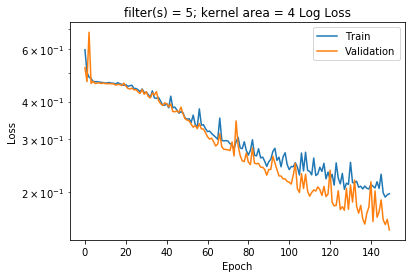

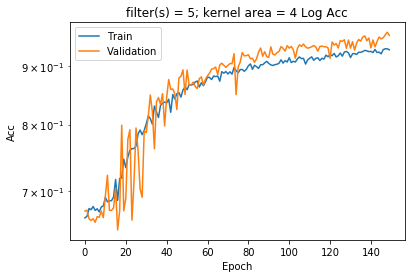

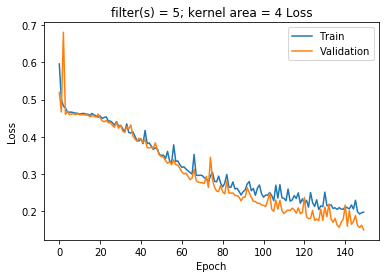

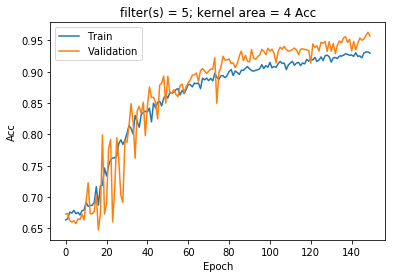

Confusion matrix, without normalization
[[1174    0]
 [ 155 2268]]
accuracy score:  0.95690853489
0.982103471769 For the label #0


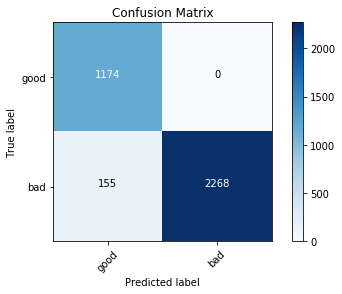

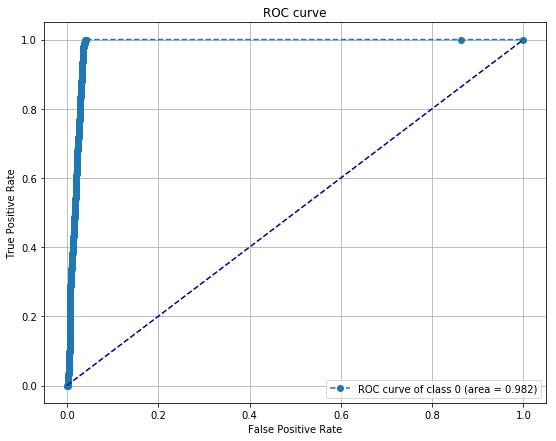

0.982103471769 For the label #1


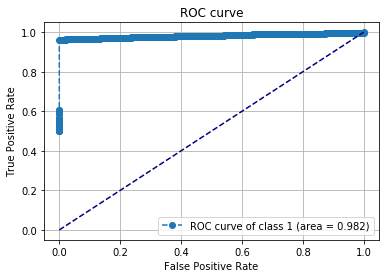

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_108 (Conv2D)          (None, 72, 28, 5)         30        
_________________________________________________________________
batch_normalization_109 (Bat (None, 72, 28, 5)         20        
_________________________________________________________________
activation_109 (Activation)  (None, 72, 28, 5)         0         
_________________________________________________________________
max_pooling2d_107 (MaxPoolin (None, 24, 9, 5)          0         
_________________________________________________________________
dropout_106 (Dropout)        (None, 24, 9, 5)          0         
_________________________________________________________________
flatten_106 (Flatten)        (None, 1080)              0         
_________________________________________________________________
dense_107 (Dense)            (None, 2)                 2162      
Total para

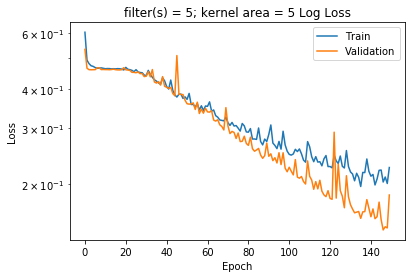

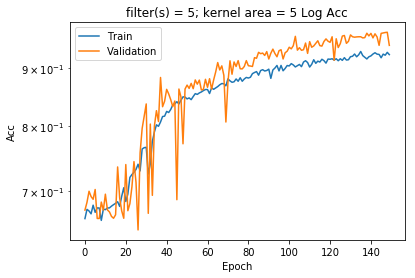

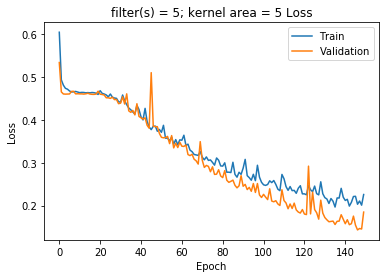

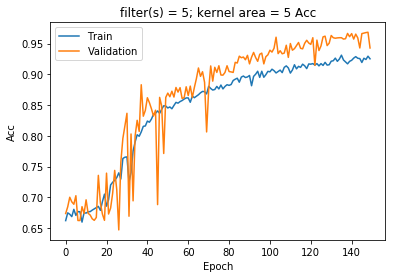

Confusion matrix, without normalization
[[1174    0]
 [ 119 2304]]
accuracy score:  0.966916875174
0.99243110284 For the label #0


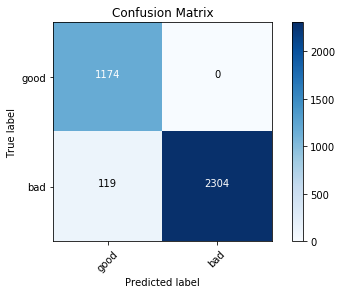

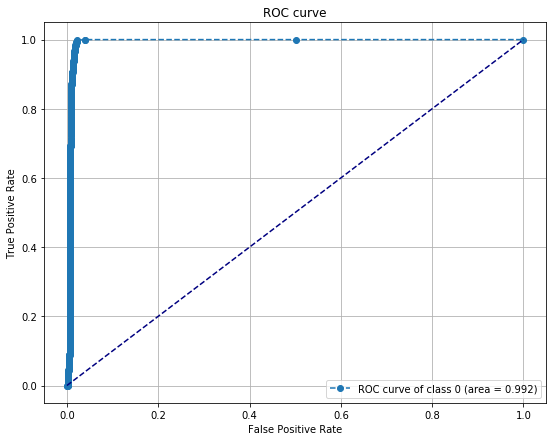

0.99243110284 For the label #1


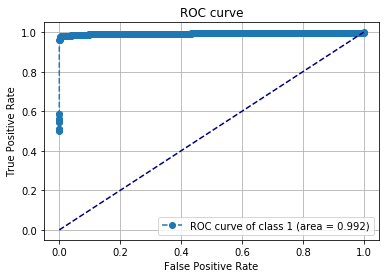

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_109 (Conv2D)          (None, 71, 32, 5)         15        
_________________________________________________________________
batch_normalization_110 (Bat (None, 71, 32, 5)         20        
_________________________________________________________________
activation_110 (Activation)  (None, 71, 32, 5)         0         
_________________________________________________________________
max_pooling2d_108 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_107 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_107 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_108 (Dense)            (None, 2)                 2302      
Total para

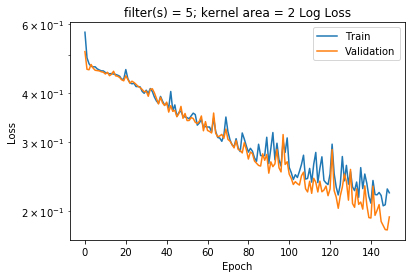

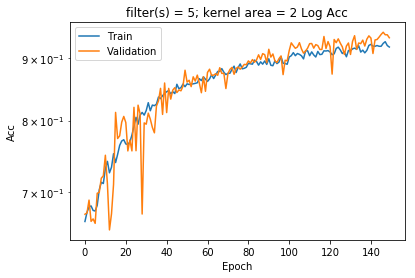

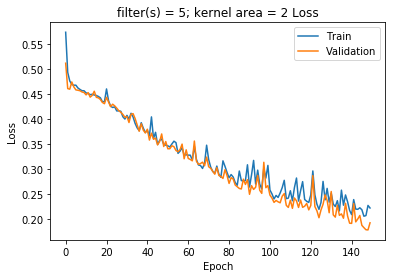

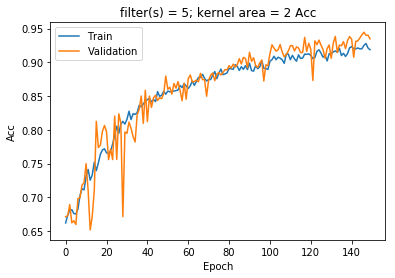

Confusion matrix, without normalization
[[1174    0]
 [ 215 2208]]
accuracy score:  0.940227967751
0.971984129942 For the label #0


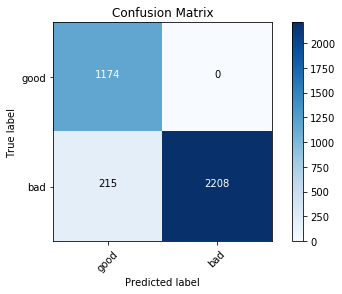

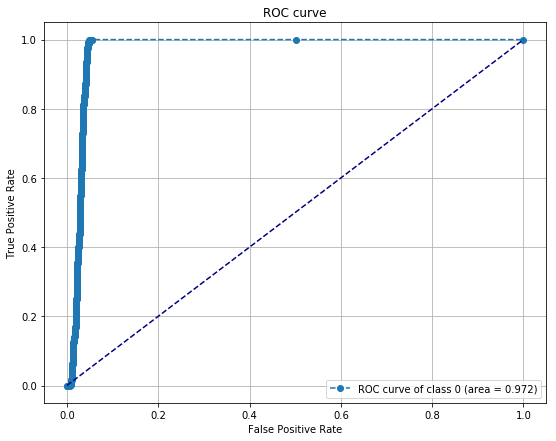

0.971984129942 For the label #1


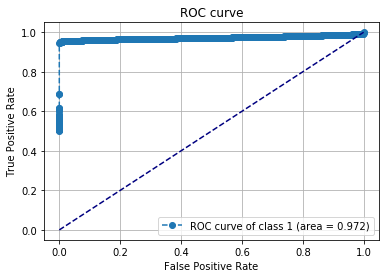

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_110 (Conv2D)          (None, 71, 31, 5)         25        
_________________________________________________________________
batch_normalization_111 (Bat (None, 71, 31, 5)         20        
_________________________________________________________________
activation_111 (Activation)  (None, 71, 31, 5)         0         
_________________________________________________________________
max_pooling2d_109 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_108 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_108 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_109 (Dense)            (None, 2)                 2302      
Total para

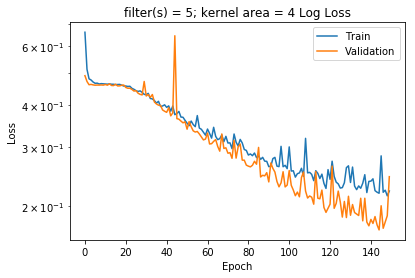

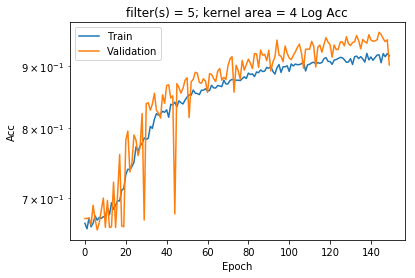

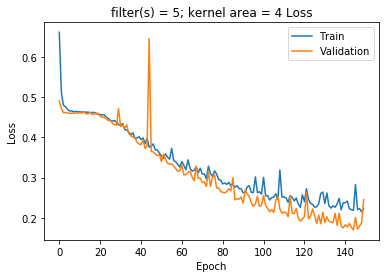

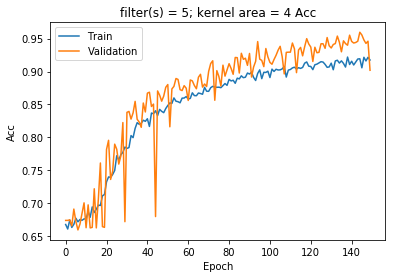

Confusion matrix, without normalization
[[1174    0]
 [ 145 2278]]
accuracy score:  0.959688629413
0.982164288712 For the label #0


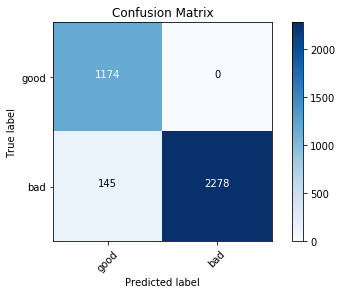

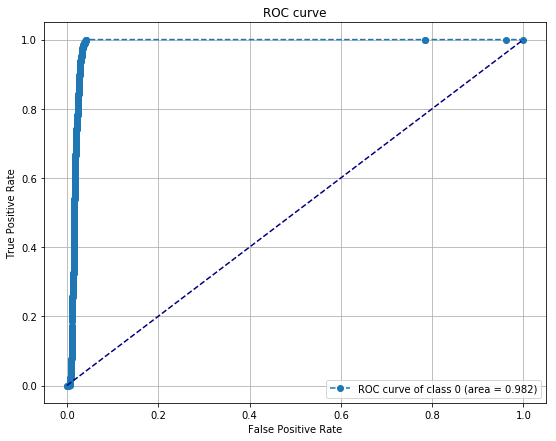

0.982164288712 For the label #1


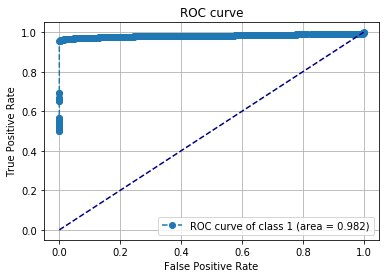

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_111 (Conv2D)          (None, 71, 30, 5)         35        
_________________________________________________________________
batch_normalization_112 (Bat (None, 71, 30, 5)         20        
_________________________________________________________________
activation_112 (Activation)  (None, 71, 30, 5)         0         
_________________________________________________________________
max_pooling2d_110 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_109 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_109 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_110 (Dense)            (None, 2)                 2302      
Total para

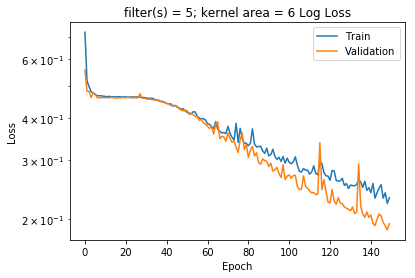

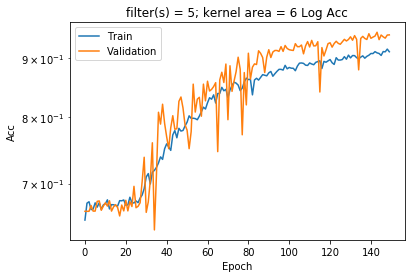

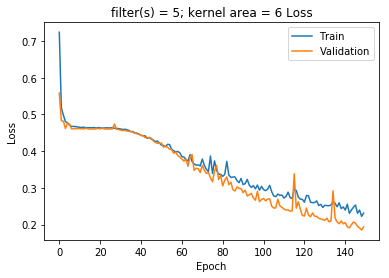

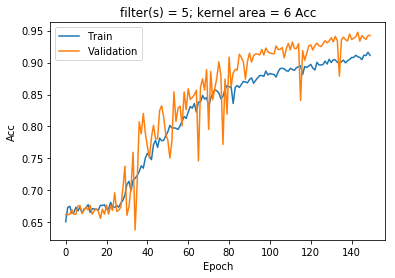

Confusion matrix, without normalization
[[1174    0]
 [ 208 2215]]
accuracy score:  0.942174033917
0.971360141067 For the label #0


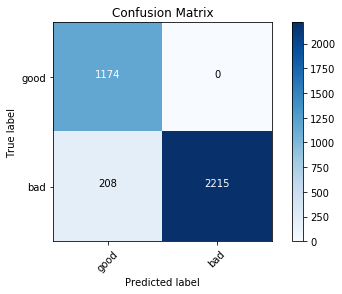

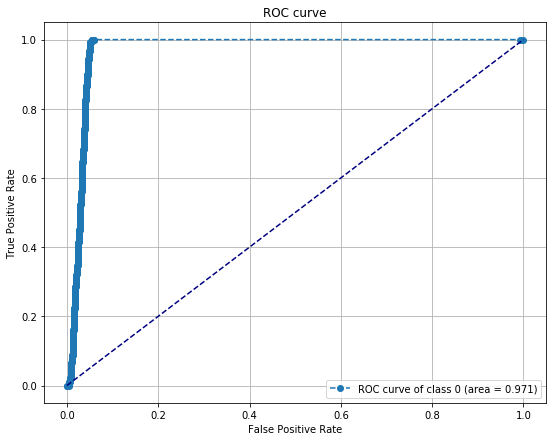

0.971360141067 For the label #1


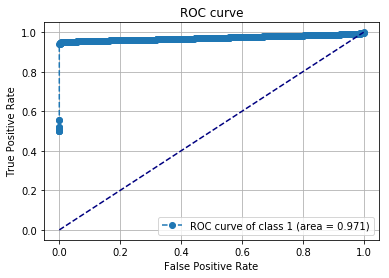

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_112 (Conv2D)          (None, 71, 29, 5)         45        
_________________________________________________________________
batch_normalization_113 (Bat (None, 71, 29, 5)         20        
_________________________________________________________________
activation_113 (Activation)  (None, 71, 29, 5)         0         
_________________________________________________________________
max_pooling2d_111 (MaxPoolin (None, 23, 9, 5)          0         
_________________________________________________________________
dropout_110 (Dropout)        (None, 23, 9, 5)          0         
_________________________________________________________________
flatten_110 (Flatten)        (None, 1035)              0         
_________________________________________________________________
dense_111 (Dense)            (None, 2)                 2072      
Total para

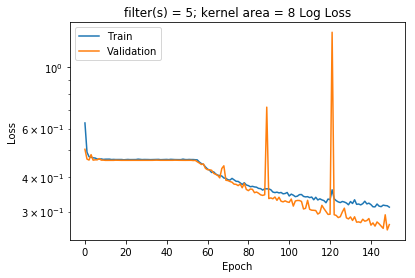

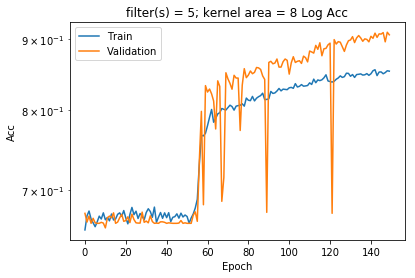

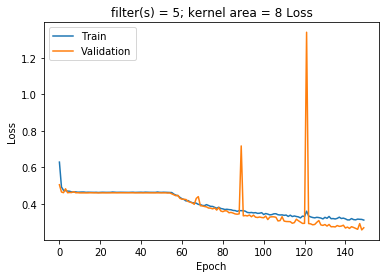

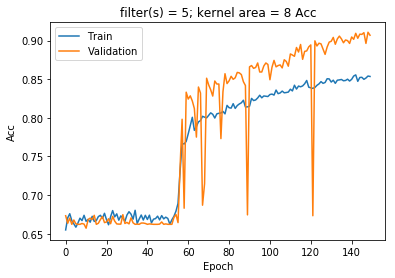

Confusion matrix, without normalization
[[1174    0]
 [ 321 2102]]
accuracy score:  0.910758965805
0.934263211514 For the label #0


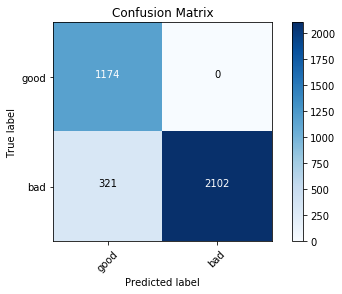

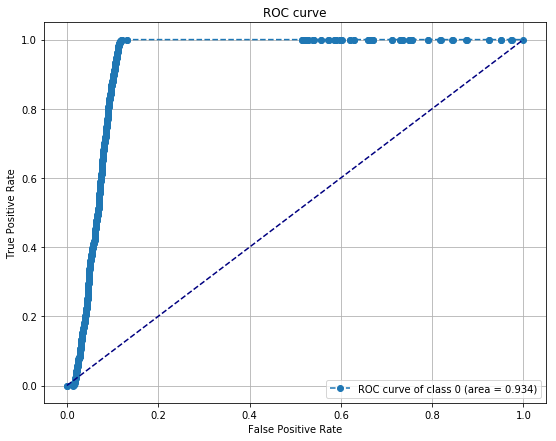

0.934263211514 For the label #1


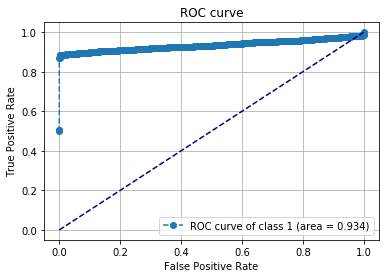

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_113 (Conv2D)          (None, 71, 28, 5)         55        
_________________________________________________________________
batch_normalization_114 (Bat (None, 71, 28, 5)         20        
_________________________________________________________________
activation_114 (Activation)  (None, 71, 28, 5)         0         
_________________________________________________________________
max_pooling2d_112 (MaxPoolin (None, 23, 9, 5)          0         
_________________________________________________________________
dropout_111 (Dropout)        (None, 23, 9, 5)          0         
_________________________________________________________________
flatten_111 (Flatten)        (None, 1035)              0         
_________________________________________________________________
dense_112 (Dense)            (None, 2)                 2072      
Total para

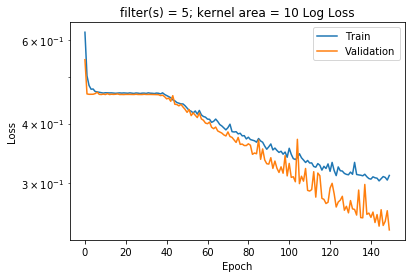

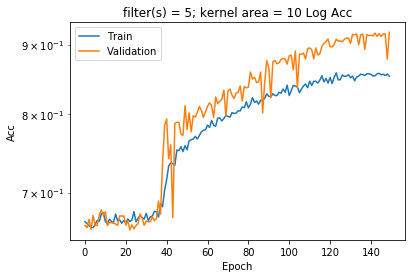

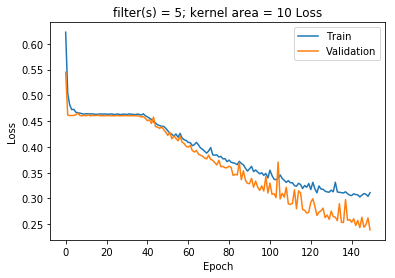

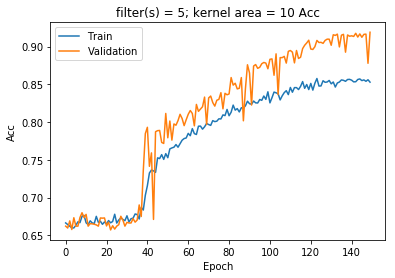

Confusion matrix, without normalization
[[1173    1]
 [ 290 2133]]
accuracy score:  0.919099249374
0.945767984414 For the label #0


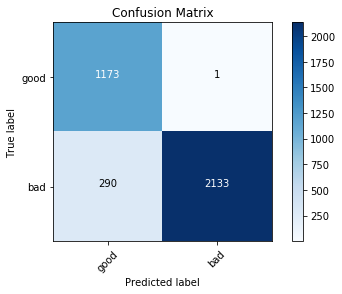

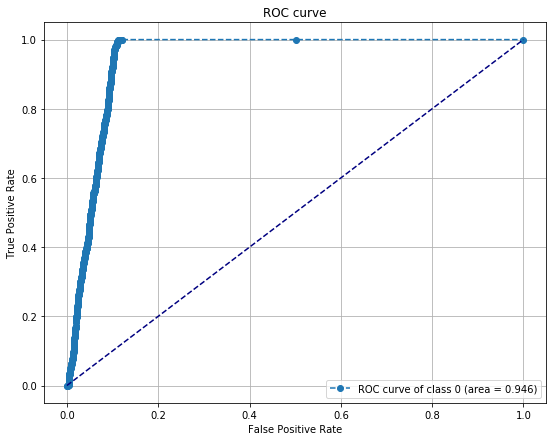

0.945767984414 For the label #1


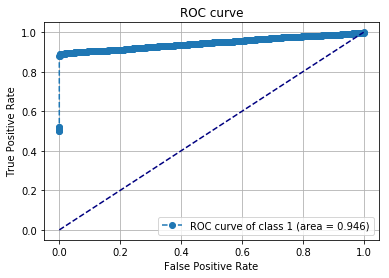

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_114 (Conv2D)          (None, 70, 32, 5)         20        
_________________________________________________________________
batch_normalization_115 (Bat (None, 70, 32, 5)         20        
_________________________________________________________________
activation_115 (Activation)  (None, 70, 32, 5)         0         
_________________________________________________________________
max_pooling2d_113 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_112 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_112 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_113 (Dense)            (None, 2)                 2302      
Total para

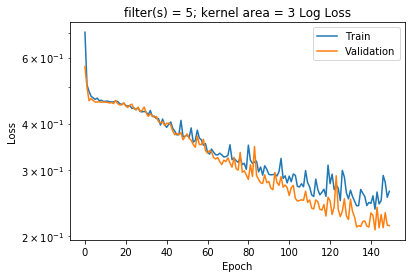

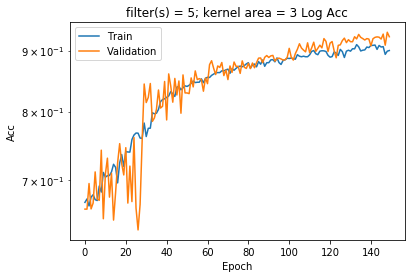

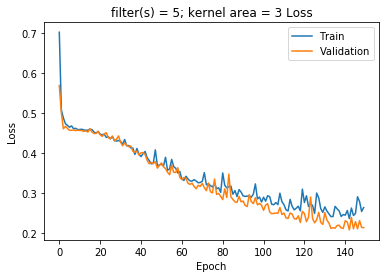

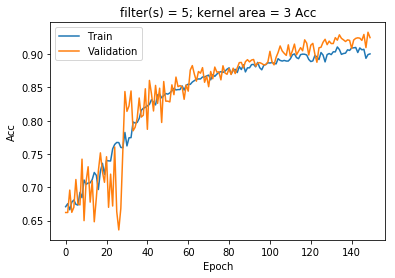

Confusion matrix, without normalization
[[1174    0]
 [ 275 2148]]
accuracy score:  0.923547400612
0.962413195238 For the label #0


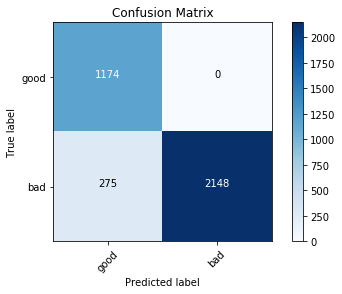

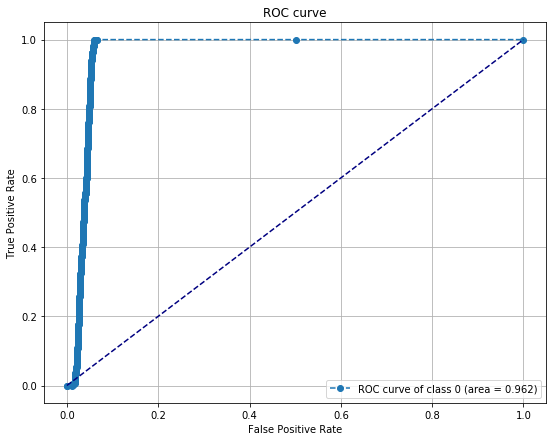

0.962413195238 For the label #1


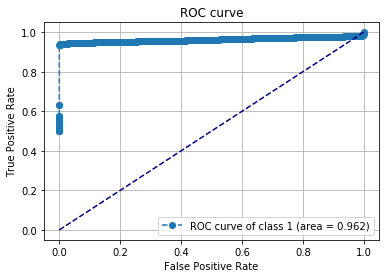

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_115 (Conv2D)          (None, 70, 31, 5)         35        
_________________________________________________________________
batch_normalization_116 (Bat (None, 70, 31, 5)         20        
_________________________________________________________________
activation_116 (Activation)  (None, 70, 31, 5)         0         
_________________________________________________________________
max_pooling2d_114 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_113 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_113 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_114 (Dense)            (None, 2)                 2302      
Total para

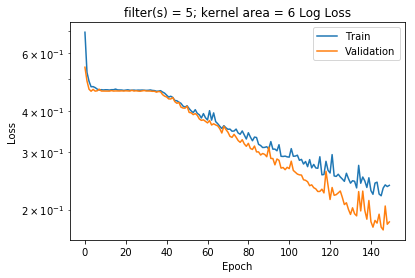

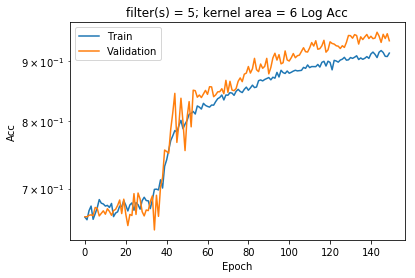

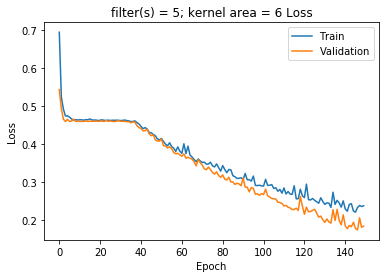

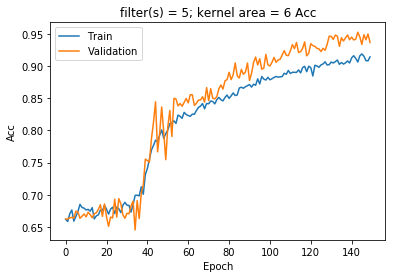

Confusion matrix, without normalization
[[1174    0]
 [ 184 2239]]
accuracy score:  0.948846260773
0.986338334853 For the label #0


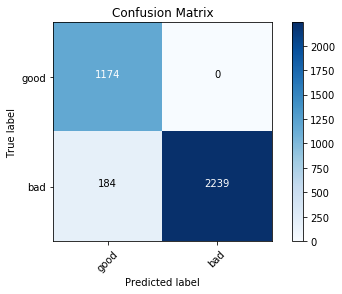

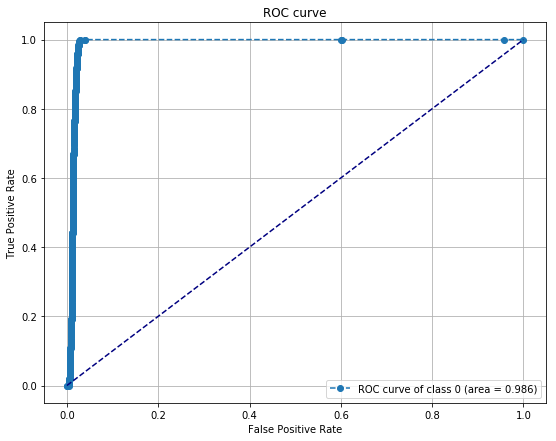

0.986338334853 For the label #1


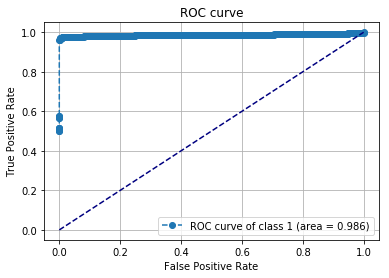

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_116 (Conv2D)          (None, 70, 30, 5)         50        
_________________________________________________________________
batch_normalization_117 (Bat (None, 70, 30, 5)         20        
_________________________________________________________________
activation_117 (Activation)  (None, 70, 30, 5)         0         
_________________________________________________________________
max_pooling2d_115 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_114 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_114 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_115 (Dense)            (None, 2)                 2302      
Total para

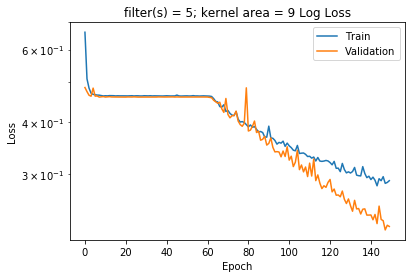

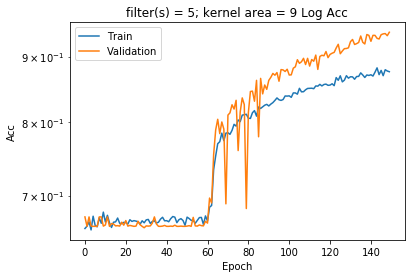

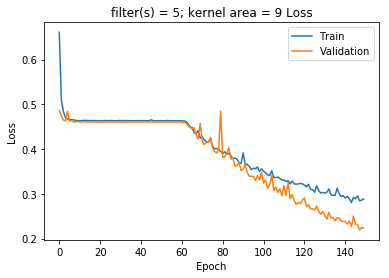

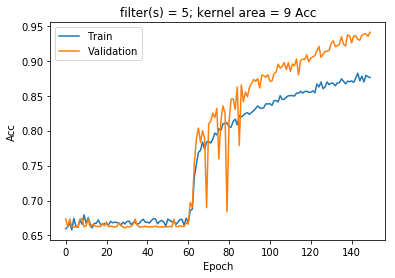

Confusion matrix, without normalization
[[1172    2]
 [ 219 2204]]
accuracy score:  0.938559911037
0.963171825092 For the label #0


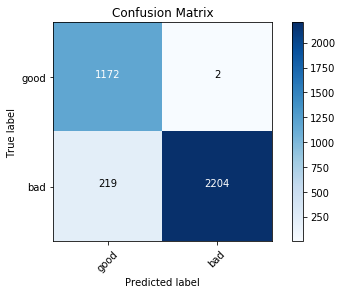

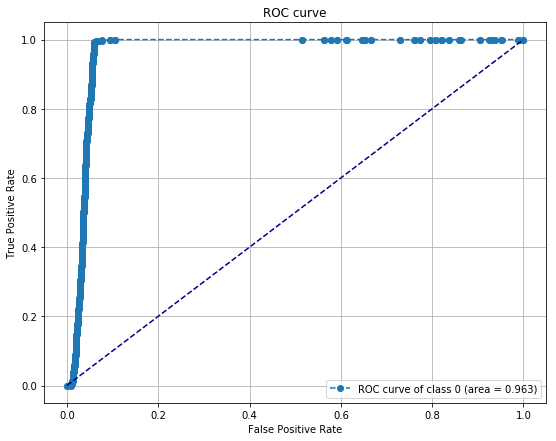

0.963171825092 For the label #1


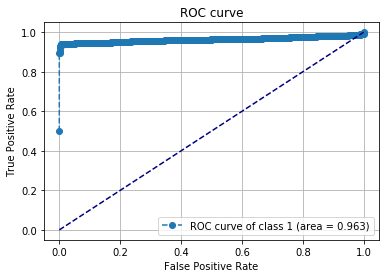

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_117 (Conv2D)          (None, 70, 29, 5)         65        
_________________________________________________________________
batch_normalization_118 (Bat (None, 70, 29, 5)         20        
_________________________________________________________________
activation_118 (Activation)  (None, 70, 29, 5)         0         
_________________________________________________________________
max_pooling2d_116 (MaxPoolin (None, 23, 9, 5)          0         
_________________________________________________________________
dropout_115 (Dropout)        (None, 23, 9, 5)          0         
_________________________________________________________________
flatten_115 (Flatten)        (None, 1035)              0         
_________________________________________________________________
dense_116 (Dense)            (None, 2)                 2072      
Total para

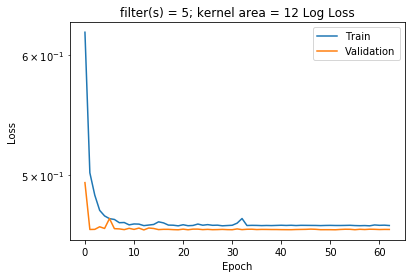

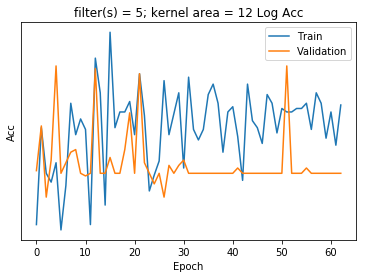

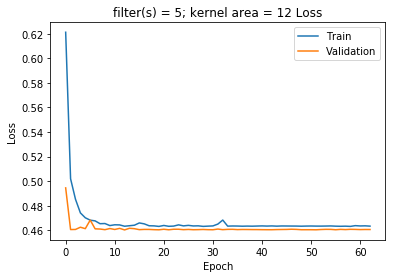

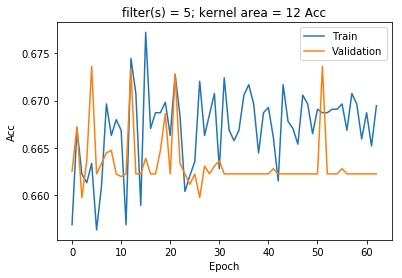

Confusion matrix, without normalization
[[   0 1174]
 [   1 2422]]
accuracy score:  0.673338893522
0.752389262189 For the label #0


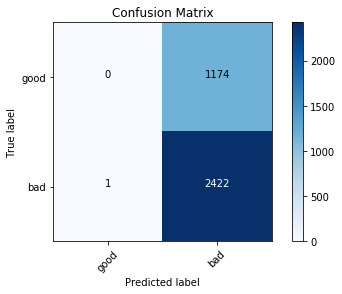

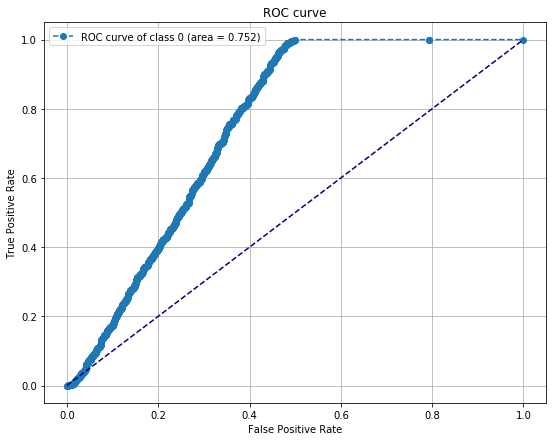

0.752392250304 For the label #1


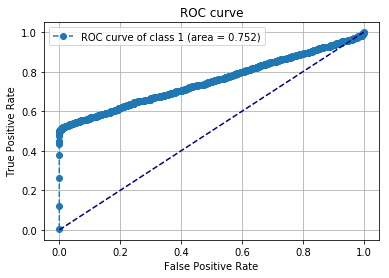

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_118 (Conv2D)          (None, 70, 28, 5)         80        
_________________________________________________________________
batch_normalization_119 (Bat (None, 70, 28, 5)         20        
_________________________________________________________________
activation_119 (Activation)  (None, 70, 28, 5)         0         
_________________________________________________________________
max_pooling2d_117 (MaxPoolin (None, 23, 9, 5)          0         
_________________________________________________________________
dropout_116 (Dropout)        (None, 23, 9, 5)          0         
_________________________________________________________________
flatten_116 (Flatten)        (None, 1035)              0         
_________________________________________________________________
dense_117 (Dense)            (None, 2)                 2072      
Total para

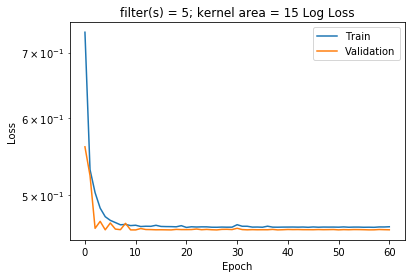

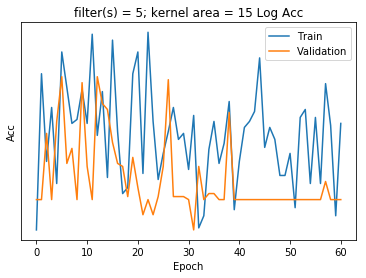

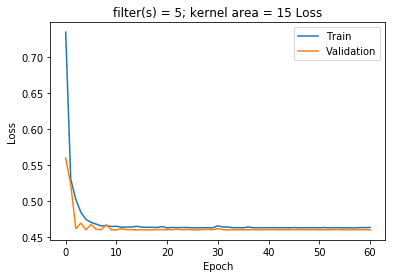

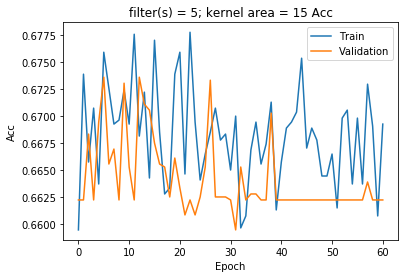

Confusion matrix, without normalization
[[  24 1150]
 [  54 2369]]
accuracy score:  0.665276619405
0.748544787636 For the label #0


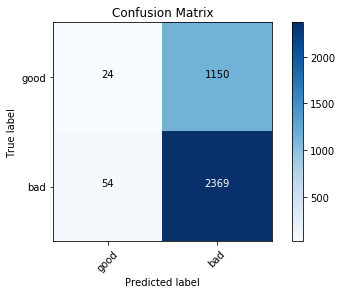

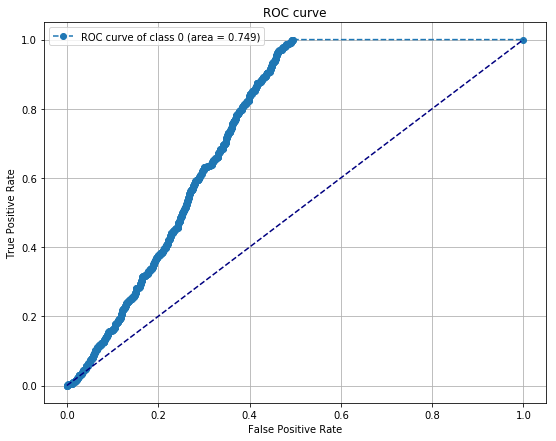

0.748544963408 For the label #1


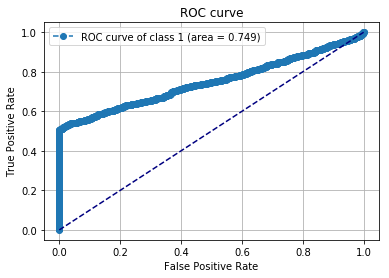

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_119 (Conv2D)          (None, 69, 32, 5)         25        
_________________________________________________________________
batch_normalization_120 (Bat (None, 69, 32, 5)         20        
_________________________________________________________________
activation_120 (Activation)  (None, 69, 32, 5)         0         
_________________________________________________________________
max_pooling2d_118 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_117 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_117 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_118 (Dense)            (None, 2)                 2302      
Total para

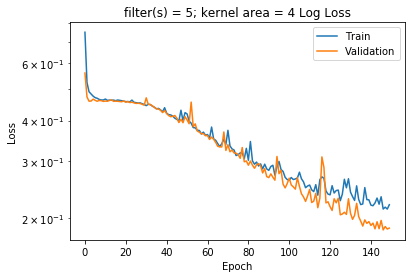

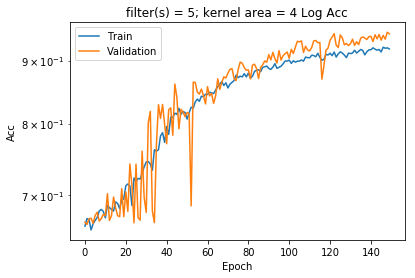

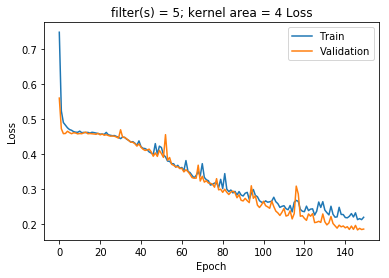

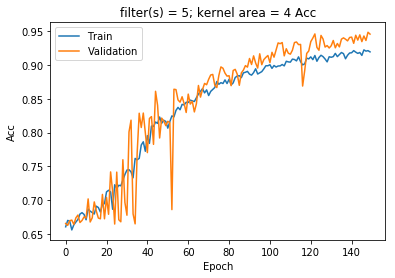

Confusion matrix, without normalization
[[1174    0]
 [ 204 2219]]
accuracy score:  0.943286071726
0.97203967374 For the label #0


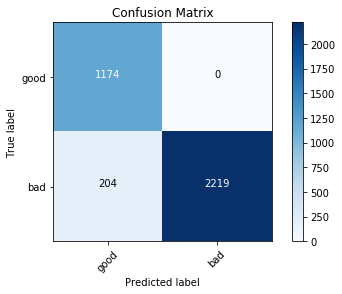

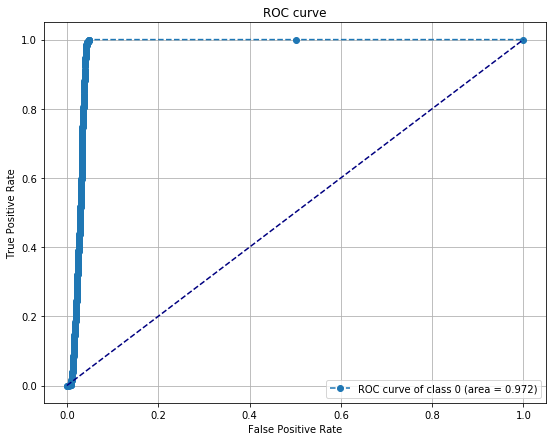

0.97203967374 For the label #1


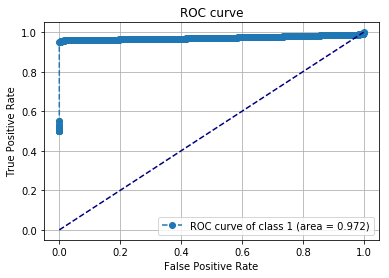

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_120 (Conv2D)          (None, 69, 31, 5)         45        
_________________________________________________________________
batch_normalization_121 (Bat (None, 69, 31, 5)         20        
_________________________________________________________________
activation_121 (Activation)  (None, 69, 31, 5)         0         
_________________________________________________________________
max_pooling2d_119 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_118 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_118 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_119 (Dense)            (None, 2)                 2302      
Total para

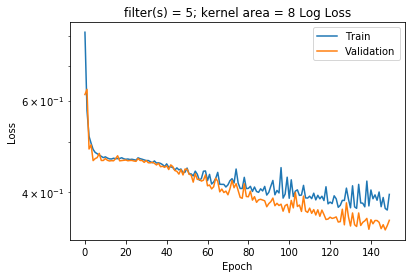

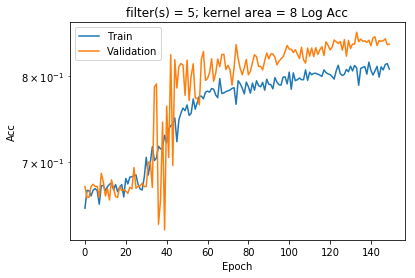

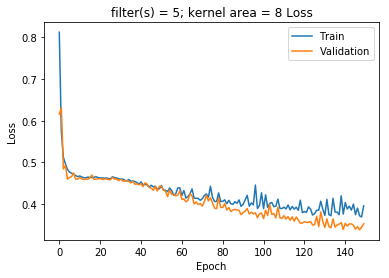

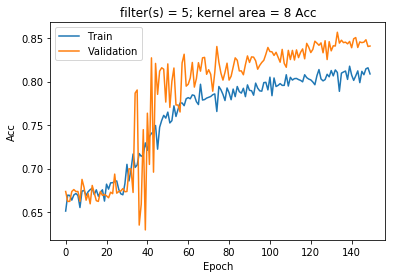

Confusion matrix, without normalization
[[1174    0]
 [ 546 1877]]
accuracy score:  0.848206839033
0.896902097376 For the label #0


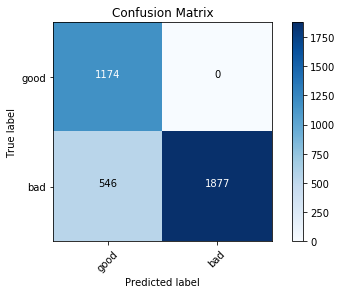

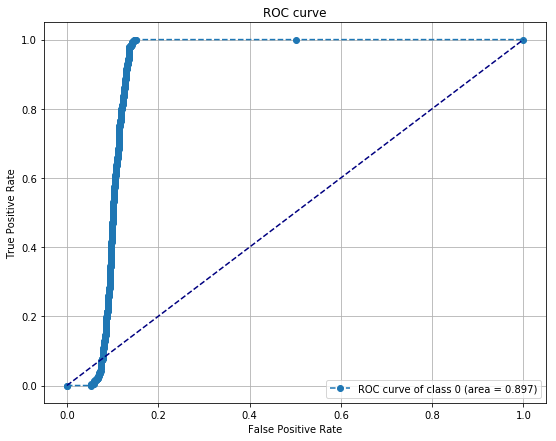

0.896902273148 For the label #1


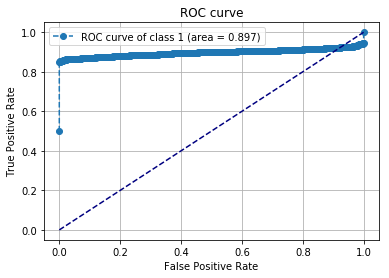

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_121 (Conv2D)          (None, 69, 30, 5)         65        
_________________________________________________________________
batch_normalization_122 (Bat (None, 69, 30, 5)         20        
_________________________________________________________________
activation_122 (Activation)  (None, 69, 30, 5)         0         
_________________________________________________________________
max_pooling2d_120 (MaxPoolin (None, 23, 10, 5)         0         
_________________________________________________________________
dropout_119 (Dropout)        (None, 23, 10, 5)         0         
_________________________________________________________________
flatten_119 (Flatten)        (None, 1150)              0         
_________________________________________________________________
dense_120 (Dense)            (None, 2)                 2302      
Total para

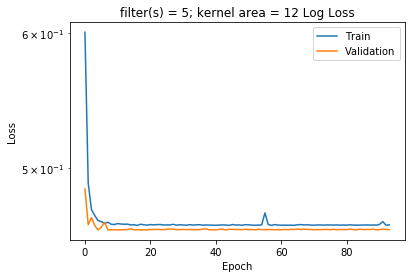

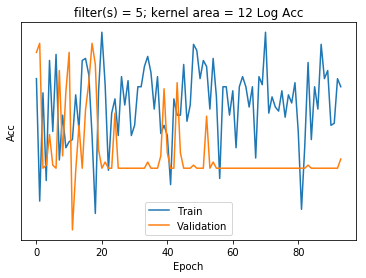

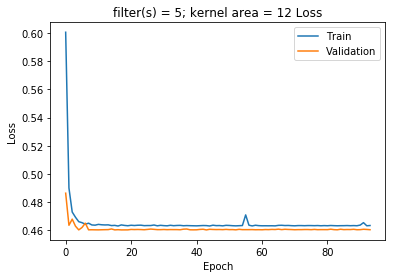

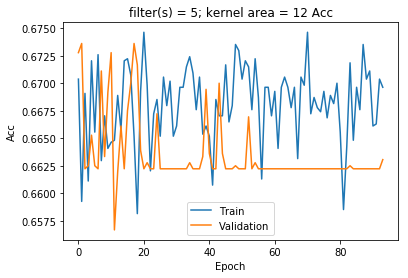

Confusion matrix, without normalization
[[1062  112]
 [1075 1348]]
accuracy score:  0.670002780095
0.749674646928 For the label #0


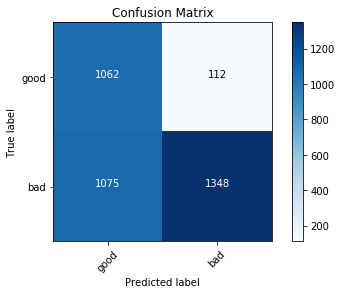

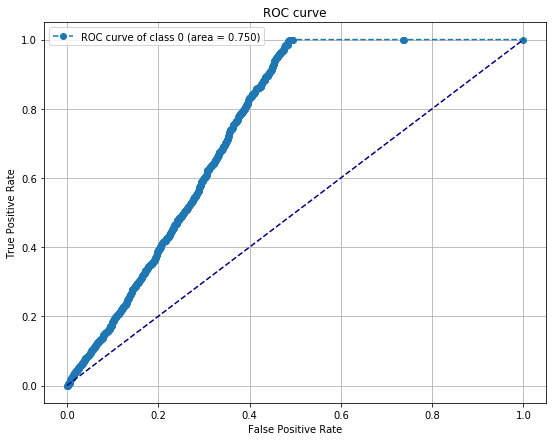

0.749673943842 For the label #1


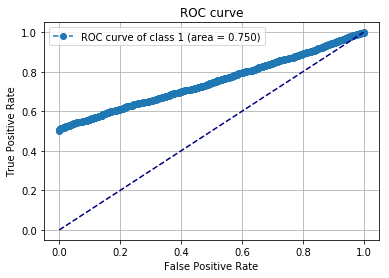

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_122 (Conv2D)          (None, 69, 29, 5)         85        
_________________________________________________________________
batch_normalization_123 (Bat (None, 69, 29, 5)         20        
_________________________________________________________________
activation_123 (Activation)  (None, 69, 29, 5)         0         
_________________________________________________________________
max_pooling2d_121 (MaxPoolin (None, 23, 9, 5)          0         
_________________________________________________________________
dropout_120 (Dropout)        (None, 23, 9, 5)          0         
_________________________________________________________________
flatten_120 (Flatten)        (None, 1035)              0         
_________________________________________________________________
dense_121 (Dense)            (None, 2)                 2072      
Total para

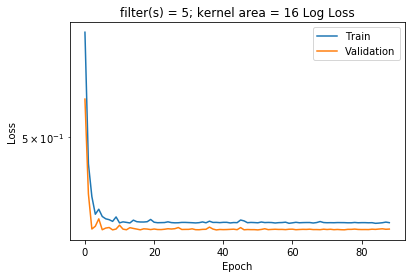

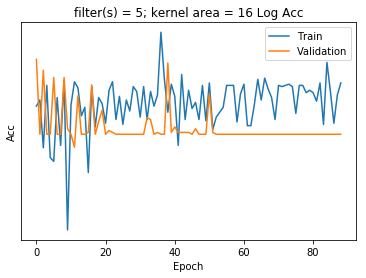

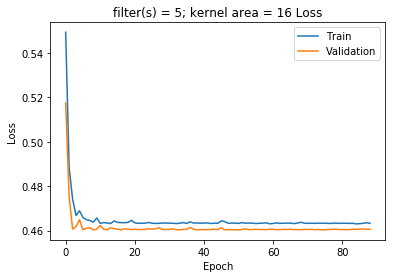

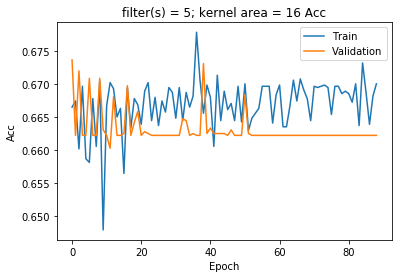

Confusion matrix, without normalization
[[   1 1173]
 [   3 2420]]
accuracy score:  0.67306088407
0.746154822362 For the label #0


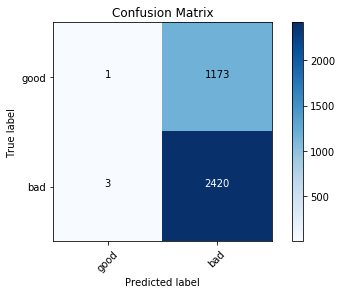

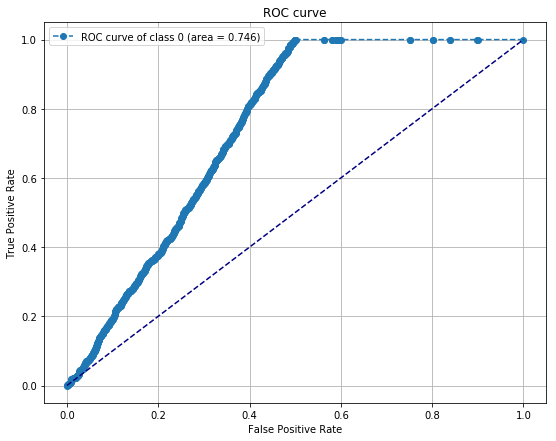

0.746154998133 For the label #1


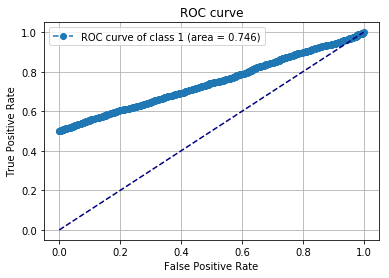

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_123 (Conv2D)          (None, 69, 28, 5)         105       
_________________________________________________________________
batch_normalization_124 (Bat (None, 69, 28, 5)         20        
_________________________________________________________________
activation_124 (Activation)  (None, 69, 28, 5)         0         
_________________________________________________________________
max_pooling2d_122 (MaxPoolin (None, 23, 9, 5)          0         
_________________________________________________________________
dropout_121 (Dropout)        (None, 23, 9, 5)          0         
_________________________________________________________________
flatten_121 (Flatten)        (None, 1035)              0         
_________________________________________________________________
dense_122 (Dense)            (None, 2)                 2072      
Total para

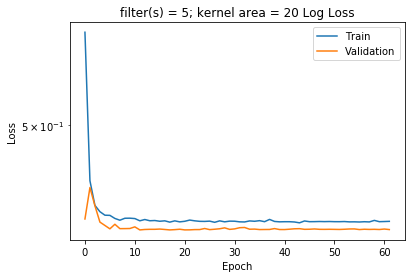

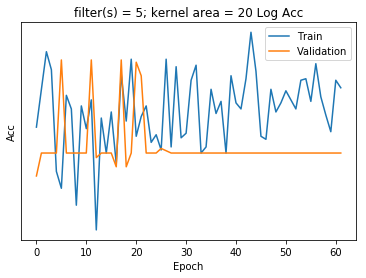

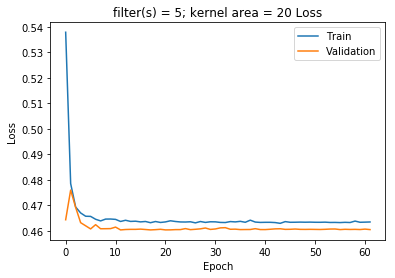

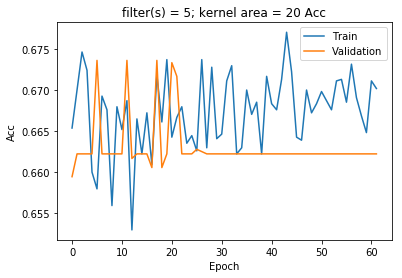

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.74296052664 For the label #0


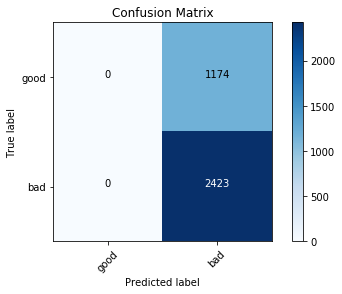

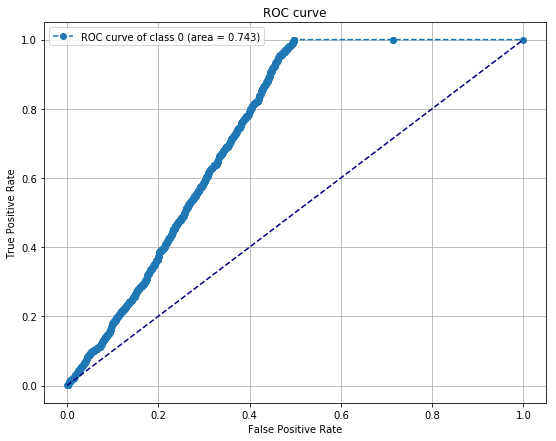

0.742962284355 For the label #1


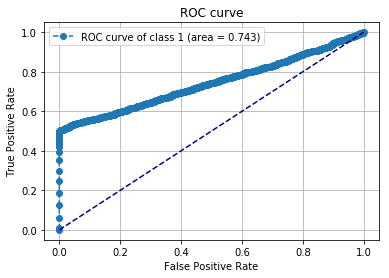

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_124 (Conv2D)          (None, 68, 32, 5)         30        
_________________________________________________________________
batch_normalization_125 (Bat (None, 68, 32, 5)         20        
_________________________________________________________________
activation_125 (Activation)  (None, 68, 32, 5)         0         
_________________________________________________________________
max_pooling2d_123 (MaxPoolin (None, 22, 10, 5)         0         
_________________________________________________________________
dropout_122 (Dropout)        (None, 22, 10, 5)         0         
_________________________________________________________________
flatten_122 (Flatten)        (None, 1100)              0         
_________________________________________________________________
dense_123 (Dense)            (None, 2)                 2202      
Total para

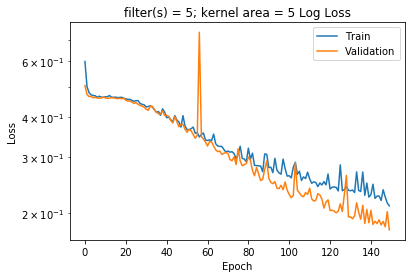

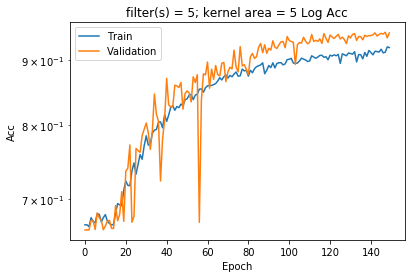

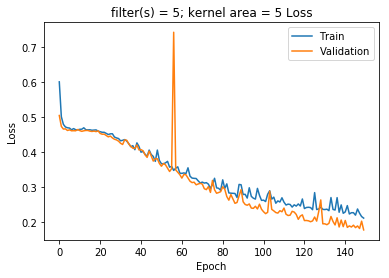

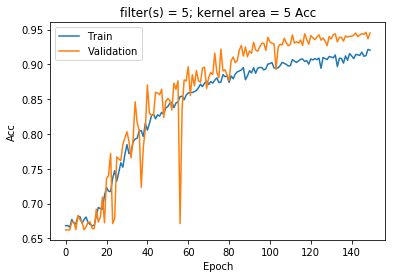

Confusion matrix, without normalization
[[1174    0]
 [ 198 2225]]
accuracy score:  0.94495412844
0.970938289434 For the label #0


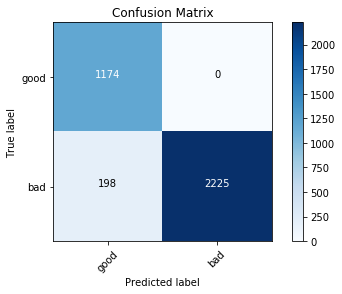

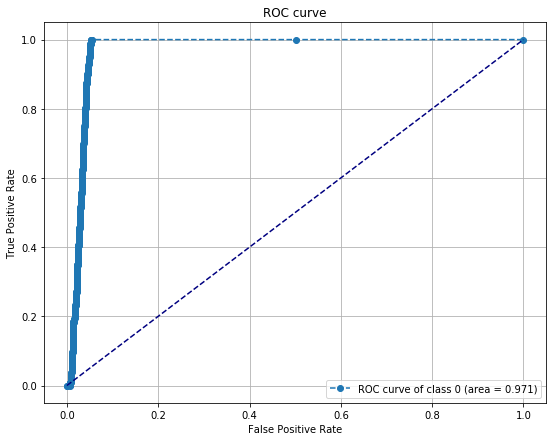

0.970938289434 For the label #1


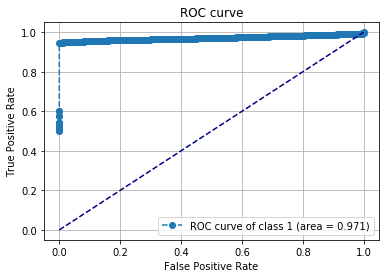

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_125 (Conv2D)          (None, 68, 31, 5)         55        
_________________________________________________________________
batch_normalization_126 (Bat (None, 68, 31, 5)         20        
_________________________________________________________________
activation_126 (Activation)  (None, 68, 31, 5)         0         
_________________________________________________________________
max_pooling2d_124 (MaxPoolin (None, 22, 10, 5)         0         
_________________________________________________________________
dropout_123 (Dropout)        (None, 22, 10, 5)         0         
_________________________________________________________________
flatten_123 (Flatten)        (None, 1100)              0         
_________________________________________________________________
dense_124 (Dense)            (None, 2)                 2202      
Total para

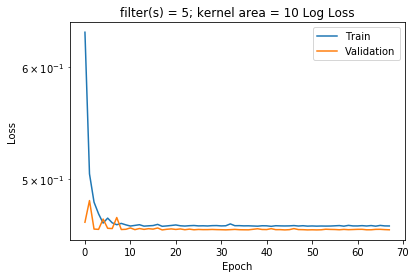

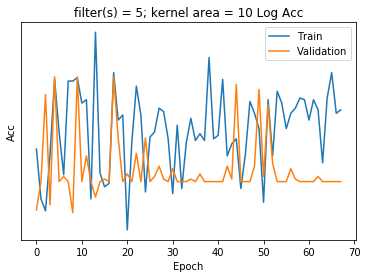

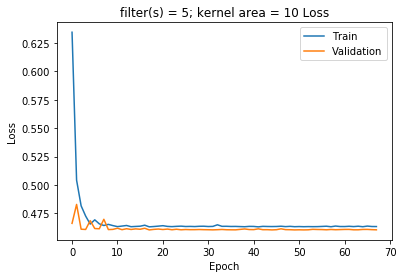

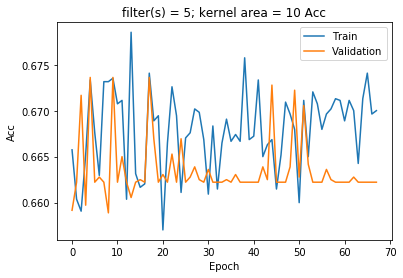

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.744250689552 For the label #0


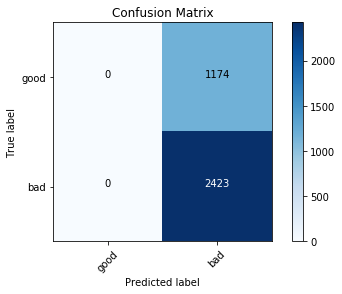

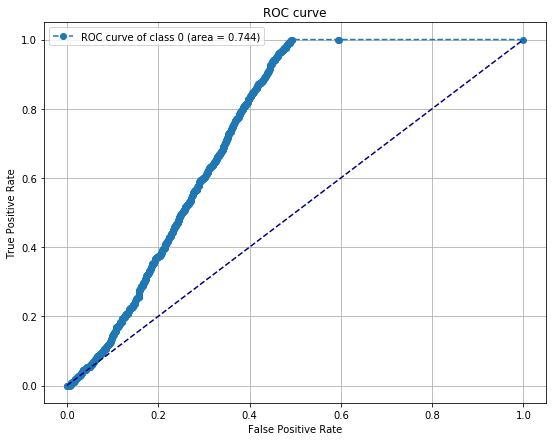

0.744249107608 For the label #1


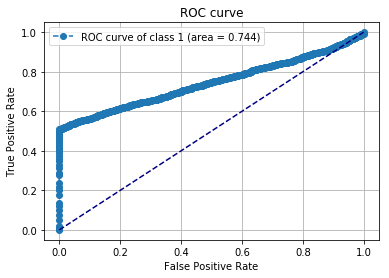

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_126 (Conv2D)          (None, 68, 30, 5)         80        
_________________________________________________________________
batch_normalization_127 (Bat (None, 68, 30, 5)         20        
_________________________________________________________________
activation_127 (Activation)  (None, 68, 30, 5)         0         
_________________________________________________________________
max_pooling2d_125 (MaxPoolin (None, 22, 10, 5)         0         
_________________________________________________________________
dropout_124 (Dropout)        (None, 22, 10, 5)         0         
_________________________________________________________________
flatten_124 (Flatten)        (None, 1100)              0         
_________________________________________________________________
dense_125 (Dense)            (None, 2)                 2202      
Total para

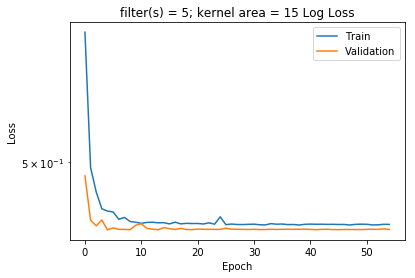

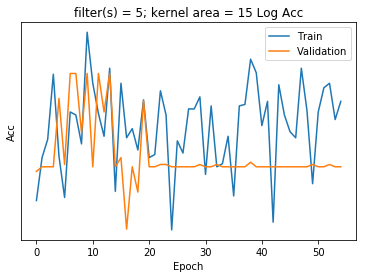

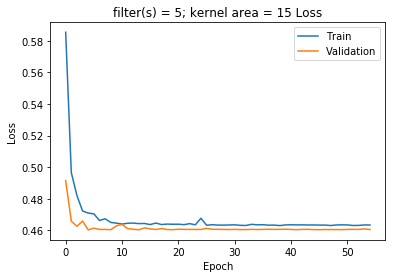

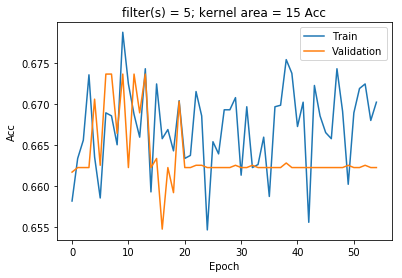

Confusion matrix, without normalization
[[  11 1163]
 [  22 2401]]
accuracy score:  0.670558798999
0.751076952066 For the label #0


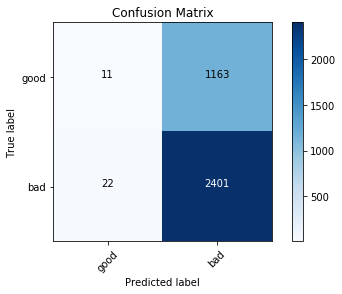

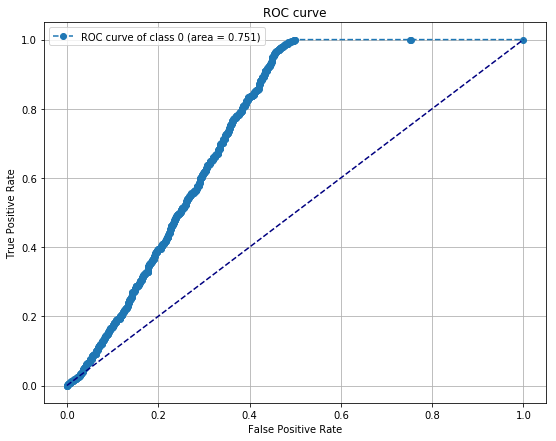

0.751076424751 For the label #1


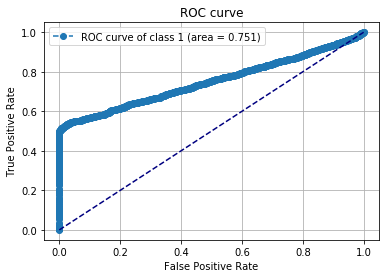

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_127 (Conv2D)          (None, 68, 29, 5)         105       
_________________________________________________________________
batch_normalization_128 (Bat (None, 68, 29, 5)         20        
_________________________________________________________________
activation_128 (Activation)  (None, 68, 29, 5)         0         
_________________________________________________________________
max_pooling2d_126 (MaxPoolin (None, 22, 9, 5)          0         
_________________________________________________________________
dropout_125 (Dropout)        (None, 22, 9, 5)          0         
_________________________________________________________________
flatten_125 (Flatten)        (None, 990)               0         
_________________________________________________________________
dense_126 (Dense)            (None, 2)                 1982      
Total para

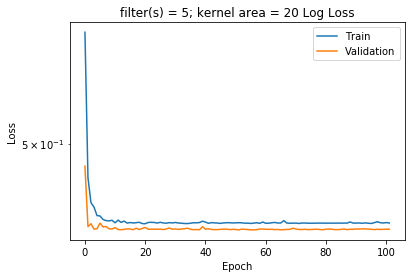

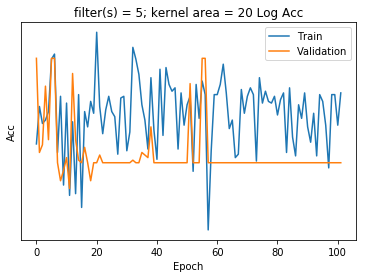

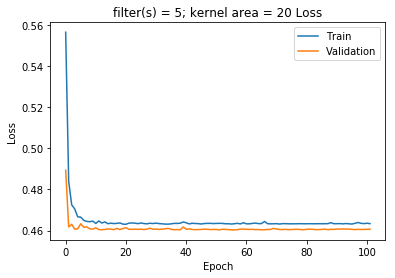

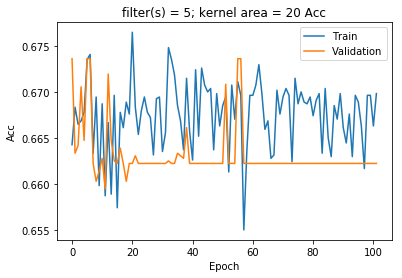

Confusion matrix, without normalization
[[ 752  422]
 [ 762 1661]]
accuracy score:  0.670836808451
0.753345283453 For the label #0


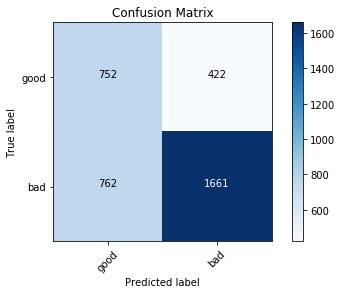

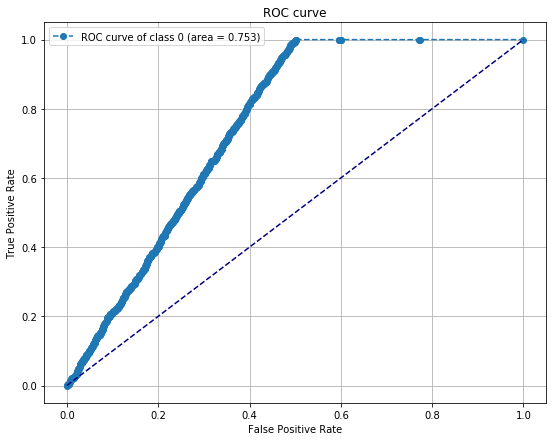

0.75334493191 For the label #1


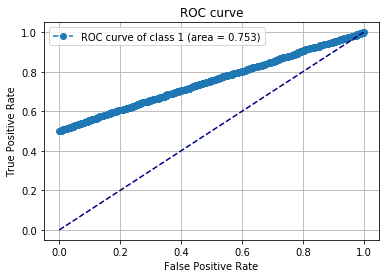

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_128 (Conv2D)          (None, 68, 28, 5)         130       
_________________________________________________________________
batch_normalization_129 (Bat (None, 68, 28, 5)         20        
_________________________________________________________________
activation_129 (Activation)  (None, 68, 28, 5)         0         
_________________________________________________________________
max_pooling2d_127 (MaxPoolin (None, 22, 9, 5)          0         
_________________________________________________________________
dropout_126 (Dropout)        (None, 22, 9, 5)          0         
_________________________________________________________________
flatten_126 (Flatten)        (None, 990)               0         
_________________________________________________________________
dense_127 (Dense)            (None, 2)                 1982      
Total para

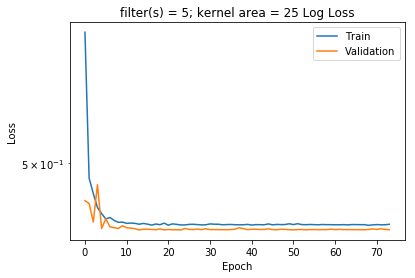

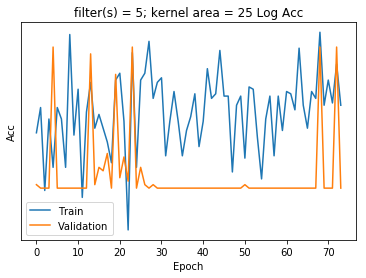

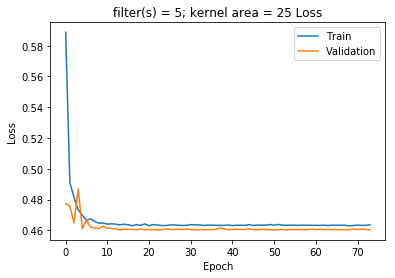

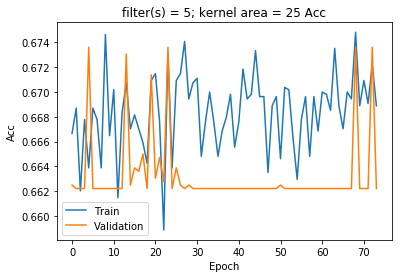

Confusion matrix, without normalization
[[   0 1174]
 [   0 2423]]
accuracy score:  0.673616902975
0.745940029572 For the label #0


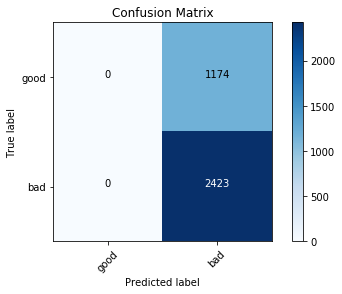

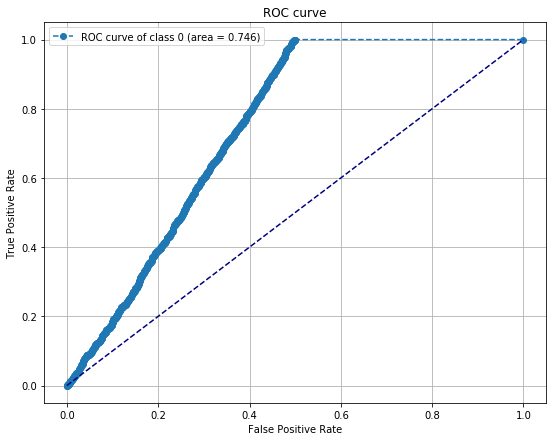

0.745939326486 For the label #1


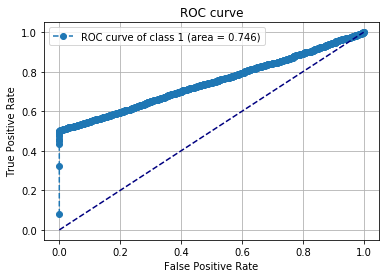

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_129 (Conv2D)          (None, 72, 32, 6)         12        
_________________________________________________________________
batch_normalization_130 (Bat (None, 72, 32, 6)         24        
_________________________________________________________________
activation_130 (Activation)  (None, 72, 32, 6)         0         
_________________________________________________________________
max_pooling2d_128 (MaxPoolin (None, 24, 10, 6)         0         
_________________________________________________________________
dropout_127 (Dropout)        (None, 24, 10, 6)         0         
_________________________________________________________________
flatten_127 (Flatten)        (None, 1440)              0         
_________________________________________________________________
dense_128 (Dense)            (None, 2)                 2882      
Total para

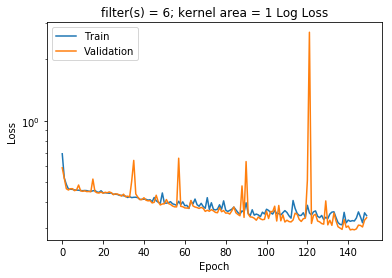

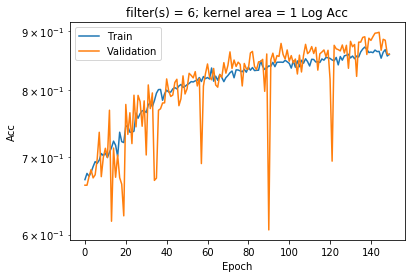

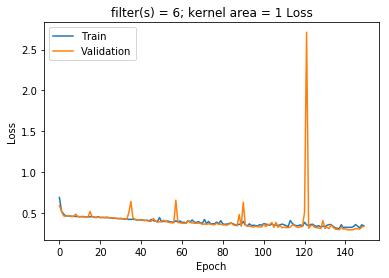

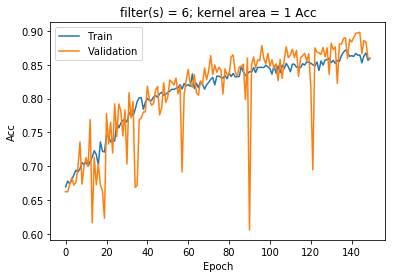

Confusion matrix, without normalization
[[1174    0]
 [ 394 2029]]
accuracy score:  0.890464275785
0.922010530823 For the label #0


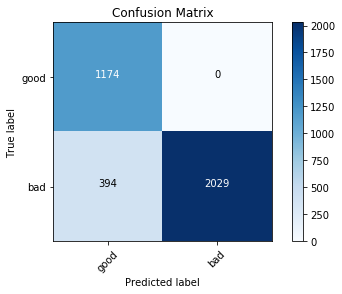

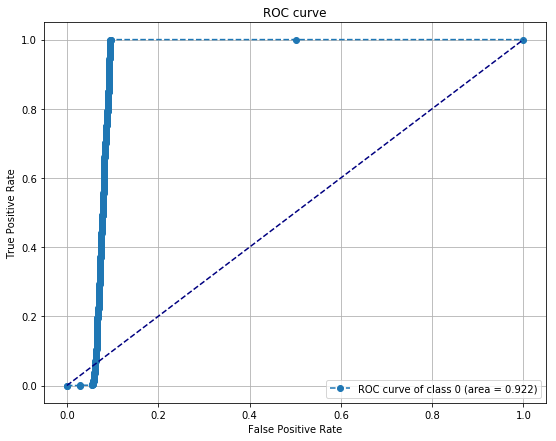

0.922010530823 For the label #1


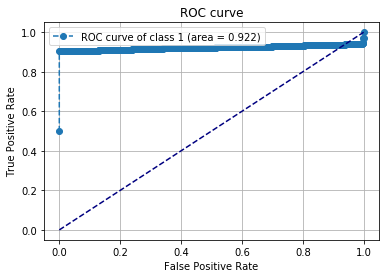

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_130 (Conv2D)          (None, 72, 31, 6)         18        
_________________________________________________________________
batch_normalization_131 (Bat (None, 72, 31, 6)         24        
_________________________________________________________________
activation_131 (Activation)  (None, 72, 31, 6)         0         
_________________________________________________________________
max_pooling2d_129 (MaxPoolin (None, 24, 10, 6)         0         
_________________________________________________________________
dropout_128 (Dropout)        (None, 24, 10, 6)         0         
_________________________________________________________________
flatten_128 (Flatten)        (None, 1440)              0         
_________________________________________________________________
dense_129 (Dense)            (None, 2)                 2882      
Total para

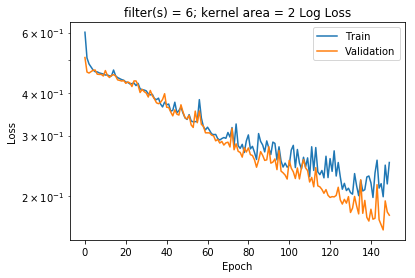

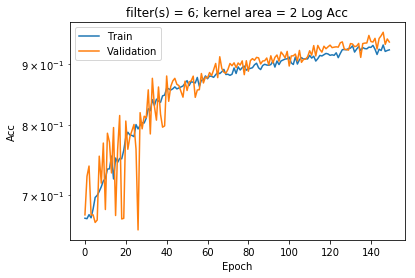

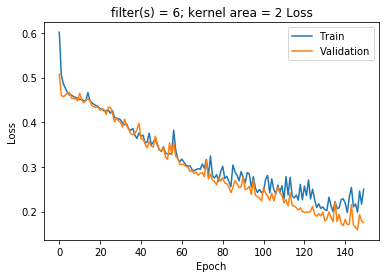

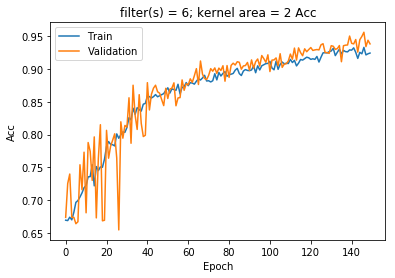

Confusion matrix, without normalization
[[1174    0]
 [ 157 2266]]
accuracy score:  0.956352515986
0.984372682013 For the label #0


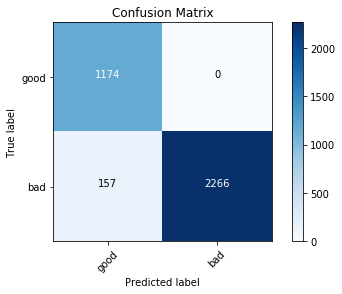

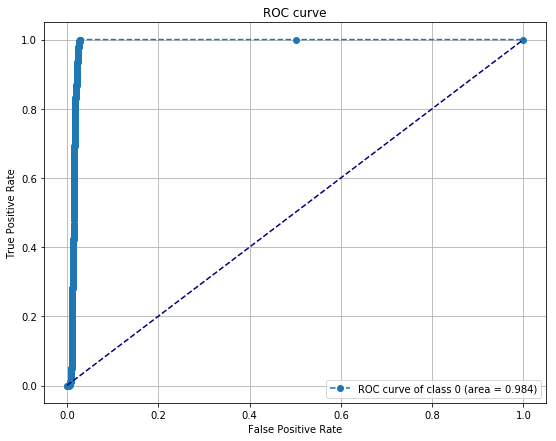

0.984372682013 For the label #1


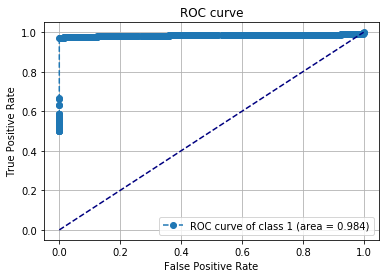

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_131 (Conv2D)          (None, 72, 30, 6)         24        
_________________________________________________________________
batch_normalization_132 (Bat (None, 72, 30, 6)         24        
_________________________________________________________________
activation_132 (Activation)  (None, 72, 30, 6)         0         
_________________________________________________________________
max_pooling2d_130 (MaxPoolin (None, 24, 10, 6)         0         
_________________________________________________________________
dropout_129 (Dropout)        (None, 24, 10, 6)         0         
_________________________________________________________________
flatten_129 (Flatten)        (None, 1440)              0         
_________________________________________________________________
dense_130 (Dense)            (None, 2)                 2882      
Total para

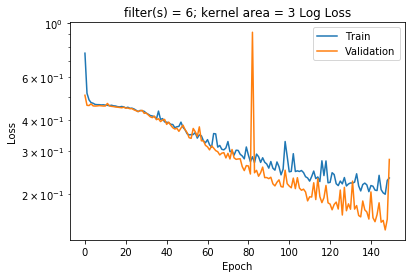

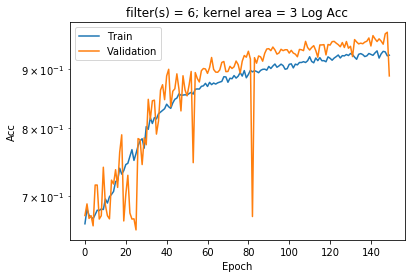

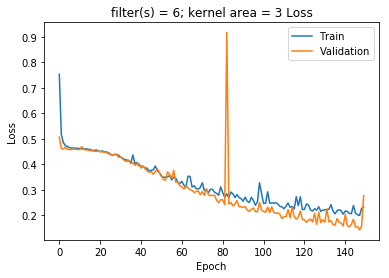

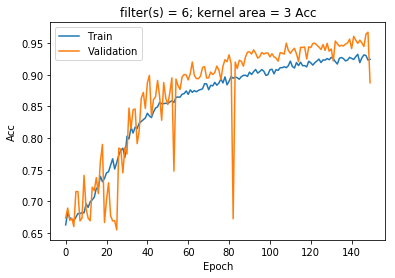

Confusion matrix, without normalization
[[1174    0]
 [ 129 2294]]
accuracy score:  0.964136780651
0.985239235577 For the label #0


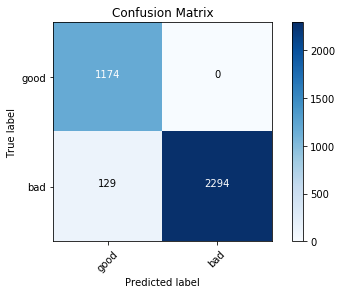

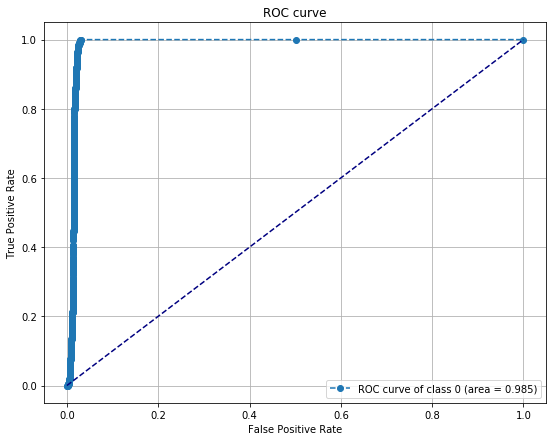

0.985239235577 For the label #1


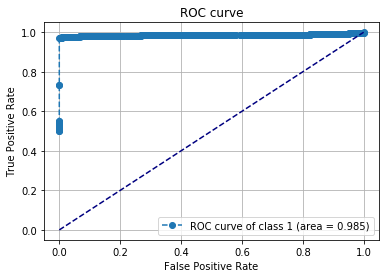

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_132 (Conv2D)          (None, 72, 29, 6)         30        
_________________________________________________________________
batch_normalization_133 (Bat (None, 72, 29, 6)         24        
_________________________________________________________________
activation_133 (Activation)  (None, 72, 29, 6)         0         
_________________________________________________________________
max_pooling2d_131 (MaxPoolin (None, 24, 9, 6)          0         
_________________________________________________________________
dropout_130 (Dropout)        (None, 24, 9, 6)          0         
_________________________________________________________________
flatten_130 (Flatten)        (None, 1296)              0         
_________________________________________________________________
dense_131 (Dense)            (None, 2)                 2594      
Total para

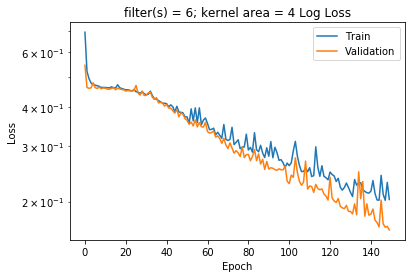

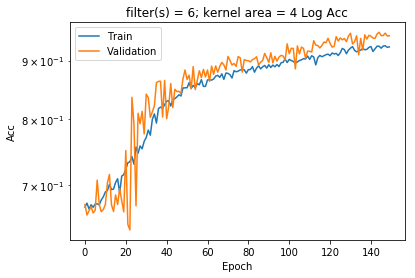

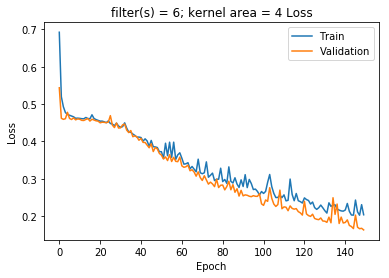

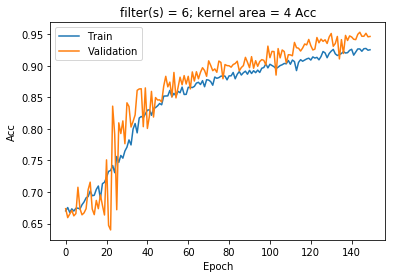

Confusion matrix, without normalization
[[1174    0]
 [ 193 2230]]
accuracy score:  0.946344175702
0.985558788189 For the label #0


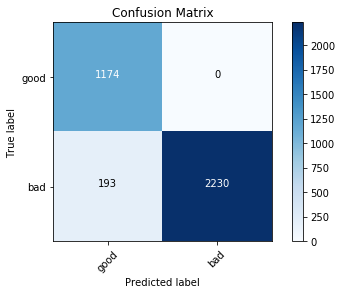

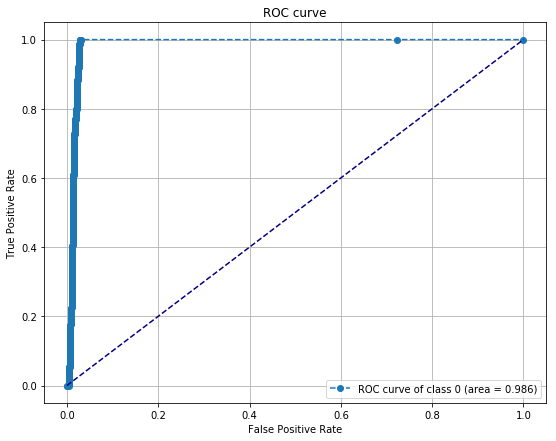

0.985558788189 For the label #1


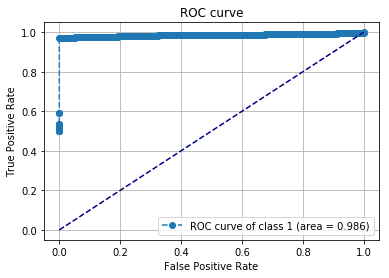

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_133 (Conv2D)          (None, 72, 28, 6)         36        
_________________________________________________________________
batch_normalization_134 (Bat (None, 72, 28, 6)         24        
_________________________________________________________________
activation_134 (Activation)  (None, 72, 28, 6)         0         
_________________________________________________________________
max_pooling2d_132 (MaxPoolin (None, 24, 9, 6)          0         
_________________________________________________________________
dropout_131 (Dropout)        (None, 24, 9, 6)          0         
_________________________________________________________________
flatten_131 (Flatten)        (None, 1296)              0         
_________________________________________________________________
dense_132 (Dense)            (None, 2)                 2594      
Total para

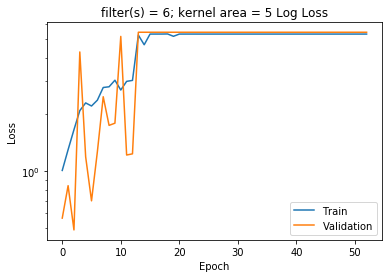

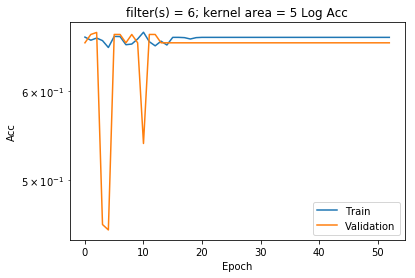

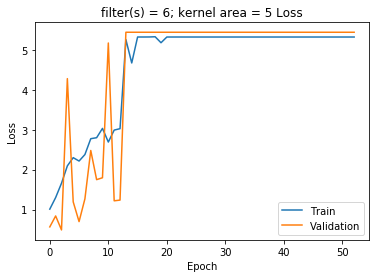

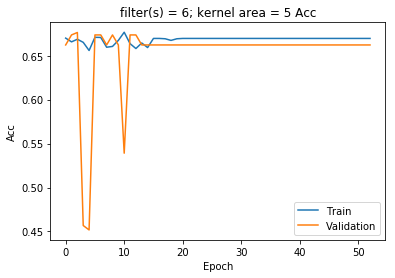

Confusion matrix, without normalization
[[1064  110]
 [1054 1369]]
accuracy score:  0.676396997498
0.754320815355 For the label #0


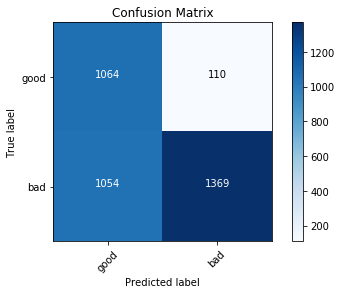

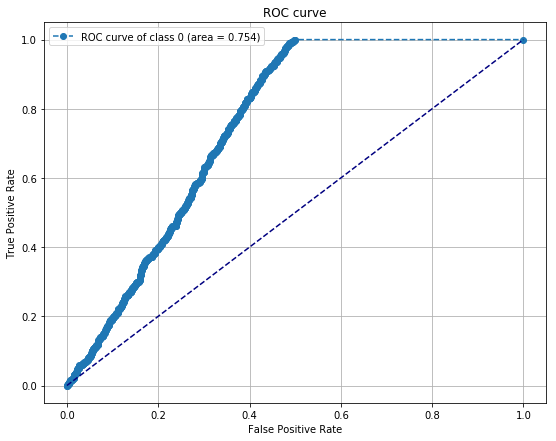

0.754320815355 For the label #1


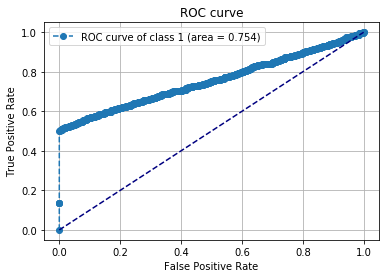

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_134 (Conv2D)          (None, 71, 32, 6)         18        
_________________________________________________________________
batch_normalization_135 (Bat (None, 71, 32, 6)         24        
_________________________________________________________________
activation_135 (Activation)  (None, 71, 32, 6)         0         
_________________________________________________________________
max_pooling2d_133 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_132 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_132 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_133 (Dense)            (None, 2)                 2762      
Total para

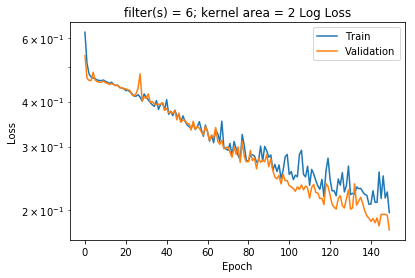

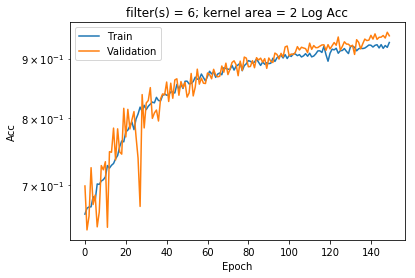

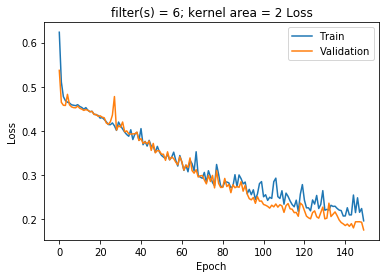

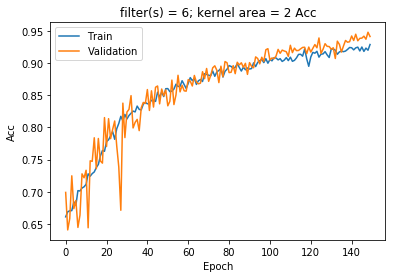

Confusion matrix, without normalization
[[1174    0]
 [ 210 2213]]
accuracy score:  0.941618015013
0.973499983477 For the label #0


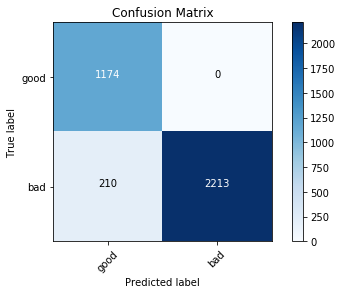

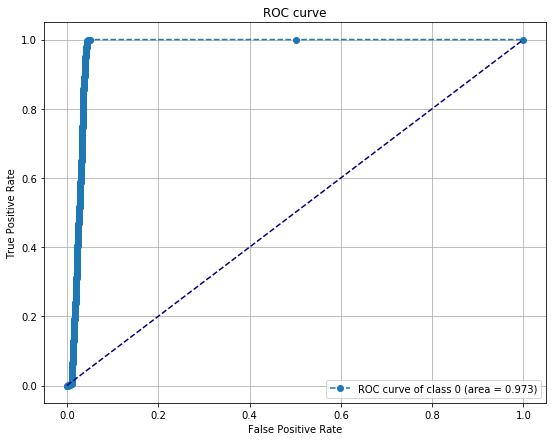

0.973499983477 For the label #1


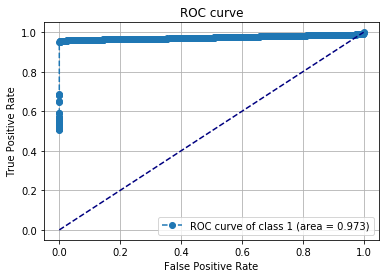

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_135 (Conv2D)          (None, 71, 31, 6)         30        
_________________________________________________________________
batch_normalization_136 (Bat (None, 71, 31, 6)         24        
_________________________________________________________________
activation_136 (Activation)  (None, 71, 31, 6)         0         
_________________________________________________________________
max_pooling2d_134 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_133 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_133 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_134 (Dense)            (None, 2)                 2762      
Total para

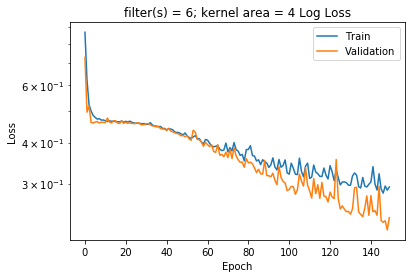

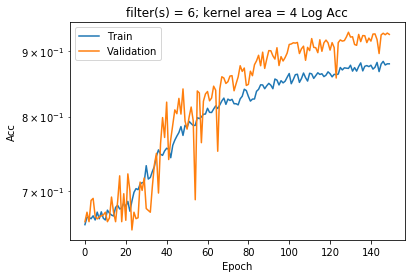

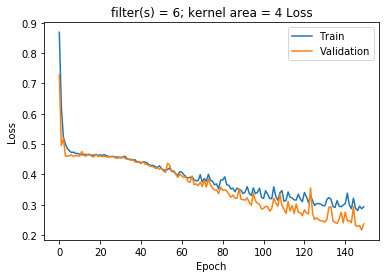

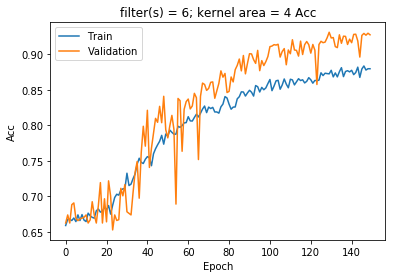

Confusion matrix, without normalization
[[1174    0]
 [ 252 2171]]
accuracy score:  0.929941618015
0.971643308976 For the label #0


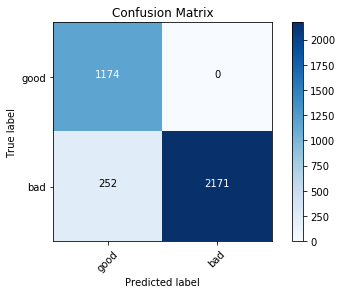

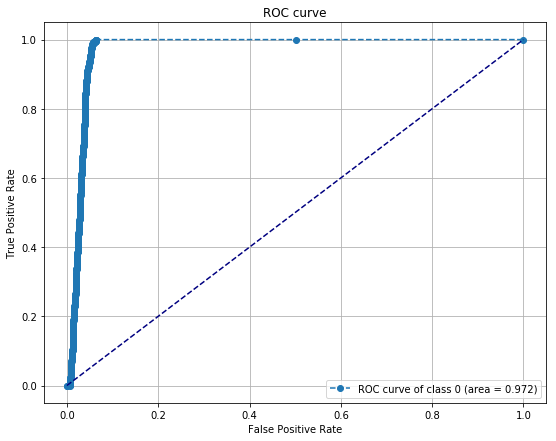

0.971643308976 For the label #1


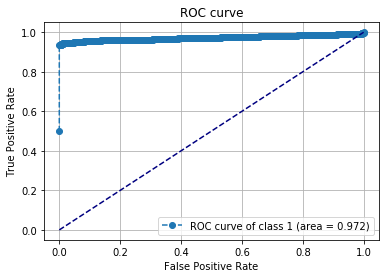

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_136 (Conv2D)          (None, 71, 30, 6)         42        
_________________________________________________________________
batch_normalization_137 (Bat (None, 71, 30, 6)         24        
_________________________________________________________________
activation_137 (Activation)  (None, 71, 30, 6)         0         
_________________________________________________________________
max_pooling2d_135 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_134 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_134 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_135 (Dense)            (None, 2)                 2762      
Total para

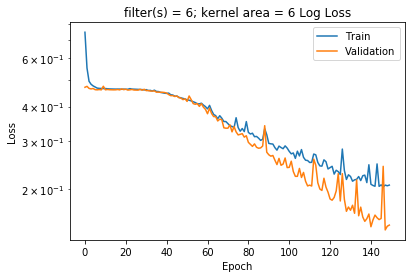

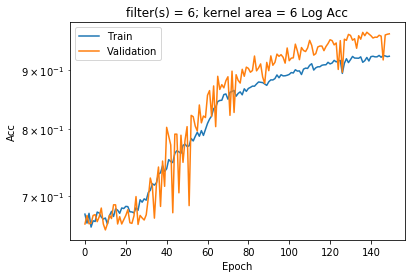

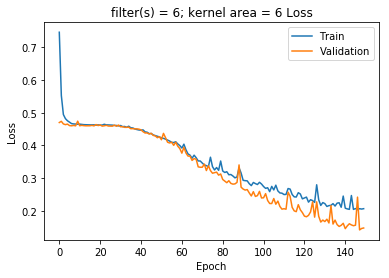

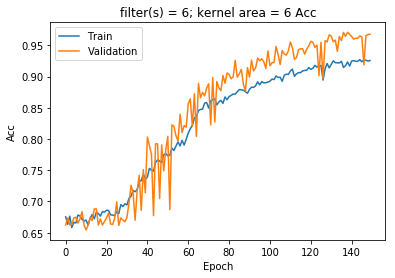

Confusion matrix, without normalization
[[1174    0]
 [ 123 2300]]
accuracy score:  0.965804837364
0.989284089655 For the label #0


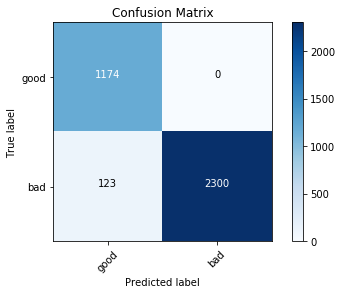

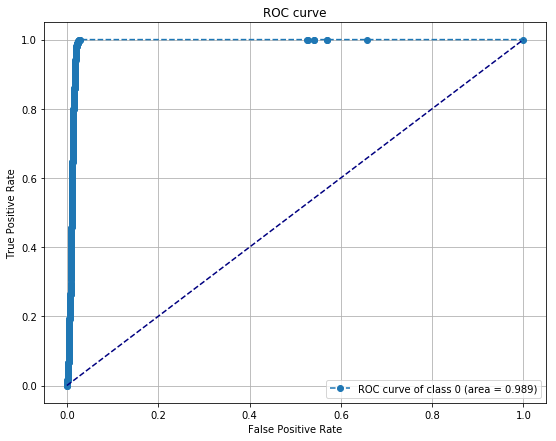

0.989284089655 For the label #1


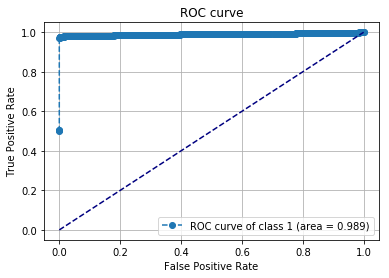

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_137 (Conv2D)          (None, 71, 29, 6)         54        
_________________________________________________________________
batch_normalization_138 (Bat (None, 71, 29, 6)         24        
_________________________________________________________________
activation_138 (Activation)  (None, 71, 29, 6)         0         
_________________________________________________________________
max_pooling2d_136 (MaxPoolin (None, 23, 9, 6)          0         
_________________________________________________________________
dropout_135 (Dropout)        (None, 23, 9, 6)          0         
_________________________________________________________________
flatten_135 (Flatten)        (None, 1242)              0         
_________________________________________________________________
dense_136 (Dense)            (None, 2)                 2486      
Total para

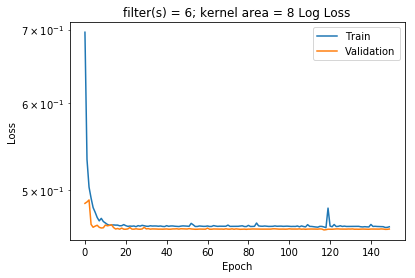

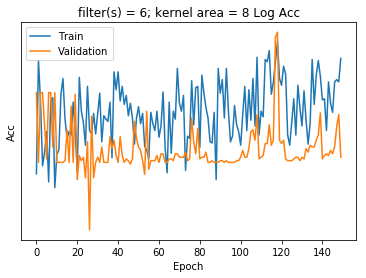

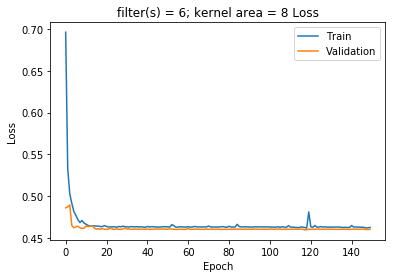

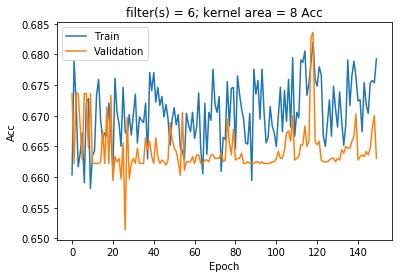

Confusion matrix, without normalization
[[1174    0]
 [1141 1282]]
accuracy score:  0.682791214901
0.763789451037 For the label #0


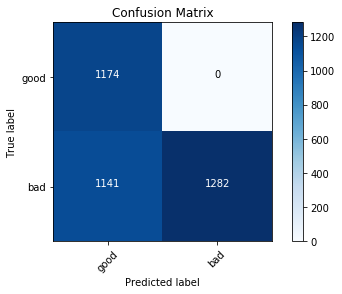

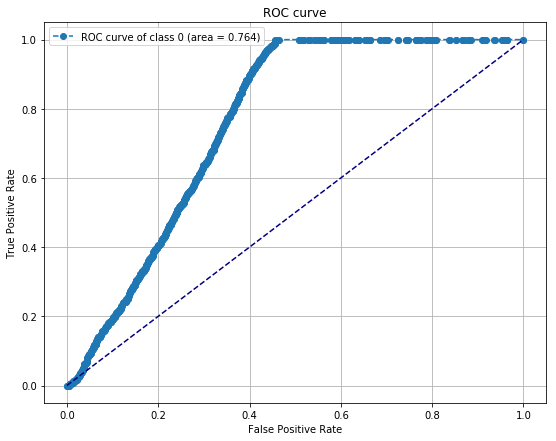

0.763789275266 For the label #1


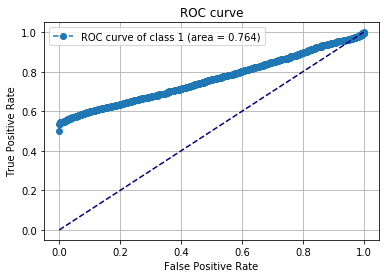

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_138 (Conv2D)          (None, 71, 28, 6)         66        
_________________________________________________________________
batch_normalization_139 (Bat (None, 71, 28, 6)         24        
_________________________________________________________________
activation_139 (Activation)  (None, 71, 28, 6)         0         
_________________________________________________________________
max_pooling2d_137 (MaxPoolin (None, 23, 9, 6)          0         
_________________________________________________________________
dropout_136 (Dropout)        (None, 23, 9, 6)          0         
_________________________________________________________________
flatten_136 (Flatten)        (None, 1242)              0         
_________________________________________________________________
dense_137 (Dense)            (None, 2)                 2486      
Total para

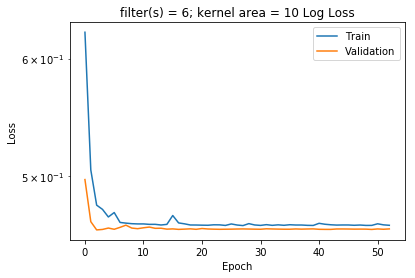

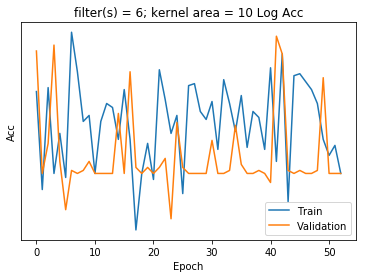

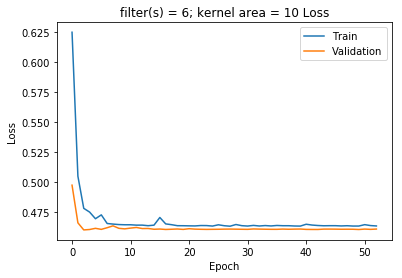

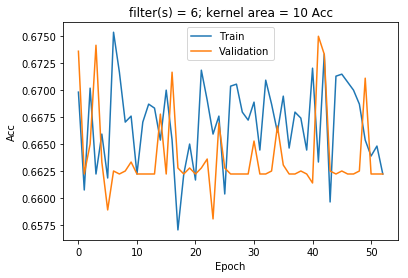

Confusion matrix, without normalization
[[  43 1131]
 [  74 2349]]
accuracy score:  0.664998609953
0.76194138934 For the label #0


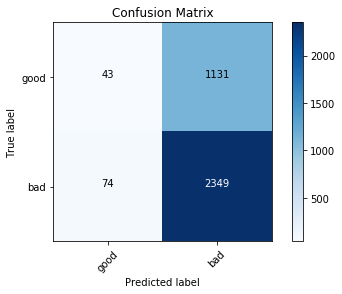

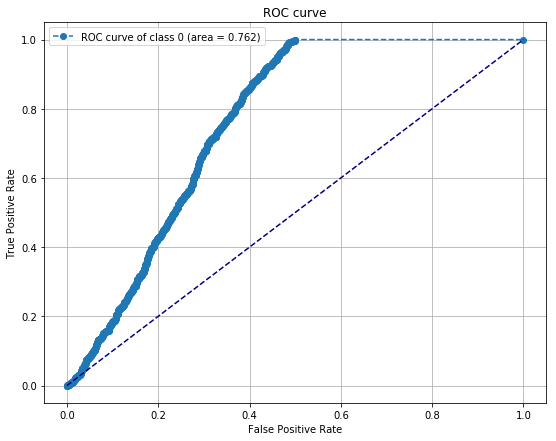

0.761941916655 For the label #1


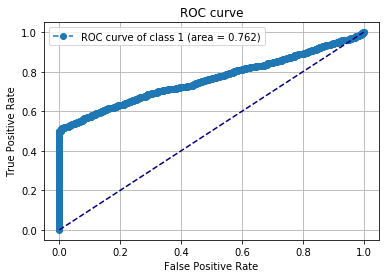

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_139 (Conv2D)          (None, 70, 32, 6)         24        
_________________________________________________________________
batch_normalization_140 (Bat (None, 70, 32, 6)         24        
_________________________________________________________________
activation_140 (Activation)  (None, 70, 32, 6)         0         
_________________________________________________________________
max_pooling2d_138 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_137 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_137 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_138 (Dense)            (None, 2)                 2762      
Total para

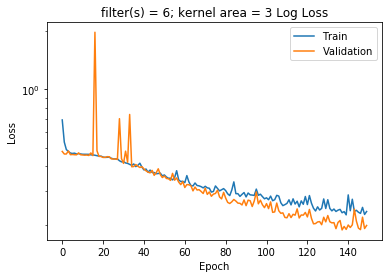

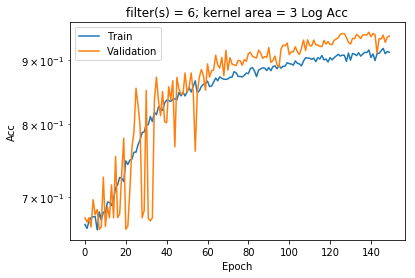

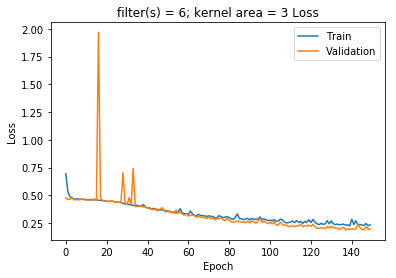

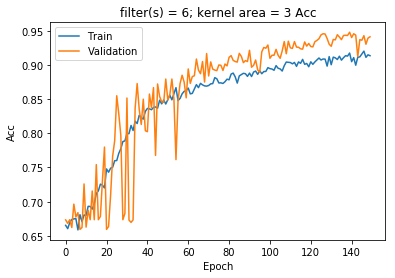

Confusion matrix, without normalization
[[1174    0]
 [ 204 2219]]
accuracy score:  0.943286071726
0.973844671416 For the label #0


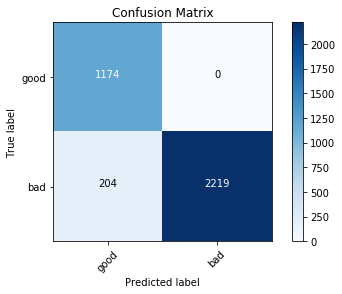

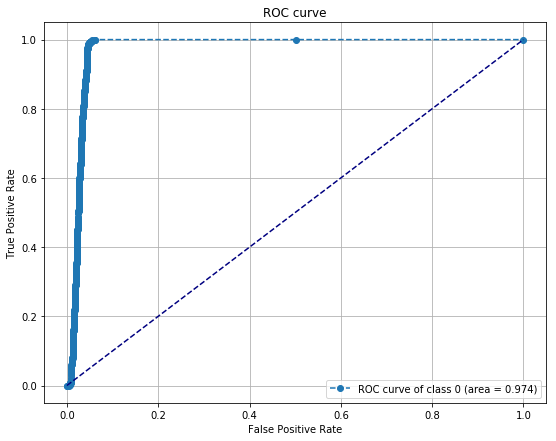

0.973844671416 For the label #1


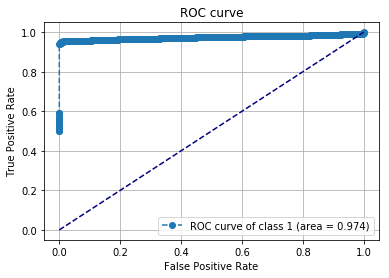

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_140 (Conv2D)          (None, 70, 31, 6)         42        
_________________________________________________________________
batch_normalization_141 (Bat (None, 70, 31, 6)         24        
_________________________________________________________________
activation_141 (Activation)  (None, 70, 31, 6)         0         
_________________________________________________________________
max_pooling2d_139 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_138 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_138 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_139 (Dense)            (None, 2)                 2762      
Total para

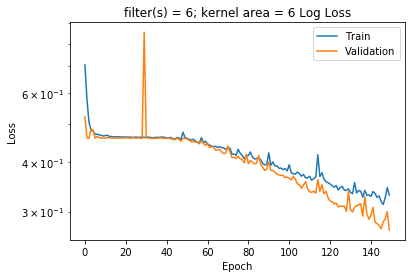

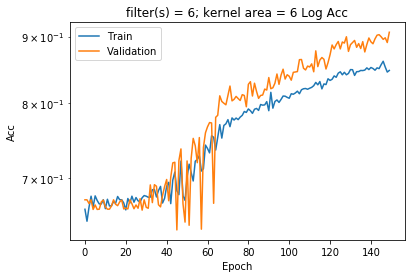

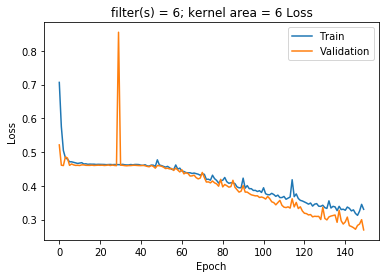

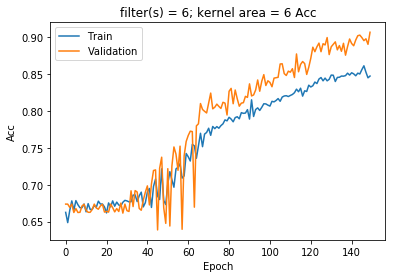

Confusion matrix, without normalization
[[1172    2]
 [ 333 2090]]
accuracy score:  0.906866833472
0.956916116912 For the label #0


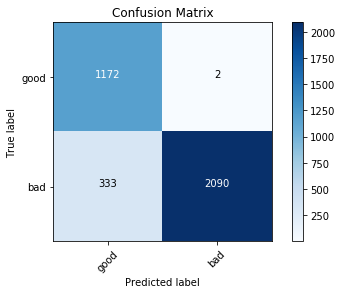

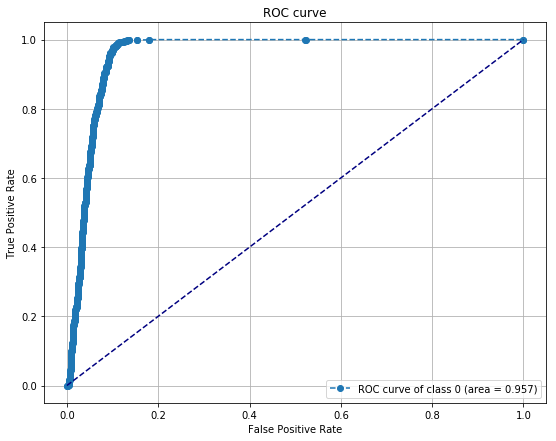

0.956915765369 For the label #1


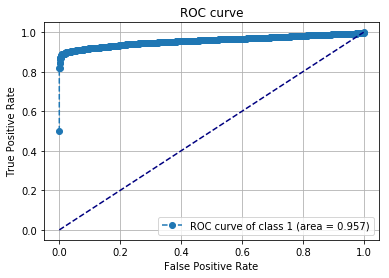

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_141 (Conv2D)          (None, 70, 30, 6)         60        
_________________________________________________________________
batch_normalization_142 (Bat (None, 70, 30, 6)         24        
_________________________________________________________________
activation_142 (Activation)  (None, 70, 30, 6)         0         
_________________________________________________________________
max_pooling2d_140 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_139 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_139 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_140 (Dense)            (None, 2)                 2762      
Total para

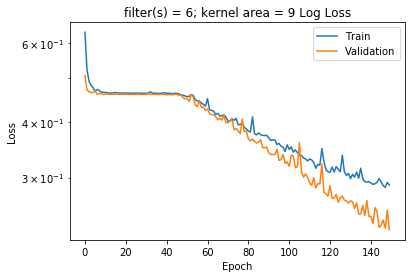

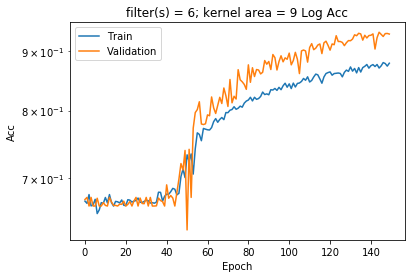

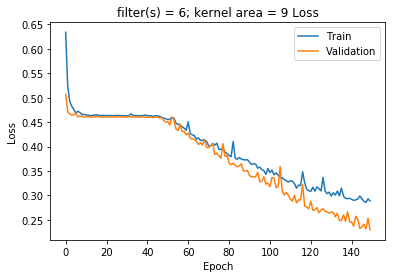

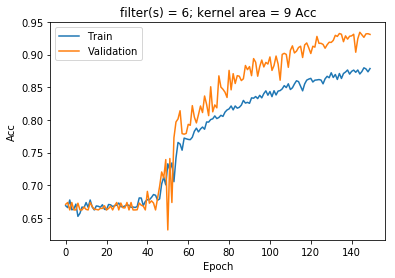

Confusion matrix, without normalization
[[1174    0]
 [ 249 2174]]
accuracy score:  0.930775646372
0.958913232853 For the label #0


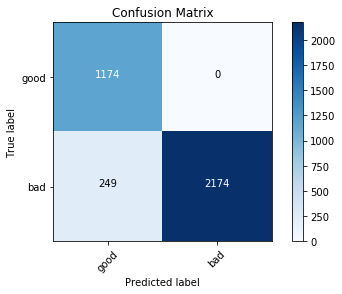

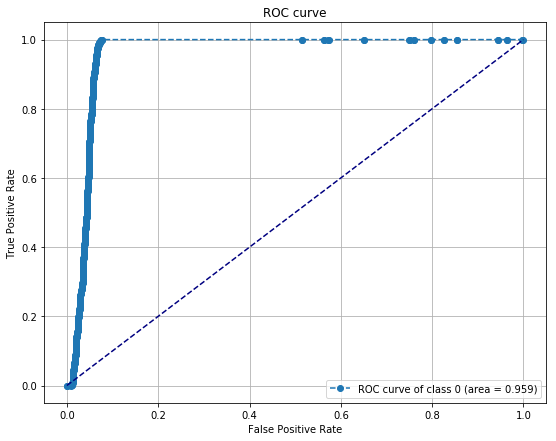

0.958913232853 For the label #1


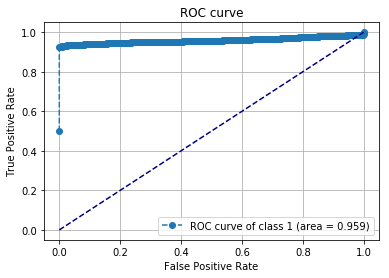

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_142 (Conv2D)          (None, 70, 29, 6)         78        
_________________________________________________________________
batch_normalization_143 (Bat (None, 70, 29, 6)         24        
_________________________________________________________________
activation_143 (Activation)  (None, 70, 29, 6)         0         
_________________________________________________________________
max_pooling2d_141 (MaxPoolin (None, 23, 9, 6)          0         
_________________________________________________________________
dropout_140 (Dropout)        (None, 23, 9, 6)          0         
_________________________________________________________________
flatten_140 (Flatten)        (None, 1242)              0         
_________________________________________________________________
dense_141 (Dense)            (None, 2)                 2486      
Total para

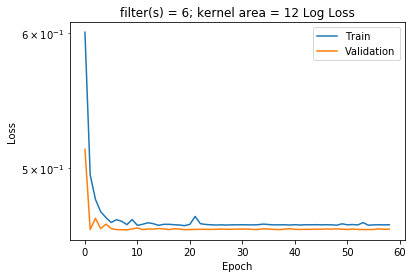

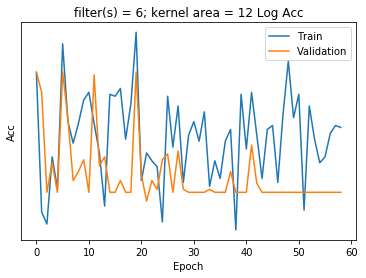

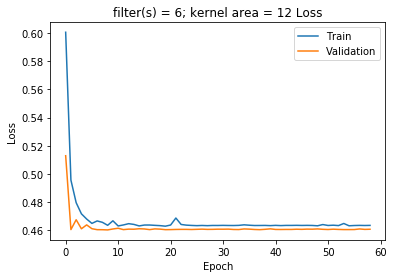

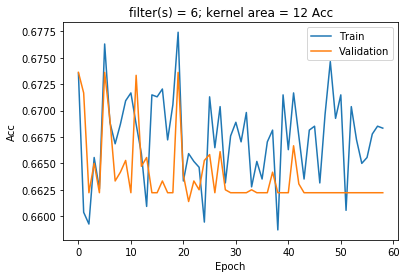

Confusion matrix, without normalization
[[ 115 1059]
 [ 149 2274]]
accuracy score:  0.664164581596
0.751356604544 For the label #0


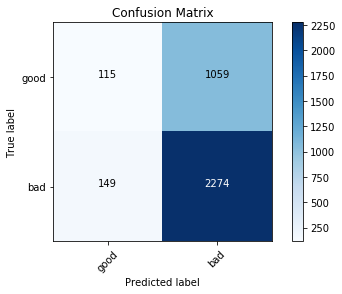

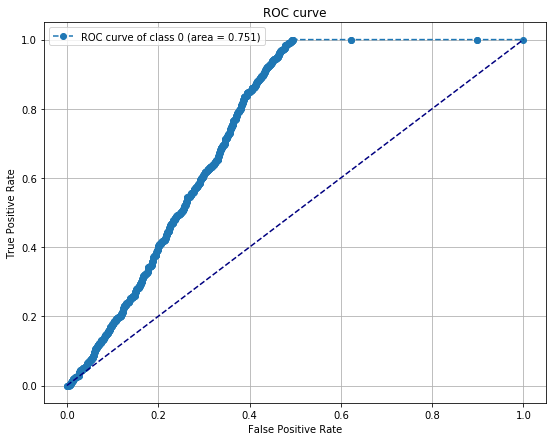

0.751357131859 For the label #1


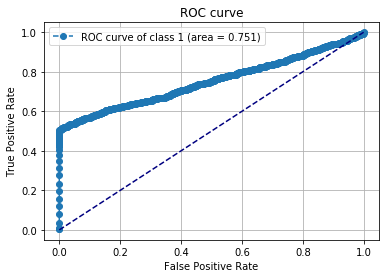

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_143 (Conv2D)          (None, 70, 28, 6)         96        
_________________________________________________________________
batch_normalization_144 (Bat (None, 70, 28, 6)         24        
_________________________________________________________________
activation_144 (Activation)  (None, 70, 28, 6)         0         
_________________________________________________________________
max_pooling2d_142 (MaxPoolin (None, 23, 9, 6)          0         
_________________________________________________________________
dropout_141 (Dropout)        (None, 23, 9, 6)          0         
_________________________________________________________________
flatten_141 (Flatten)        (None, 1242)              0         
_________________________________________________________________
dense_142 (Dense)            (None, 2)                 2486      
Total para

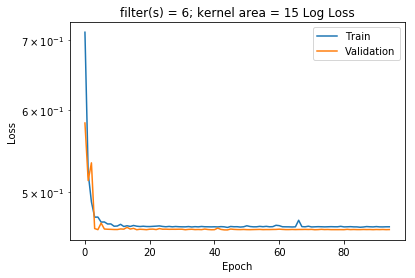

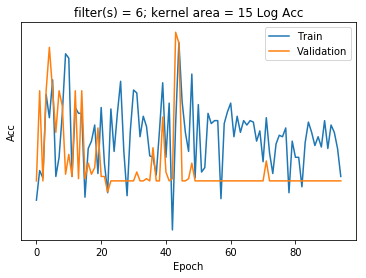

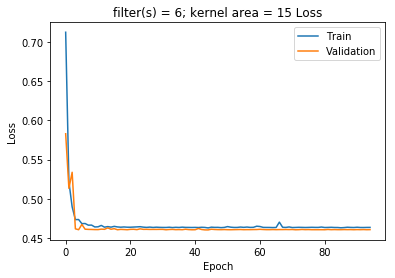

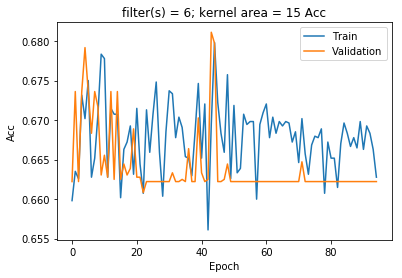

Confusion matrix, without normalization
[[ 857  317]
 [ 835 1588]]
accuracy score:  0.679733110926
0.75897840893 For the label #0


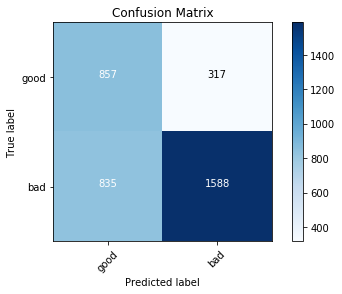

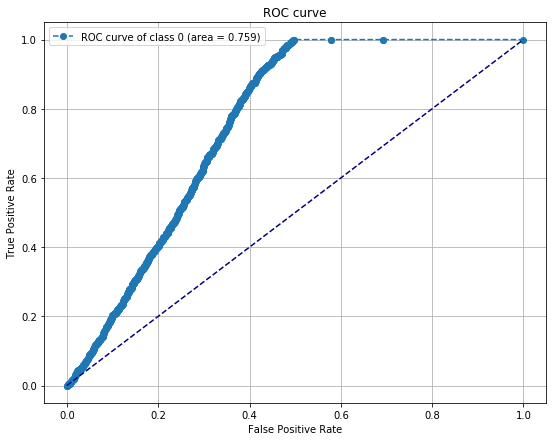

0.758978233159 For the label #1


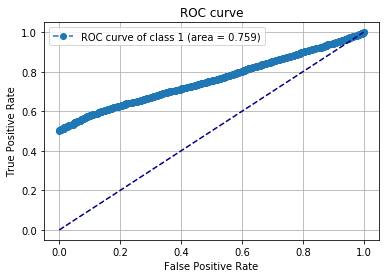

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_144 (Conv2D)          (None, 69, 32, 6)         30        
_________________________________________________________________
batch_normalization_145 (Bat (None, 69, 32, 6)         24        
_________________________________________________________________
activation_145 (Activation)  (None, 69, 32, 6)         0         
_________________________________________________________________
max_pooling2d_143 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_142 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_142 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_143 (Dense)            (None, 2)                 2762      
Total para

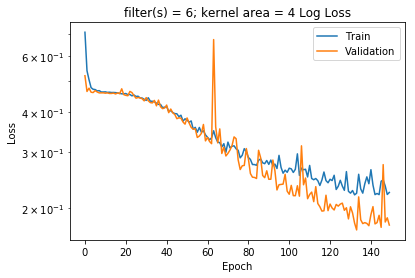

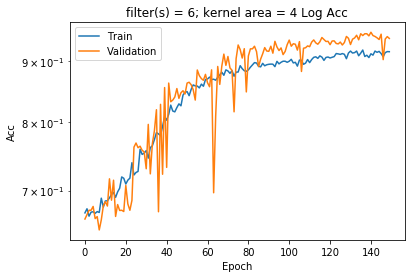

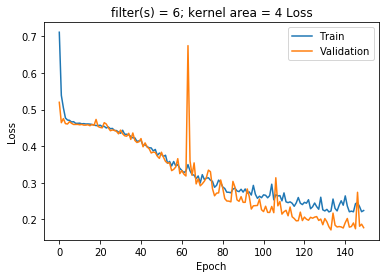

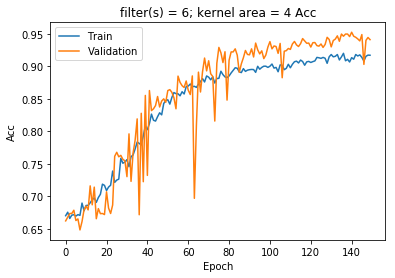

Confusion matrix, without normalization
[[1174    0]
 [ 190 2233]]
accuracy score:  0.947178204059
0.975822452491 For the label #0


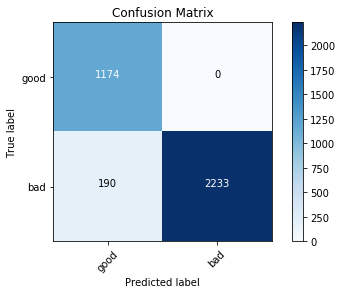

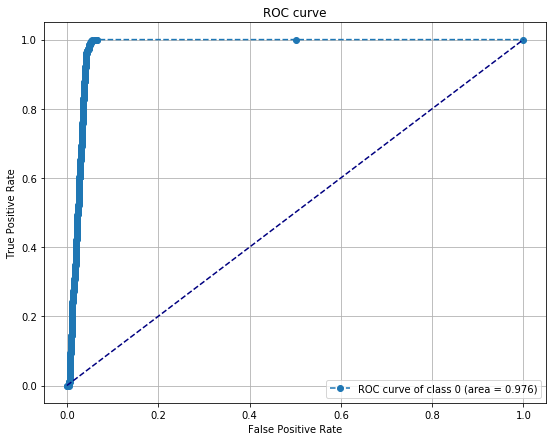

0.975822452491 For the label #1


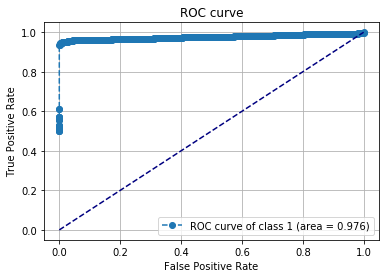

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_145 (Conv2D)          (None, 69, 31, 6)         54        
_________________________________________________________________
batch_normalization_146 (Bat (None, 69, 31, 6)         24        
_________________________________________________________________
activation_146 (Activation)  (None, 69, 31, 6)         0         
_________________________________________________________________
max_pooling2d_144 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_143 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_143 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_144 (Dense)            (None, 2)                 2762      
Total para

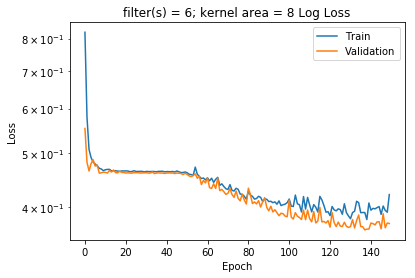

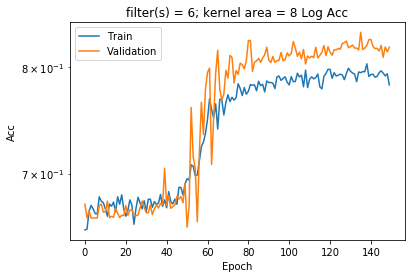

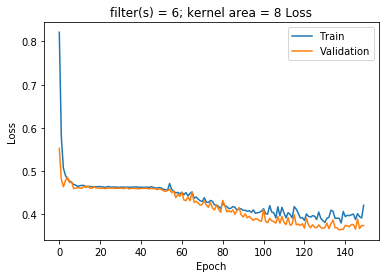

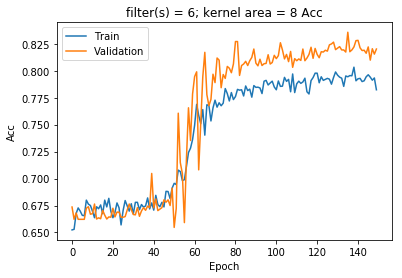

Confusion matrix, without normalization
[[1174    0]
 [ 650 1773]]
accuracy score:  0.819293855991
0.862819121972 For the label #0


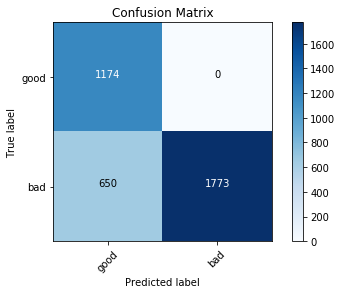

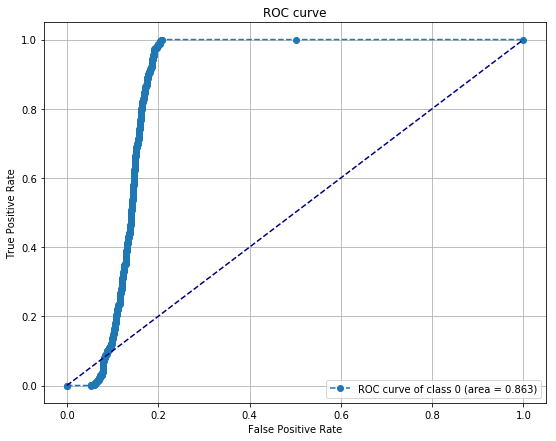

0.862819121972 For the label #1


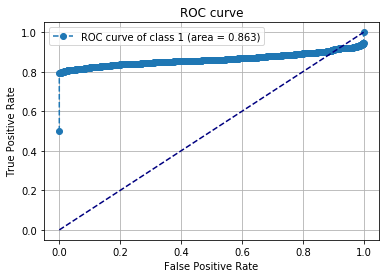

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_146 (Conv2D)          (None, 69, 30, 6)         78        
_________________________________________________________________
batch_normalization_147 (Bat (None, 69, 30, 6)         24        
_________________________________________________________________
activation_147 (Activation)  (None, 69, 30, 6)         0         
_________________________________________________________________
max_pooling2d_145 (MaxPoolin (None, 23, 10, 6)         0         
_________________________________________________________________
dropout_144 (Dropout)        (None, 23, 10, 6)         0         
_________________________________________________________________
flatten_144 (Flatten)        (None, 1380)              0         
_________________________________________________________________
dense_145 (Dense)            (None, 2)                 2762      
Total para

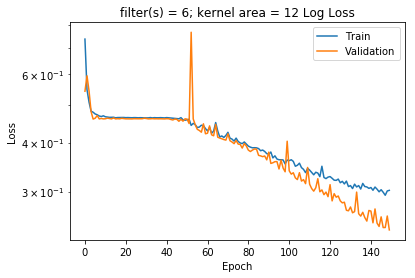

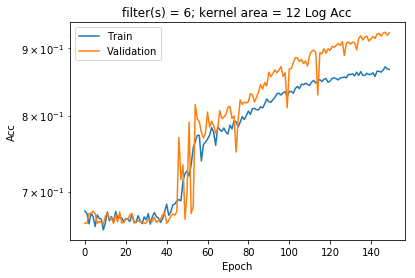

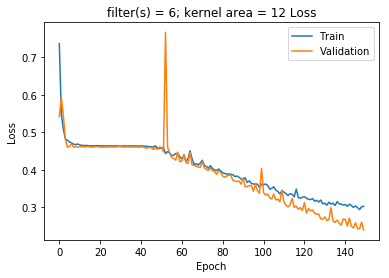

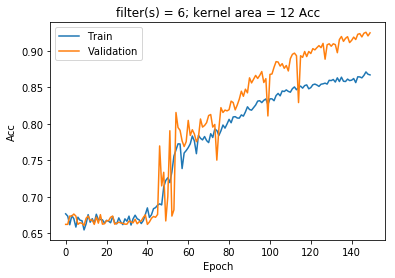

Confusion matrix, without normalization
[[1173    1]
 [ 269 2154]]
accuracy score:  0.924937447873
0.960389889341 For the label #0


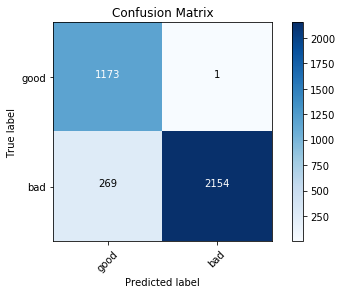

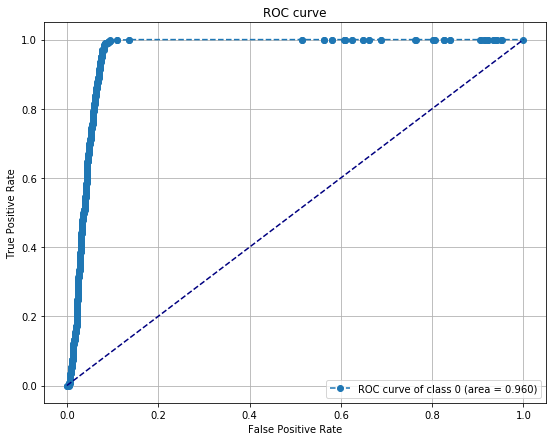

0.960389889341 For the label #1


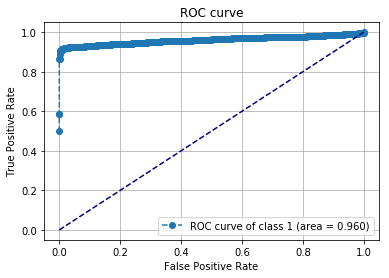

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_147 (Conv2D)          (None, 69, 29, 6)         102       
_________________________________________________________________
batch_normalization_148 (Bat (None, 69, 29, 6)         24        
_________________________________________________________________
activation_148 (Activation)  (None, 69, 29, 6)         0         
_________________________________________________________________
max_pooling2d_146 (MaxPoolin (None, 23, 9, 6)          0         
_________________________________________________________________
dropout_145 (Dropout)        (None, 23, 9, 6)          0         
_________________________________________________________________
flatten_145 (Flatten)        (None, 1242)              0         
_________________________________________________________________
dense_146 (Dense)            (None, 2)                 2486      
Total para

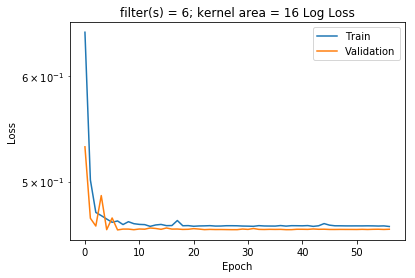

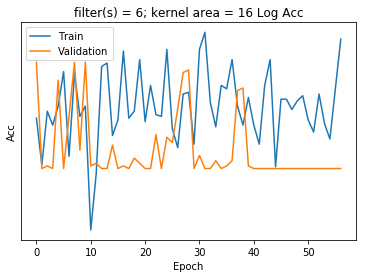

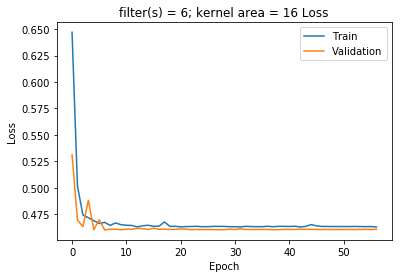

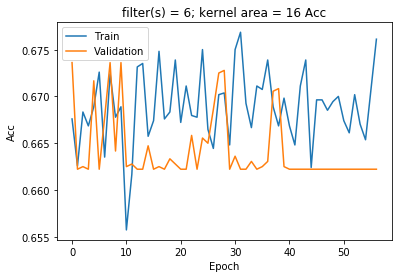

Confusion matrix, without normalization
[[ 103 1071]
 [ 124 2299]]
accuracy score:  0.667778704476
0.755054661425 For the label #0


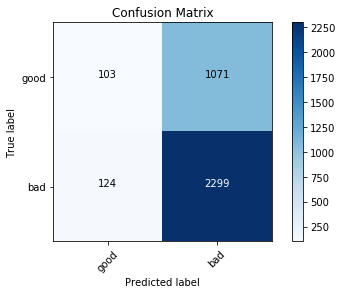

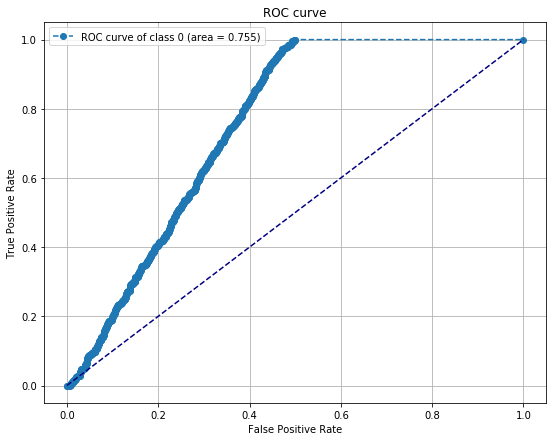

0.755054309882 For the label #1


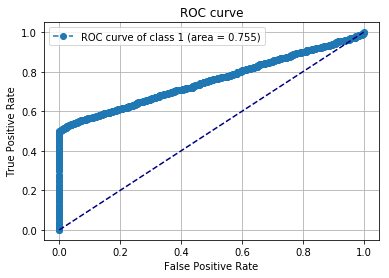

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_148 (Conv2D)          (None, 69, 28, 6)         126       
_________________________________________________________________
batch_normalization_149 (Bat (None, 69, 28, 6)         24        
_________________________________________________________________
activation_149 (Activation)  (None, 69, 28, 6)         0         
_________________________________________________________________
max_pooling2d_147 (MaxPoolin (None, 23, 9, 6)          0         
_________________________________________________________________
dropout_146 (Dropout)        (None, 23, 9, 6)          0         
_________________________________________________________________
flatten_146 (Flatten)        (None, 1242)              0         
_________________________________________________________________
dense_147 (Dense)            (None, 2)                 2486      
Total para

In [ ]:
modelAcc = []
for i in range(len(Models)):
    Models[i].summary()
    plot_model(Models[i], to_file='Supervised_model.png',)

    Models[i].save('emptymodel.hdf5')
    checkpointer = ModelCheckpoint(filepath='best_nbmodel_good_bad.hdf5', verbose=0, save_best_only=True)
    earlystop= EarlyStopping(monitor='val_loss', min_delta=0, patience=50, verbose=1, mode='auto')
    print '-----------------------------------------------------'
    ModelChar =  'filter(s) = ' + str(filters[i]) + '; kernel area = ' + str(filter_sizes[i])
    print ModelChar
    history = Models[i].fit(Xtrain,ytrain,epochs=150
                    ,verbose=0
                    ,validation_data=(Xtest,ytest)
                    ,shuffle=True
                    ,callbacks=[checkpointer,earlystop])
    
    u.plot_loss(history, '{} {}'.format(ModelChar, 'Log Loss'),"log")
    u.plot_acc(history, '{} {}'.format(ModelChar, 'Log Acc'),"log")

    u.plot_loss(history, '{} {}'.format(ModelChar, 'Loss'),"linear")
    u.plot_acc(history, '{} {}'.format(ModelChar, 'Acc'),"linear")
    
    best_model= load_model('best_nbmodel_good_bad.hdf5',compile=False)
    
    ypred=best_model.predict(Xtest)
    ypredproba=best_model.predict_proba(Xtest)
    #it's preferable to use .predict_classes because .predict might give probabilities 
    #and not the label's in the case of multiclass
    ypredclass=best_model.predict_classes(Xtest)

    ypredclass=np.reshape(ypredclass,(ypredclass.shape[0],1))
    #use argmax(1) to give the position of max value in a categorical variable like ytest
    #it's basically a .predict_classes for ytest
    ytestclass= ytest.argmax(1)
    ytestclass=np.reshape(ytestclass,(ytestclass.shape[0],1))
    
    # from categorial to lable indexing
    confusion= metrics.confusion_matrix(ytestclass,ypredclass)

    plotlabels=['good','bad']
    u.plot_confusion_matrix(confusion,plotlabels,title='Confusion Matrix')
    modelAcc.append(metrics.accuracy_score(ytestclass,ypredclass))
    print 'accuracy score: ', metrics.accuracy_score(ytestclass,ypredclass)
    
    plt.figure(figsize=(9,7))
    plt.show
    
    for i in range(ypredproba.shape[1]):
        fpr,tpr,thresholds= roc_curve(ytestclass,ypredproba[:,i],pos_label=i)
        roc_auc = auc(fpr, tpr)
        
        print roc_auc,'For the label #{0}'.format(i)

        plt.plot(fpr,tpr, linestyle='dashed'
                 ,label='ROC curve of class {0} (area = {1:0.3f})' .format(i,roc_auc) ,marker='o')#% roc_auc, color='green'markerfacecolor='blue' ,markersize=4,
        plt.plot([0, 1], [0, 1], color='navy', linestyle='--') 
        plt.title('ROC curve')
        plt.ylabel('True Positive Rate')
        plt.xlabel('False Positive Rate')
        plt.legend()
        plt.grid(True)
        plt.show()

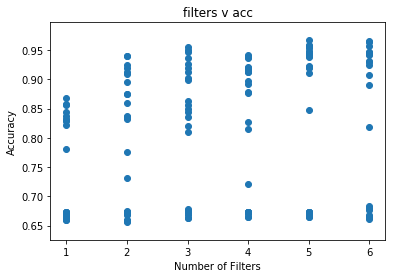

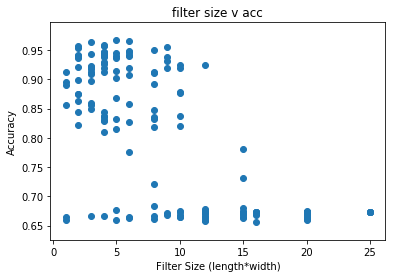

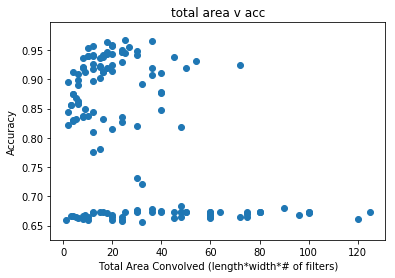

In [13]:
filters_v_acc = plt.figure()
plt.scatter(filters[:145], modelAcc)
plt.xlabel('Number of Filters')
plt.ylabel('Accuracy')
plt.title('filters v acc')
plt.show()

filterSize_v_acc = plt.figure()
plt.scatter(filter_sizes[:145], modelAcc)
plt.xlabel('Filter Size (length*width)')
plt.ylabel('Accuracy')
plt.title('filter size v acc')
plt.show()

totalArea_v_acc = plt.figure()
plt.scatter(tot_area[:145], modelAcc)
plt.xlabel('Total Area Convolved (length*width*# of filters)')
plt.ylabel('Accuracy')
plt.title('total area v acc')
plt.show()